In [116]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import os
from joblib import Parallel, delayed
n_jobs = os.cpu_count() - 2
from tqdm.notebook import tqdm
import networkx as nx
import navis
from fafbseg import flywire
import flybrains
flywire.set_default_dataset("public")
import pickle
from scipy.stats import wilcoxon

def p_value_to_stars(p):
    if p < 0.001:
        return '***'
    elif p < 0.01:
        return '**'
    elif p < 0.05:
        return '*'
    else:
        return ''

# make matplotlib plots look better
plt.style.use('dark_background')

Default dataset set to "public".


In [117]:
# create custom colormaps
from matplotlib.colors import LinearSegmentedColormap, ListedColormap
# make a orange to firebrick colormap with white in the middle
c = ['orange', 'firebrick']
v = [0, 1]
cm_ofb = LinearSegmentedColormap.from_list('orange_to_firebrick', list(zip(v, c)))
# make a white to tomato colormap
c = ['white', 'tomato']
v = [0, 1]
cm_wt = LinearSegmentedColormap.from_list('white_to_tomato', list(zip(v, c)))
# create a tab40 colormap with the first 20 colors of the tab20b and tab20c colormaps
tab20b = plt.get_cmap('tab20b')
tab20c = plt.get_cmap('tab20c')
colors = [tab20b.colors, tab20c.colors]
c = [color for colormap in colors for color in colormap][:40]
cm_tab40 = ListedColormap(c)



In [118]:
# data
data_folder = '../../data/FlyWire/'
processed_data_folder = '../../processed_data/FlyWire/'
figure_folder = '../../processed_data/FlyWire/figures/'
files = os.listdir(data_folder)

In [119]:
skip_connections = True

for f in files:
    if f.endswith('.csv.gz'):
        file_name = f.split('.')[0]
        if skip_connections and 'connections' in file_name:
            continue
        command = file_name+"= pd.read_csv('"+ os.path.join(data_folder, f) +"')"
        exec(command)
        # print(command)

In [120]:
# target connections data
target_connections = 'connections_princeton_no_threshold'
connections = pd.read_csv(os.path.join(data_folder, target_connections + '.csv.gz'))

In [121]:
classification = classification.fillna('')

In [122]:
def get_upstream_synapses(root_id):
    return connections[connections['post_root_id'] == root_id]
    
def get_upstream_neuropil_distribution(root_id):
    # get upstream synapses
    upstream_synapses = get_upstream_synapses(root_id)
    # get upstream neuropils
    neuropils = upstream_synapses['neuropil'].values
    synapse_counts = upstream_synapses['syn_count'].values
    # repeat neuropils according to synapse counts
    neuropils = np.repeat(neuropils, synapse_counts)
    return np.unique(neuropils, return_counts=True)

def get_primary_upstream_neuropil(root_id):
    neuropils, counts = get_upstream_neuropil_distribution(root_id)
    if len(neuropils) == 0:
        return ''
    return neuropils[np.argmax(counts)]

def get_side_from_name(name):
    if '_L' in name:
        return 'left'
    if '_R' in name:
        return 'right'
    return 'center'

def get_antennal_input_asymmetry(root_id):
    # get upstream neuropil distribution
    neuropils, counts = get_upstream_neuropil_distribution(root_id)
    # check if AL_L and AL_R are present
    if 'AL_L' in neuropils and 'AL_R' in neuropils:
        # get counts
        left_count = counts[neuropils == 'AL_L'][0]
        right_count = counts[neuropils == 'AL_R'][0]
        # return asymmetry
        return (left_count - right_count) / (left_count + right_count)
    elif 'AL_L' in neuropils:
        return 1
    elif 'AL_R' in neuropils:
        return -1
    else:
        return np.nan

In [123]:
# get all PNs
PNs = classification[classification['class'] == 'ALPN']
# get primary upstream neuropils for all PNs
PNs['primary_upstream_neuropil'] = PNs['root_id'].apply(get_primary_upstream_neuropil)
PNs['primary_upstream_neuropil_side'] = PNs['primary_upstream_neuropil'].apply(get_side_from_name)
# get antennal input asymmetry
PNs['antennal_input_asymmetry'] = PNs['root_id'].apply(get_antennal_input_asymmetry)
# sort by antennal input asymmetry
PNs = PNs.sort_values('antennal_input_asymmetry').reset_index(drop=True)


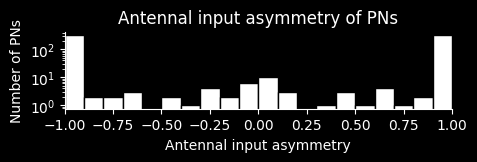

In [124]:
# plot the antennal input asymmetry
plt.figure(figsize=(5, 1))
plt.hist(PNs['antennal_input_asymmetry'], bins=20, color='white', edgecolor='black')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.yscale('log')
plt.xlim(-1, 1)
plt.xlabel('Antennal input asymmetry')
plt.ylabel('Number of PNs')
plt.title('Antennal input asymmetry of PNs')
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/antennal_input_asymmetry.pdf'), bbox_inches='tight', dpi=300)
plt.show()

In [125]:
def get_neuron_class(root_id):
    return classification[classification['root_id'] == root_id]['class'].values[0]

def simplify_cell_type(cell_type):
    # if the cell type has multiple ones separated by a comma, split them
    if ',' not in cell_type:
        return cell_type
    else:
        units = [x.strip() for x in cell_type.split(',')]
        # they might have a the initial part in common, find it
        common = os.path.commonprefix(units)
        # remove the common part from each unit and then join them using '/'
        return common + '/'.join([u.replace(common, '') for u in units])

def get_cell_type(root_id):
    hemibrain_type = classification[classification['root_id'] == root_id]['hemibrain_type'].values[0]
    if hemibrain_type == '':
        cell_type = classification[classification['root_id'] == root_id]['cell_type'].values[0]
        return simplify_cell_type(cell_type)
    else:
        return simplify_cell_type(hemibrain_type)

# replace empty classes with 'other' + superclasses
ids_to_replace = classification['class'] == ''
classification.loc[ids_to_replace, 'class'] = 'other ' + classification.loc[ids_to_replace, 'super_class']

# add clean cell types to the classification
classification['clean_cell_type'] = classification['root_id'].apply(get_cell_type)

# find connections from one set of roots to another
def find_connections(pre_root_ids, post_root_ids):
    connections_from_pre = connections[connections['pre_root_id'].isin(pre_root_ids)].copy().reset_index(drop=True)
    connections_from_pre = connections_from_pre[connections_from_pre['post_root_id'].isin(post_root_ids)]
    # merge connections from same pre and post neurons
    connections_from_pre = connections_from_pre.groupby(['pre_root_id', 'post_root_id']).agg({'syn_count': 'sum'}).reset_index()
    return connections_from_pre

def find_connection_strengths(pre_root_ids, post_root_ids):
    connections_from_pre = connections[connections['pre_root_id'].isin(pre_root_ids)].copy().reset_index(drop=True)
    connections_from_pre = connections_from_pre[connections_from_pre['post_root_id'].isin(post_root_ids)]
    # merge connections from same pre and post neurons
    connections_from_pre = connections_from_pre.groupby(['pre_root_id', 'post_root_id']).agg({'syn_strength': 'sum'}).reset_index()
    return connections_from_pre

def get_cell_side(root_id):
    return classification[classification['root_id'] == root_id]['side'].values[0]

# find the roots by cell type
def find_roots_by_cell_type(cell_type):
    classifieds = classification[classification['clean_cell_type'] == cell_type]
    return classifieds['root_id'].values

In [126]:
neuron_dictionary = {
    "MBON01": "MBON-γ5β′2a",
    "MBON02": "MBON-β2β′2a",
    "MBON03": "MBON-β′2mp",
    "MBON04": "MBON-β′2mp bilateral",
    "MBON05": "MBON-γ4>γ1γ2",
    "MBON06": "MBON-β1>α",
    "MBON07": "MBON-α1",
    "MBON08": "MBON-γ3",
    "MBON09": "MBON-γ3β′1",
    "MBON10": "MBON-β′1",
    "MBON11": "MBON-γ1pedc>α/β",
    "MBON12": "MBON-γ2α′1",
    "MBON13": "MBON-α′2",
    "MBON14": "MBON-α3",
    "MBON15": "MBON-α′1",
    "MBON16": "MBON-α′3ap",
    "MBON17": "MBON-α′3m",
    "MBON18": "MBON-α2sc",
    "MBON19": "MBON-α2p3p",
    "MBON20": "MBON-γ1γ2",
    "MBON21": "MBON-γ4γ5",
    "MBON22": "MBON-calyx",
    "MBON23": "MBON-α2sp",
    "MBON24": "MBON-β2γ5",
    "MBON25": "MBON-γ1γ2",
    "MBON26": "MBON-β′2d",
    "MBON27": "MBON-γ5d",
    "MBON28": "MBON-α′3a",
    "MBON29": "MBON-γ4γ5",
    "MBON30": "MBON-γ1γ2γ3",
    "MBON31": "MBON-α′1a",
    "MBON32": "MBON-γ2",
    "MBON33": "MBON-γ2γ3",
    "MBON34": "MBON-γ2",
    "MBON35": "MBON-γ2",
    "PAM01": "PAM-γ5",
    "PAM02": "PAM-β′2a",
    "PAM03": "PAM-β2β′2a",
    "PAM04": "PAM-β2",
    "PAM05": "PAM-β′2p",
    "PAM06": "PAM-β′2m",
    "PAM07": "PAM-γ4<γ1γ2",
    "PAM08": "PAM-γ4",
    "PAM09": "PAM-β1ped",
    "PAM10": "PAM-β1",
    "PAM11": "PAM-α1",
    "PAM12": "PAM-γ3",
    "PAM13": "PAM-β′1 ap",
    "PAM14": "PAM-β′1 m",
    "PPL101": "PPL1-γ1pedc",
    "PPL102": "PPL1-γ1‡‡",
    "PPL103": "PPL1-γ2α′1",
    "PPL104": "PPL1-α′3",
    "PPL105": "PPL1-α′2α2",
    "PPL106": "PPL1-α3",
    "PPL201": "PPL2-a"  
}

In [127]:
def network_influence_propagate(input_root_ids, input_values, exclude_downstream=None):
    # find all downstream connections
    downstream_connections = connections[connections['pre_root_id'].isin(input_root_ids)].copy().reset_index(drop=True)
    # remove connections with invalid synapse strength
    downstream_connections = downstream_connections[np.logical_not(np.isnan(downstream_connections['syn_strength']))]
    downstream_connections = downstream_connections[np.logical_and(downstream_connections['syn_strength'] > 0, downstream_connections['syn_strength'] < 1)]
    if exclude_downstream is not None:
        # remove excluded downstream neurons
        downstream_connections = downstream_connections[np.logical_not(downstream_connections['post_root_id'].isin(exclude_downstream))]
    # find all downstream neurons
    downstream_neurons = np.unique(downstream_connections['post_root_id'])
    # create a mapping from root id to index
    root_to_input = {r:i for i,r in enumerate(input_root_ids)}
    root_to_output = {r:i for i,r in enumerate(downstream_neurons)}
    # create a connectivity matrix
    connection_matrix = np.zeros((len(downstream_neurons), len(input_root_ids)))
    connection_counts = np.zeros((len(downstream_neurons), len(input_root_ids)))
    # fill the matrix
    for i in tqdm(downstream_connections.index):
        pre_id = downstream_connections.loc[i, 'pre_root_id']
        post_id = downstream_connections.loc[i, 'post_root_id']
        pre_index = root_to_input[pre_id]
        post_index = root_to_output[post_id]
        if connection_matrix[post_index, pre_index] == 0:
            connection_matrix[post_index, pre_index] = downstream_connections.loc[i, 'syn_strength']
        else:
            connection_matrix[post_index, pre_index] += downstream_connections.loc[i, 'syn_strength']
        connection_counts[post_index, pre_index] += 1
    # calculate the geometric mean of the connections
    # make zeros 1
    # connection_counts[connection_counts == 0] = 1
    # connection_matrix = np.power(connection_matrix, 1/connection_counts)
    # propagate the values
    output_values = np.dot(connection_matrix, input_values)
    # mixing strength (variance of the inputs received by each neuron)
    mixing_strength = np.std(connection_matrix*input_values, axis=1)
    return downstream_neurons, output_values, mixing_strength

In [128]:
recalculate = False

In [129]:
input_values = PNs['antennal_input_asymmetry'].values

N_steps = 5
exclude_visited = False

layers = []
lateralizations = []
mixing_strengths = []

visited_neurons = np.array([])

output_values = input_values
downstream_neurons = PNs['root_id'].values
mixing_strength = np.zeros(len(downstream_neurons))

for i in range(N_steps):
    layers.append(downstream_neurons)
    lateralizations.append(output_values)
    mixing_strengths.append(mixing_strength)

    if exclude_visited:
        # add the downstream neurons to the visited neurons
        visited_neurons = np.concatenate((visited_neurons, downstream_neurons))
        # make sure the visited neurons are unique
        visited_neurons = np.unique(visited_neurons)

    print('Step', i, end=': ')
    if os.path.exists(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_downstream_neurons_step_{}.npy'.format(i))) and not recalculate:
        print('Data exists. Loading... ', end='')
        output_values = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_output_values_step_{}.npy'.format(i)))
        downstream_neurons = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_downstream_neurons_step_{}.npy'.format(i)))
        mixing_strength = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_mixing_strength_step_{}.npy'.format(i)))
        print('N={}'.format(len(downstream_neurons)), end=' ')
        print('Done.')
    else:
        print('Propagating... ', end='')
        downstream_neurons, output_values, mixing_strength = network_influence_propagate(downstream_neurons, output_values, exclude_downstream=visited_neurons if exclude_visited else None)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_output_values_step_{}.npy'.format(i)), output_values)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_downstream_neurons_step_{}.npy'.format(i)), downstream_neurons)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_mixing_strength_step_{}.npy'.format(i)), mixing_strength)
        print('N={}'.format(len(downstream_neurons)), end=' ')
        print('Done.')

# add the last step
layers.append(downstream_neurons)
lateralizations.append(output_values)
mixing_strengths.append(mixing_strength)


Step 0: Data exists. Loading... N=20060 Done.
Step 1: Data exists. Loading... N=99016 Done.
Step 2: Data exists. Loading... N=135199 Done.
Step 3: Data exists. Loading... N=137353 Done.
Step 4: Data exists. Loading... N=137794 Done.


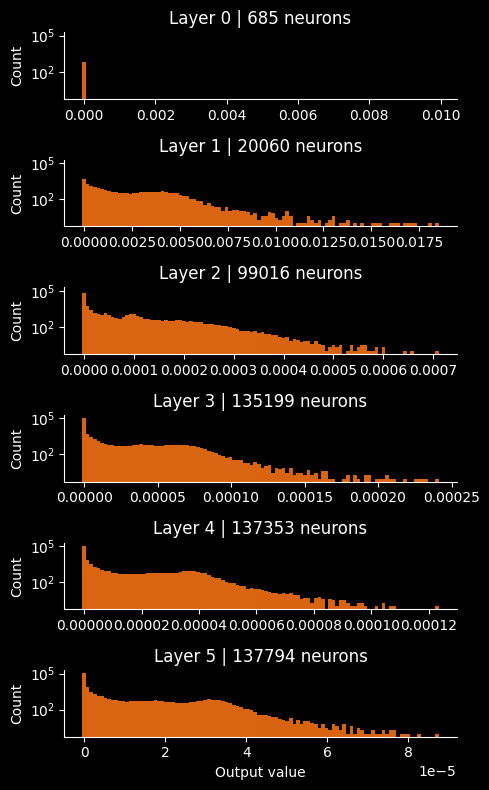

In [130]:
# plot the values (histogram) for each step
fig,ax = plt.subplots(N_steps+1,1,figsize=(5,8), sharey=True)
for i in range(N_steps+1):
    if np.all(mixing_strengths[i] == 0):
        bins, edges = np.histogram(mixing_strengths[i], bins=np.linspace(0, 0.01, 100))
    else:
        bins, edges = np.histogram(mixing_strengths[i], bins=100)
    max_lateralization = np.max(mixing_strengths[i])
    ax[i].bar(edges[:-1], bins, width=np.diff(edges), color=cm_ofb(np.linspace(0.5-max_lateralization/2, 0.5+max_lateralization/2, 100)))
    ax[i].set_title('Layer {} | {} neurons'.format(i, len(layers[i])))
    ax[i].set_ylabel('Count')
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].set_yscale('log') 
ax[N_steps].set_xlabel('Output value')
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_mixing.pdf'), bbox_inches='tight', dpi=300)
plt.show()

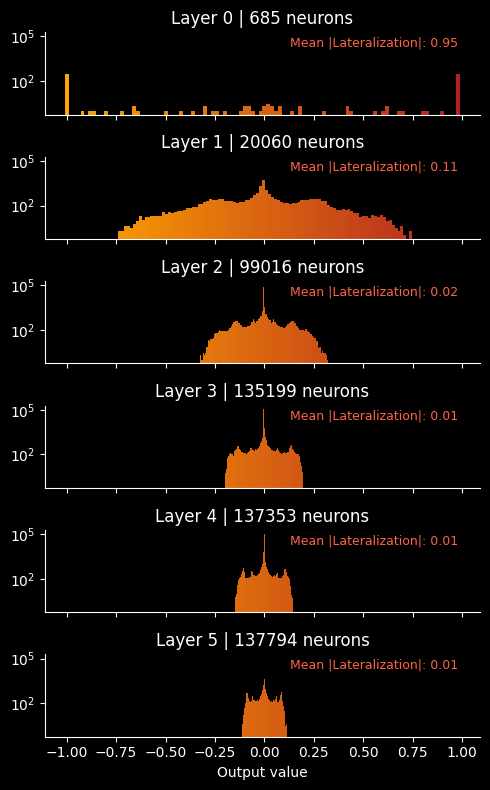

In [131]:
# plot the values (histogram) for each step
fig,ax = plt.subplots(N_steps+1,1,figsize=(5,8), sharex=True, sharey=True)
for i in range(N_steps+1):
    bins, edges = np.histogram(lateralizations[i], bins=100)
    max_lateralization = np.max(np.abs(lateralizations[i]))
    ax[i].bar(edges[:-1], bins, width=np.diff(edges), color=cm_ofb(np.linspace(0.5-max_lateralization/2, 0.5+max_lateralization/2, 100)))
    ax[i].text(0.95, 0.95, 'Mean |Lateralization|: {:.2f}'.format(np.mean(np.abs(lateralizations[i]))), ha='right', va='top', transform=ax[i].transAxes, color='tomato', fontsize=9)
    ax[i].set_title('Layer {} | {} neurons'.format(i, len(layers[i])))
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].set_yscale('log') 
ax[N_steps].set_xlabel('Output value')
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity.pdf'), bbox_inches='tight', dpi=300)
plt.show()

In [132]:
layer_classes = [[get_neuron_class(n) for n in tqdm(layer)] for layer in layers]

  0%|          | 0/685 [00:00<?, ?it/s]

  0%|          | 0/20060 [00:00<?, ?it/s]

  0%|          | 0/99016 [00:00<?, ?it/s]

  0%|          | 0/135199 [00:00<?, ?it/s]

  0%|          | 0/137353 [00:00<?, ?it/s]

  0%|          | 0/137794 [00:00<?, ?it/s]

Layer 1

Unique visited neurons: 20060


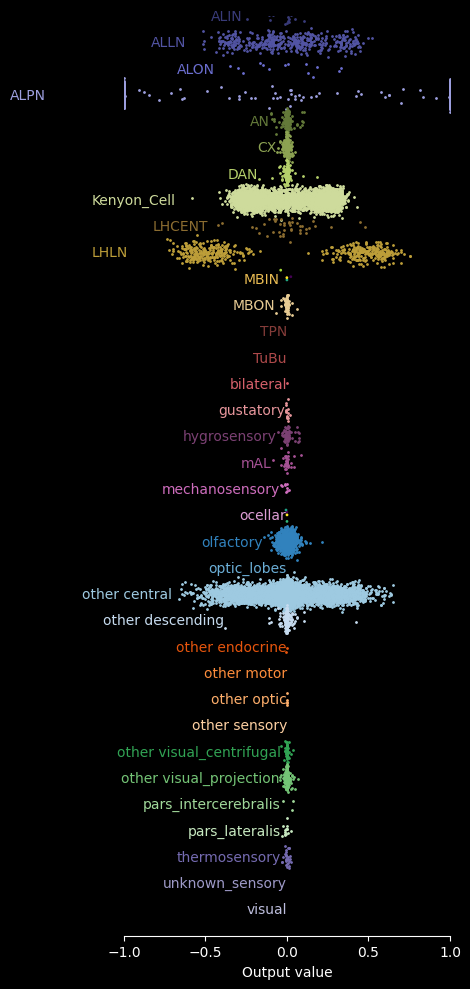

Layer 2

Unique visited neurons: 99016


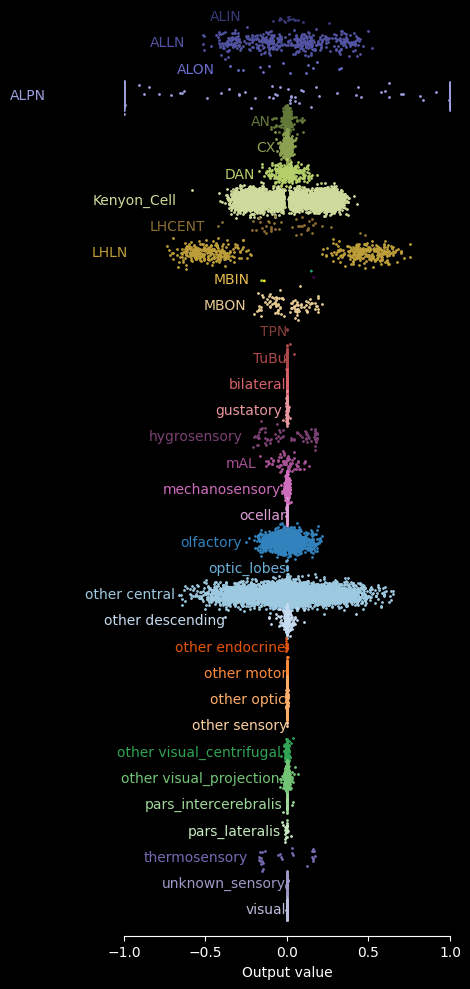

Layer 3

Unique visited neurons: 135199


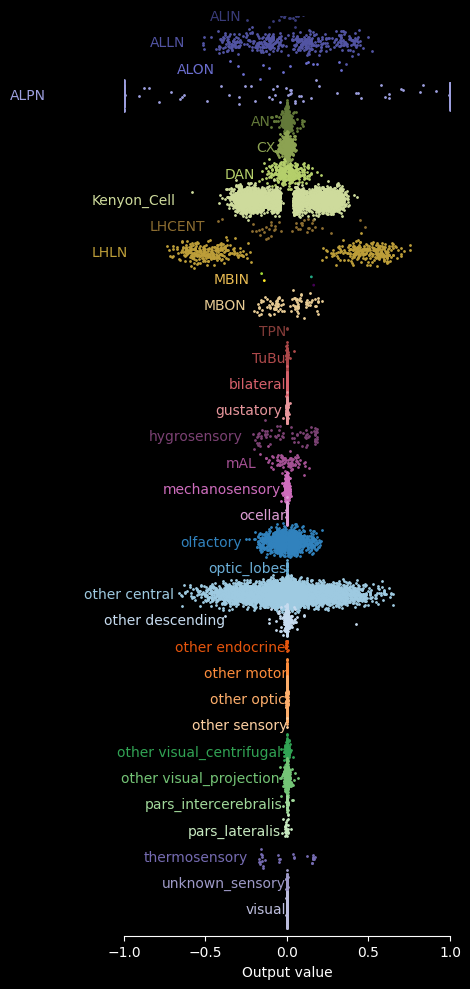

Layer 4

Unique visited neurons: 137353


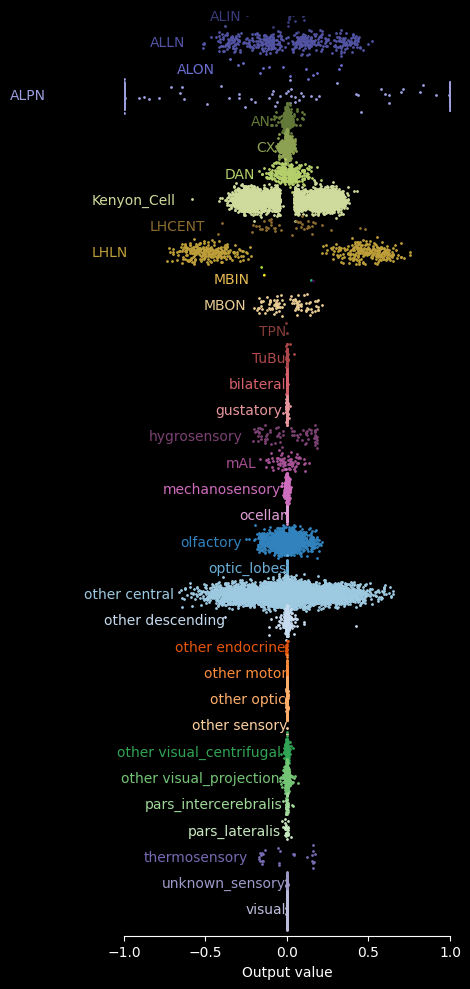

Layer 5

Unique visited neurons: 137794


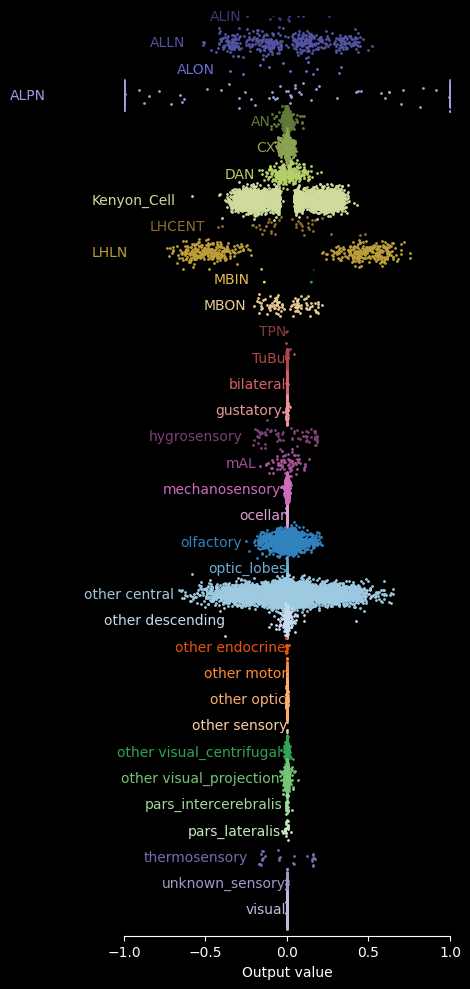

In [139]:
visited_neurons = layers[0]
visited_values = lateralizations[0]
visited_classes = layer_classes[0]

classes = np.unique(classification['class'].values)

n_classes = len(classes)
class_to_index = {c:i for i,c in enumerate(classes)}
index_to_class = {i:c for i,c in enumerate(classes)}

for layer_no in range(1,N_steps+1):
    print('Layer', layer_no, end='\n\n')
    
    neurons = layers[layer_no]
    values = lateralizations[layer_no]
    classes = layer_classes[layer_no]

    # add the visited neurons to the visited neurons
    visited_neurons = np.concatenate((visited_neurons, neurons))
    visited_values = np.concatenate((visited_values, values))
    visited_classes = np.concatenate((visited_classes, classes))
    # make sure the visited neurons are unique
    unique_visited_neurons = np.unique(visited_neurons)
    print('Unique visited neurons:', len(unique_visited_neurons))
    # get the max value for each visited neuron
    visited_values_max_index = np.array([np.argmax(np.abs(visited_values[visited_neurons == n])) for n in unique_visited_neurons])
    visited_values = np.array([visited_values[visited_neurons == n][i] for n,i in zip(unique_visited_neurons, visited_values_max_index)])
    visited_classes = np.array([visited_classes[visited_neurons == n][0] for n in unique_visited_neurons])
    visited_neurons = unique_visited_neurons

    class_ids = [class_to_index[c] for c in visited_classes]
    class_ids = np.array(class_ids)

    # scatter plot of the values
    plt.figure(figsize=(5,10))
    for i in range(n_classes):
        # get the values for the class
        class_values = visited_values[class_ids == i]
        # plot the values
        plt.scatter(class_values, -i + 0.2*np.random.randn(len(class_values)), c=cm_tab40(i), s=1)
        # put the name of the class next to the points
        plt.text(np.nanmin(class_values)-0.5*np.mean(np.abs(class_values)) if len(class_values) > 0 else 0, -i, index_to_class[i], verticalalignment='center', horizontalalignment='right', fontsize=10, color=cm_tab40(i))
    max_value = np.max(np.abs(visited_values))
    plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_classes, 0)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_max_connectivity_class_layer_{}.pdf'.format(layer_no)), bbox_inches='tight', dpi=300)
    plt.show()

In [185]:
# get cell types of each neuron
visited_cell_types = [get_cell_type(n) for n in visited_neurons]
# use neuron_dictionary to replace the cell types with the names if they are in the dictionary
visited_cell_types = [neuron_dictionary.get(ct, ct) for ct in visited_cell_types]
# save the max lateralization metrics
max_lateralization_metrics = pd.DataFrame({
    'root_id': visited_neurons,
    'max_lateralization': visited_values,
    'class': visited_classes,
    'cell_type': visited_cell_types
})

max_lateralization_metrics.to_csv(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_max_lateralization_metrics.csv'), index=False)

In [186]:
# load the max lateralization metrics
max_lateralization_metrics = pd.read_csv(os.path.join(processed_data_folder, 'ALPN_connectivity/NIP_ALPN_max_lateralization_metrics.csv'))


In [187]:
max_lateralization_metrics

,root_id,max_lateralization,class,cell_type
0,720575940596125868,-0.000239,other optic,T5c
1,720575940597856265,-0.000443,other optic,Tm16
2,720575940597944841,-0.000363,other optic,CB3851
3,720575940598267657,-0.000156,other optic,TmY15
4,720575940599333574,-0.000051,other optic,Tm1
...,...,...,...,...
137789,720575940661335681,-0.000169,other central,CB0180
137790,720575940661336193,0.000085,other optic,TmY3
137791,720575940661337217,0.055643,Kenyon_Cell,KCab-p
137792,720575940661338497,-0.000062,other motor,CB0904




Investigating class Kenyon_Cell 

Cell type KCab-p N= 128 mean= 0.05317522937562172
Cell type KCg-d N= 295 mean= 0.061668123610618915
Cell type KCg-s3 N= 1 mean= 0.0639769793881332
Cell type KCg-s1 N= 2 mean= 0.07676042618458215
Cell type KCab-ap2 N= 298 mean= 0.07756929204580232
Cell type KCab-ap1 N= 280 mean= 0.08513270269138887
Cell type KCg-s2 N= 2 mean= 0.0966471967711051
Cell type KCab-s N= 621 mean= 0.17626205531574837
Cell type KCab-m N= 957 mean= 0.1858116058366368
Cell type KCg-m N= 2190 mean= 0.24160358896228096
Cell type KCab-c N= 403 mean= 0.2572132638793554


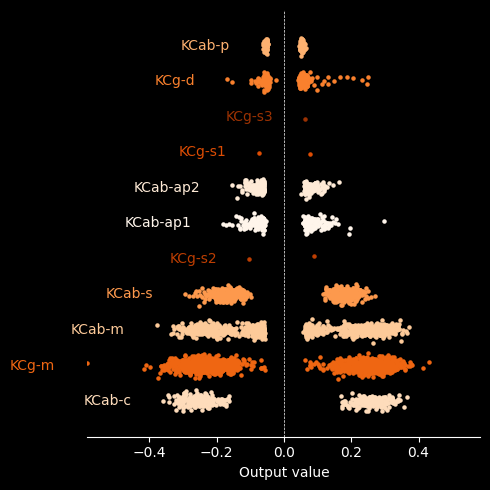



Investigating class DAN 

Cell type PPL108 N= 2 mean= 0.0052166678900489
Cell type PPL1-γ2α′1 N= 2 mean= 0.01042776320807025
Cell type PPL107 N= 2 mean= 0.018017418973418547
Cell type PPL1-α′2α2 N= 2 mean= 0.0192488558449531
Cell type PAM15 N= 1 mean= 0.0198727989668779
Cell type PAM-β′2m N= 31 mean= 0.02179228320967242
Cell type PAM-β′1 ap N= 12 mean= 0.02256595786042731
Cell type PAM-β′2p N= 22 mean= 0.02343770649227552
Cell type PPL1-γ1pedc N= 2 mean= 0.024076413023868898
Cell type PAM-γ3 N= 23 mean= 0.024800843371395494
Cell type PAM-β′2a N= 13 mean= 0.02576484827672954
Cell type PAM-β′1 m N= 16 mean= 0.02583784349568599
Cell type PPL204 N= 2 mean= 0.026952378397382598
Cell type PPL1-α′3 N= 2 mean= 0.03133306124292535
Cell type PPL1-α3 N= 2 mean= 0.0326711913021899
Cell type PAM-β2β′2a N= 10 mean= 0.03380632104533353
Cell type PAM-β1 N= 13 mean= 0.034993559832673354
Cell type PAM-β1ped N= 11 mean= 0.04353154511192752
Cell type PAM-α1 N= 16 mean= 0.049267028289147176
Cell type CB2

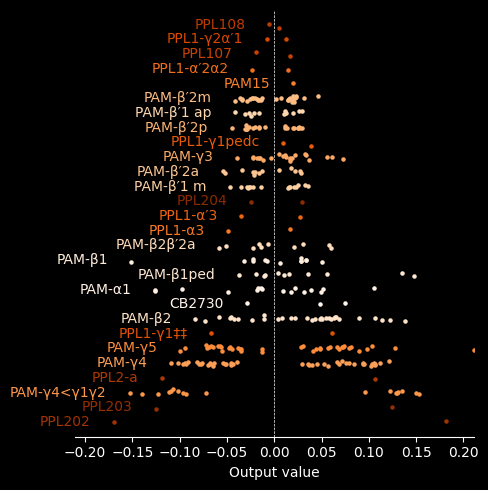



Investigating class MBON 

Cell type MBON-γ2γ3 N= 2 mean= 0.0231287833733496
Cell type MBON-β′2d N= 2 mean= 0.0238269546627874
Cell type MBON-γ5d N= 2 mean= 0.038349356797242745
Cell type MBON-β2β′2a N= 2 mean= 0.0392536911962871
Cell type MBON-β′2mp bilateral N= 2 mean= 0.0408773549870987
Cell type MBON-α′1a N= 2 mean= 0.051984628319935194
Cell type MBON-β′1 N= 9 mean= 0.05311558517666273
Cell type MBON-β′2mp N= 2 mean= 0.05705891445873425
Cell type MBON-γ2 N= 4 mean= 0.05855044080593558
Cell type MBON-α2p3p N= 4 mean= 0.059847611563701456
Cell type MBON-α′2 N= 2 mean= 0.06280181311833241
Cell type MBON15-like N= 5 mean= 0.06535437330766523
Cell type MBON-α′1 N= 4 mean= 0.0691965716535682
Cell type MBON-α′3m N= 2 mean= 0.0696313297941363
Cell type MBON17-like N= 2 mean= 0.06989942746956575
Cell type MBON-α′3ap N= 2 mean= 0.07095241584093635
Cell type MBON-γ1γ2 N= 2 mean= 0.08302594129280215
Cell type MBON-α′3a N= 2 mean= 0.0969950288228779
Cell type MBON25/34 N= 6 mean= 0.0991148351

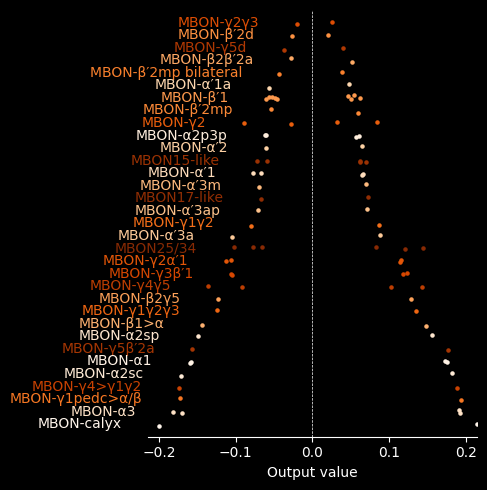



Investigating class LHCENT 

Cell type LHCENT14 N= 2 mean= 0.0352308825069275
Cell type LHCENT11 N= 2 mean= 0.05266507566189025
Cell type LHCENT5 N= 2 mean= 0.08036353850675296
Cell type LHCENT10 N= 4 mean= 0.09590683090964565
Cell type LHCENT13 N= 10 mean= 0.10183439755421711
Cell type LHCENT4 N= 2 mean= 0.1077796945962228
Cell type LHCENT6 N= 2 mean= 0.1276432737148851
Cell type LHCENT9 N= 2 mean= 0.12934838901935455
Cell type LHCENT3 N= 2 mean= 0.1336360047157393
Cell type LHCENT1 N= 2 mean= 0.1533040436466815
Cell type LHCENT8 N= 4 mean= 0.172569773105716
Cell type LHCENT2 N= 2 mean= 0.2108435992857639
Cell type LHCENT12 N= 6 mean= 0.37321070045898064


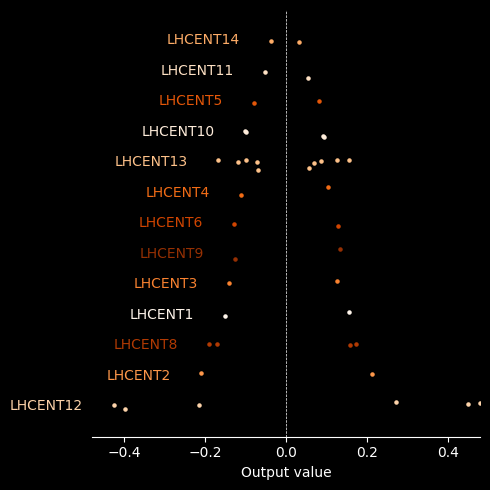

In [191]:
# investigate a single class in the form of cell types
for class_to_investigate in ['Kenyon_Cell', 'DAN', 'MBON', 'LHCENT']:
    print('\n\nInvestigating class', class_to_investigate, '\n')

    # get the neurons of the class from the max lateralization metrics
    class_neurons = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['root_id'].values
    class_values = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['max_lateralization'].values
    class_cell_types = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['cell_type'].values

    # get the unique cell types
    unique_cell_types = np.unique(class_cell_types)
    n_cell_types = len(unique_cell_types)

    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    # get the average lateralization for each cell type
    cell_type_values = np.zeros(n_cell_types)

    for i in range(n_cell_types):
        cell_type_values[i] = np.nanmean(np.abs(class_values[class_cell_types == unique_cell_types[i]]))
        
    # sort the cell types by average lateralization
    sorted_indices = np.argsort(cell_type_values)

    # scatter plot of the values
    plt.figure(figsize=(5,5))
    for i, idx in enumerate(sorted_indices):
        # get the values for the class
        cell_type_values = class_values[class_cell_types == unique_cell_types[idx]]
        print('Cell type', index_to_cell_type[idx], 'N=', len(cell_type_values), 'mean=', np.nanmean(np.abs(cell_type_values)))
        # plot the values
        plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
        # put the name of the class next to the points
        plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(class_values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
    # draw the zero line
    plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
    max_value = np.max(np.abs(class_values))
    plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_cell_types, 1)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_max_connectivity_{}_cell_types.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
    plt.show()



In [ ]:
max_lateralization_metrics[max_lateralization_metrics['cell_type'].str.startswith('FB').isna()]

,root_id,max_lateralization,class,cell_type
28,720575940600722348,-0.000418,other optic,NaN
51,720575940602309600,0.000073,AN,NaN
101,720575940602953388,-0.000587,AN,NaN
197,720575940603457760,0.000269,other optic,NaN
199,720575940603461478,-0.000273,AN,NaN
...,...,...,...,...
137717,720575940661134465,-0.000302,other optic,NaN
137724,720575940661143681,0.000651,other optic,NaN
137743,720575940661210497,-0.000677,other optic,NaN
137750,720575940661243777,-0.000127,other optic,NaN




Investigating class LHLN 

Cell type CB2862 N= 4 mean= 0.23683088961584325
Cell type CB2920 N= 5 mean= 0.27194299320123017
Cell type CB2739 N= 3 mean= 0.2775911511467602
Cell type CB0311 N= 2 mean= 0.2781149022294281
Cell type LHAV4g17 N= 2 mean= 0.2893909268022158
Cell type CB2958 N= 2 mean= 0.3072998799196261
Cell type LHAV4b2 N= 10 mean= 0.31315125093412094
Cell type LHAV4a2 N= 4 mean= 0.31448643184778896
Cell type CB2904 N= 2 mean= 0.3197567302255848
Cell type CB1726 N= 2 mean= 0.3208809036891176
Cell type CB2224 N= 3 mean= 0.33061697195894607
Cell type CB1286 N= 3 mean= 0.33448013700822604
Cell type CB1160 N= 5 mean= 0.33987358255597366
Cell type CB2851 N= 3 mean= 0.34330774282866994
Cell type CB0367 N= 2 mean= 0.34375236726467345
Cell type LHPD3a2 N= 5 mean= 0.359243840170552
Cell type CB3131 N= 2 mean= 0.36153618728343284
Cell type CB2091 N= 5 mean= 0.3618124216047403
Cell type LHPV4a11 N= 2 mean= 0.3761785856349916
Cell type LHPV4a2/3 N= 4 mean= 0.3786882818709432
Cell type L

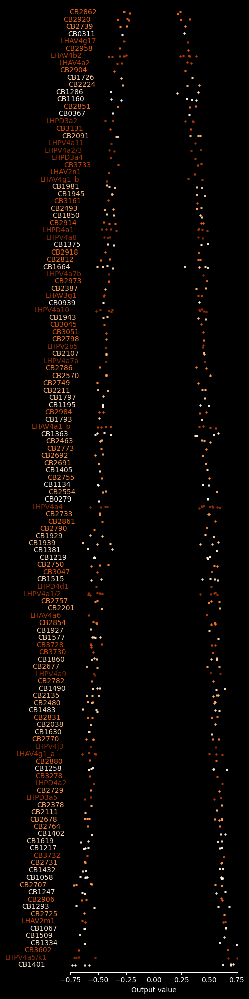

In [193]:
# investigate a single class in the form of cell types
for class_to_investigate in ['LHLN']:
    print('\n\nInvestigating class', class_to_investigate, '\n')

    # get the neurons of the class from the max lateralization metrics
    class_neurons = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['root_id'].values
    class_values = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['max_lateralization'].values
    class_cell_types = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['cell_type'].values

    # get the unique cell types
    unique_cell_types = np.unique(class_cell_types)
    n_cell_types = len(unique_cell_types)

    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    # get the average lateralization for each cell type
    cell_type_values = np.zeros(n_cell_types)

    for i in range(n_cell_types):
        cell_type_values[i] = np.nanmean(np.abs(class_values[class_cell_types == unique_cell_types[i]]))
        
    # sort the cell types by average lateralization
    sorted_indices = np.argsort(cell_type_values)

    # scatter plot of the values
    plt.figure(figsize=(5,20))
    for i, idx in enumerate(sorted_indices):
        # get the values for the class
        cell_type_values = class_values[class_cell_types == unique_cell_types[idx]]
        print('Cell type', index_to_cell_type[idx], 'N=', len(cell_type_values), 'mean=', np.nanmean(np.abs(cell_type_values)))
        # plot the values
        plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
        # put the name of the class next to the points
        plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(class_values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
    # draw the zero line
    plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
    max_value = np.max(np.abs(class_values))
    plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_cell_types, 1)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_max_connectivity_{}_cell_types.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
    plt.show()





Investigating class FB 

Cell type FB4Z N= 16 mean= 0.0001626185327658908
Cell type FB5S/6L N= 6 mean= 0.00039044423489534996
Cell type FB4Z/5U/5R N= 12 mean= 0.0004651405368339583
Cell type FB3A N= 4 mean= 0.0005581762676665
Cell type FB7J N= 4 mean= 0.000941577133731375
Cell type FB5A N= 4 mean= 0.0009694614078888
Cell type FB2B N= 7 mean= 0.0014665287898929
Cell type FB4Y N= 6 mean= 0.0016810829820073335
Cell type FB6M N= 4 mean= 0.00211021981098675
Cell type FB5O N= 3 mean= 0.0021109388705222334
Cell type FB4M N= 4 mean= 0.00234026876772905
Cell type FB6O N= 2 mean= 0.0026195576452483
Cell type FB4B N= 2 mean= 0.0026978615819119997
Cell type FB8C N= 4 mean= 0.003070928926102825
Cell type FB5D/E N= 2 mean= 0.0030964701768168
Cell type FB4A/D/E/F/G/H/I/J N= 36 mean= 0.0031953638707759666
Cell type FB4Q_b N= 4 mean= 0.003284255838691875
Cell type FB4P_a N= 5 mean= 0.0034074758956636
Cell type FB4C N= 2 mean= 0.0034109408564195
Cell type FB4N N= 2 mean= 0.00341195907936745
Cell type 

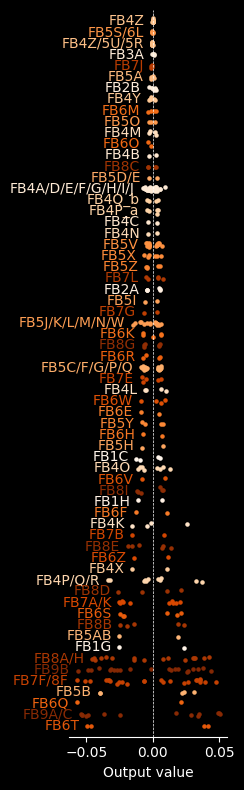



Investigating class CB.FB 

Cell type CB.FB6B1 N= 8 mean= 0.0006175780936593001
Cell type CB.FB7B0 N= 5 mean= 0.00072021320625164
Cell type CB.FB2I1 N= 6 mean= 0.0017958306941725335
Cell type CB.FB2E10 N= 4 mean= 0.0024892101810935
Cell type CB.FB6I0 N= 4 mean= 0.00258401636235305
Cell type CB.FB2E8 N= 4 mean= 0.00261537251722755
Cell type CB.FB5I4 N= 1 mean= 0.0028250313619525
Cell type CB.FB6D0 N= 1 mean= 0.0029895318790874
Cell type CB.FBTI0 N= 6 mean= 0.003376940644859867
Cell type CB.FB5I3 N= 1 mean= 0.0035532106044258
Cell type CB.FB2I3 N= 5 mean= 0.0039692484357822
Cell type CB.FB5I2 N= 3 mean= 0.0040571819135643
Cell type CB.FB6E5 N= 2 mean= 0.0043085578765596
Cell type CB.FB2I2 N= 6 mean= 0.004539604964747884
Cell type CB.FB6D2 N= 2 mean= 0.0046143370028138
Cell type CB.FB5I1 N= 3 mean= 0.0046835279794315
Cell type CB.FB2E0 N= 4 mean= 0.00522062193320935
Cell type CB.FB5I0 N= 1 mean= 0.0052468773172995
Cell type CB.FB7D0 N= 10 mean= 0.005284260999284881
Cell type CB.FB3/4L1 

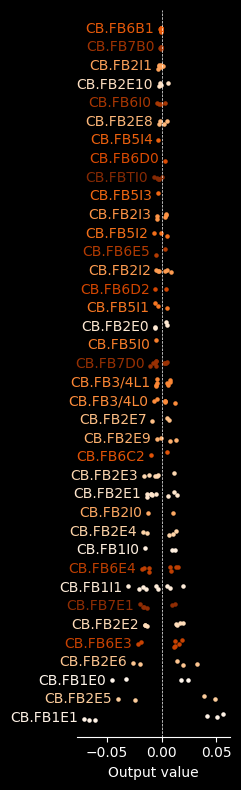



Investigating class FC/FS/hDelta/vDelta/FR 

Cell type hDeltaA N= 10 mean= 0.00023349312005783093
Cell type FR1 N= 18 mean= 0.00028999185418084446
Cell type hDeltaI N= 20 mean= 0.0004142135257469647
Cell type hDeltaB N= 18 mean= 0.0004281024894906833
Cell type FC1A/B/F N= 43 mean= 0.00045072769028318163
Cell type FC2A N= 16 mean= 0.0005120228517725375
Cell type hDeltaH N= 8 mean= 0.0005178166385011625
Cell type hDeltaG N= 8 mean= 0.00052113565274475
Cell type hDeltaM N= 8 mean= 0.0005323755853481
Cell type FC1C N= 27 mean= 0.0005851949296662445
Cell type hDeltaK N= 31 mean= 0.000654636639738171
Cell type FC3 N= 40 mean= 0.000683772972439905
Cell type FC2B N= 28 mean= 0.0006986763075649143
Cell type FR2 N= 17 mean= 0.0007415380010645529
Cell type FS2 N= 38 mean= 0.0007631752400654948
Cell type hDeltaJ N= 30 mean= 0.00076801436727656
Cell type vDeltaF/G/H/I N= 74 mean= 0.0007927993945312715
Cell type FC1D/E N= 38 mean= 0.0008065588065158868
Cell type hDeltaL N= 12 mean= 0.0009121774544

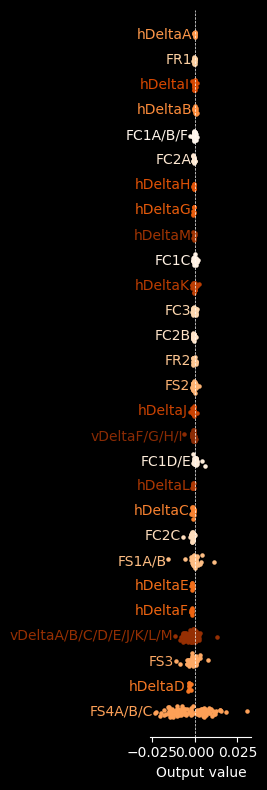

In [356]:
# investigate a single cell type that starts with 'FB' or 'CB
for class_to_investigate in ['FB','CB.FB','FC/FS/hDelta/vDelta/FR']:
    print('\n\nInvestigating class', class_to_investigate, '\n')

    # mask by cell type
    filter_labels = class_to_investigate.split('/')
    masks = [max_lateralization_metrics['cell_type'].str.startswith(f) for f in filter_labels]
    mask = np.logical_or.reduce(masks)
    # set nans to False
    mask[max_lateralization_metrics['cell_type'].isna()] = False


    # get the neurons of the class from the max lateralization metrics
    class_neurons = max_lateralization_metrics[mask]['root_id'].values
    class_values = max_lateralization_metrics[mask]['max_lateralization'].values
    class_cell_types = max_lateralization_metrics[mask]['cell_type'].values

    # get the unique cell types
    unique_cell_types = np.unique(class_cell_types)
    n_cell_types = len(unique_cell_types)

    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    # get the average lateralization for each cell type
    cell_type_values = np.zeros(n_cell_types)

    for i in range(n_cell_types):
        cell_type_values[i] = np.nanmean(np.abs(class_values[class_cell_types == unique_cell_types[i]]))
        
    # sort the cell types by average lateralization
    sorted_indices = np.argsort(cell_type_values)

    # scatter plot of the values
    plt.figure(figsize=(2.5,8))
    for i, idx in enumerate(sorted_indices):
        # get the values for the class
        cell_type_values = class_values[class_cell_types == unique_cell_types[idx]]
        print('Cell type', index_to_cell_type[idx], 'N=', len(cell_type_values), 'mean=', np.nanmean(np.abs(cell_type_values)))
        # plot the values
        plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
        # put the name of the class next to the points
        plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(class_values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
    # draw the zero line
    plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
    # max_value = np.max(np.abs(class_values))
    # plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_cell_types, 1)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_max_connectivity_{}_cell_types.pdf'.format(class_to_investigate.replace('/','-'))), bbox_inches='tight', dpi=300)
    plt.show()





Investigating class CX 

Cell type LPsP N= 2 mean= 0.00014352597036872863
Cell type PFL2 N= 12 mean= 0.00020223452210585
Cell type Delta7 N= 40 mean= 0.00024170782027213255
Cell type P6-8P9 N= 4 mean= 0.000242518008344725
Cell type PFL3 N= 24 mean= 0.0002592018106375913
Cell type GLNO N= 4 mean= 0.000262444403659275
Cell type PEN_b(PEN2) N= 22 mean= 0.00029117856149113636
Cell type P1-9 N= 2 mean= 0.00029614245110705
Cell type EPGt N= 4 mean= 0.000302291846547575
Cell type PFR N= 30 mean= 0.0003167501601851965
Cell type PFL1 N= 14 mean= 0.00035019228480666874
Cell type PFNd N= 40 mean= 0.0003512241333266309
Cell type EL N= 17 mean= 0.0004099993298622823
Cell type PEN_a(PEN1) N= 20 mean= 0.00046301436103611
Cell type IbSpsP N= 30 mean= 0.0005211564186491033
Cell type PEG N= 20 mean= 0.000553327673981265
Cell type PFGs N= 24 mean= 0.0005803989941375542
Cell type LNO2 N= 2 mean= 0.00058846097165465
Cell type EPG N= 47 mean= 0.0006601233037923809
Cell type PFNv N= 21 mean= 0.000738190166

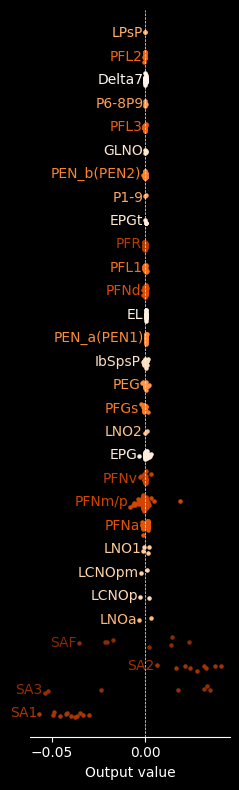

In [ ]:
# investigate a single cell type that starts with 'FB' or 'CB
cell_types_to_exclude = ['FB','CB.FB','ER','ExR','FC','FS','FR','hDelta','vDelta']
for class_to_investigate in ['CX']:
    print('\n\nInvestigating class', class_to_investigate, '\n')

    # mask by cell type
    filter_labels = cell_types_to_exclude
    masks = [max_lateralization_metrics['cell_type'].str.startswith(f) for f in filter_labels]
    exclude_mask = np.logical_or.reduce(masks)
    # set nans to False
    exclude_mask[max_lateralization_metrics['cell_type'].isna()] = False
    # remove the excluded cell types
    exclude_mask = np.logical_not(exclude_mask)

    cleaned_lateralization = max_lateralization_metrics[exclude_mask]
    # get the neurons of the class from the max lateralization metrics
    class_neurons = cleaned_lateralization[cleaned_lateralization['class'] == class_to_investigate]['root_id'].values
    class_values = cleaned_lateralization[cleaned_lateralization['class'] == class_to_investigate]['max_lateralization'].values
    class_cell_types = cleaned_lateralization[cleaned_lateralization['class'] == class_to_investigate]['cell_type'].values
    # turn class_cell_types into a list of strings
    class_cell_types = np.array([str(x) for x in class_cell_types])

    # remove nan cell types
    remove_mask = class_cell_types == 'nan'
    class_cell_types = class_cell_types[np.logical_not(remove_mask)]
    class_values = class_values[np.logical_not(remove_mask)]
    class_neurons = class_neurons[np.logical_not(remove_mask)]


    # get the unique cell types
    unique_cell_types = np.unique(class_cell_types)
    n_cell_types = len(unique_cell_types)

    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    # get the average lateralization for each cell type
    cell_type_values = np.zeros(n_cell_types)

    for i in range(n_cell_types):
        cell_type_values[i] = np.nanmean(np.abs(class_values[class_cell_types == unique_cell_types[i]]))
        
    # sort the cell types by average lateralization
    sorted_indices = np.argsort(cell_type_values)

    # scatter plot of the values
    plt.figure(figsize=(2.5,8))
    for i, idx in enumerate(sorted_indices):
        # get the values for the class
        cell_type_values = class_values[class_cell_types == unique_cell_types[idx]]
        print('Cell type', index_to_cell_type[idx], 'N=', len(cell_type_values), 'mean=', np.nanmean(np.abs(cell_type_values)))
        # plot the values
        plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
        # put the name of the class next to the points
        plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(class_values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
    # draw the zero line
    plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
    # max_value = np.max(np.abs(class_values))
    # plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_cell_types, 1)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_max_connectivity_{}_cell_types.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
    plt.show()



In [357]:
def get_skeletons_by_root_id(root_ids):
    return flywire.get_l2_skeleton(root_ids)

# get the neuropils from fafbseg
cx =   flywire.get_neuropil_volumes(['EB','FB','PB','NO'])

def plot_skeletons_with_values(
        skeletons, 
        values, 
        color_map, 
        vmin=None, 
        vmax=None, 
        neuron_alpha=0.5, 
        neuron_width=0.5,
        azimuth=-90,
        elevation=-90,
        show_flywire=False,
        show_cx=False,
        title=None,
        save_path=None
    ):
    # convert values to colors
    colors = color_map((values - vmin) / (vmax - vmin))
    # plot the skeletons
    fig, ax = navis.plot2d(skeletons, color=colors, lw=neuron_width, alpha=neuron_alpha, method='3d', figsize=(20,20), autoscale=True)
    if show_flywire:
        _ = navis.plot2d(flybrains.FLYWIRE, ax=ax, color='white', lw=0.5, alpha=0.1, method='3d')
    if show_cx:
        _ = navis.plot2d(cx, ax=ax, color='white', lw=0.5, alpha=0.2, method='3d')

    fig.patch.set_visible(False)
    ax.patch.set_visible(False)
    ax.azim, ax.elev, ax.dist = azimuth, elevation, 3
    ax.set_axis_off()
    ax.grid(False)
    if title is not None:
        ax.set_title(title)
    if save_path is not None:
        plt.savefig(save_path, bbox_inches='tight', dpi=300)
    plt.show()

Fetching L2 skeletons:   0%|          | 0/47 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/47 [00:00<?, ?it/s]

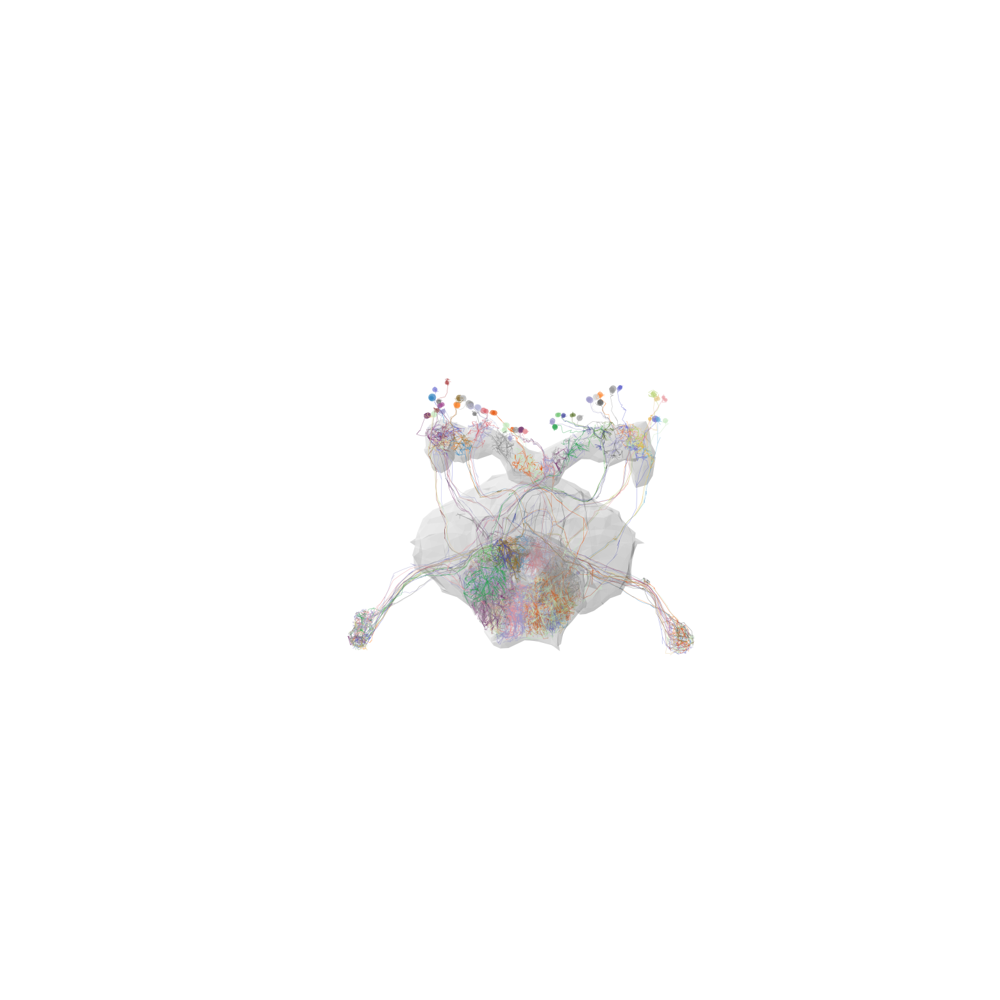

In [358]:
# TEST THE PLOTTING

# get EPGs
EPGs = find_roots_by_cell_type('EPG')
# get the skeletons
EPG_skeletons = get_skeletons_by_root_id(EPGs)
# get the values
EPG_values = np.random.rand(len(EPGs))
# plot the skeletons
plot_skeletons_with_values(
    EPG_skeletons, EPG_values, cm_tab40, neuron_alpha=0.5, neuron_width=0.5, vmin=0, vmax=1,
    azimuth=-85,
    elevation=-45,
    show_cx=True,
)

In [376]:
def plot_lateralization_by_cell_type(
        cell_types,
        neuron_alpha=0.5, 
        neuron_width=0.5,
        azimuth=-90,
        elevation=-90,
        show_flywire=False,
        show_cx=False,
        save_path=None
    ):
    # get all neurons that match the cell types along with their values
    root_ids = []
    values = []
    for cell_type in cell_types:
        # get the neurons of the class from the max lateralization metrics
        class_neurons = max_lateralization_metrics[max_lateralization_metrics['cell_type'] == cell_type]['root_id'].values
        class_values = max_lateralization_metrics[max_lateralization_metrics['cell_type'] == cell_type]['max_lateralization'].values
        root_ids.extend(class_neurons)
        values.extend(class_values)
    root_ids = np.array(root_ids)
    values = np.array(values)
    # get the skeletons
    skeletons = get_skeletons_by_root_id(root_ids)
    # plot the skeletons
    plot_skeletons_with_values(
        skeletons, 
        values, 
        cm_ofb,
        vmin=-np.mean(np.abs(values))+np.std(np.abs(values)),
        vmax=np.mean(np.abs(values))+np.std(np.abs(values)),
        neuron_alpha=neuron_alpha, 
        neuron_width=neuron_width,
        azimuth=azimuth,
        elevation=elevation,
        show_flywire=show_flywire,
        show_cx=show_cx,
        title=' | '.join(cell_types),
        save_path=save_path
    )

Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

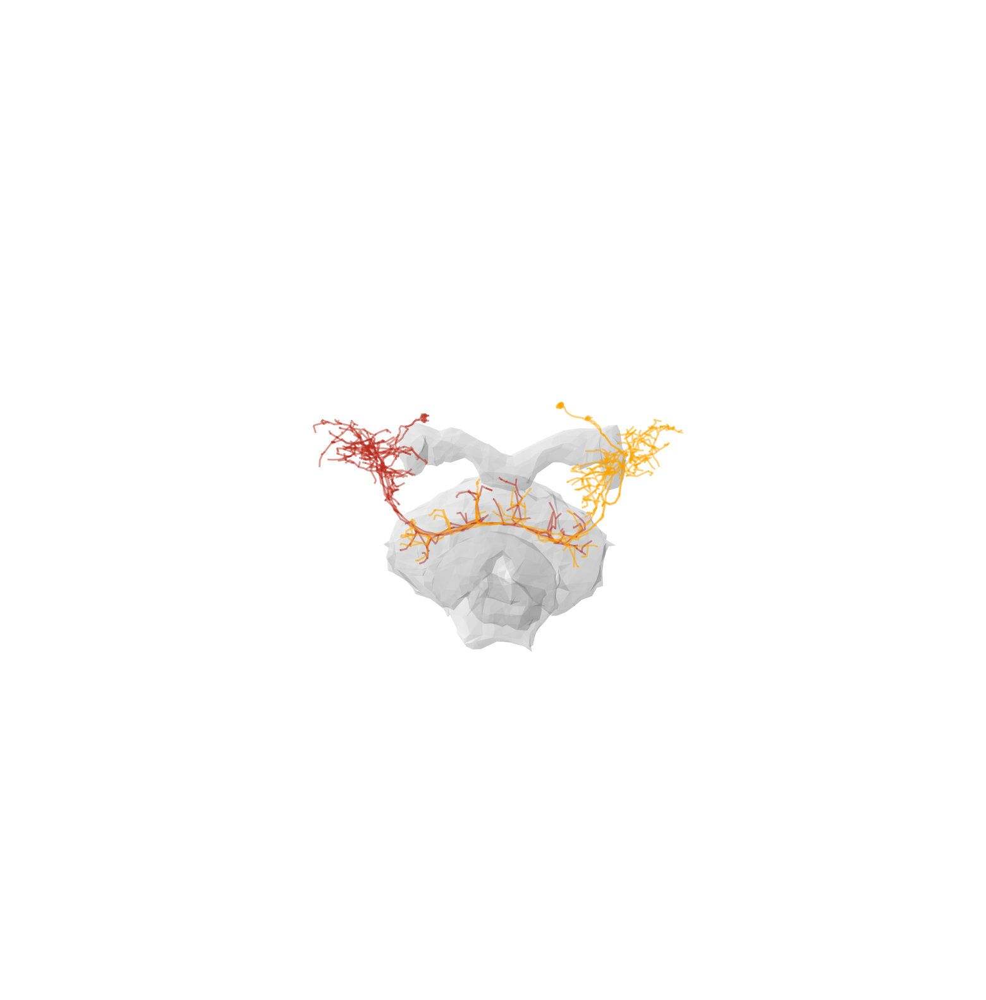

Fetching L2 skeletons:   0%|          | 0/14 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/14 [00:00<?, ?it/s]

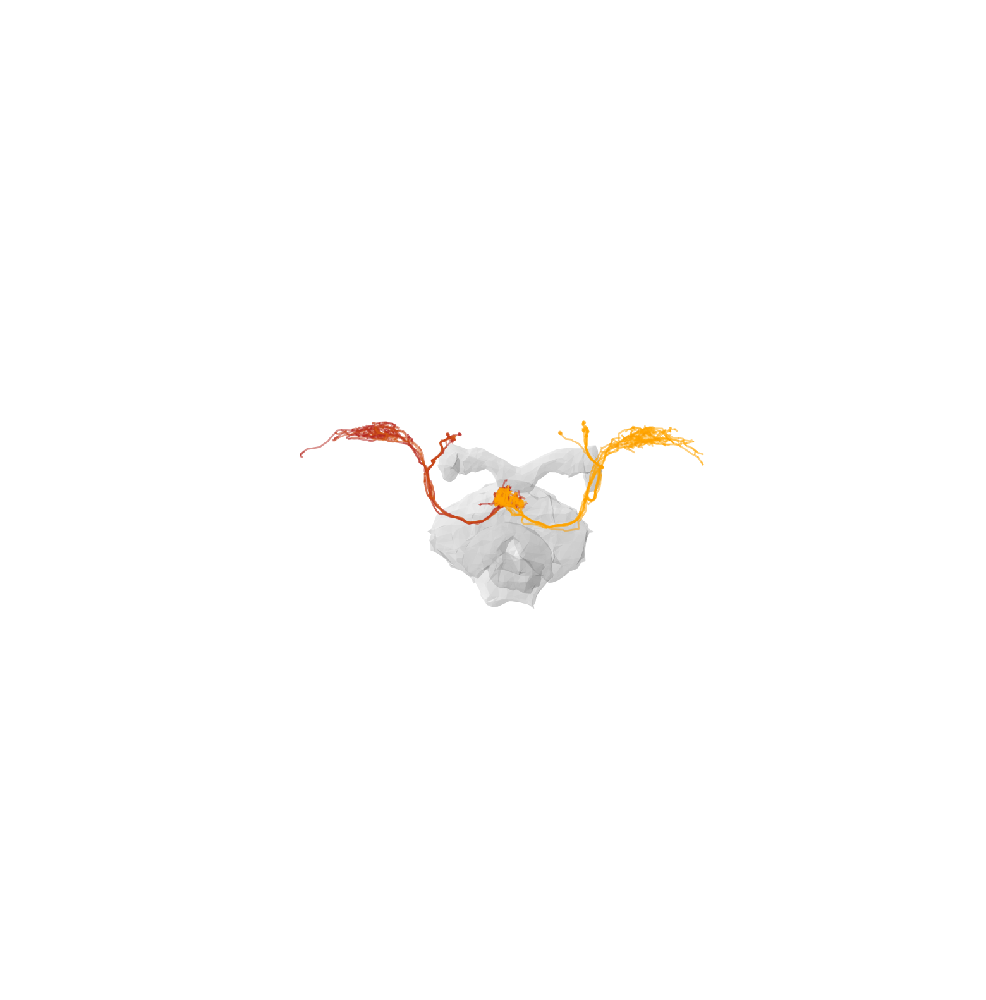

Fetching L2 skeletons:   0%|          | 0/17 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/17 [00:00<?, ?it/s]

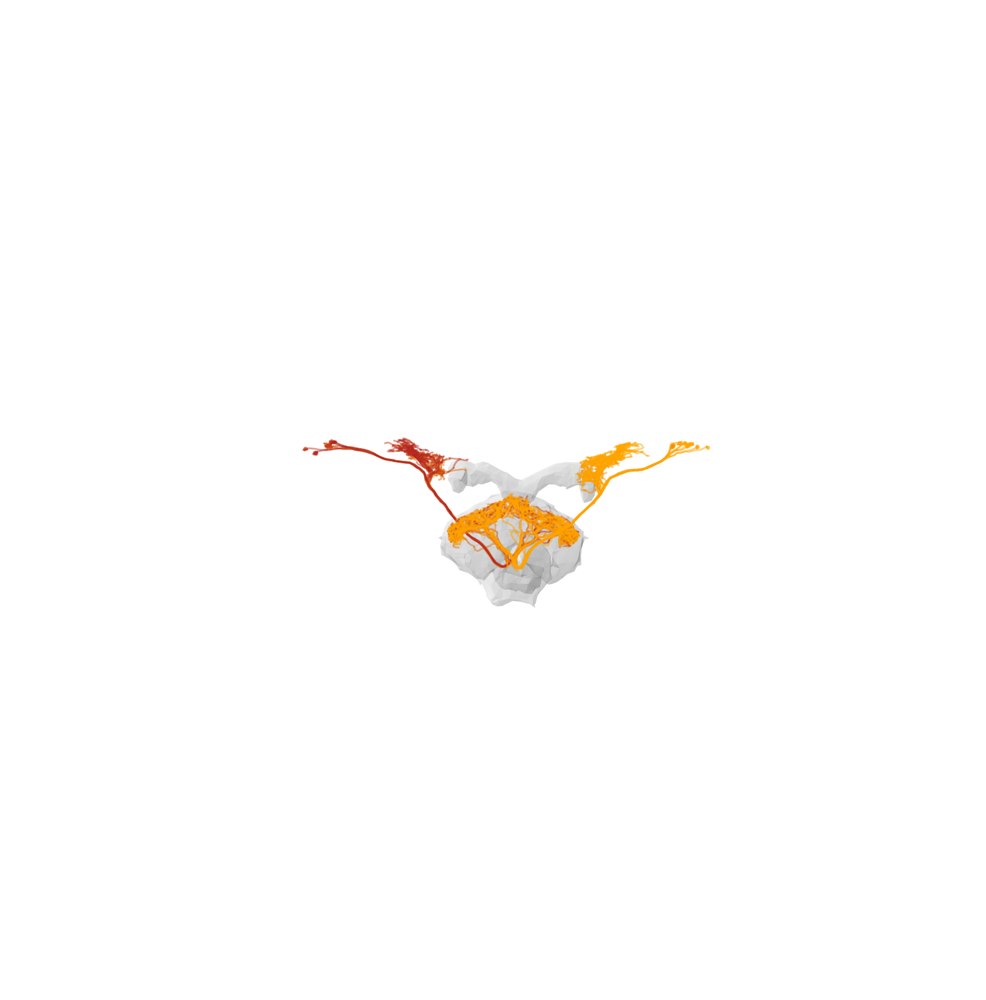

Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

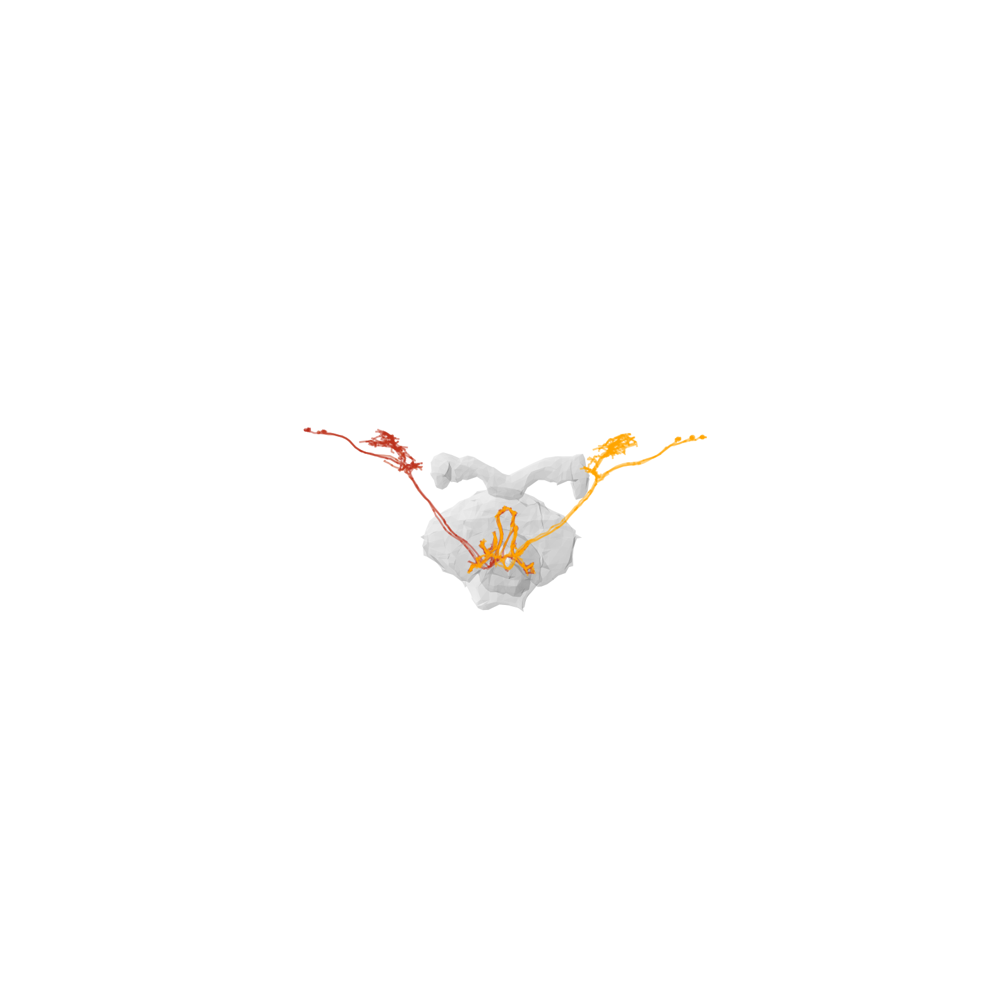

Fetching L2 skeletons:   0%|          | 0/36 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/36 [00:00<?, ?it/s]

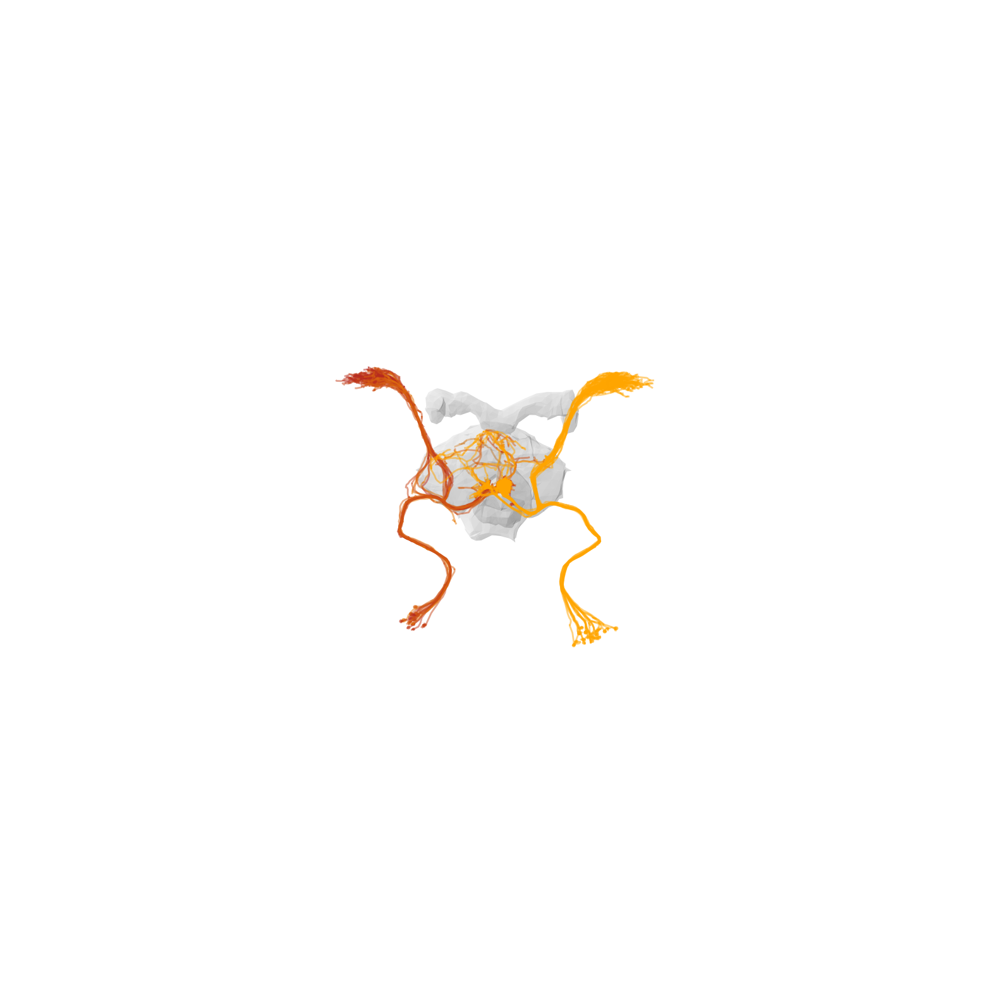

Fetching L2 skeletons:   0%|          | 0/124 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/124 [00:00<?, ?it/s]

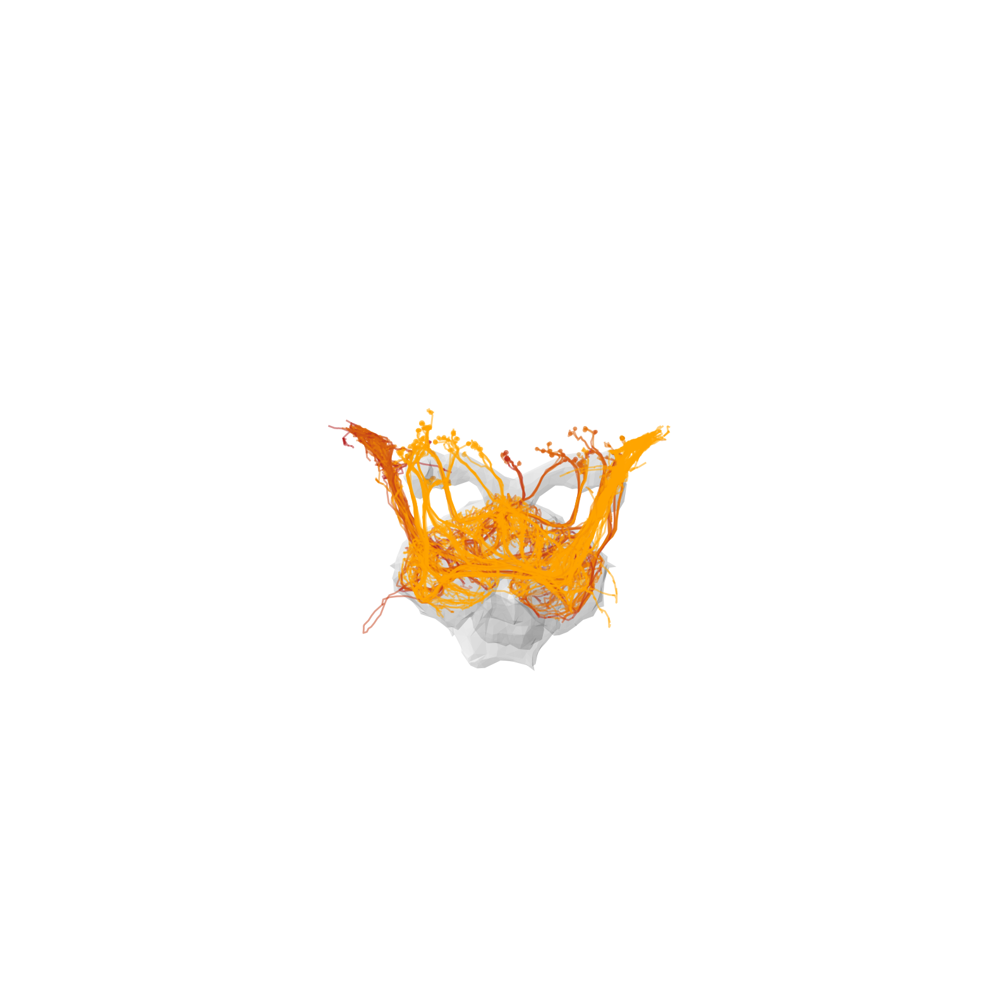

Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

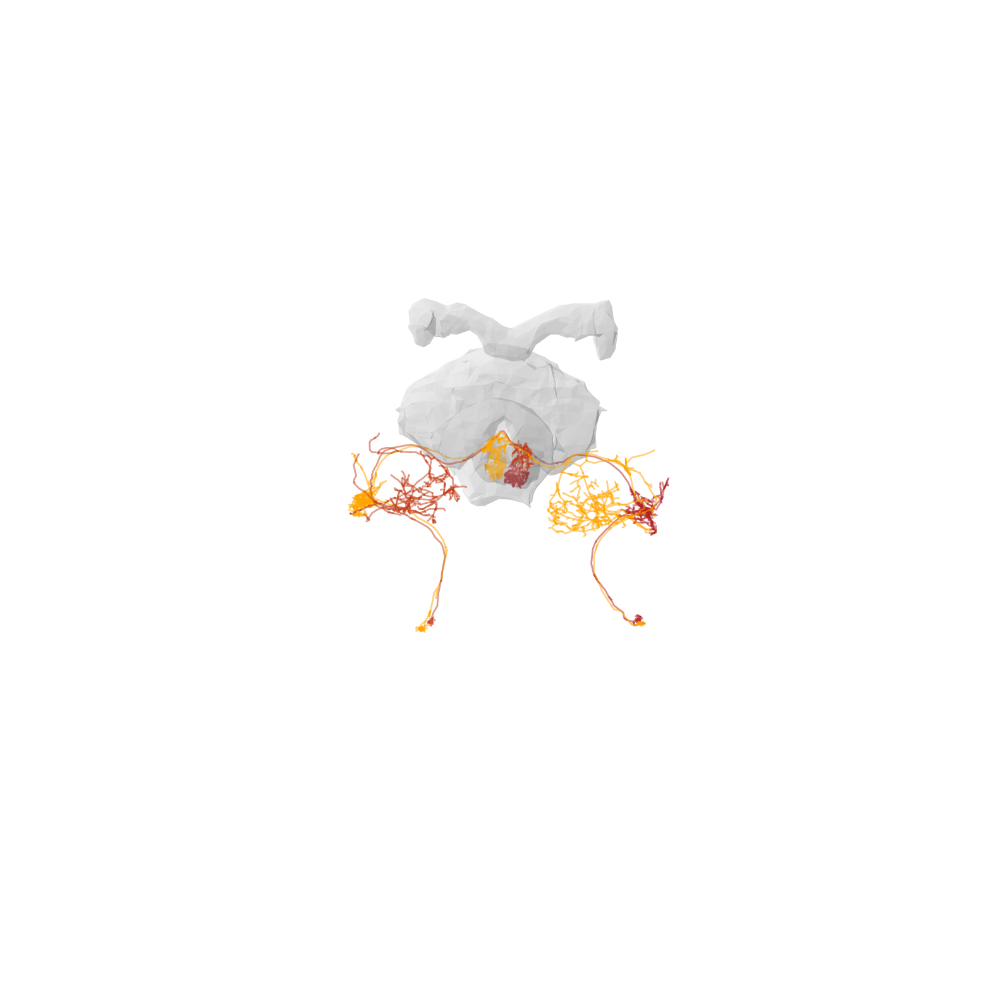

Fetching L2 skeletons:   0%|          | 0/376 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/376 [00:00<?, ?it/s]

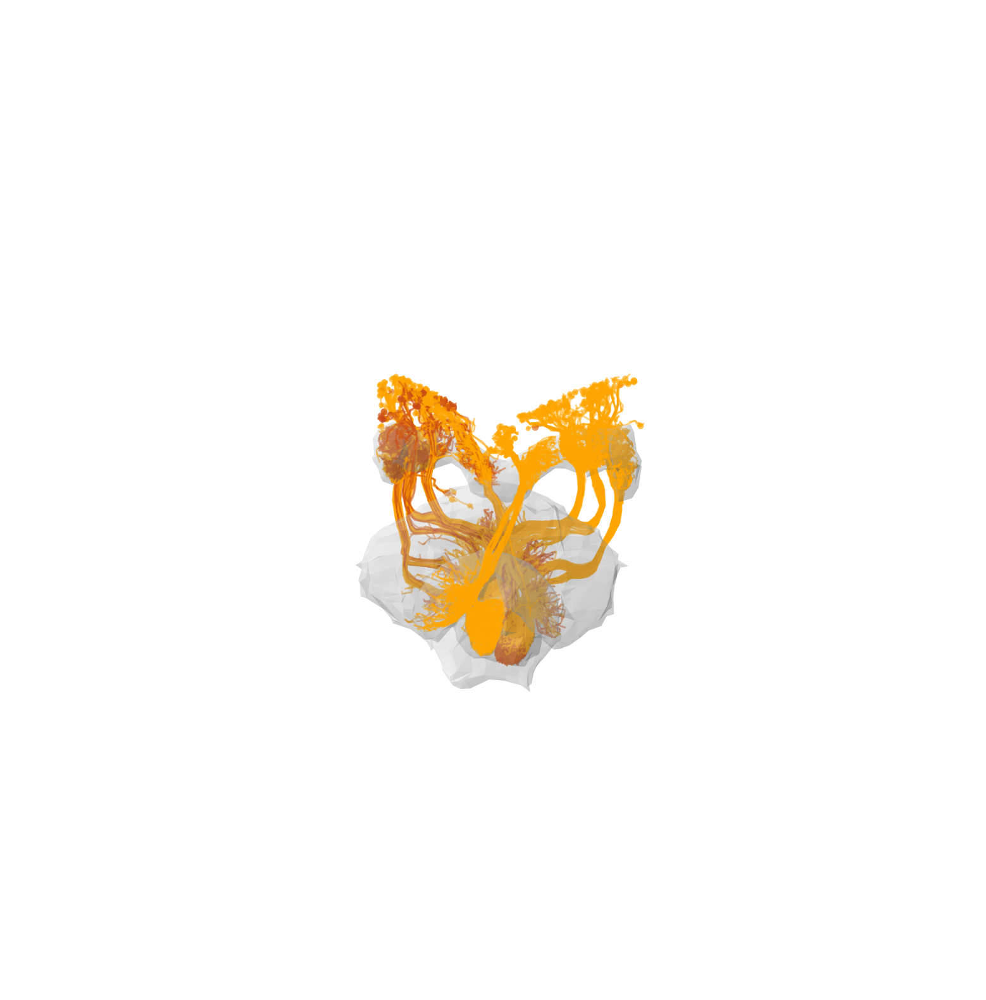

In [377]:
cell_types_of_interest = [
    ['FB6T'],
    ['FB9A/C'],
    ['FB8A/H'],
    ['CB.FB1E1'],
    ['SA1', 'SA2','SA3','SAF'],
    ['FS4A/B/C'],
    ['LNOa','LCNOp'],
    ['PFNm/p', 'PFNa'],
]

for cell_types in cell_types_of_interest:
    plot_lateralization_by_cell_type(
        cell_types, 
        neuron_alpha=0.5, 
        neuron_width=2,
        azimuth=-85,
        elevation=-45,
        show_flywire=False,
        show_cx=True,
    )

In [270]:
recalculate = True

In [271]:
# add an absolute lateralization column
max_lateralization_metrics['abs_max_lateralization'] = np.abs(max_lateralization_metrics['max_lateralization'])

In [272]:
# get all MBONs and their max lateralization
MBONs = max_lateralization_metrics[max_lateralization_metrics['class'] == 'MBON']
# get average max lateralization for each cell type
MBONs_by_cell_type = MBONs.groupby('cell_type')['abs_max_lateralization'].mean().reset_index()
# sort by max lateralization
MBONs_by_cell_type = MBONs_by_cell_type.sort_values('abs_max_lateralization', ascending=True).reset_index(drop=True)
# sort the original dataframe by the order of the sorted cell types
MBONs_sorted = pd.DataFrame()
for cell_type in MBONs_by_cell_type['cell_type']:
    MBONs_sorted = pd.concat([MBONs_sorted, MBONs[MBONs['cell_type'] == cell_type]])


# get all DANs and their max lateralization
DANs = max_lateralization_metrics[max_lateralization_metrics['class'] == 'DAN']
# get average max lateralization for each cell type
DANs_by_cell_type = DANs.groupby('cell_type')['abs_max_lateralization'].mean().reset_index()
# sort by max lateralization
DANs_by_cell_type = DANs_by_cell_type.sort_values('abs_max_lateralization', ascending=True).reset_index(drop=True)
# sort the original dataframe by the order of the sorted cell types
DANs_sorted = pd.DataFrame()
for cell_type in DANs_by_cell_type['cell_type']:
    DANs_sorted = pd.concat([DANs_sorted, DANs[DANs['cell_type'] == cell_type]])

# create a connection matrix
def create_connection_matrix(pre_neurons, post_neurons):
    connection_matrix = np.zeros((len(pre_neurons), len(post_neurons)))
    for i, pre_neuron in tqdm(enumerate(pre_neurons), total=len(pre_neurons)):
        for j, post_neuron in enumerate(post_neurons):
            # get the synapse count
            synapse_count = connections[(connections['pre_root_id'] == pre_neuron) & (connections['post_root_id'] == post_neuron)]['syn_count'].sum()
            connection_matrix[i, j] = synapse_count
    return connection_matrix

if not os.path.exists(os.path.join(processed_data_folder, 'ALPN_connectivity/MBON_DAN_connection_matrix.npy')) or recalculate:
    # create a connection matrix for MBONs and DANs
    MBON_DAN_connection_matrix = create_connection_matrix(DANs_sorted['root_id'].values, MBONs_sorted['root_id'].values)
    # save the connection matrix
    np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/MBON_DAN_connection_matrix.npy'), MBON_DAN_connection_matrix)
else:
    # load the connection matrix
    MBON_DAN_connection_matrix = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/MBON_DAN_connection_matrix.npy'))


  0%|          | 0/331 [00:00<?, ?it/s]

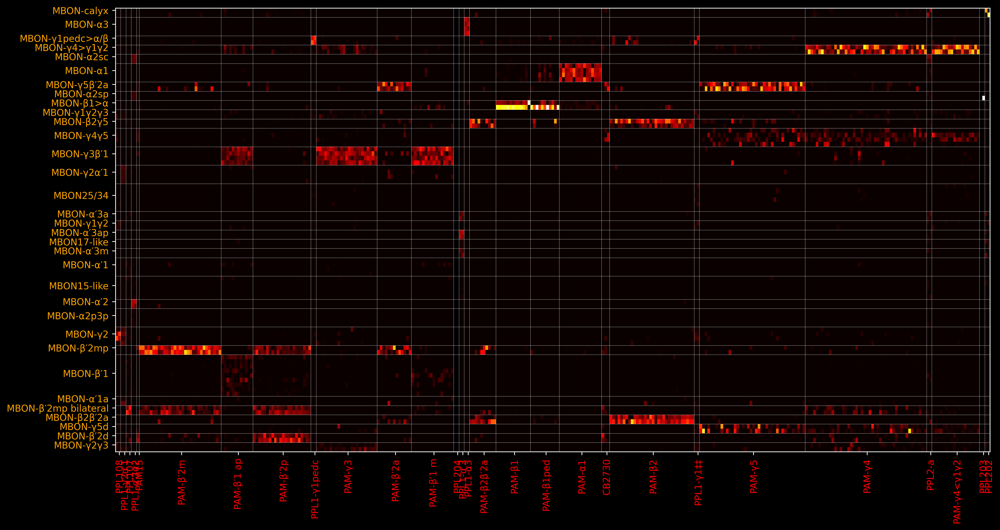

In [320]:
# normalize each row by the sum of the row
MBON_DAN_connection_matrix = MBON_DAN_connection_matrix / np.sum(MBON_DAN_connection_matrix, axis=1, keepdims=True)

MBON_cell_type_counts = MBONs_sorted.groupby('cell_type')['root_id'].count()[MBONs_by_cell_type['cell_type']].values
DAN_cell_type_counts = DANs_sorted.groupby('cell_type')['root_id'].count()[DANs_by_cell_type['cell_type']].values

# plot the connection matrix
plt.figure(figsize=(15,8), dpi=300)
plt.imshow(MBON_DAN_connection_matrix.T, cmap='hot', interpolation='nearest', aspect='auto')
# # draw the cell type boundaries
for i in np.cumsum(MBON_cell_type_counts):
    plt.axhline(i-0.5, color='white', linewidth=0.2)
for i in np.cumsum(DAN_cell_type_counts)[:-1]:
    plt.axvline(i-0.5, color='white', linewidth=0.2)
# put one of the cell types on the x axis
plt.xticks(np.cumsum(DAN_cell_type_counts)-DAN_cell_type_counts/2, DANs_by_cell_type['cell_type'], rotation=90, color='red')
# put one of the cell types on the y axis
plt.yticks(np.cumsum(MBON_cell_type_counts)-MBON_cell_type_counts/2, MBONs_by_cell_type['cell_type'], color='orange')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/MBON_DAN_connection_matrix.pdf'), bbox_inches='tight', dpi=300)
plt.show()

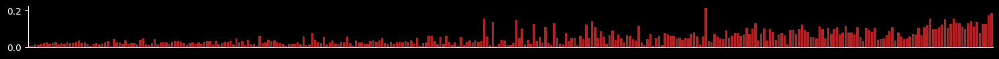

In [330]:
# create a plot for the lateralization of each cell type centered at the same points as the x and y ticks
plt.figure(figsize=(15,1))
plt.bar(np.arange(len(DANs_sorted)), DANs_sorted['abs_max_lateralization'], color='firebrick')
for spines in ['top', 'right']:
    plt.gca().spines[spines].set_visible(False)
plt.xlim(-0.5, len(DANs_sorted)-0.5)
plt.xticks([])
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/DAN_lateralization.pdf'), bbox_inches='tight', dpi=300)
plt.show()



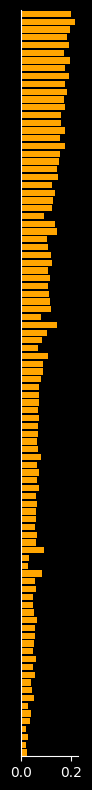

In [331]:
plt.figure(figsize=(1,8))
plt.barh(np.arange(len(MBONs_sorted)), MBONs_sorted['abs_max_lateralization'], color='orange')
for spines in ['top', 'right']:
    plt.gca().spines[spines].set_visible(False)
plt.ylim(-0.5, len(MBONs_sorted)-0.5)
plt.yticks([])
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/MBON_lateralization.pdf'), bbox_inches='tight', dpi=300)



Investigating class other descending 



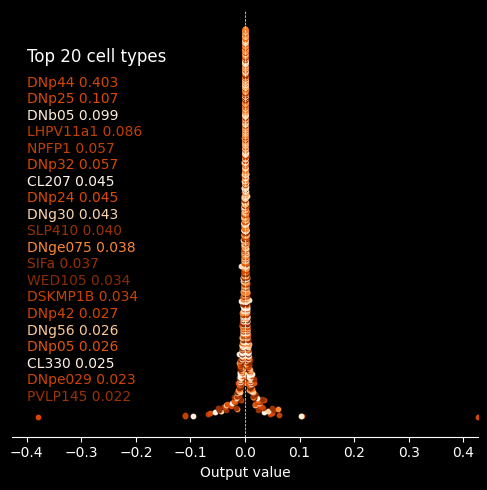

In [252]:
for class_to_investigate in ['other descending']:
    print('\n\nInvestigating class', class_to_investigate, '\n')

    # get the neurons of the class from the max lateralization metrics
    class_neurons = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['root_id'].values
    class_values = max_lateralization_metrics[max_lateralization_metrics['class'] == class_to_investigate]['max_lateralization'].values

    # get the cell types of the class
    class_cell_types = np.array([get_cell_type(n) for n in class_neurons])

    # get the unique cell types
    unique_cell_types = np.unique(class_cell_types)
    n_cell_types = len(unique_cell_types)

    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    # get the average lateralization for each cell type
    cell_type_values = np.zeros(n_cell_types)

    for i in range(n_cell_types):
        cell_type_values[i] = np.nanmean(np.abs(class_values[class_cell_types == unique_cell_types[i]]))
        
    # sort the cell types by average lateralization
    sorted_indices = np.argsort(cell_type_values)[::-1]

    # scatter plot of the values
    plt.figure(figsize=(5,5))
    plt.text(-0.4, 430, 'Top 20 cell types', fontsize=12, color='white')
    for i, idx in enumerate(sorted_indices):
        # get the values for the class
        cell_type_values = class_values[class_cell_types == unique_cell_types[idx]]
        # text = 'Cell type' + index_to_cell_type[idx] +  'N=' +  len(cell_type_values) +  'mean=' +  np.nanmean(np.abs(cell_type_values))
        if i < 20:
            text = f'{index_to_cell_type[idx]} {np.nanmean(np.abs(cell_type_values)):.3f}'
            plt.text(-0.4, 400 - 20*i, text, fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # plot the values
        plt.scatter(cell_type_values, i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=10)
    # draw the zero line
    plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
    max_value = np.max(np.abs(class_values))
    plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    # plt.ylim(-n_cell_types, 1)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_max_connectivity_{}_cell_types.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
    plt.show()



In [ ]:
# investigate a single class in the form of cell types
N_steps_analysis = 5
for class_to_investigate in ['other descending']:
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps_analysis+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    all_cell_type_values = []

    for layer_no in range(1,N_steps_analysis+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else np.inf
        all_cell_type_values.append(np.power(cell_type_values, 1/layer_no))

        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

            
        max_value = 0
        # scatter plot of the values
        plt.figure(figsize=(5,5))

        sorted_values = cell_type_values[sorted_indices]
        # clean to remove inf values
        sorted_indices = np.array(sorted_indices)
        cleaned_sorted_indices = sorted_indices[sorted_values != np.inf]
        # put the top 20 cell types on the plot
        plt.text(-0.3, -2, 'Top 20 cell types', fontsize=12, ha='left', va='center')
        for n,i in enumerate(cleaned_sorted_indices[-20:][::-1]):
            # print(index_to_cell_type[i], cell_type_values[i])
            plt.text(-0.3, -5*(n+2), f"{index_to_cell_type[i]}: {cell_type_values[i]:.3f}", fontsize=8, ha='left', va='center', color=plt.cm.Oranges(i/n_cell_types))


        i = 0
        for idx in sorted_indices:
            if np.sum(cell_type_ids == idx) == 0:
                continue
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # cell_type_values = np.power(np.abs(values[cell_type_ids == idx]), 1/layer_no)* np.sign(values[cell_type_ids == idx])
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            # plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
            # update max value
            max_value = max(max_value, np.nanmax(np.abs(cell_type_values))) if len(cell_type_values) > 0 else max_value
            i += 1
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        # plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

# get the average lateralization for each cell type and plot as a bar plot
all_cell_type_values = np.array(all_cell_type_values)
# replace inf values with nan
all_cell_type_values[all_cell_type_values == np.inf] = np.nan
average_cell_type_values = np.nanmean(np.array(all_cell_type_values), axis=0)
# sort the cell types by average lateralization
sorted_indices = np.argsort(average_cell_type_values)
# keep only keep the top 20 cell types
sorted_indices = sorted_indices[-20:]
# get top 20 cell types
top20_cell_types = [index_to_cell_type[i] for i in sorted_indices]
# plot the sorted cell types
plt.figure(figsize=(5,5))
plt.barh(np.arange(len(sorted_indices)), average_cell_type_values[sorted_indices], color=plt.cm.Oranges(np.linspace(0, 1, len(sorted_indices))))
plt.yticks(np.arange(len(sorted_indices)), [index_to_cell_type[i] for i in sorted_indices])
plt.xlabel('Average output value')
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_top_20.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
plt.show()



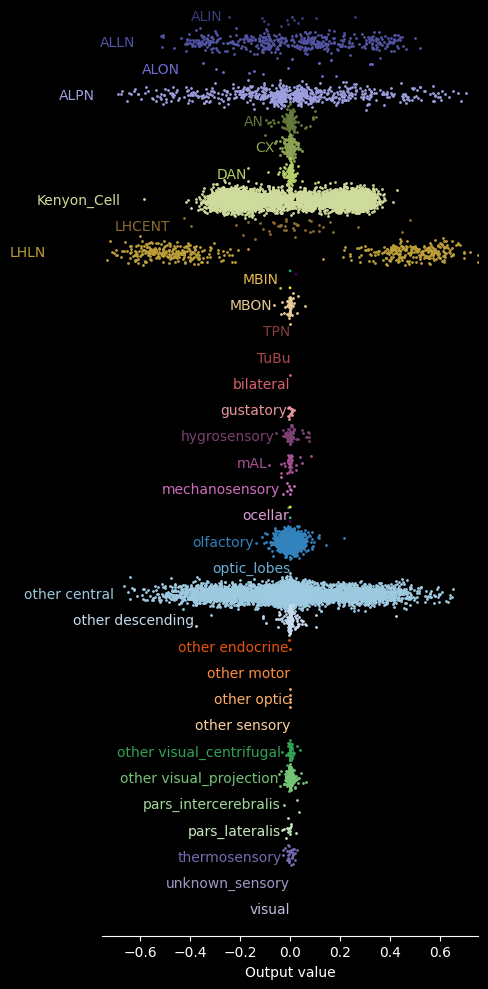

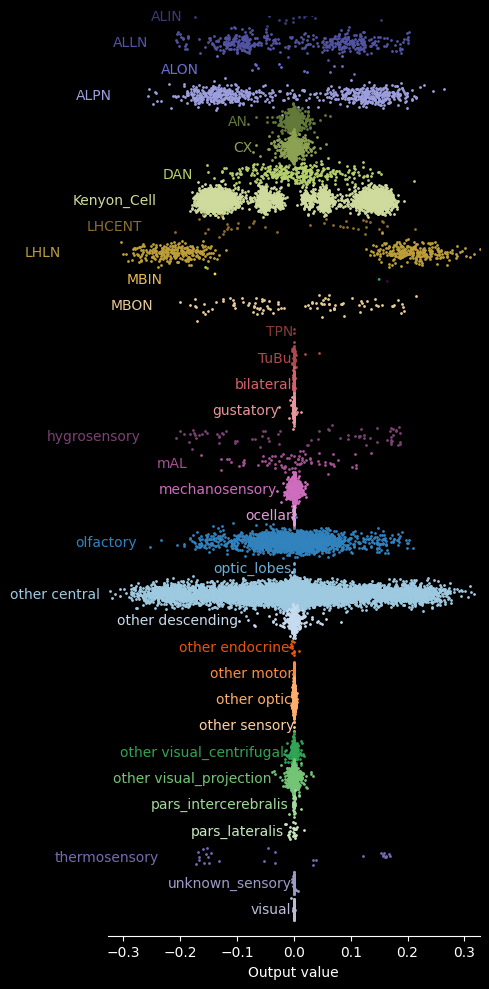

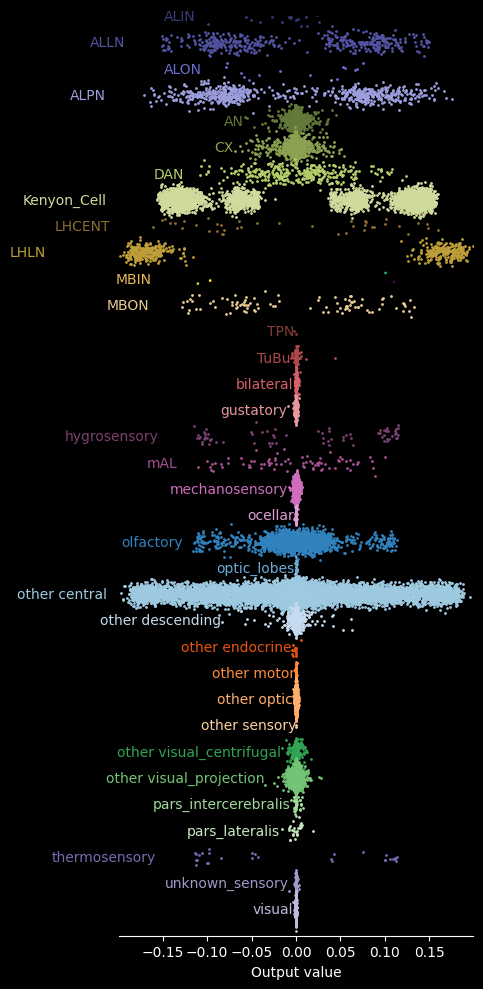

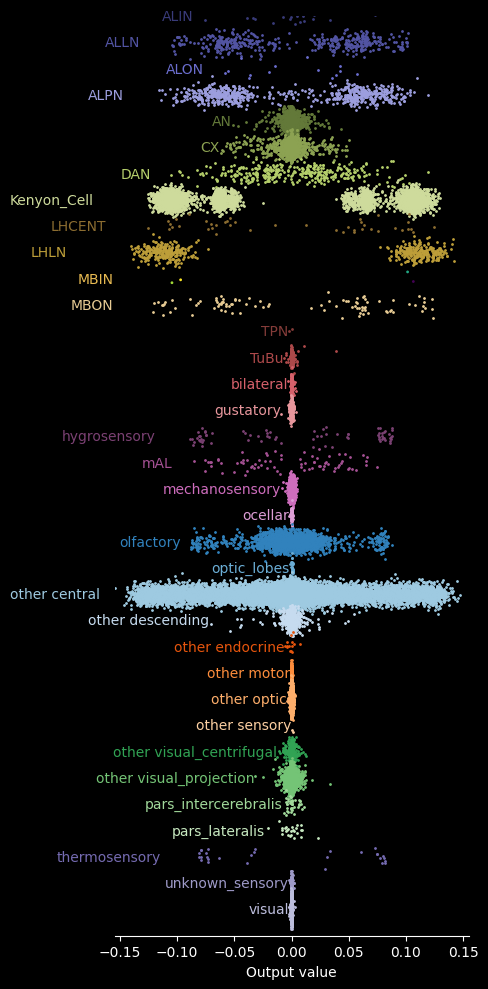

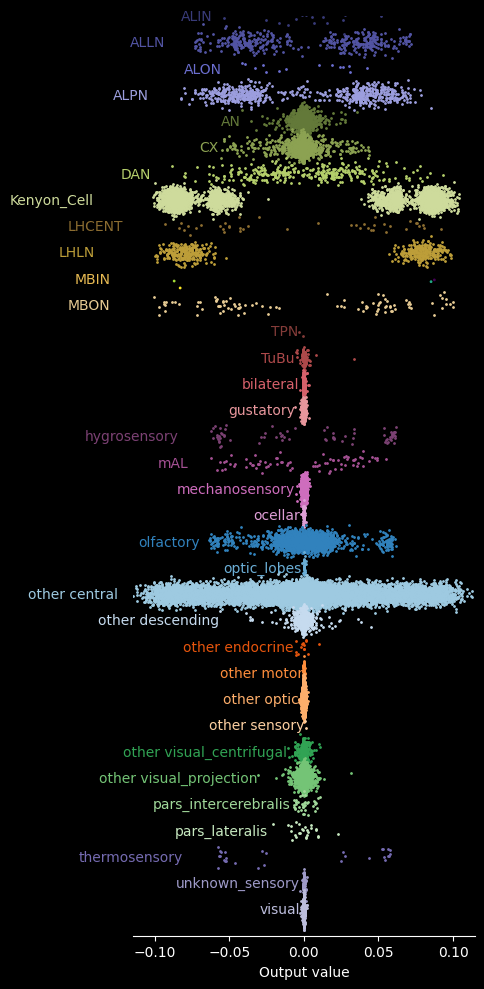

In [138]:
visited_neurons = layers[0]
dont_display_visited_neurons = False

for layer_no in range(1,N_steps+1):

    classes = np.unique(classification['class'].values)

    n_classes = len(classes)
    class_to_index = {c:i for i,c in enumerate(classes)}
    index_to_class = {i:c for i,c in enumerate(classes)}
    
    neurons = layers[layer_no]
    values = lateralizations[layer_no]
    classes = layer_classes[layer_no]

    if dont_display_visited_neurons:
        mask = np.logical_not(np.isin(neurons, visited_neurons))
        neurons = neurons[mask]
        values = values[mask]

        # add the visited neurons to the visited neurons
        visited_neurons = np.concatenate((visited_neurons, neurons))
        # make sure the visited neurons are unique
        visited_neurons = np.unique(visited_neurons)

    class_ids = [class_to_index[c] for c in classes]
    class_ids = np.array(class_ids)

    # scatter plot of the values
    plt.figure(figsize=(5,10))
    for i in range(n_classes):
        # get the values for the class
        class_values = values[class_ids == i]
        # plot the values
        plt.scatter(class_values, -i + 0.2*np.random.randn(len(class_values)), c=cm_tab40(i), s=1)
        # put the name of the class next to the points
        plt.text(np.nanmin(class_values)-0.5*np.mean(np.abs(class_values)) if len(class_values) > 0 else 0, -i, index_to_class[i], verticalalignment='center', horizontalalignment='right', fontsize=10, color=cm_tab40(i))
    max_value = np.max(np.abs(values))
    plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_classes, 0)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_class_layer_{}.pdf'.format(layer_no)), bbox_inches='tight', dpi=300)
    plt.show()

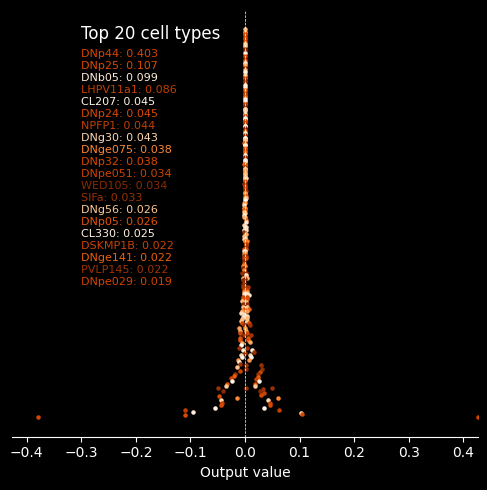

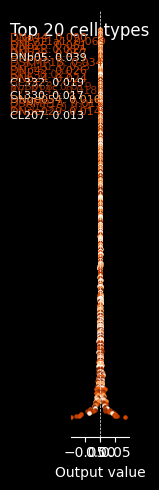

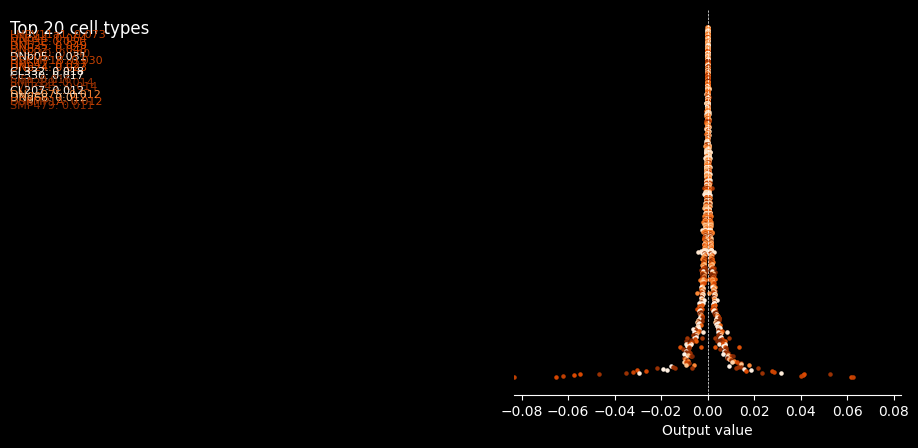

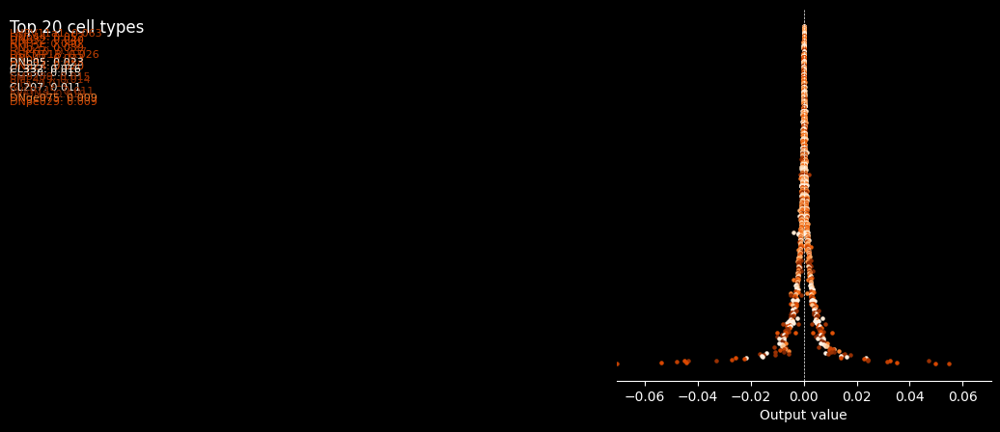

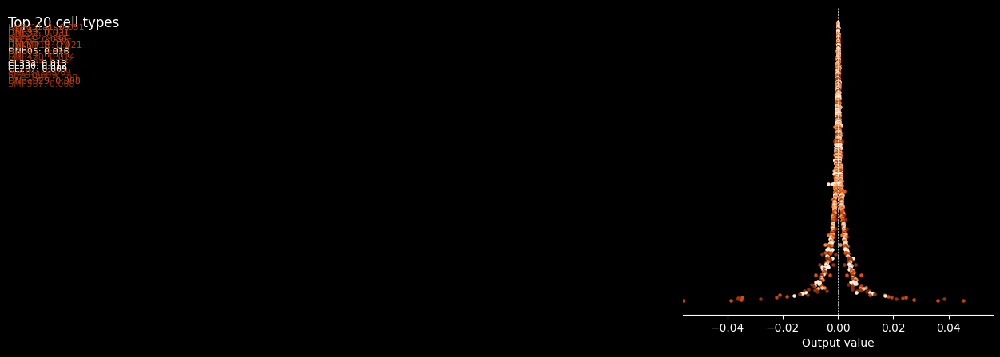

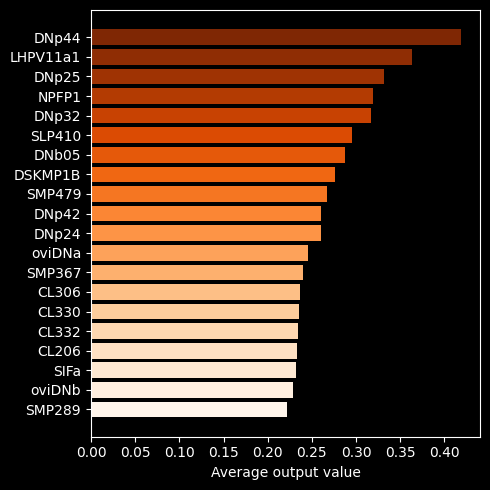

In [110]:
# investigate a single class in the form of cell types
N_steps_analysis = 5
for class_to_investigate in ['other descending']:
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps_analysis+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    all_cell_type_values = []

    for layer_no in range(1,N_steps_analysis+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else np.inf
        all_cell_type_values.append(np.power(cell_type_values, 1/layer_no))

        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

            
        max_value = 0
        # scatter plot of the values
        plt.figure(figsize=(5,5))

        sorted_values = cell_type_values[sorted_indices]
        # clean to remove inf values
        sorted_indices = np.array(sorted_indices)
        cleaned_sorted_indices = sorted_indices[sorted_values != np.inf]
        # put the top 20 cell types on the plot
        plt.text(-0.3, -2, 'Top 20 cell types', fontsize=12, ha='left', va='center')
        for n,i in enumerate(cleaned_sorted_indices[-20:][::-1]):
            # print(index_to_cell_type[i], cell_type_values[i])
            plt.text(-0.3, -5*(n+2), f"{index_to_cell_type[i]}: {cell_type_values[i]:.3f}", fontsize=8, ha='left', va='center', color=plt.cm.Oranges(i/n_cell_types))


        i = 0
        for idx in sorted_indices:
            if np.sum(cell_type_ids == idx) == 0:
                continue
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # cell_type_values = np.power(np.abs(values[cell_type_ids == idx]), 1/layer_no)* np.sign(values[cell_type_ids == idx])
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            # plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
            # update max value
            max_value = max(max_value, np.nanmax(np.abs(cell_type_values))) if len(cell_type_values) > 0 else max_value
            i += 1
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        # plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

# get the average lateralization for each cell type and plot as a bar plot
all_cell_type_values = np.array(all_cell_type_values)
# replace inf values with nan
all_cell_type_values[all_cell_type_values == np.inf] = np.nan
average_cell_type_values = np.nanmean(np.array(all_cell_type_values), axis=0)
# sort the cell types by average lateralization
sorted_indices = np.argsort(average_cell_type_values)
# keep only keep the top 20 cell types
sorted_indices = sorted_indices[-20:]
# get top 20 cell types
top20_cell_types = [index_to_cell_type[i] for i in sorted_indices]
# plot the sorted cell types
plt.figure(figsize=(5,5))
plt.barh(np.arange(len(sorted_indices)), average_cell_type_values[sorted_indices], color=plt.cm.Oranges(np.linspace(0, 1, len(sorted_indices))))
plt.yticks(np.arange(len(sorted_indices)), [index_to_cell_type[i] for i in sorted_indices])
plt.xlabel('Average output value')
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_top_20.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
plt.show()





Investigating class Kenyon_Cell 



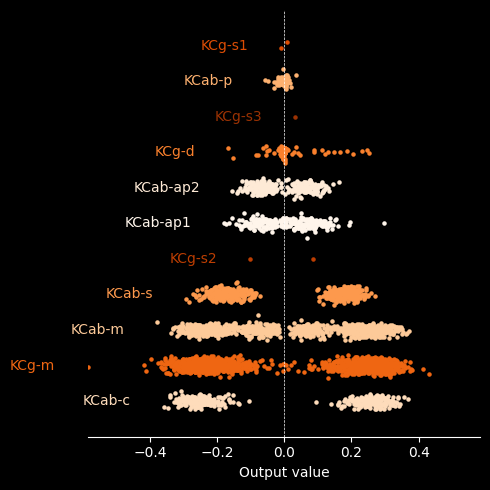

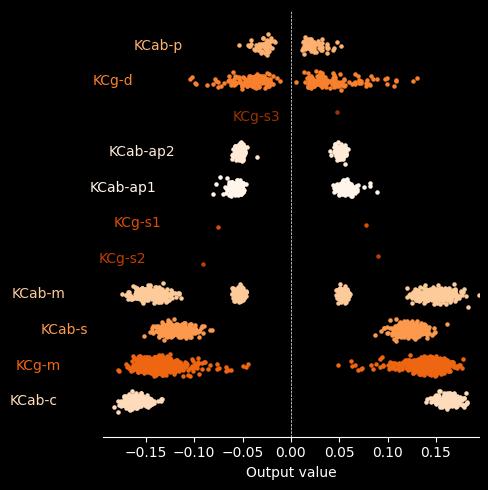

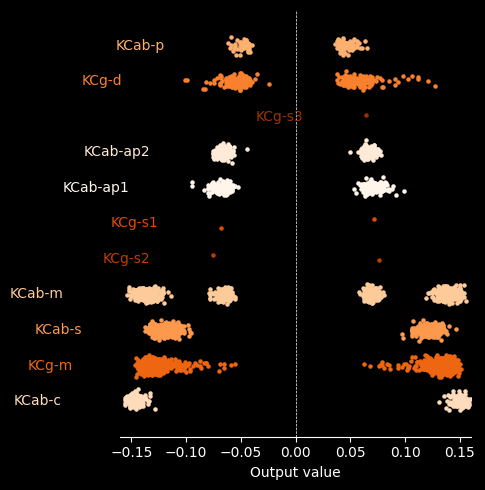

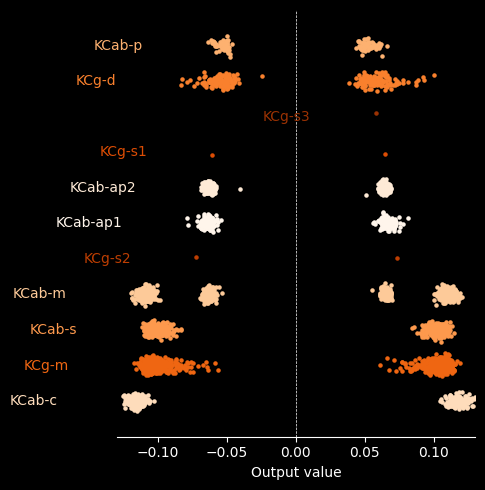

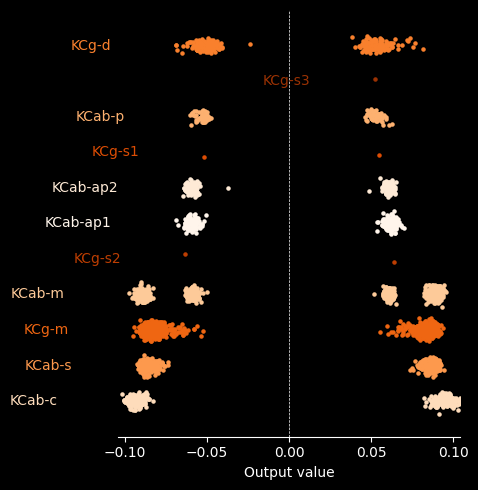

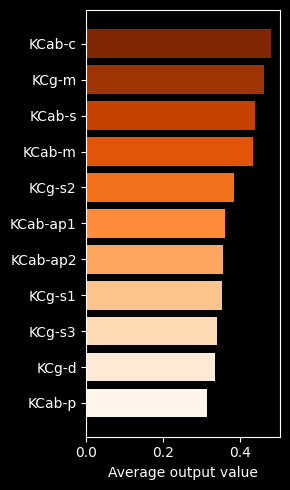

In [111]:
# investigate a single class in the form of cell types
for class_to_investigate in ['Kenyon_Cell']:
    print('\n\nInvestigating class', class_to_investigate, '\n')
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    all_cell_type_values = []


    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else 0
        all_cell_type_values.append(np.power(cell_type_values, 1/layer_no))
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,5))
        for i, idx in enumerate(sorted_indices):
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.abs(values))
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

    # get the average lateralization for each cell type and plot as a bar plot
    all_cell_type_values = np.array(all_cell_type_values)
    # replace inf values with nan
    all_cell_type_values[all_cell_type_values == np.inf] = np.nan
    average_cell_type_values = np.nanmean(np.array(all_cell_type_values), axis=0)
    # sort the cell types by average lateralization
    sorted_indices = np.argsort(average_cell_type_values)
    # keep only keep the top 20 cell types
    sorted_indices = sorted_indices[-20:]
    # get top 20 cell types
    top20_cell_types = [index_to_cell_type[i] for i in sorted_indices]
    # plot the sorted cell types
    plt.figure(figsize=(3,5))
    plt.barh(np.arange(len(sorted_indices)), average_cell_type_values[sorted_indices], color=plt.cm.Oranges(np.linspace(0, 1, len(sorted_indices))))
    plt.yticks(np.arange(len(sorted_indices)), [index_to_cell_type[i] for i in sorted_indices])
    plt.xlabel('Average output value')
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_top_20.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
    plt.show()



In [52]:
len(np.isfinite(cell_type_values)),len(cell_type_ids)

(470, 275)

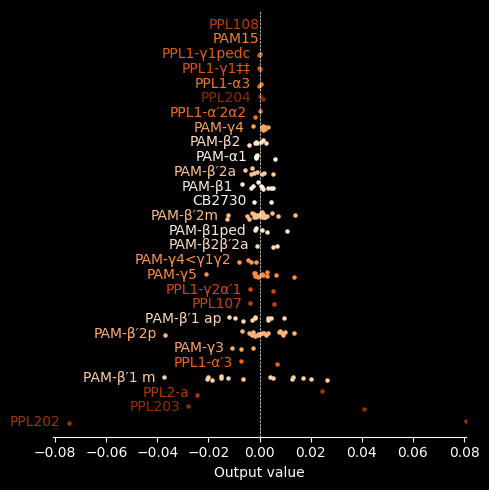

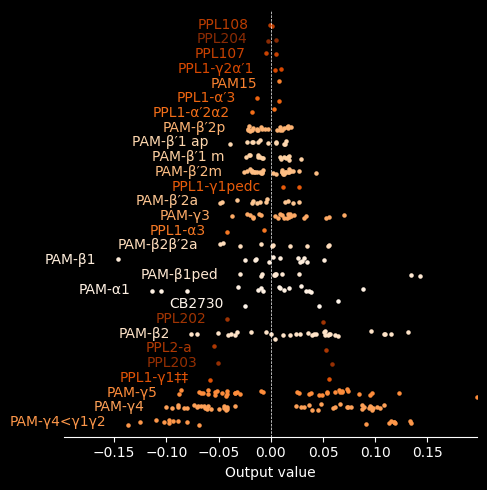

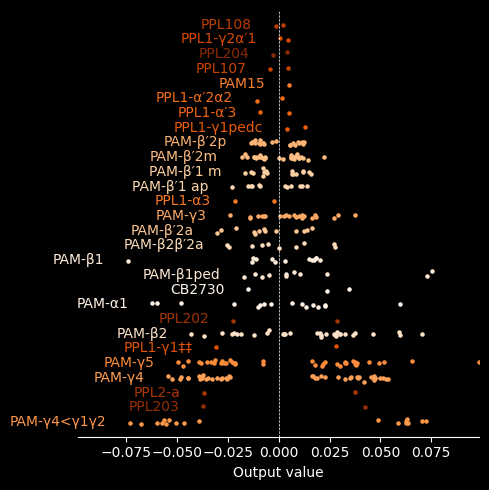

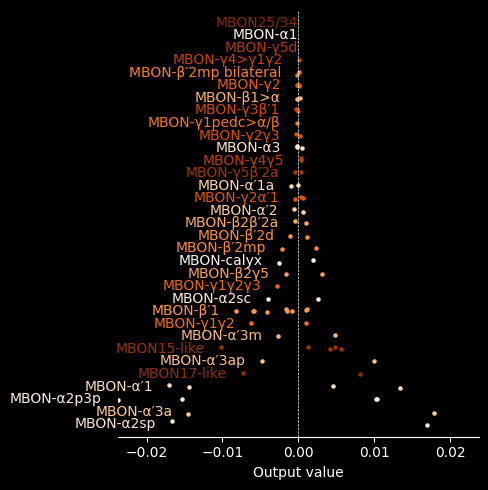

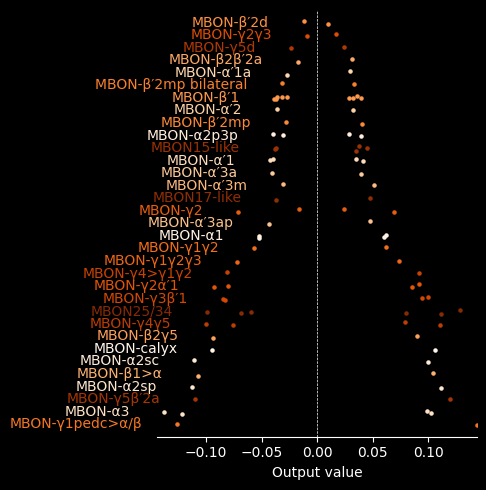

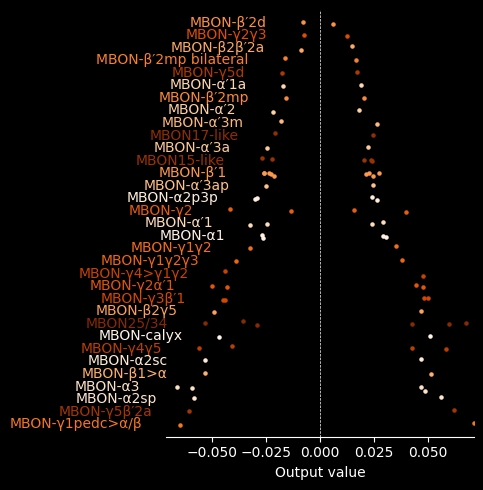

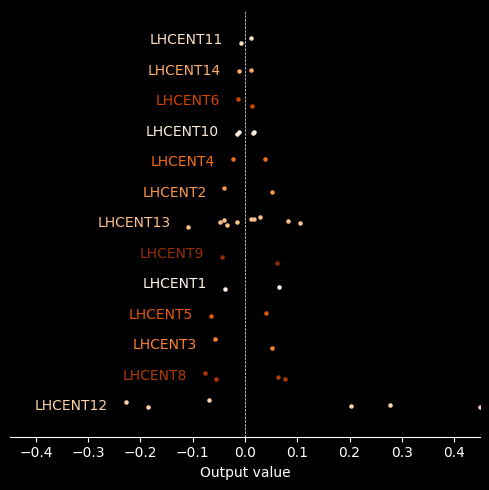

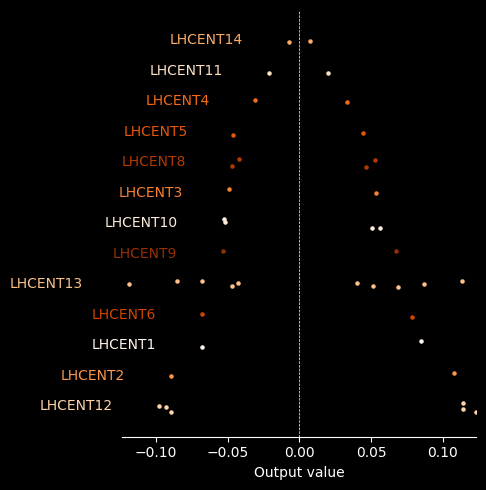

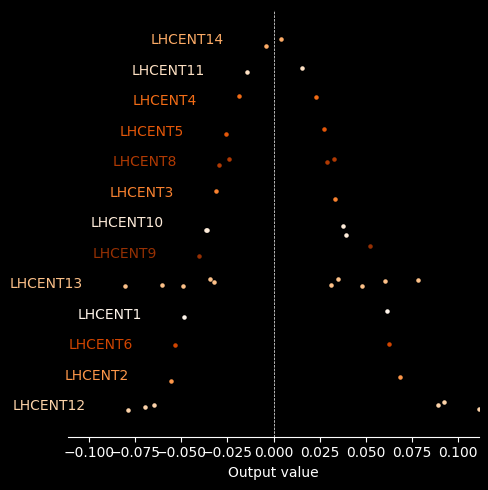

In [271]:
# investigate a single class in the form of cell types
for class_to_investigate in ['DAN', 'MBON', 'LHCENT']:
    print('\n\nInvestigating class', class_to_investigate, '\n')
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}



    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else 0
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,5))
        for i, idx in enumerate(sorted_indices):
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.abs(values))
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

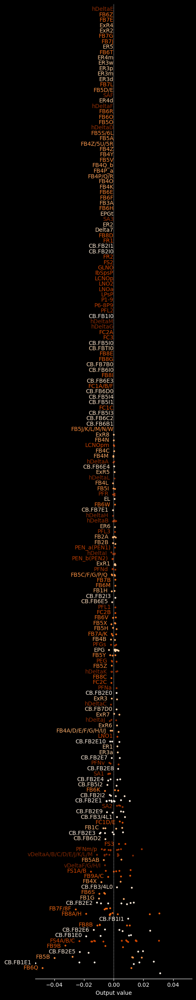

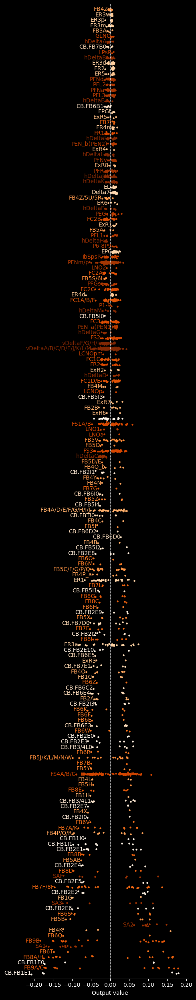

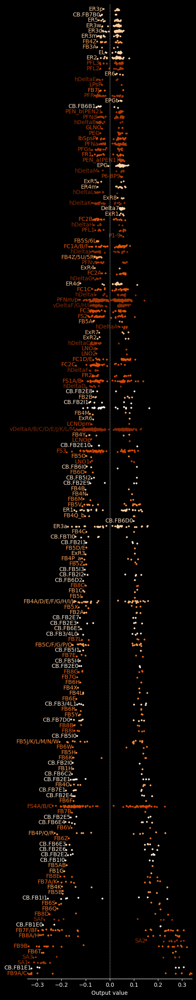

In [272]:
# investigate a single class in the form of cell types
for class_to_investigate in ['CX']:
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}



    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else 0
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,25))
        for i, idx in enumerate(sorted_indices):
            # get the values for the class
            cell_type_values = np.power(np.abs(values[cell_type_ids == idx]),1/layer_no)*np.sign(values[cell_type_ids == idx])
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.power(np.abs(values),1/layer_no))
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

In [297]:
def get_skeletons_by_root_id(root_ids):
    return flywire.get_l2_skeleton(root_ids)

# get the neuropils from fafbseg
cx =   flywire.get_neuropil_volumes(['EB','FB','PB','NO'])

def plot_skeletons_with_values(
        skeletons, 
        values, 
        color_map, 
        vmin=None, 
        vmax=None, 
        neuron_alpha=0.5, 
        neuron_width=0.5,
        azimuth=-90,
        elevation=-90,
        show_flywire=False,
        show_cx=False,
        title=None,
        save_path=None
    ):
    # convert values to colors
    colors = color_map((values - vmin) / (vmax - vmin))
    # plot the skeletons
    fig, ax = navis.plot2d(skeletons, color=colors, lw=neuron_width, alpha=neuron_alpha, method='3d', figsize=(20,20), autoscale=True)
    if show_flywire:
        _ = navis.plot2d(flybrains.FLYWIRE, ax=ax, color='white', lw=0.5, alpha=0.1, method='3d')
    if show_cx:
        _ = navis.plot2d(cx, ax=ax, color='white', lw=0.5, alpha=0.2, method='3d')

    fig.patch.set_visible(False)
    ax.patch.set_visible(False)
    ax.azim, ax.elev, ax.dist = azimuth, elevation, 3
    ax.set_axis_off()
    ax.grid(False)
    if title is not None:
        ax.set_title(title)
    if save_path is not None:
        plt.savefig(save_path, bbox_inches='tight', dpi=300)
    plt.show()

Fetching L2 skeletons:   0%|          | 0/47 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/47 [00:00<?, ?it/s]

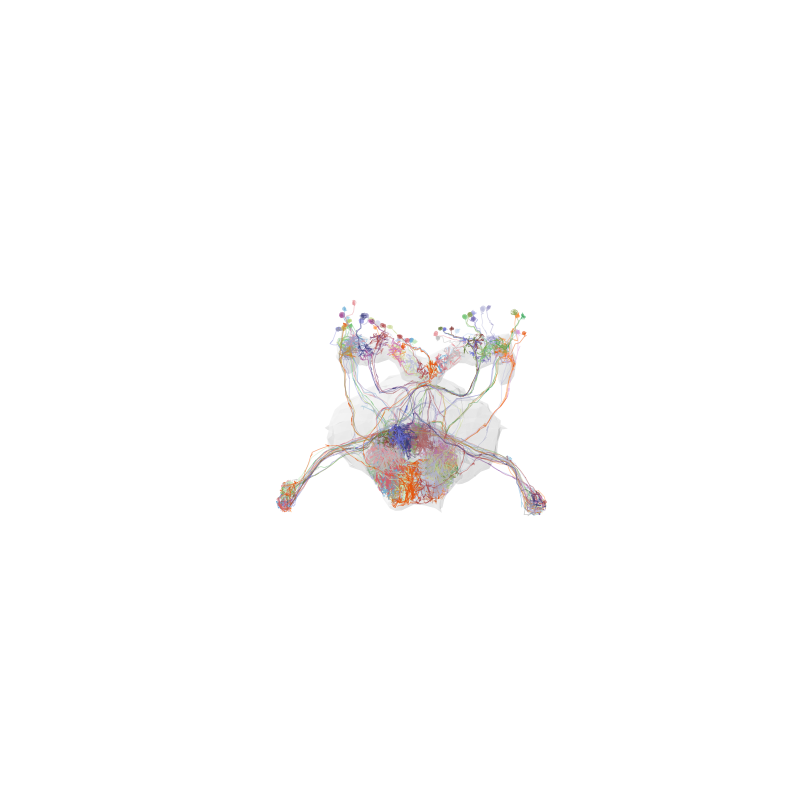

In [293]:
# get EPGs
EPGs = find_roots_by_cell_type('EPG')
# get the skeletons
EPG_skeletons = get_skeletons_by_root_id(EPGs)
# get the values
EPG_values = np.random.rand(len(EPGs))
# plot the skeletons
plot_skeletons_with_values(
    EPG_skeletons, EPG_values, cm_tab40, neuron_alpha=0.5, neuron_width=0.5, vmin=0, vmax=1,
    azimuth=-85,
    elevation=-45,
    show_cx=True,
)

Layer 3 | FB9A/C | 0.3074051888215397


Fetching L2 skeletons:   0%|          | 0/14 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/14 [00:00<?, ?it/s]

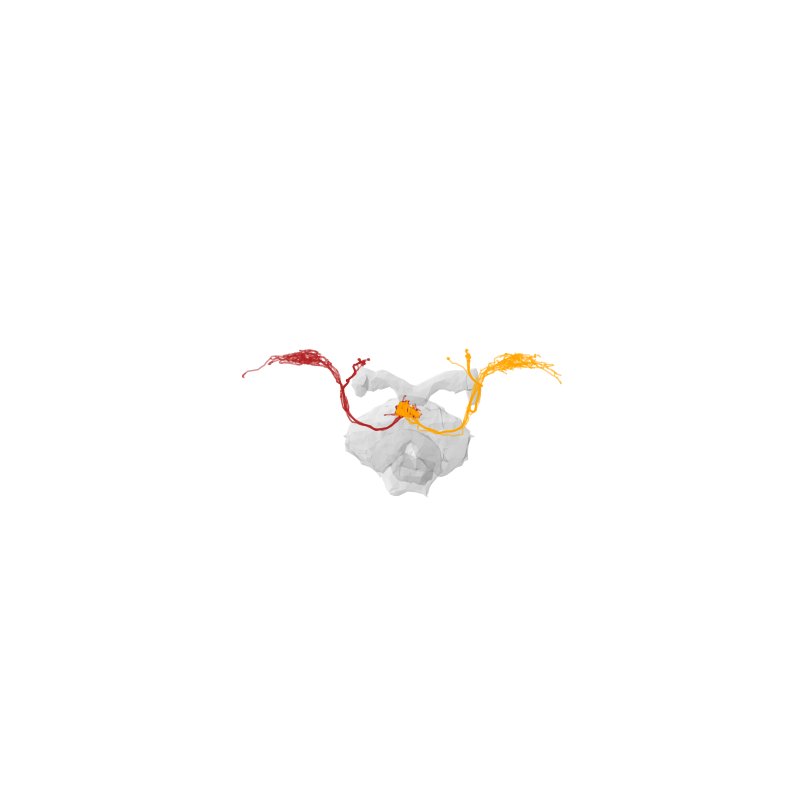

Layer 3 | CB.FB1E1 | 0.2973551460513391


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

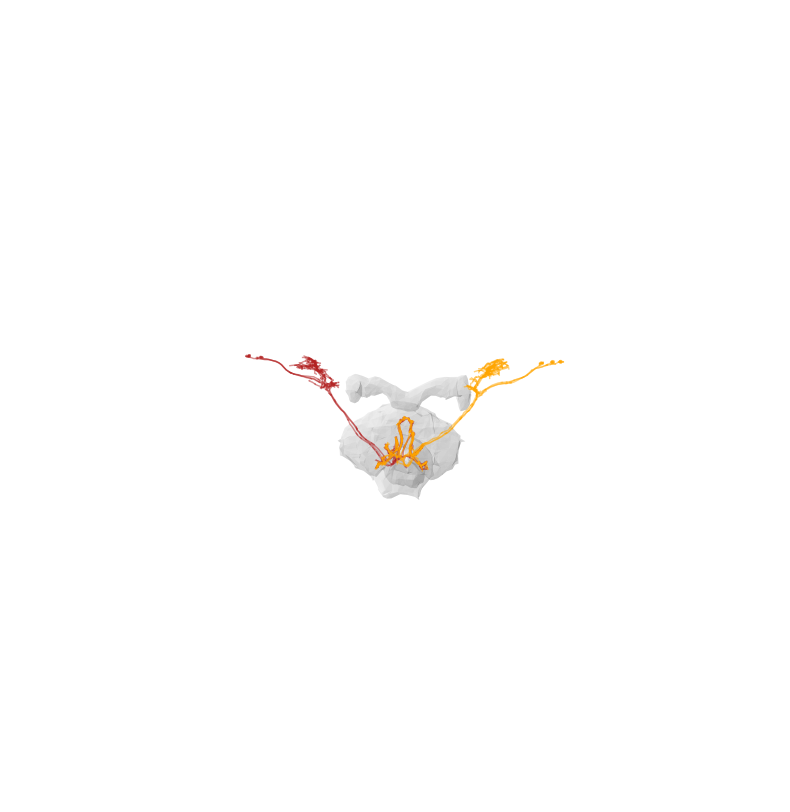

Layer 3 | SA1 | 0.2851444679253609


Fetching L2 skeletons:   0%|          | 0/12 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/12 [00:00<?, ?it/s]

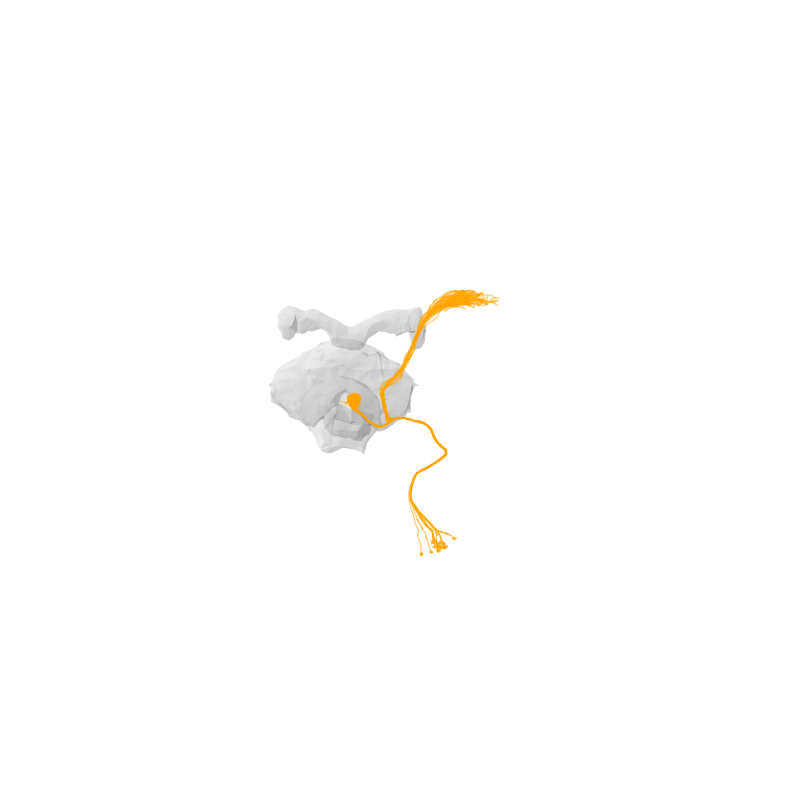

Layer 3 | SA3 | 0.27052870293079306


Fetching L2 skeletons:   0%|          | 0/7 [00:00<?, ?it/s]

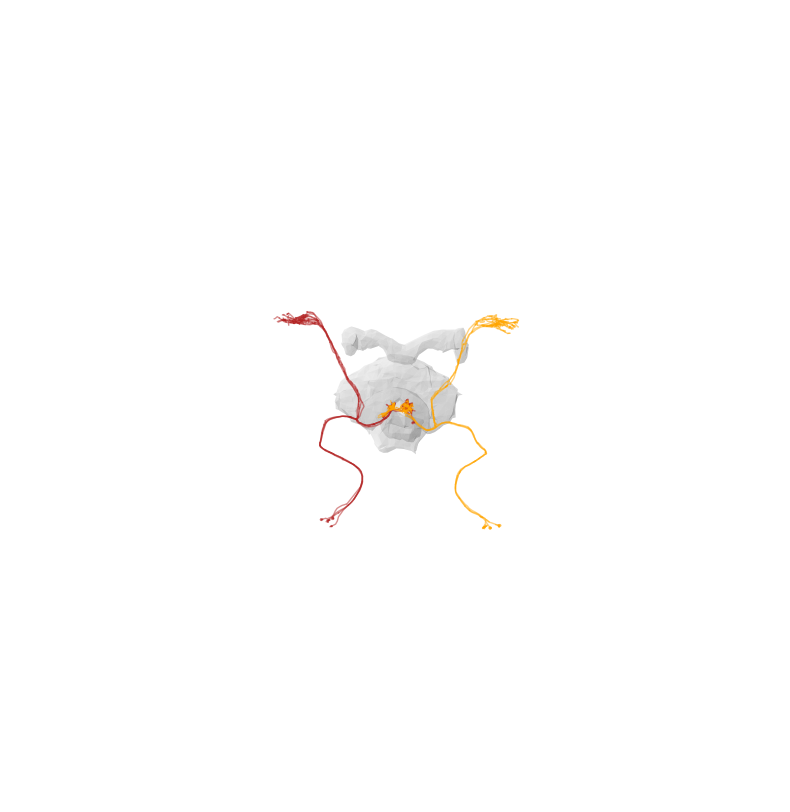

Layer 3 | FB6T | 0.2731725161433325


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

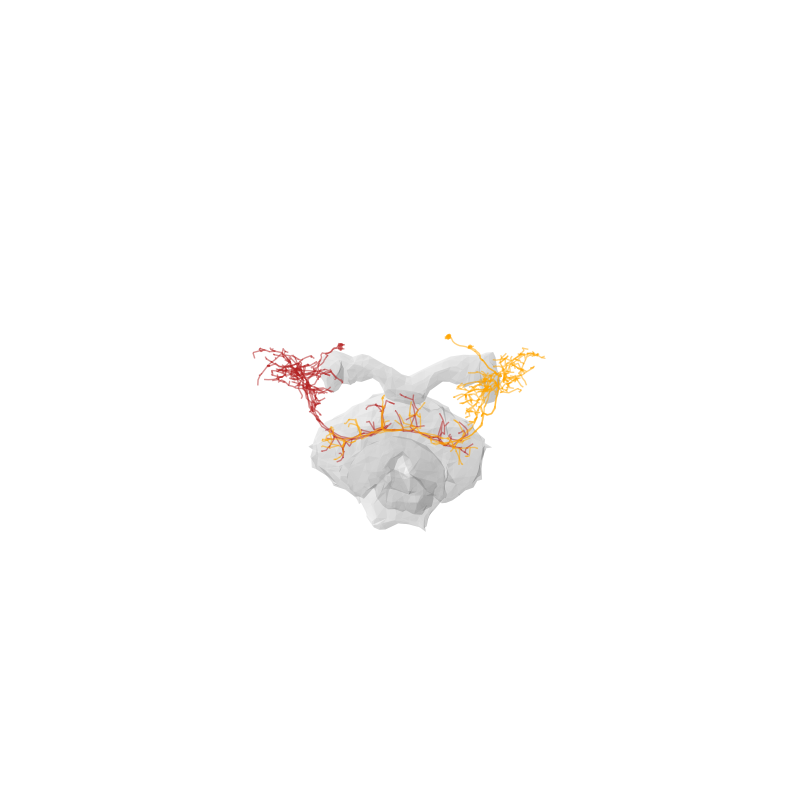

Layer 3 | FB9B | 0.2598150164995329


Fetching L2 skeletons:   0%|          | 0/21 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/21 [00:00<?, ?it/s]

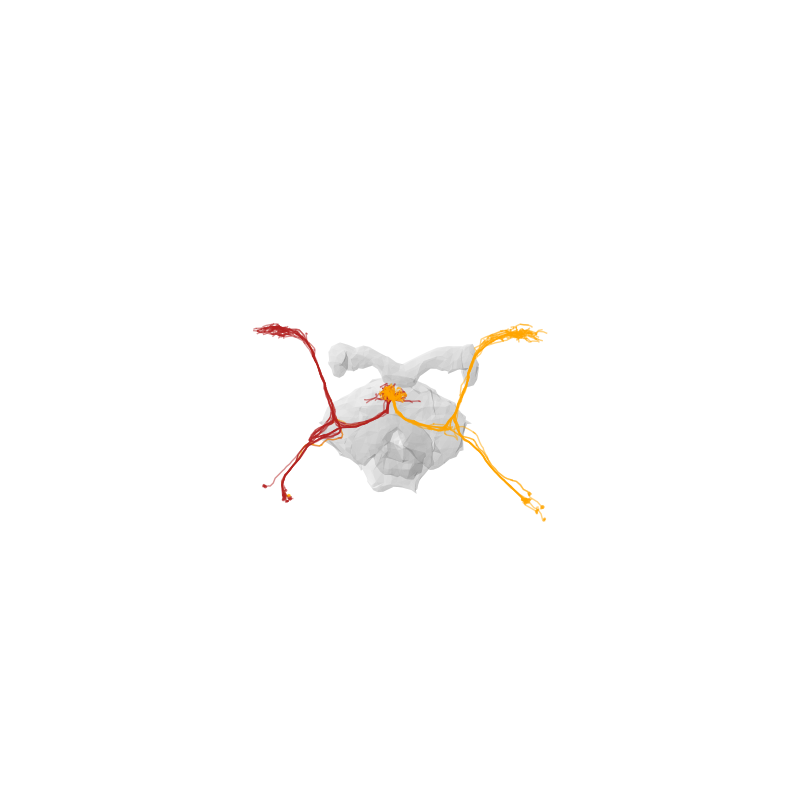

Layer 3 | SA2 | 0.2533414767801914


Fetching L2 skeletons:   0%|          | 0/9 [00:00<?, ?it/s]

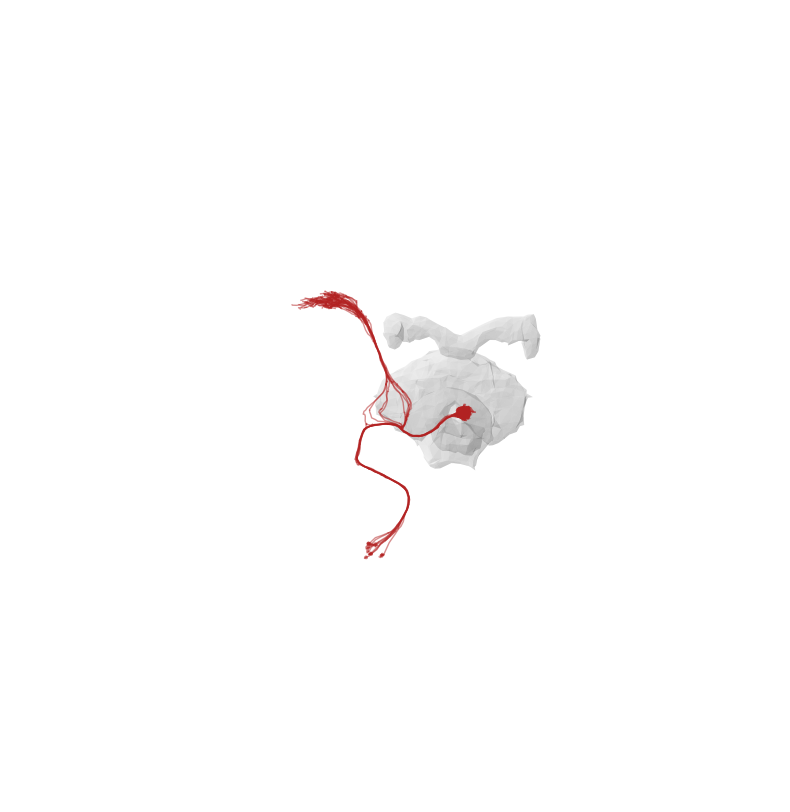

Layer 3 | FB8A/H | 0.23499239996827428


Fetching L2 skeletons:   0%|          | 0/17 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/17 [00:00<?, ?it/s]

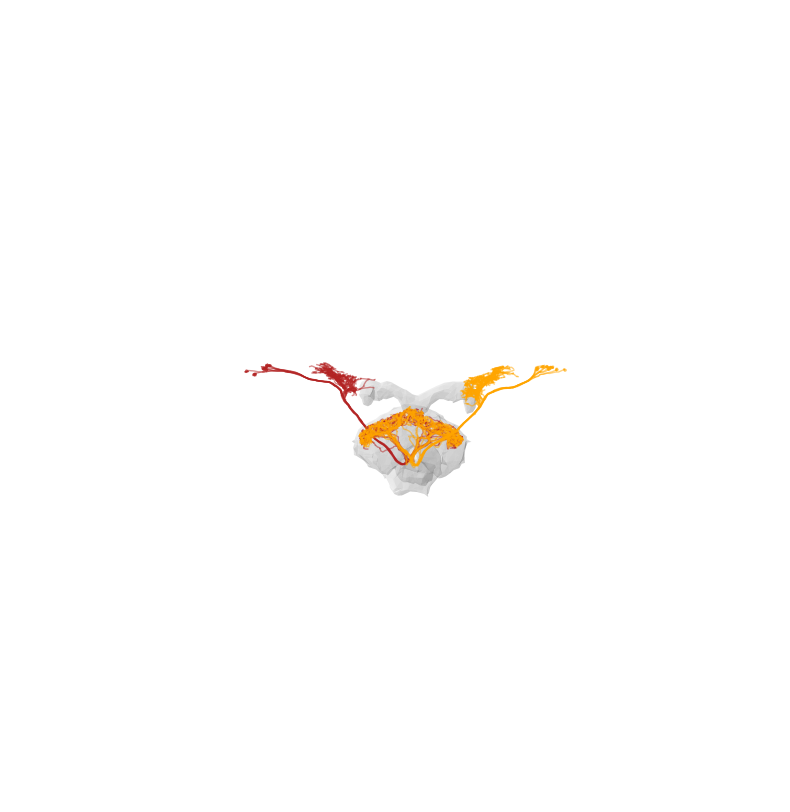

Layer 3 | FB7F/8F | 0.23113700383658378


Fetching L2 skeletons:   0%|          | 0/25 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/25 [00:00<?, ?it/s]

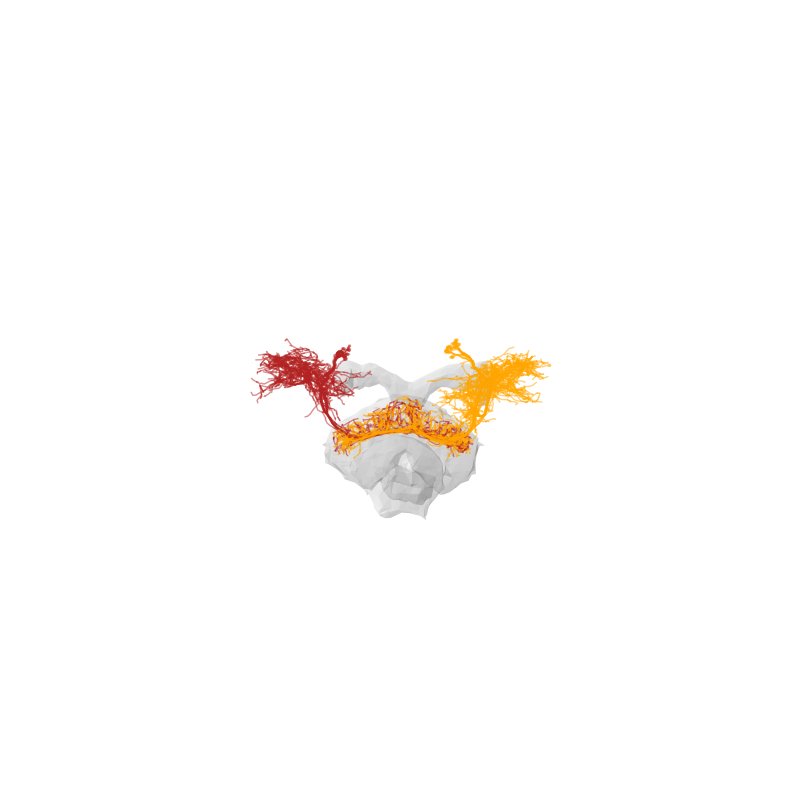

Layer 3 | CB.FB1E0 | 0.23197093910478137


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

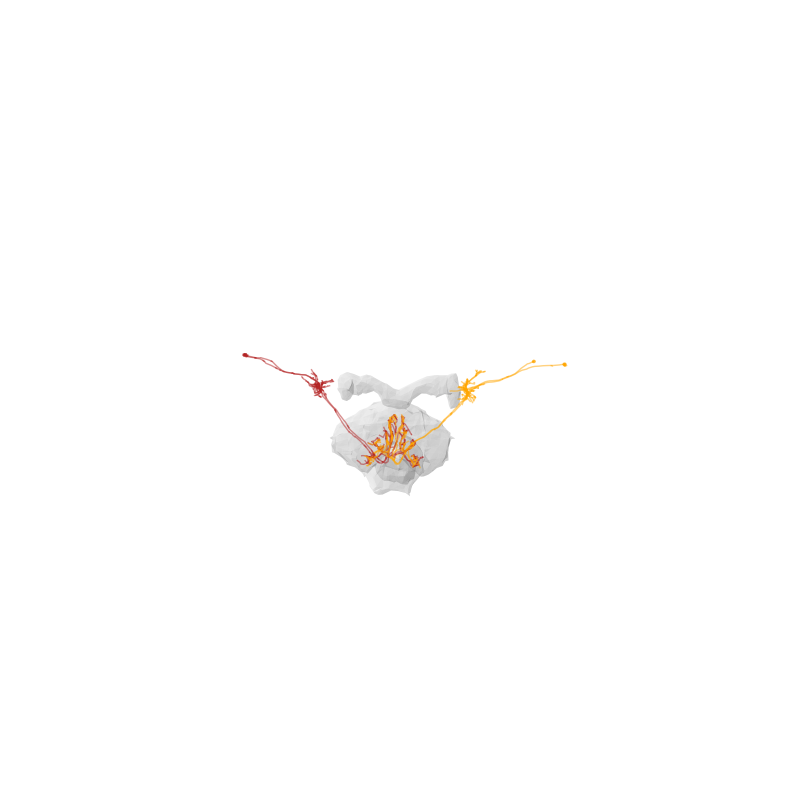

Layer 3 | SAF | 0.21437567216263764


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

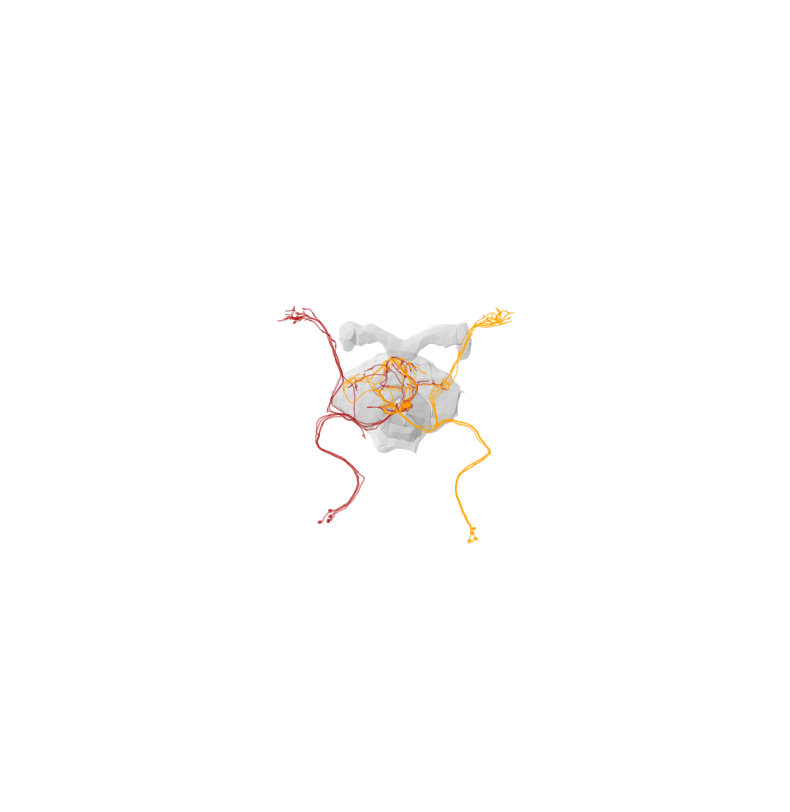

Layer 3 | FB8D | 0.20519631328622126


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

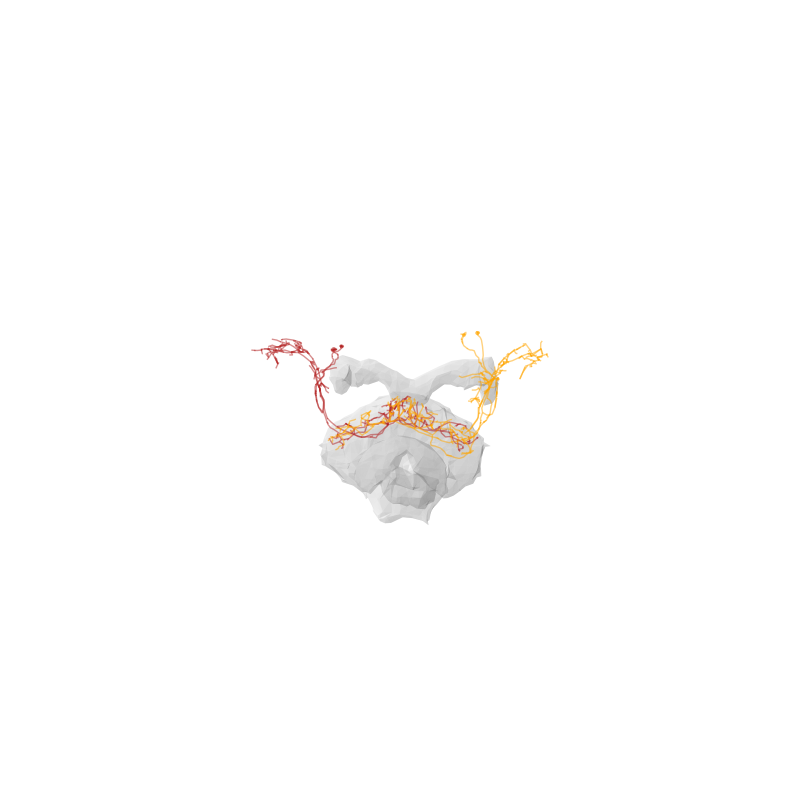

Layer 3 | FB6Q | 0.21339498319024378


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

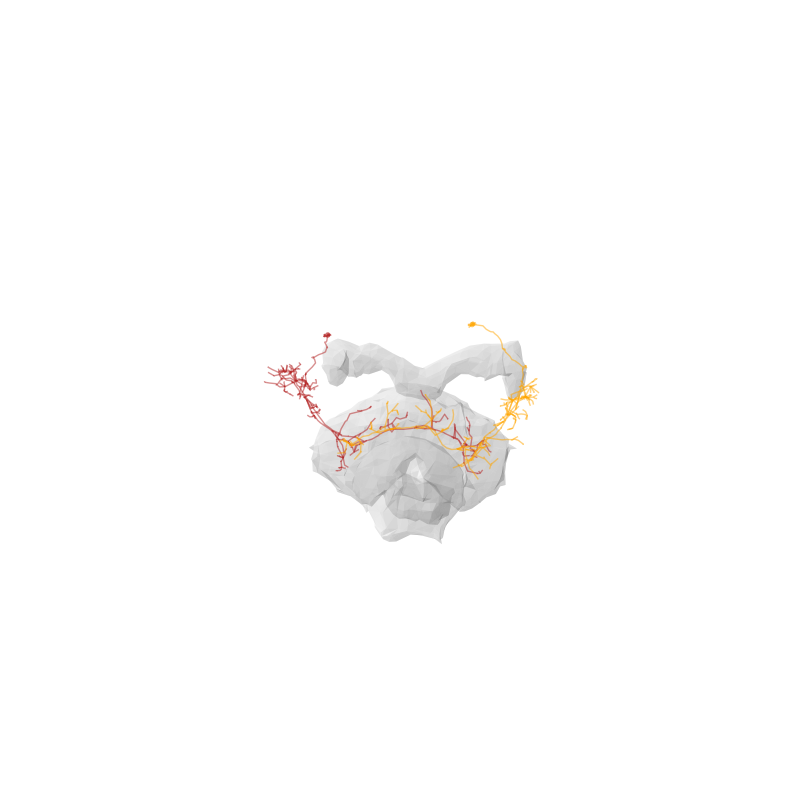

Layer 3 | FB6S | 0.20329396931016333


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

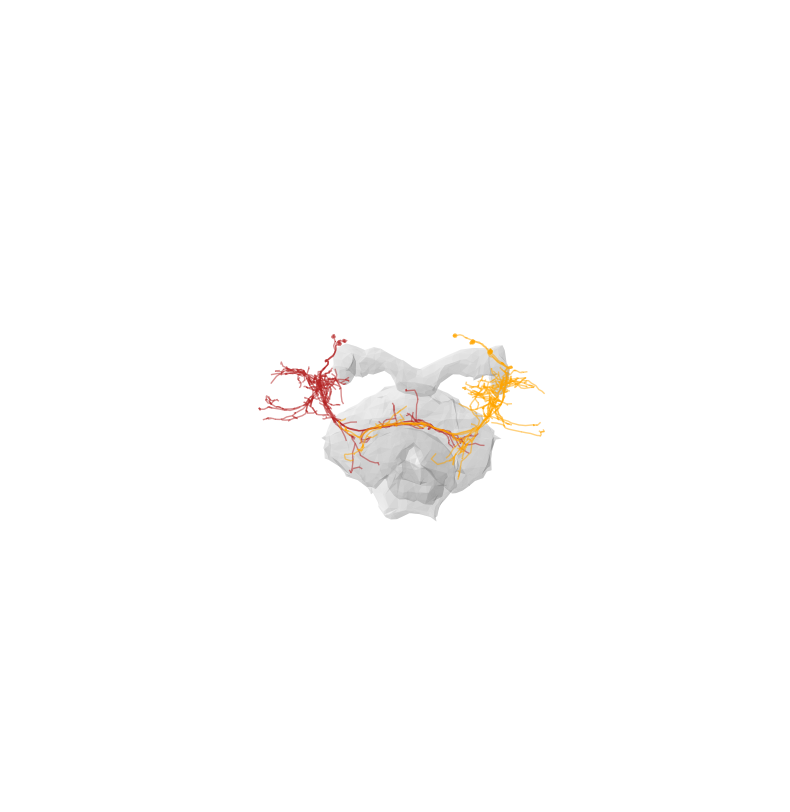

Layer 3 | CB.FB1I1 | 0.16655765283562254


Fetching L2 skeletons:   0%|          | 0/9 [00:00<?, ?it/s]

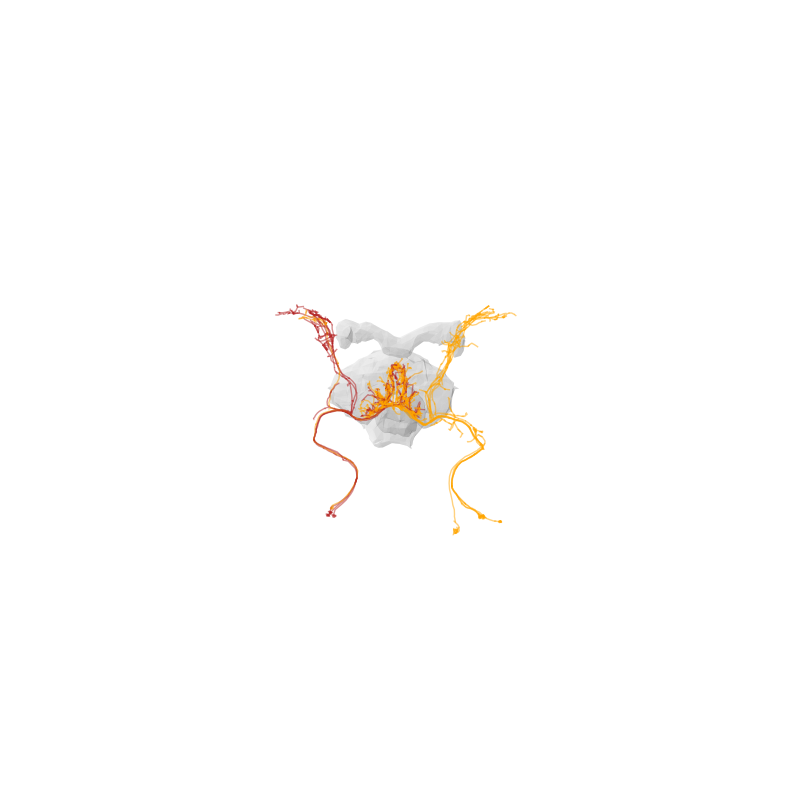

Layer 3 | FB5B | 0.1830216534578279


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

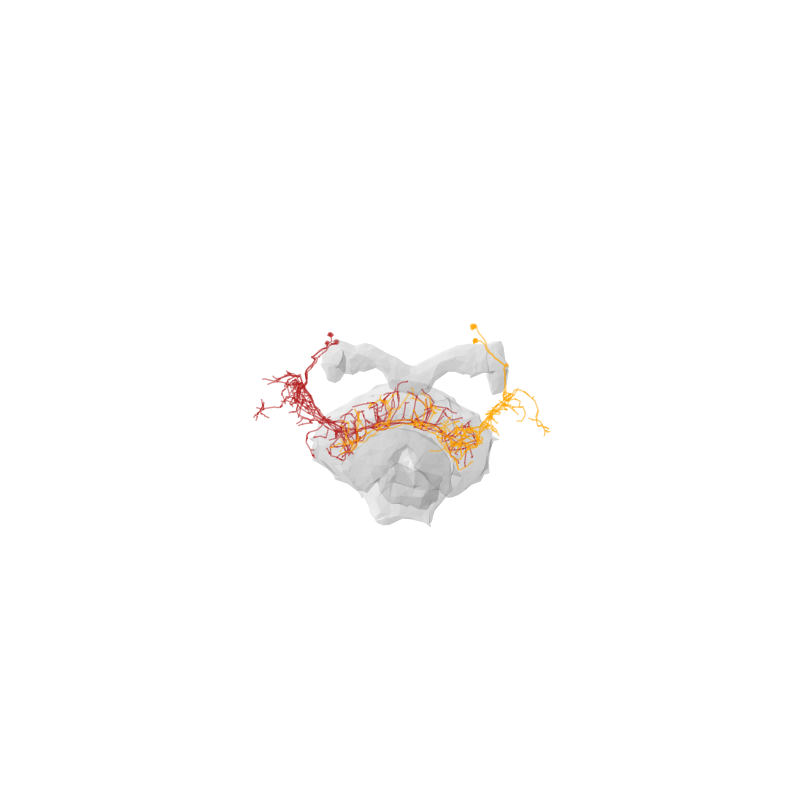

Layer 3 | FB4K | 0.16401172100437417


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

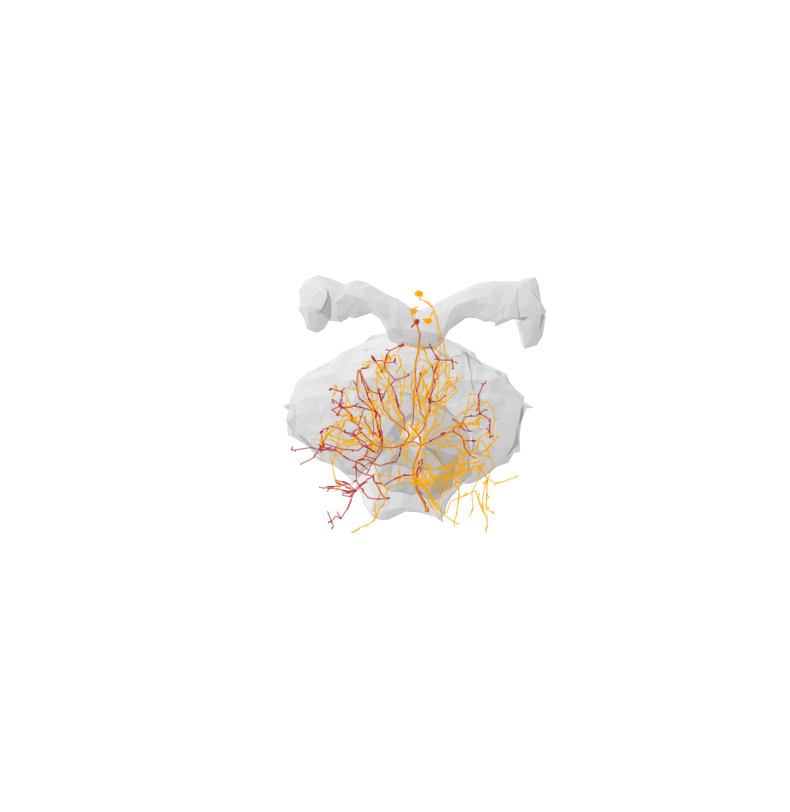

Layer 3 | FB7A/K | 0.1793901209399739


Fetching L2 skeletons:   0%|          | 0/10 [00:00<?, ?it/s]

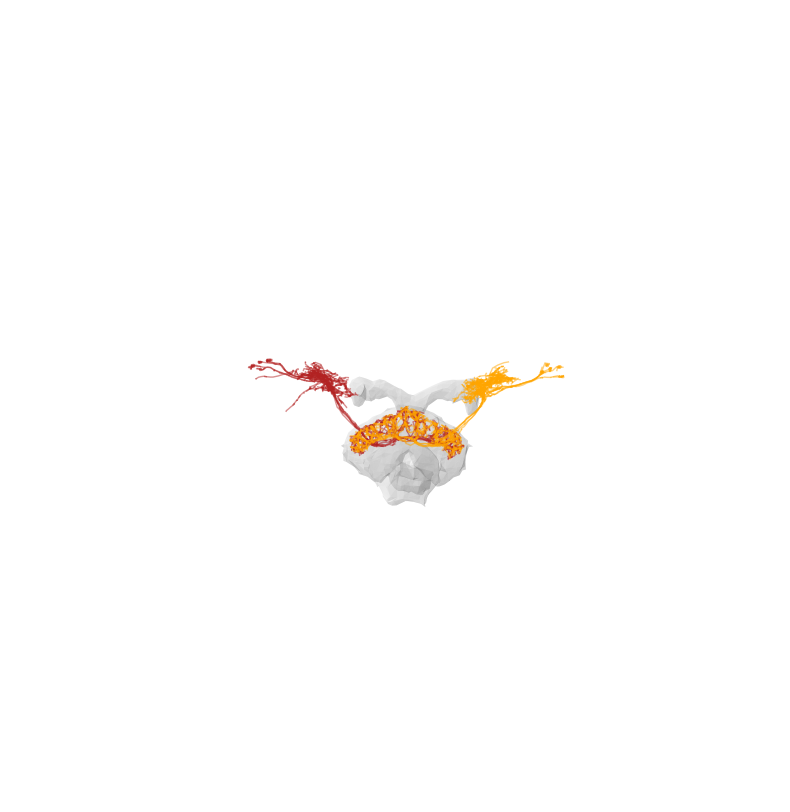

Layer 3 | FB8E | 0.17848763809986076


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

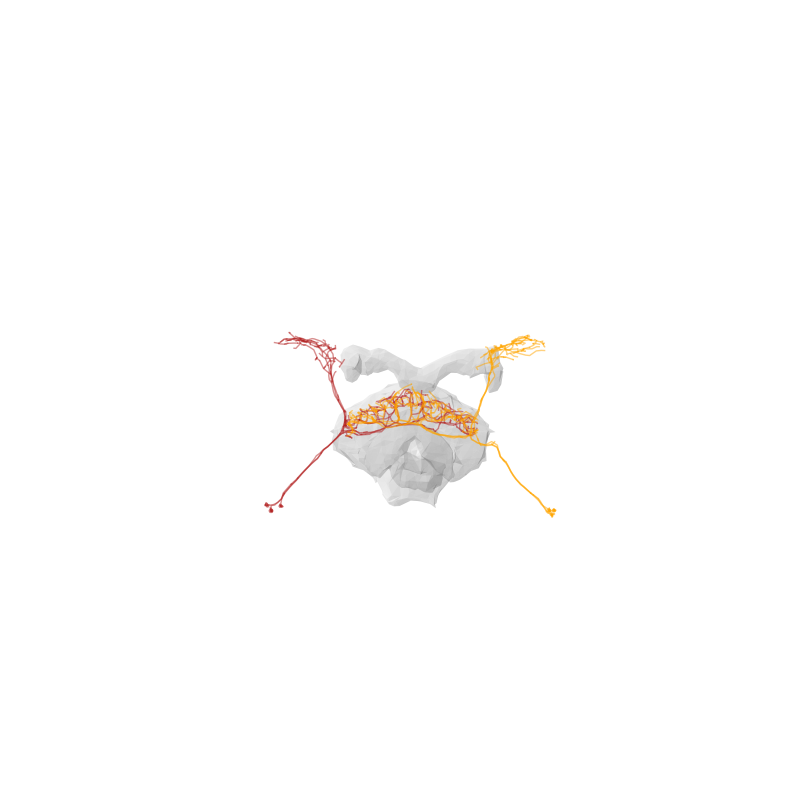

Layer 3 | FB1G | 0.1796890436021748


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

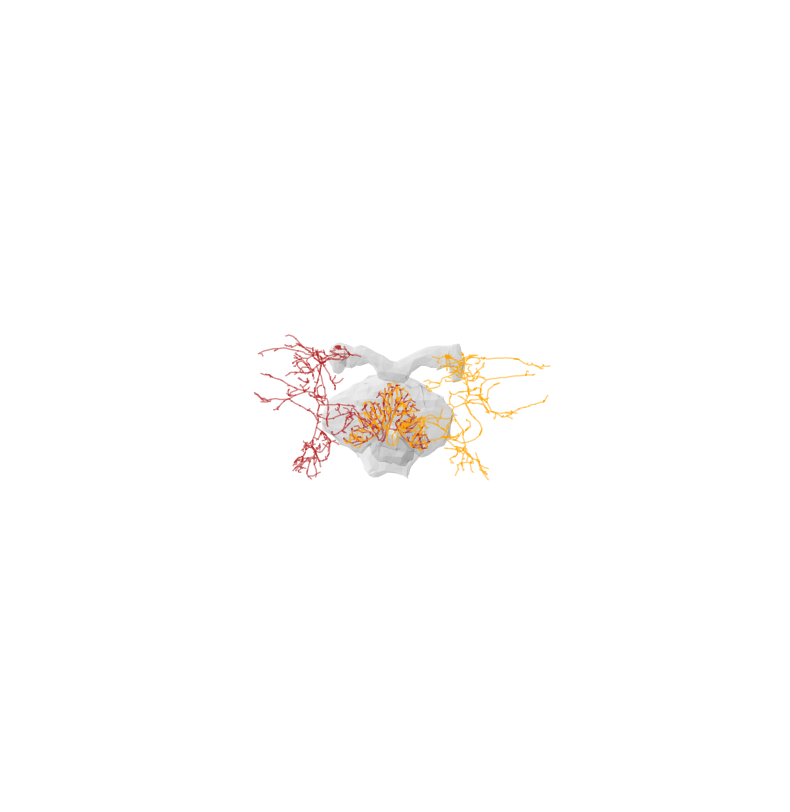

Layer 3 | FB5AB | 0.17810556587293455


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

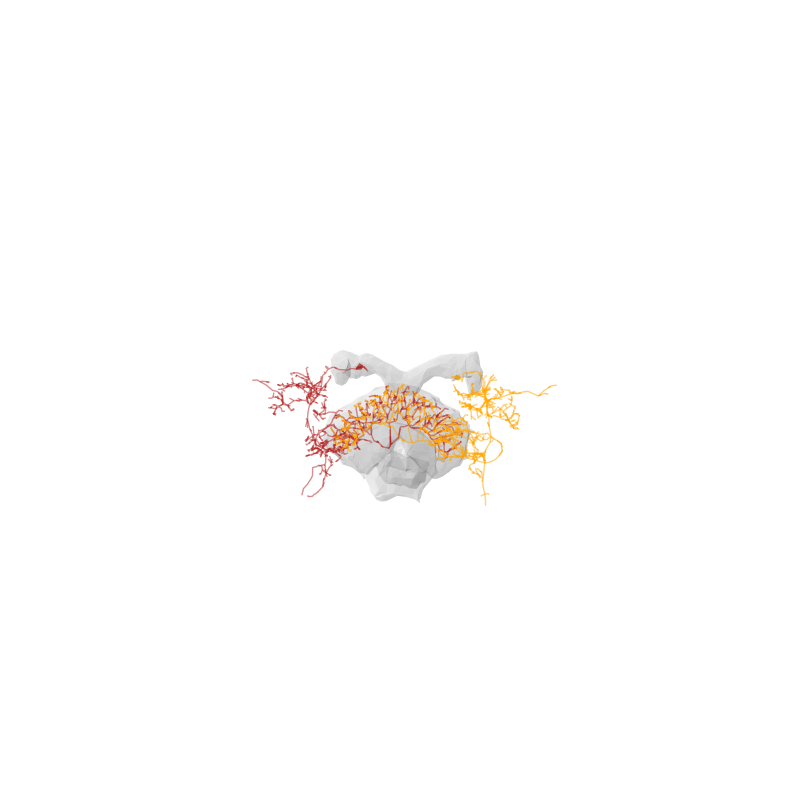

Layer 3 | CB.FB1I0 | 0.17590923379159049


Fetching L2 skeletons:   0%|          | 0/3 [00:00<?, ?it/s]

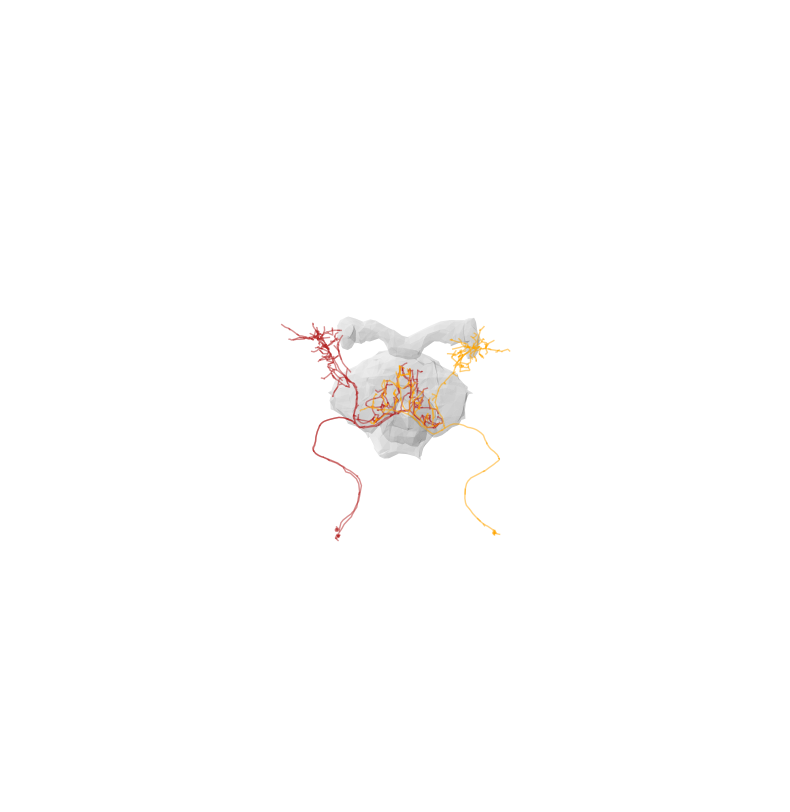

Layer 3 | CB.FB2E2 | 0.17292183429085345


Fetching L2 skeletons:   0%|          | 0/7 [00:00<?, ?it/s]

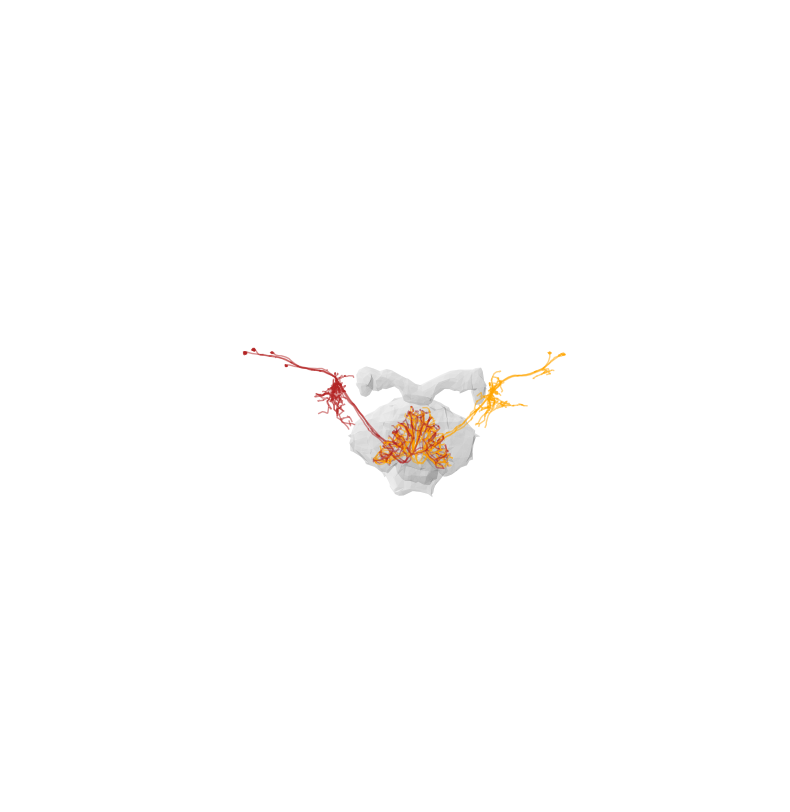

Layer 3 | CB.FB2E6 | 0.17140307093576307


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

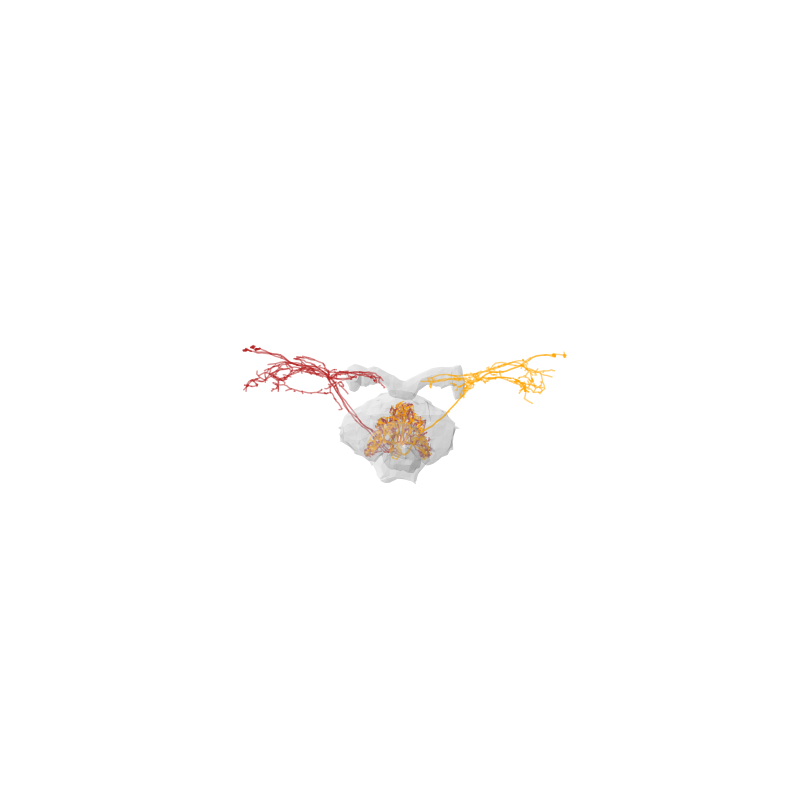

Layer 3 | CB.FB6E3 | 0.16811546993118928


Fetching L2 skeletons:   0%|          | 0/7 [00:00<?, ?it/s]

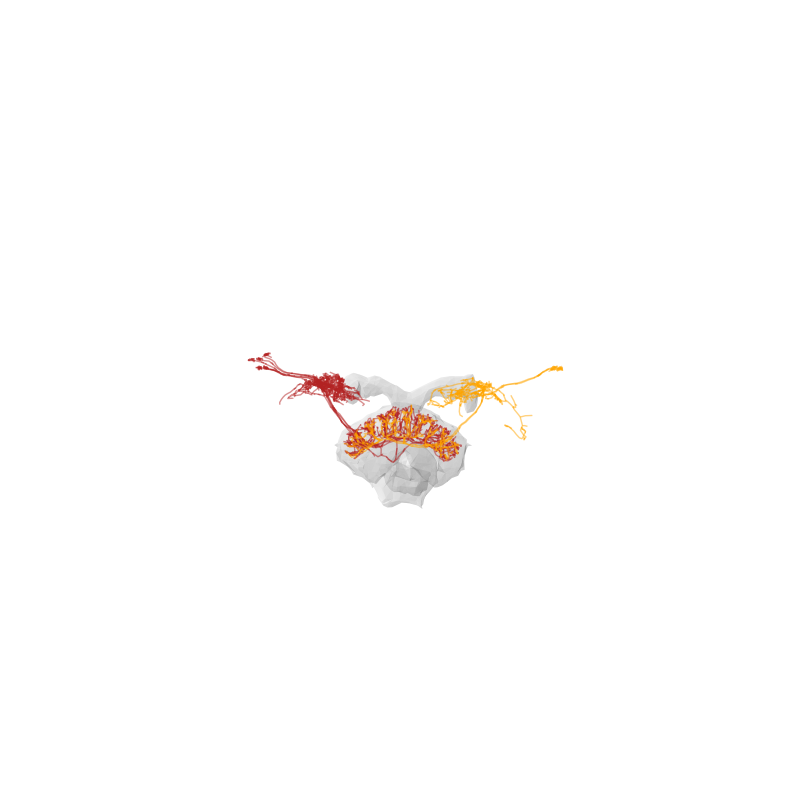

Layer 3 | FB6Z | 0.1697554477940898


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

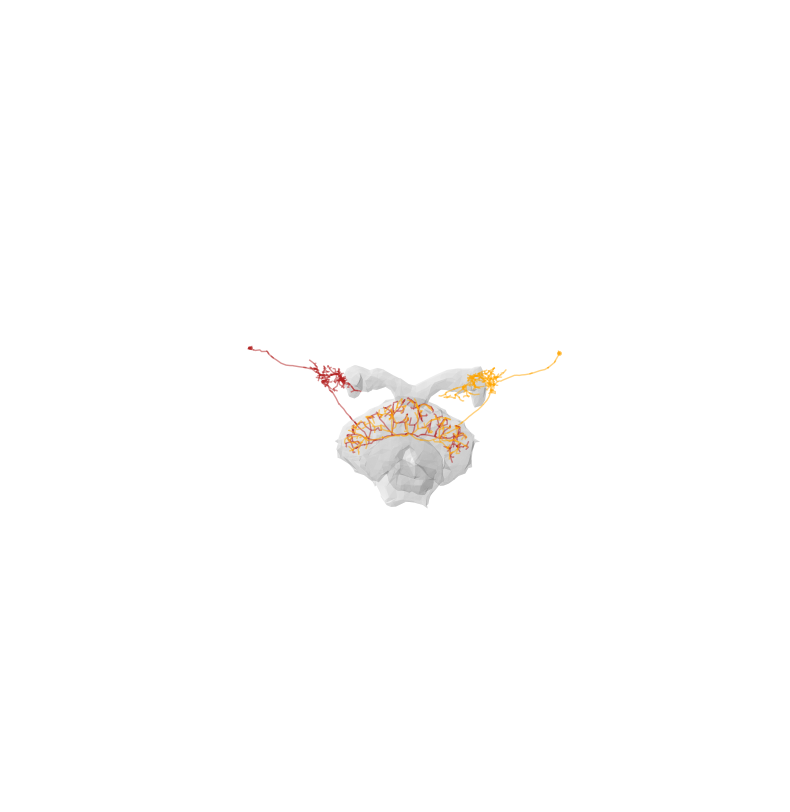

Layer 3 | FB4P/Q/R | 0.1522002238727057


Fetching L2 skeletons:   0%|          | 0/11 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/11 [00:00<?, ?it/s]

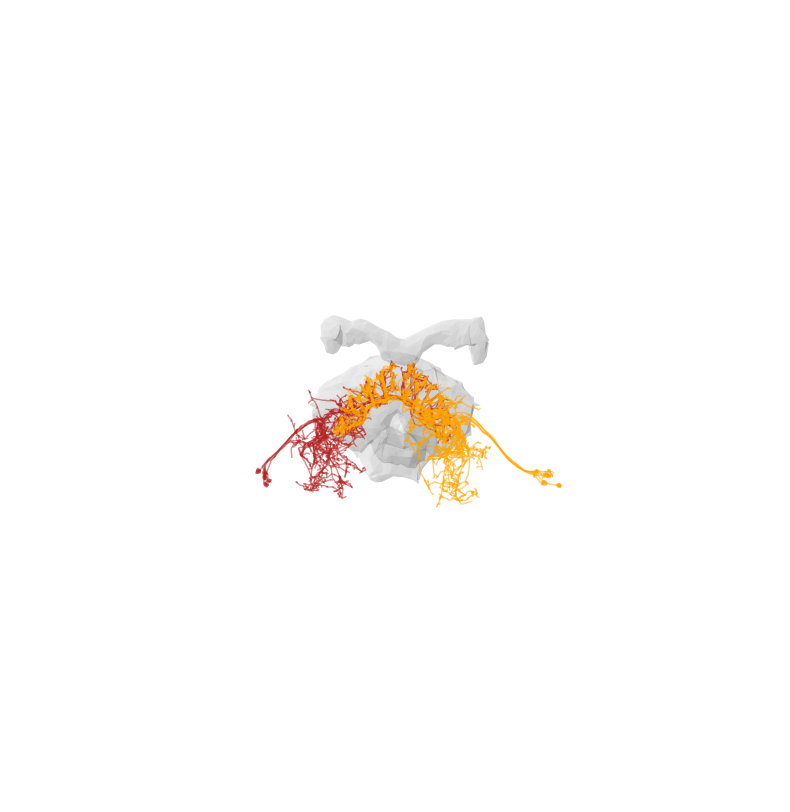

Layer 3 | FB6V | 0.16292351668125743


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

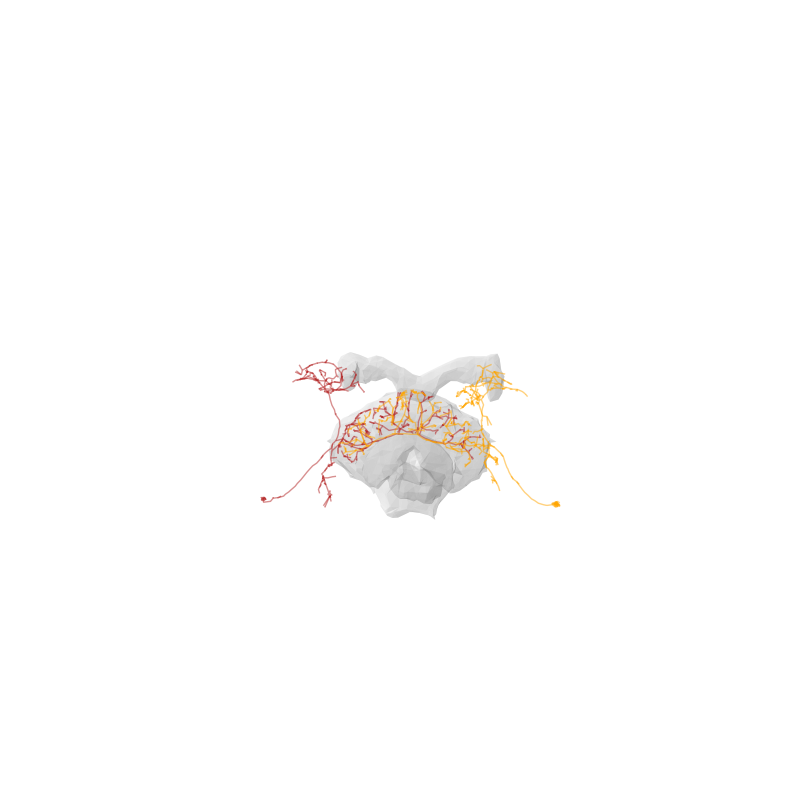

Layer 3 | CB.FB6E4 | 0.1564157566299708


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

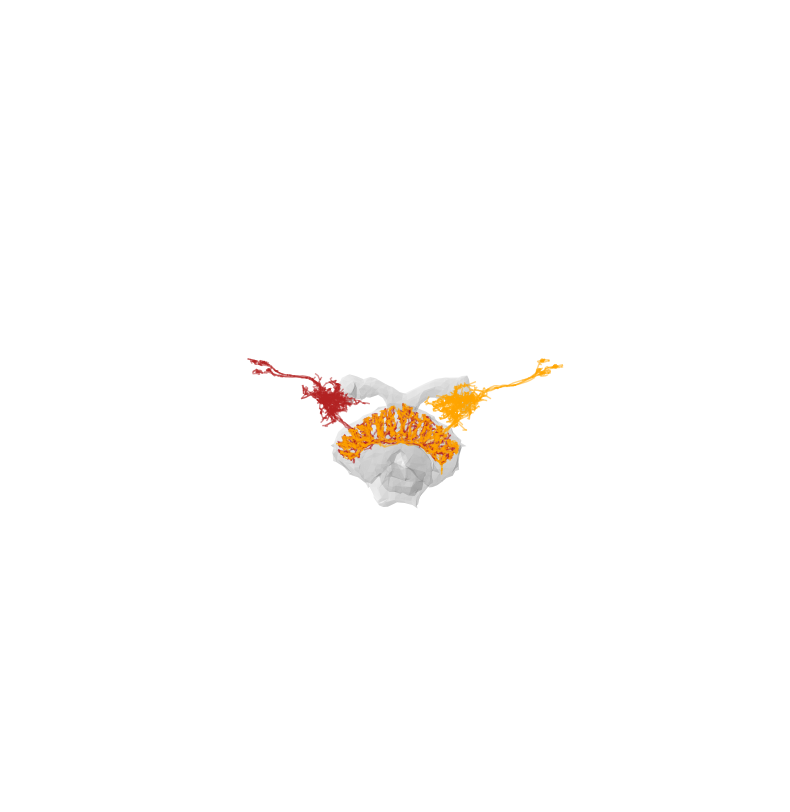

Layer 3 | CB.FB2E5 | 0.15744348706062203


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

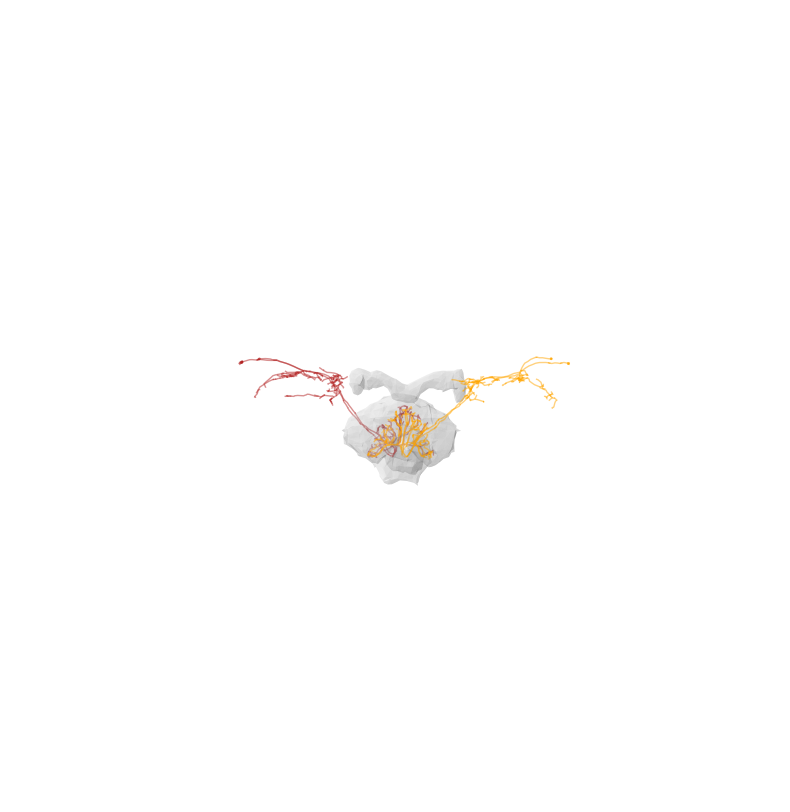

Layer 3 | FB7B | 0.1524560453844001


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

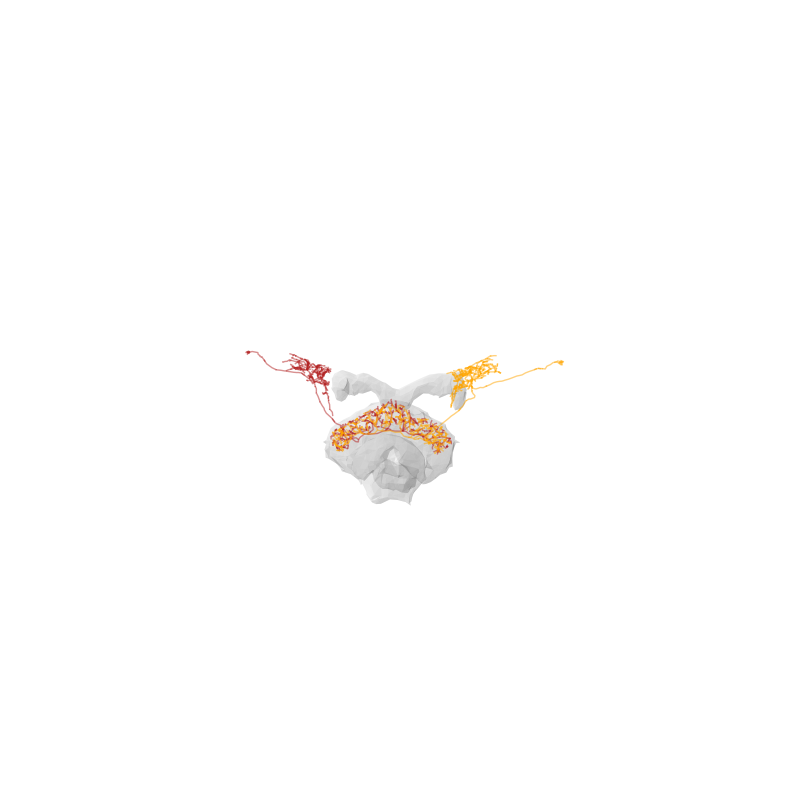

Layer 3 | FS4A/B/C | 0.14210092239632777


Fetching L2 skeletons:   0%|          | 0/124 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/124 [00:00<?, ?it/s]

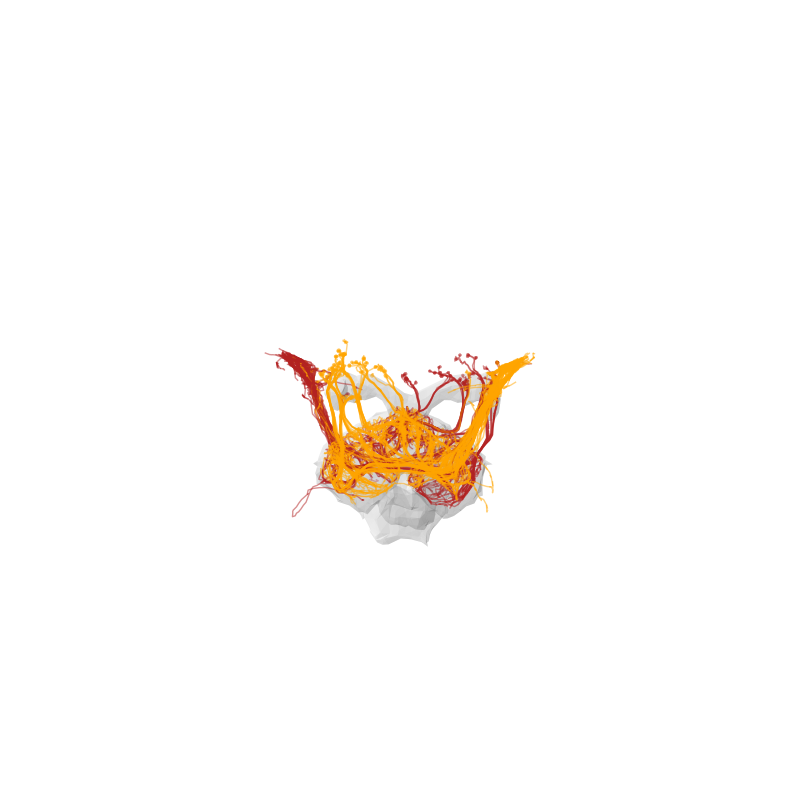

Layer 3 | FB6F | 0.15094414874784057


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

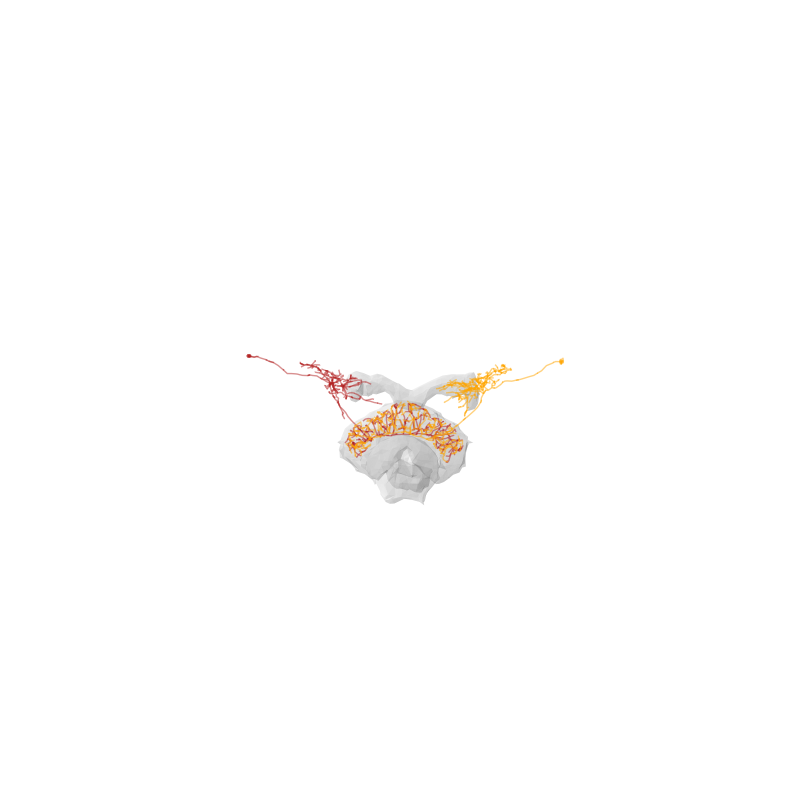

Layer 3 | CB.FB2E4 | 0.1494050596245894


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

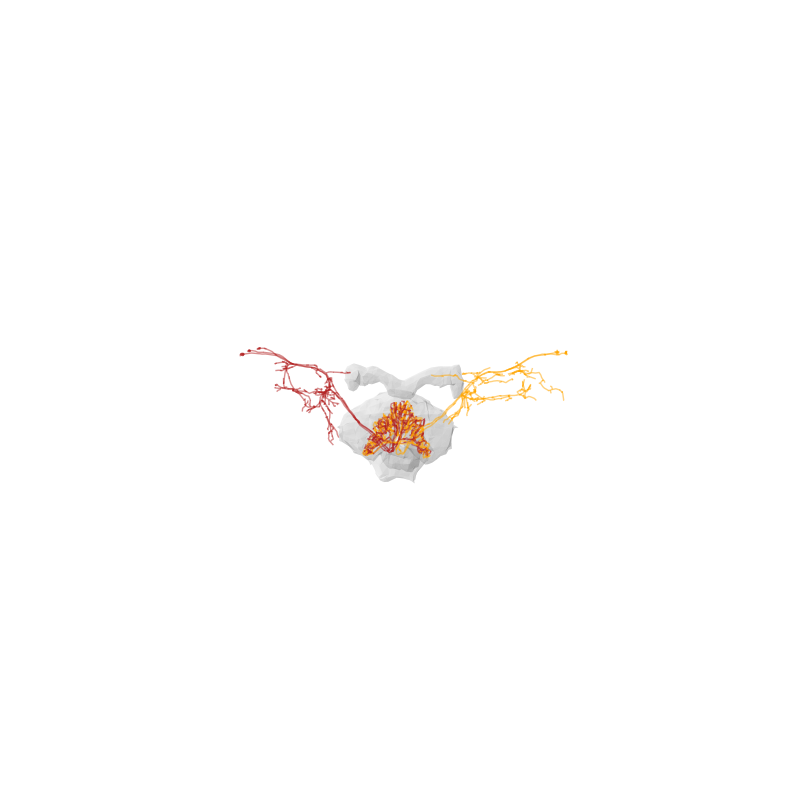

Layer 3 | CB.FB7E1 | 0.14692468777482393


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

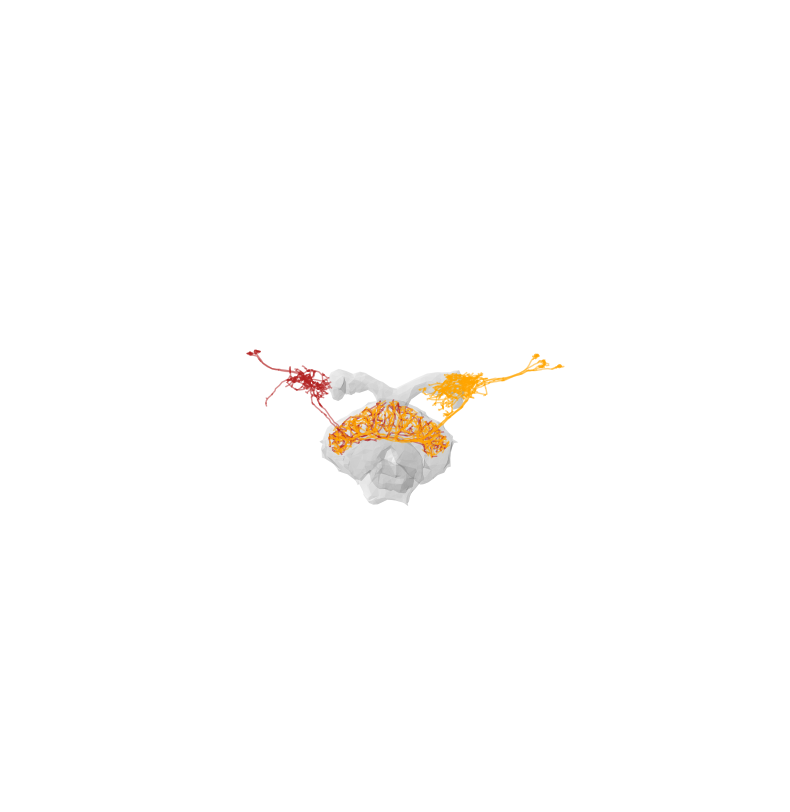

Layer 3 | FB4O | 0.1447584829202696


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

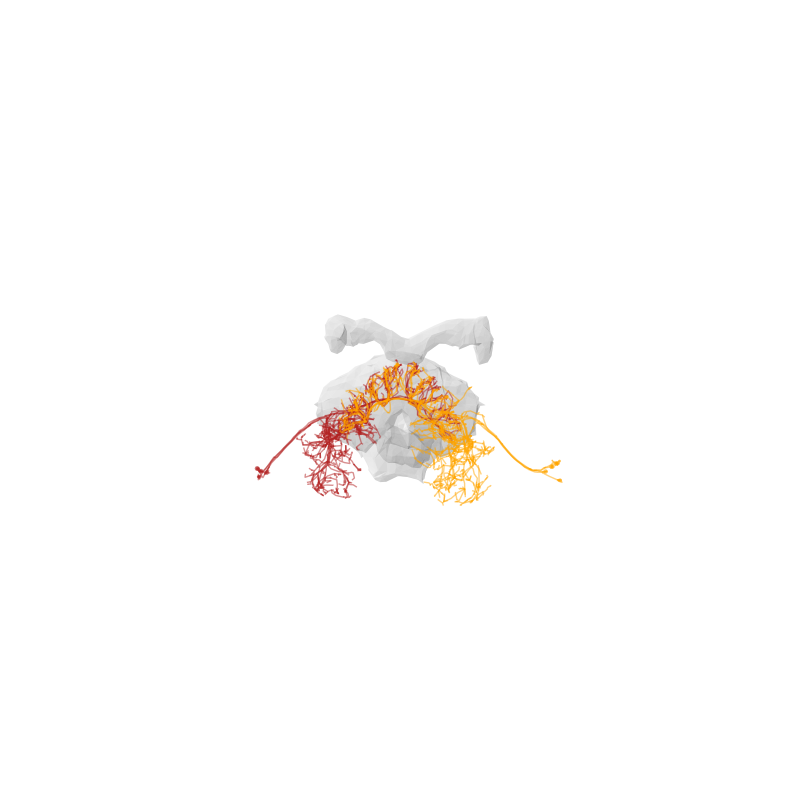

Layer 3 | CB.FB2E1 | 0.1435863683515485


Fetching L2 skeletons:   0%|          | 0/9 [00:00<?, ?it/s]

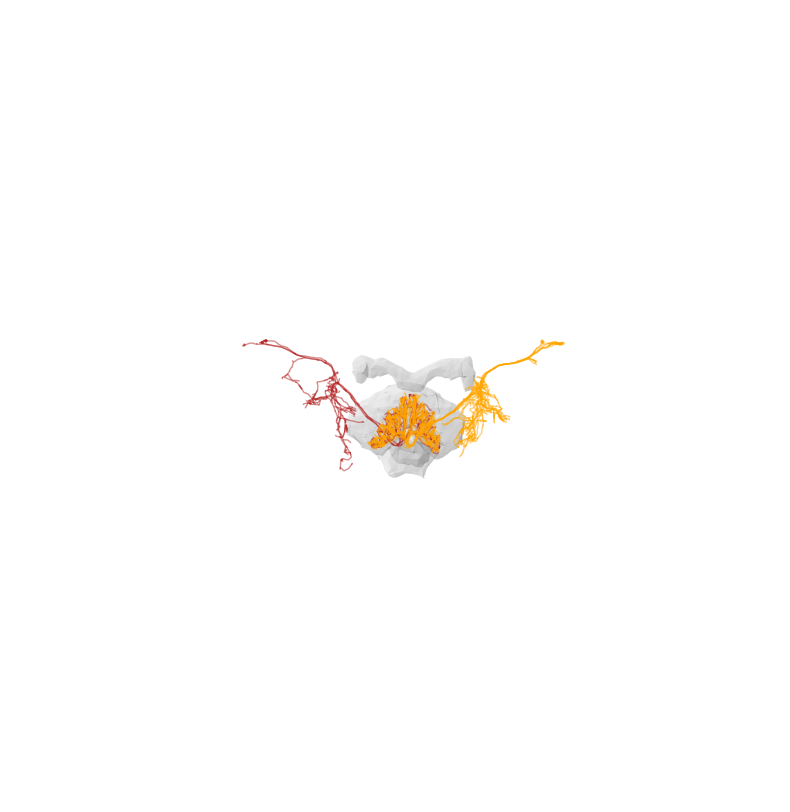

Layer 3 | CB.FB6C2 | 0.1441441941040814


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

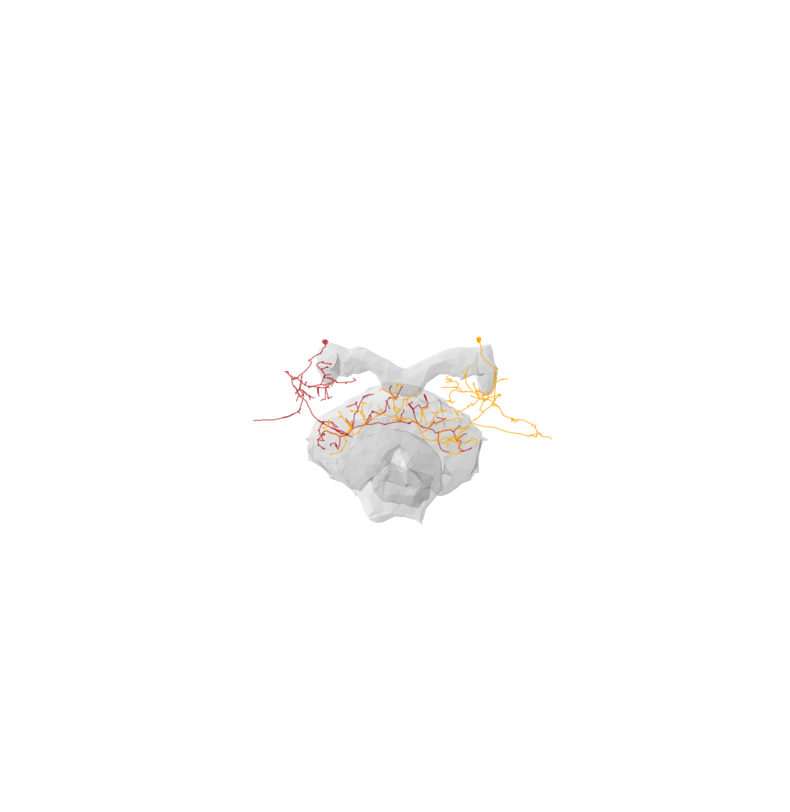

Layer 3 | FB1H | 0.14349083754633388


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

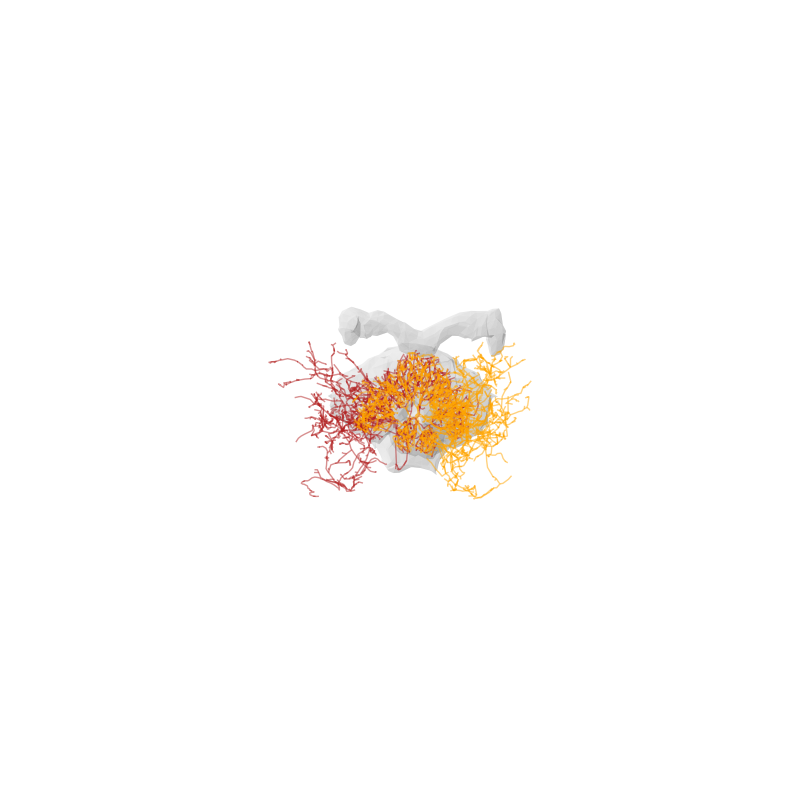

Layer 3 | CB.FB2I0 | 0.13821717045761853


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

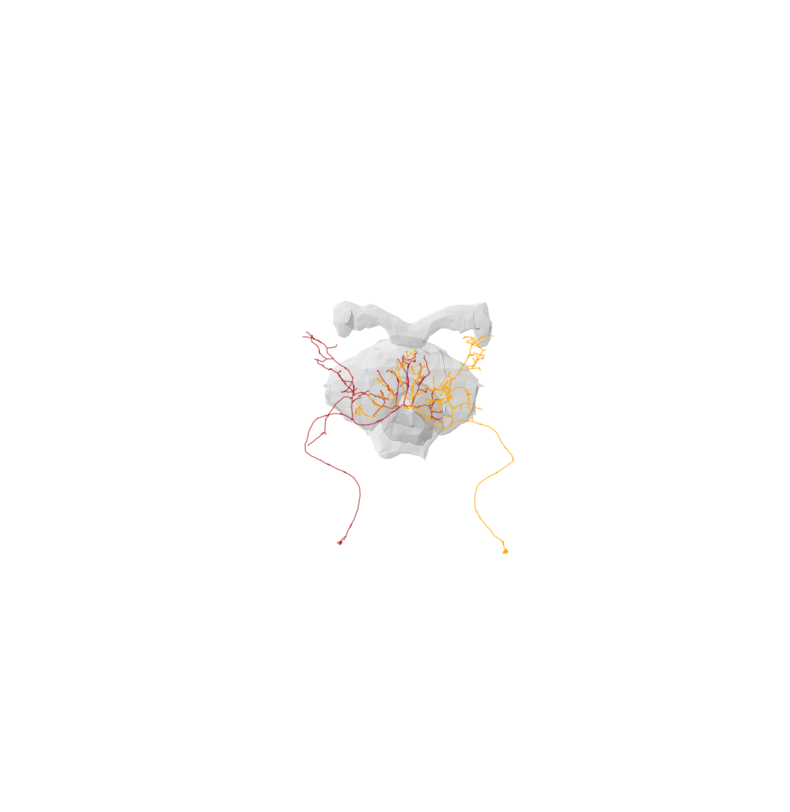

Layer 3 | FB6K | 0.12713650329263923


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

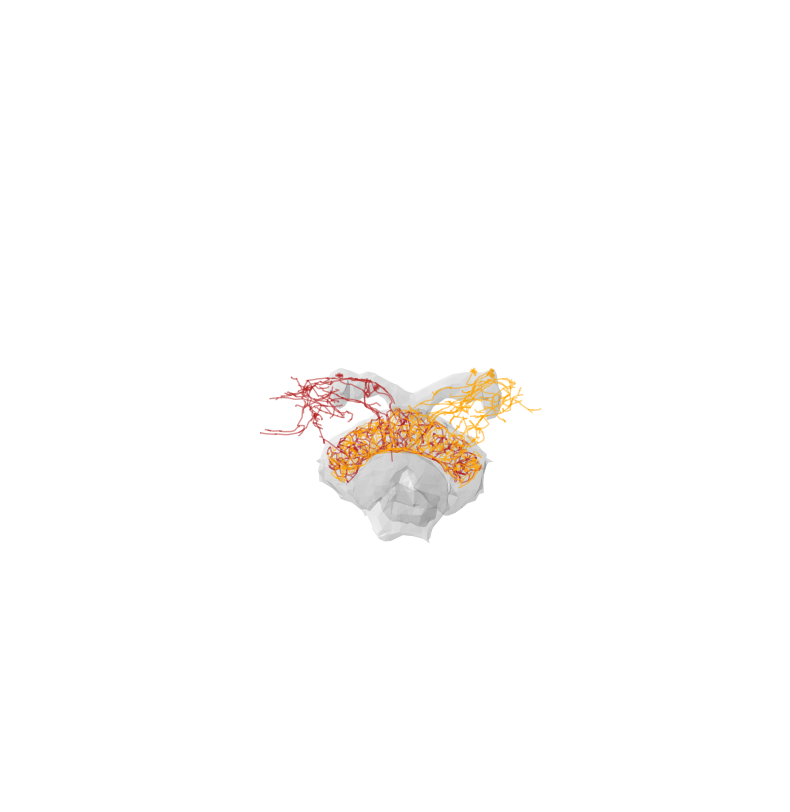

Layer 3 | FB5H | 0.13892561997039468


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

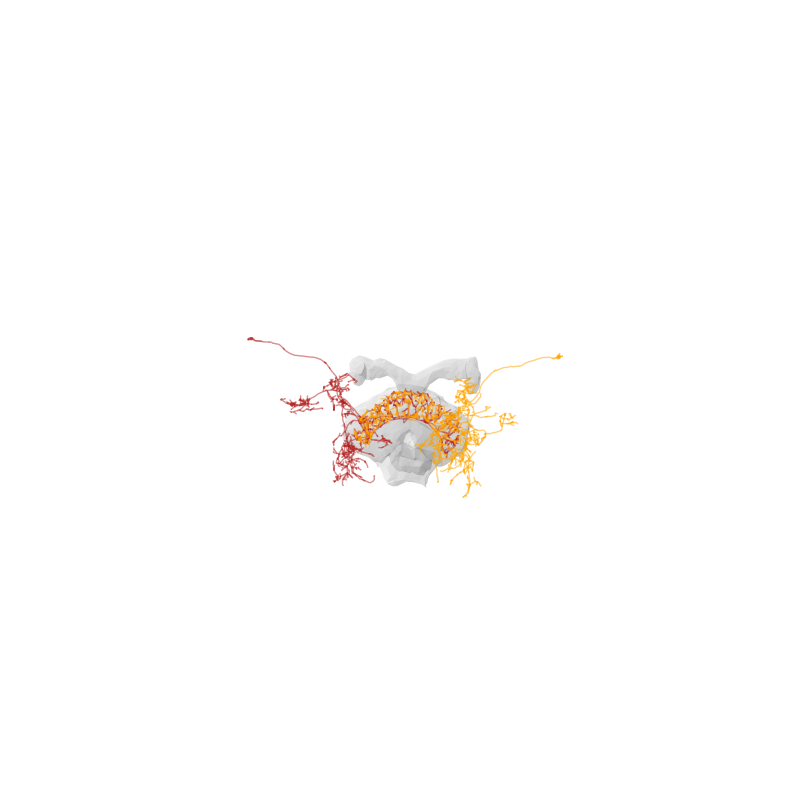

Layer 3 | FB6W | 0.12889410291798453


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

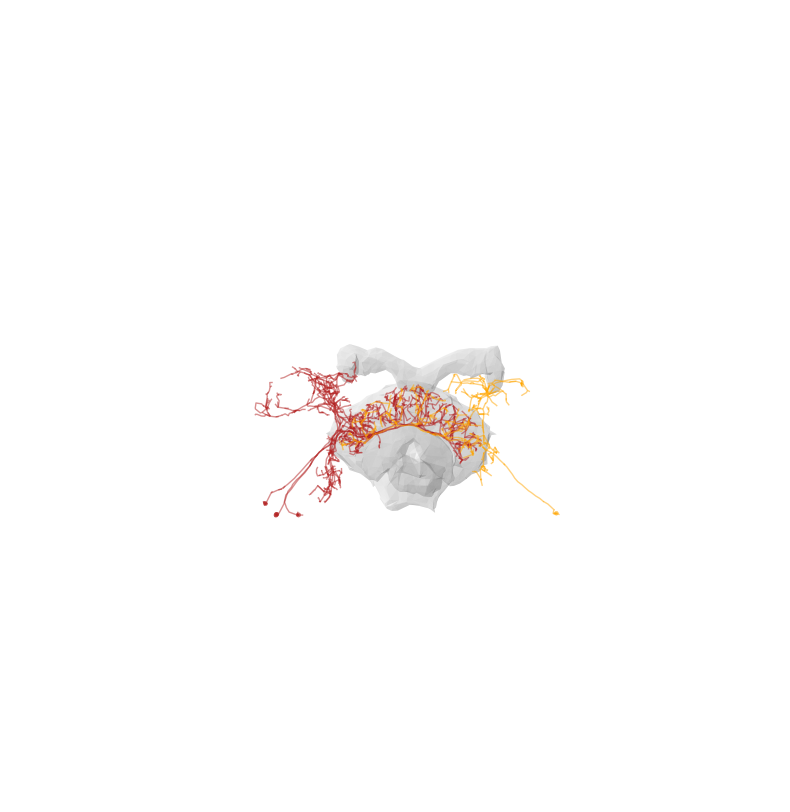

Layer 3 | FB5J/K/L/M/N/W | 0.12799279867935703


Fetching L2 skeletons:   0%|          | 0/18 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/18 [00:00<?, ?it/s]

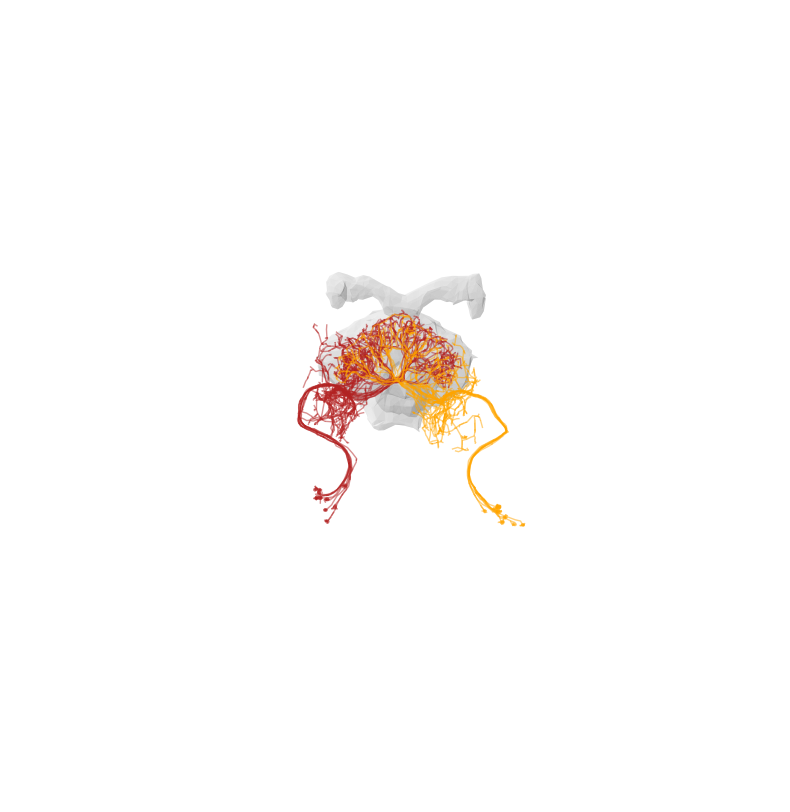

Layer 3 | CB.FB5I0 | 0.13611569411130203


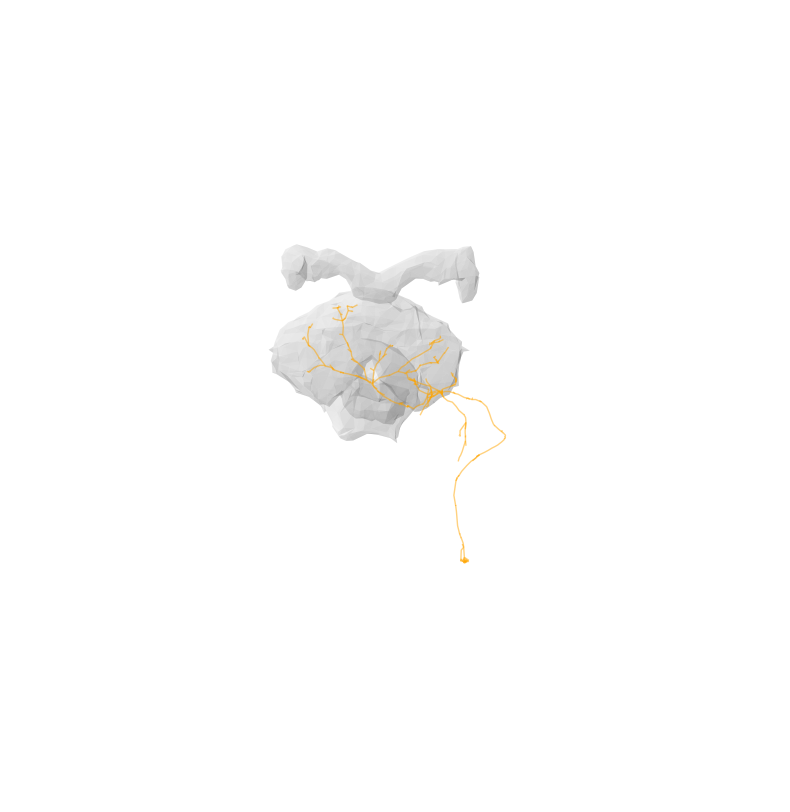

Layer 3 | FB8I | 0.13438479297456685


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

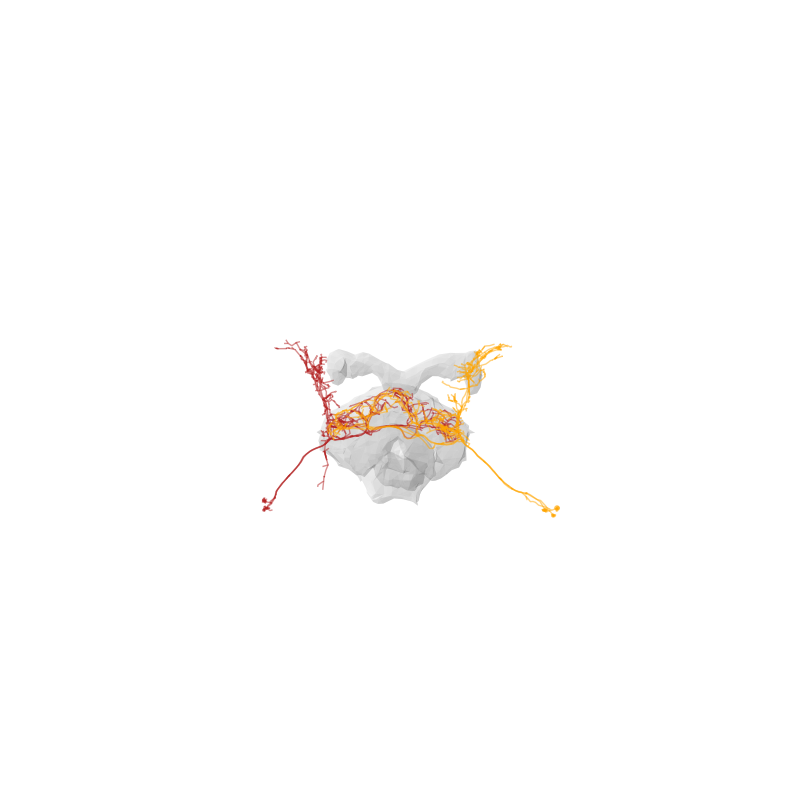

Layer 3 | FB8B | 0.13040295988811829


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

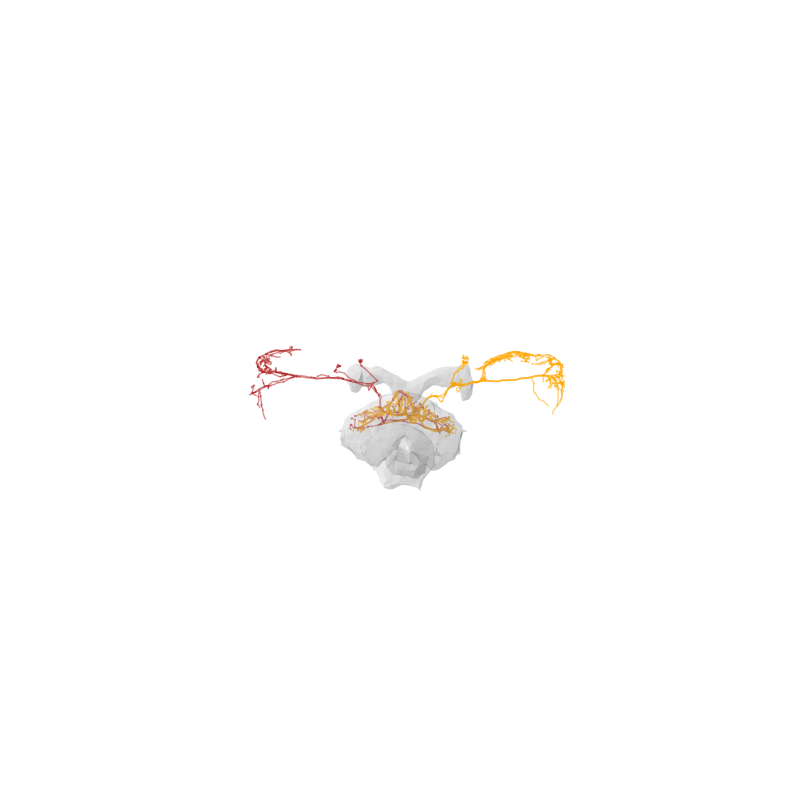

Layer 3 | CB.FB7D0 | 0.12831080410398324


Fetching L2 skeletons:   0%|          | 0/10 [00:00<?, ?it/s]

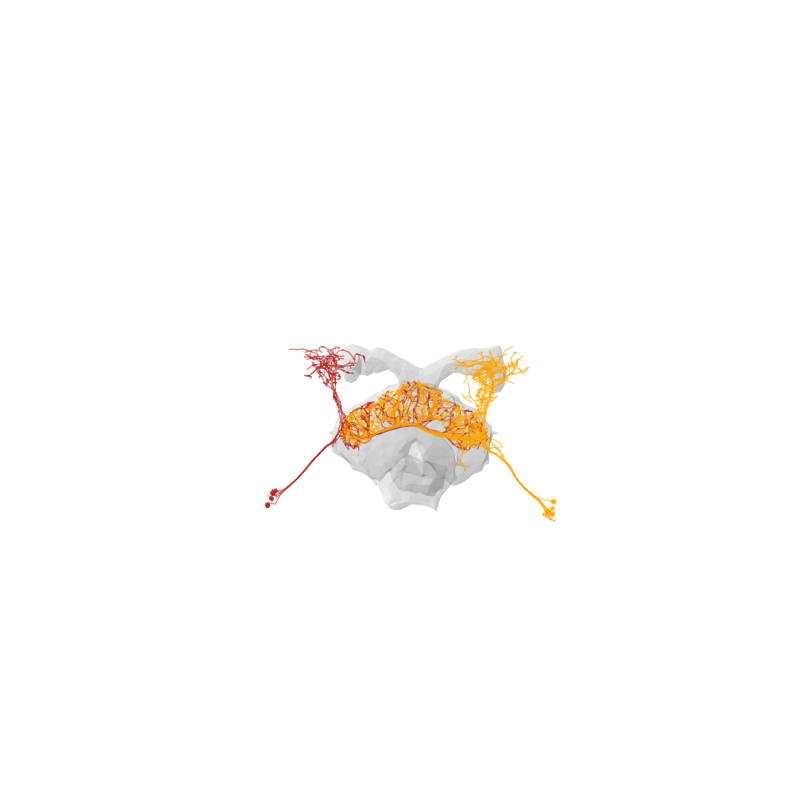

Layer 3 | FB5Y | 0.13031384619156436


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

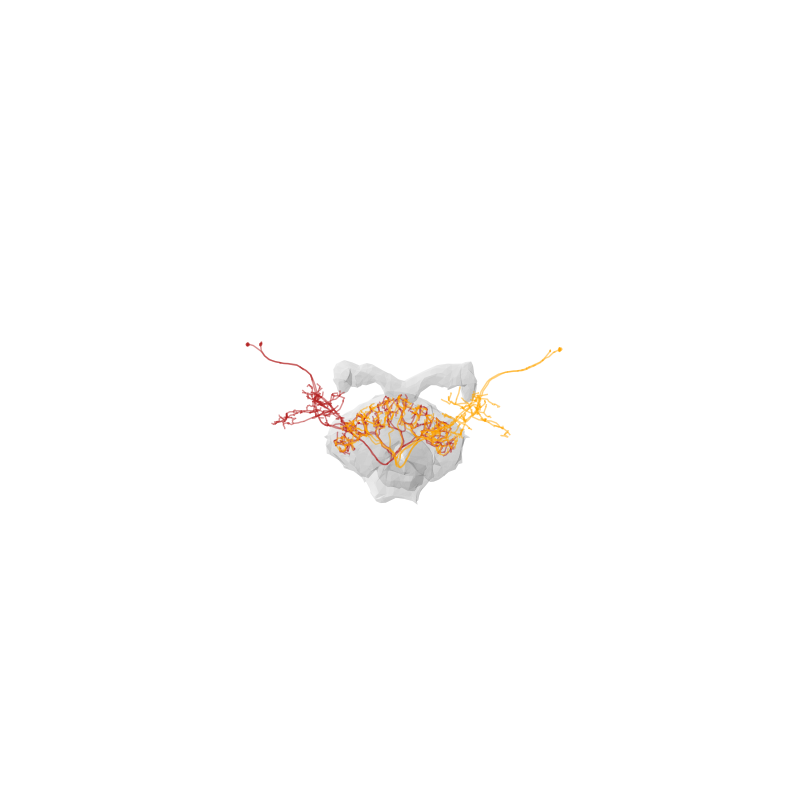

Layer 3 | FB6R | 0.12985180192985402


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

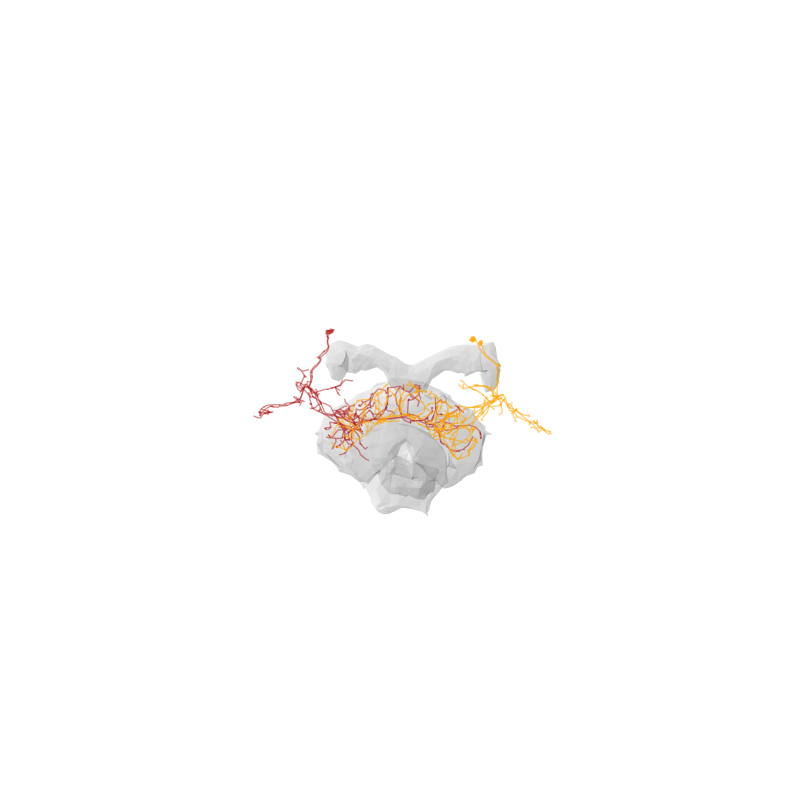

Layer 3 | CB.FB3/4L1 | 0.12761436642883955


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

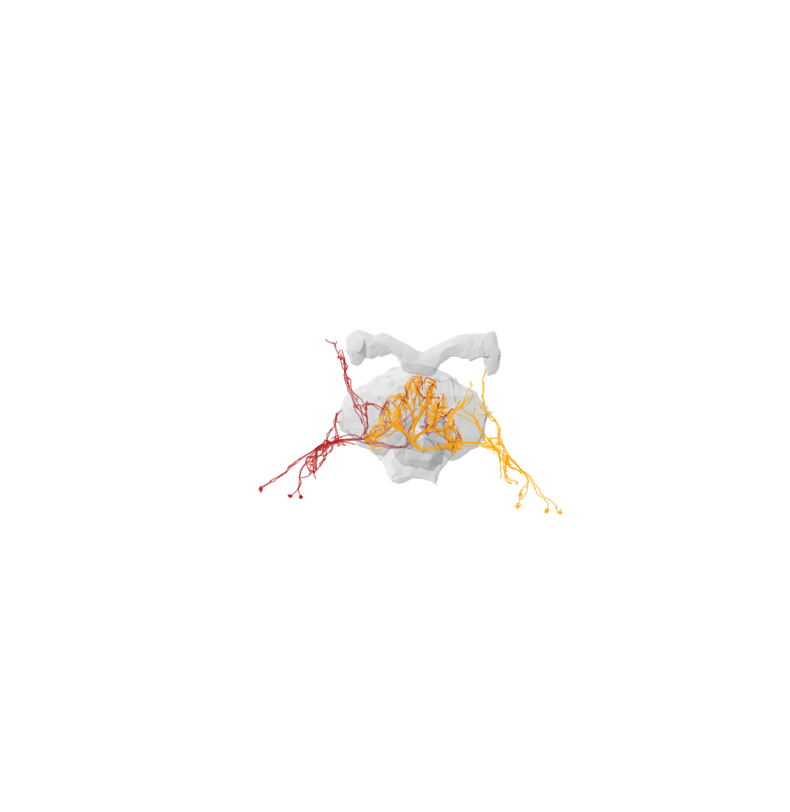

Layer 3 | FB6E | 0.12769605166425724


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

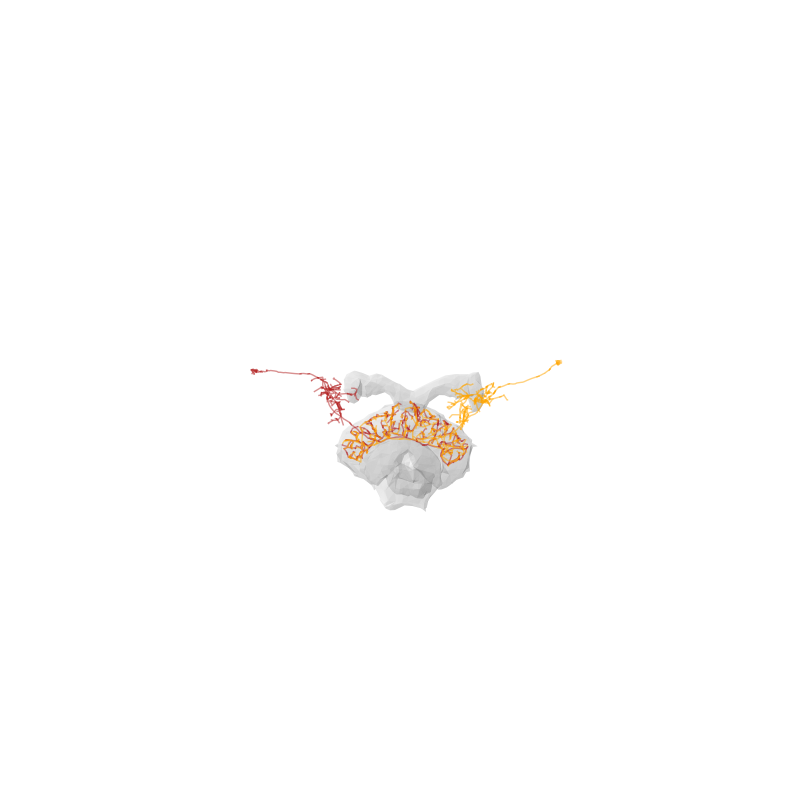

Layer 3 | FB4L | 0.12503559521447039


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

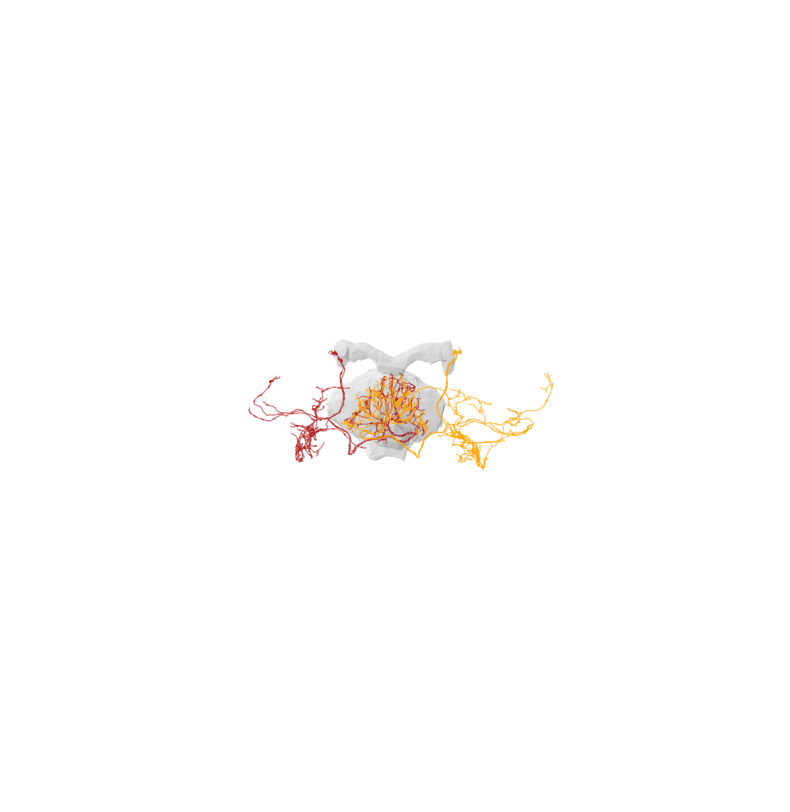

Layer 3 | FB4X | 0.12714050376318137


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

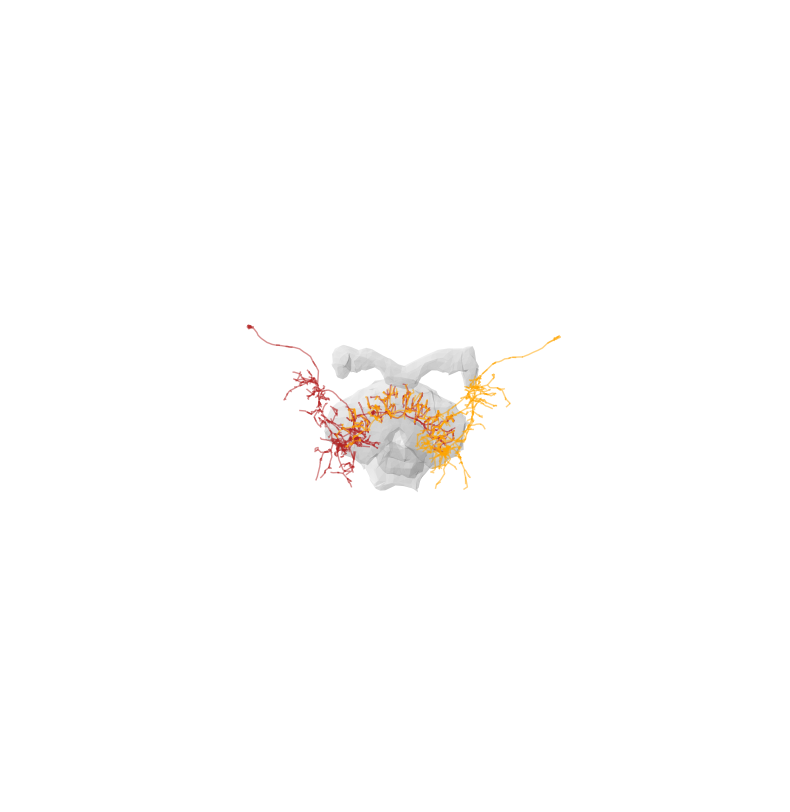

Layer 3 | FB6H | 0.12642948219273237


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

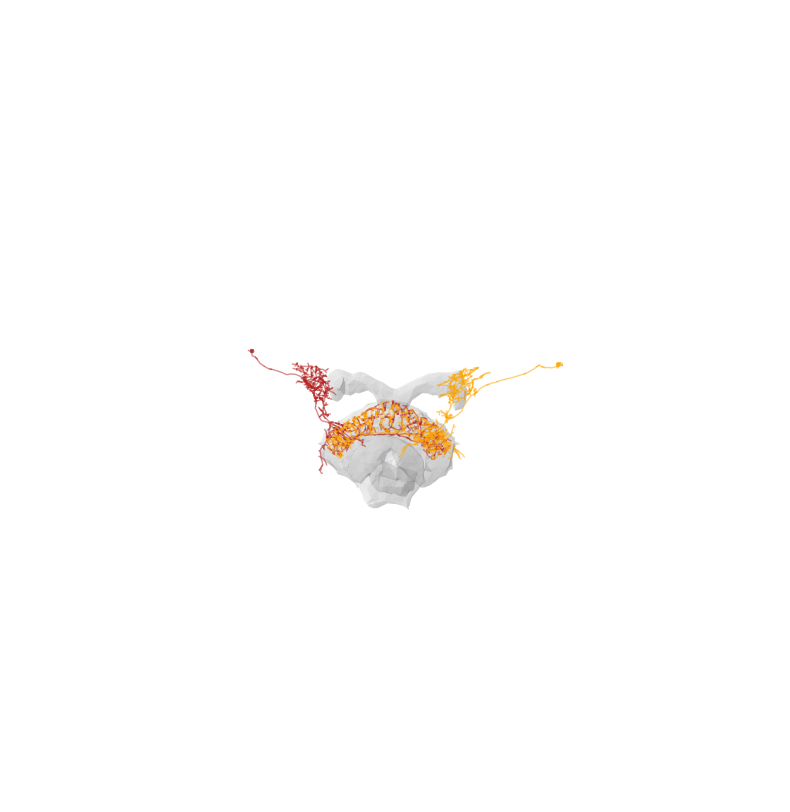

Layer 3 | FB7G | 0.12459818481315557


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

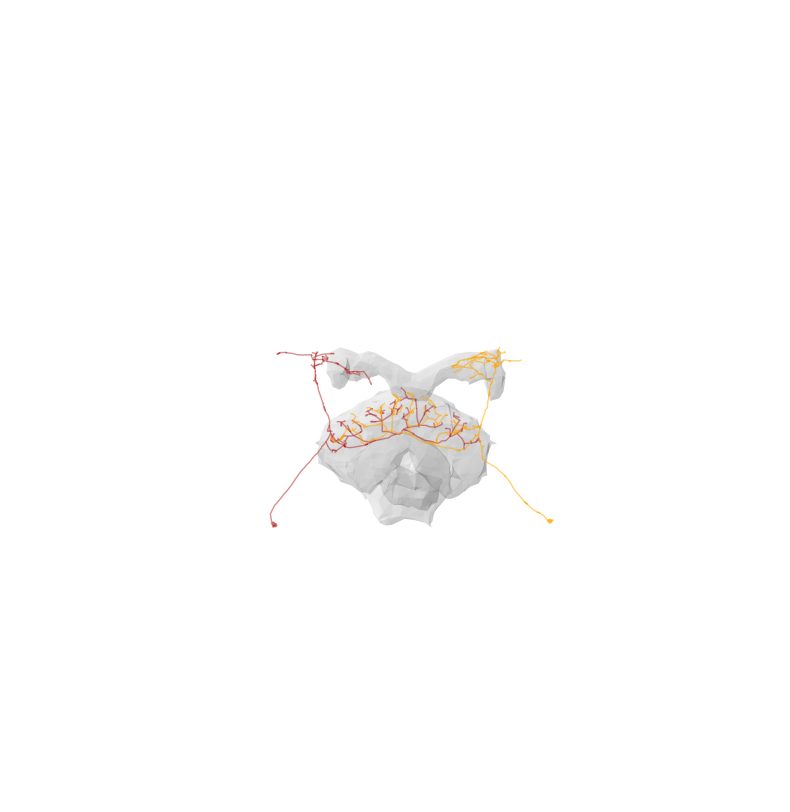

Layer 3 | FB8G | 0.12437630759011796


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

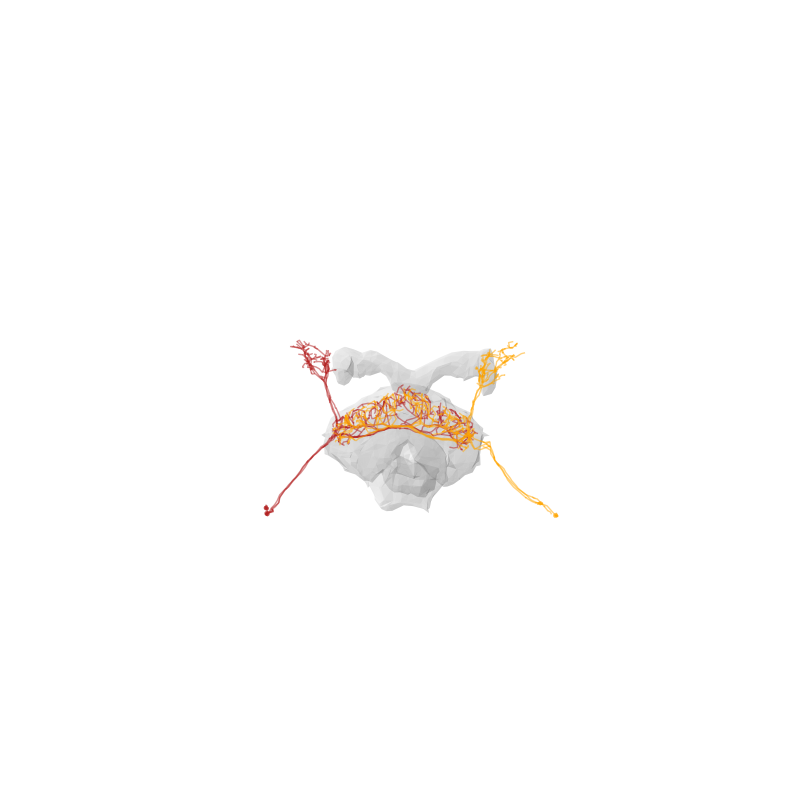

Layer 3 | CB.FB2E0 | 0.12355347964599168


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

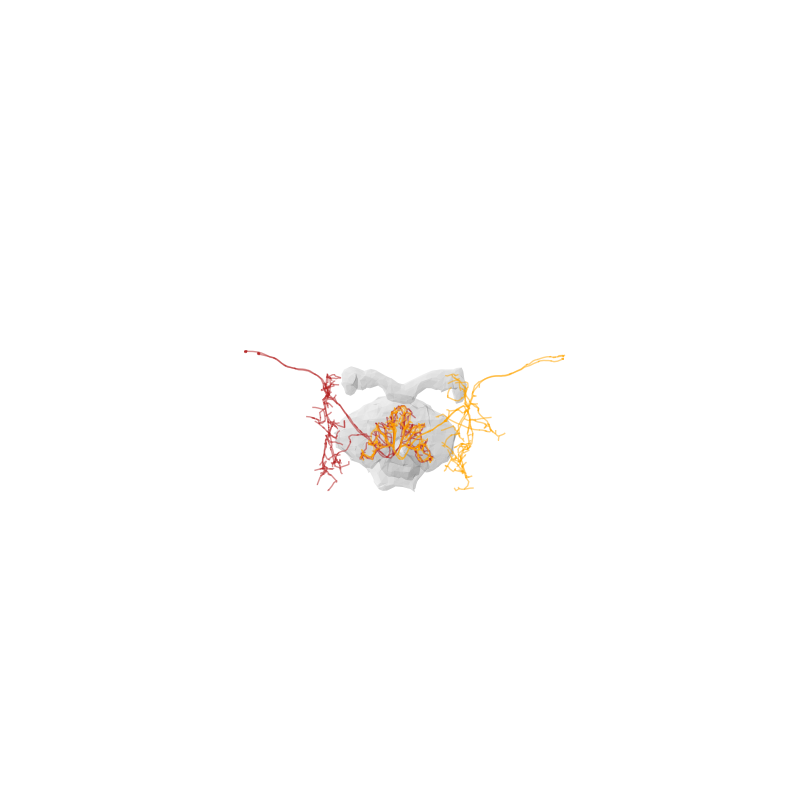

Layer 3 | CB.FB5I4 | 0.12362712175139322


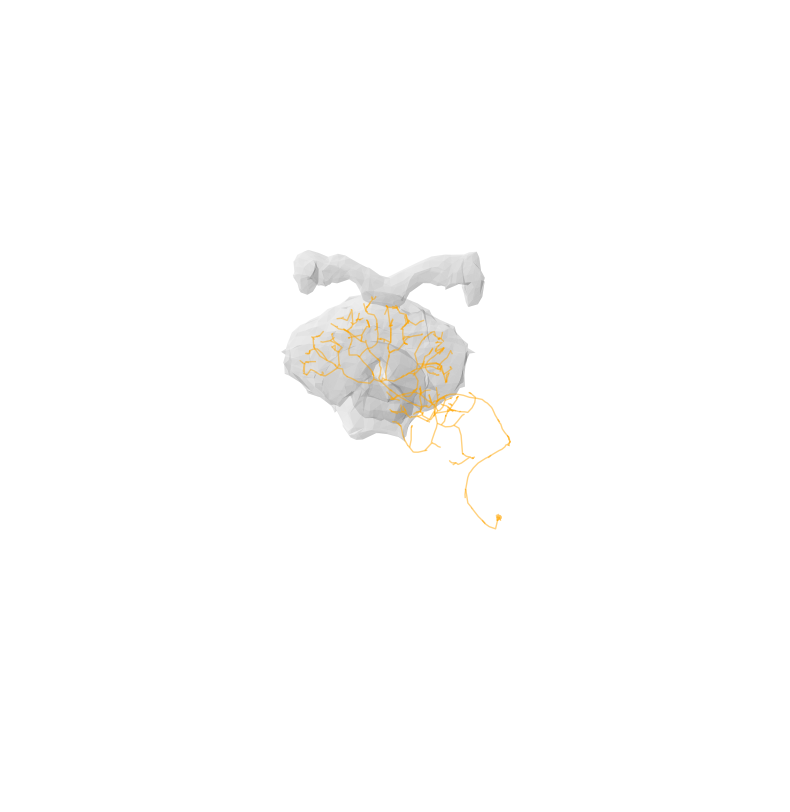

Layer 3 | FB7E | 0.12053978373174194


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

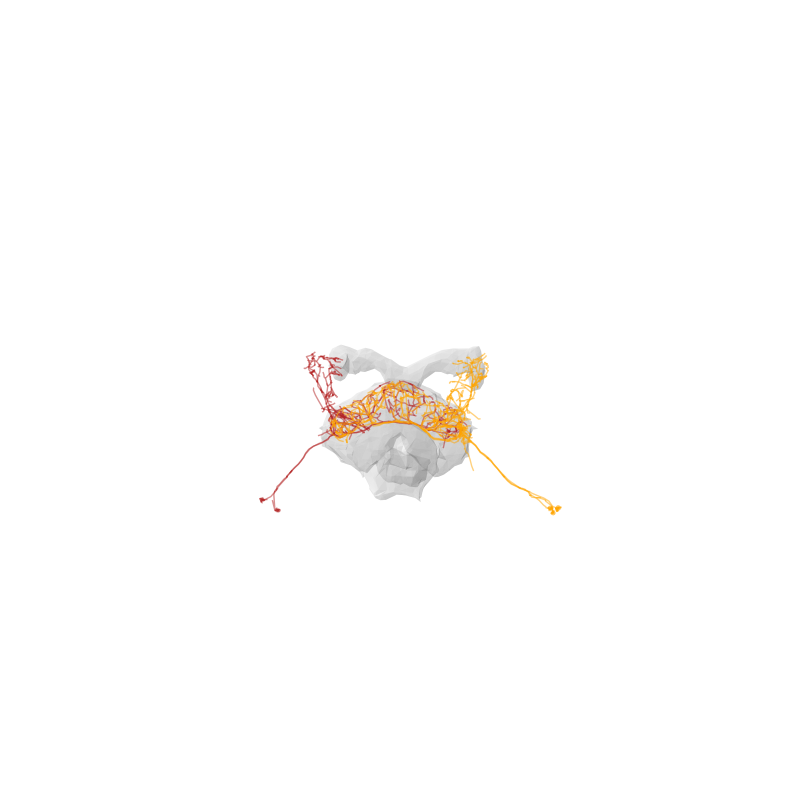

Layer 3 | CB.FB5I1 | 0.12080373732535336


Fetching L2 skeletons:   0%|          | 0/3 [00:00<?, ?it/s]

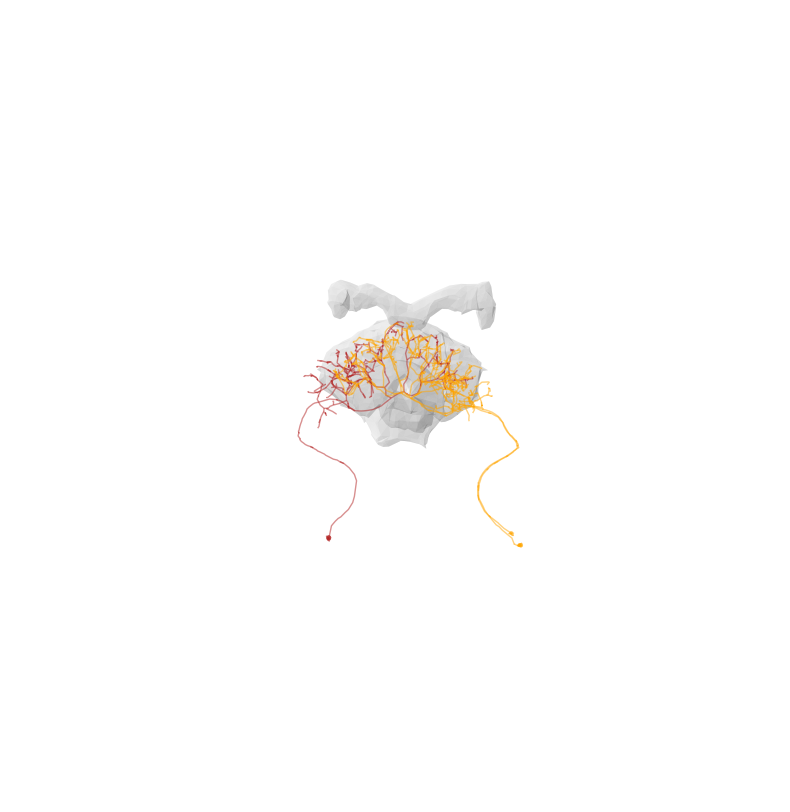

Layer 3 | FB5C/F/G/P/Q | 0.11641312223663791


Fetching L2 skeletons:   0%|          | 0/24 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/24 [00:00<?, ?it/s]

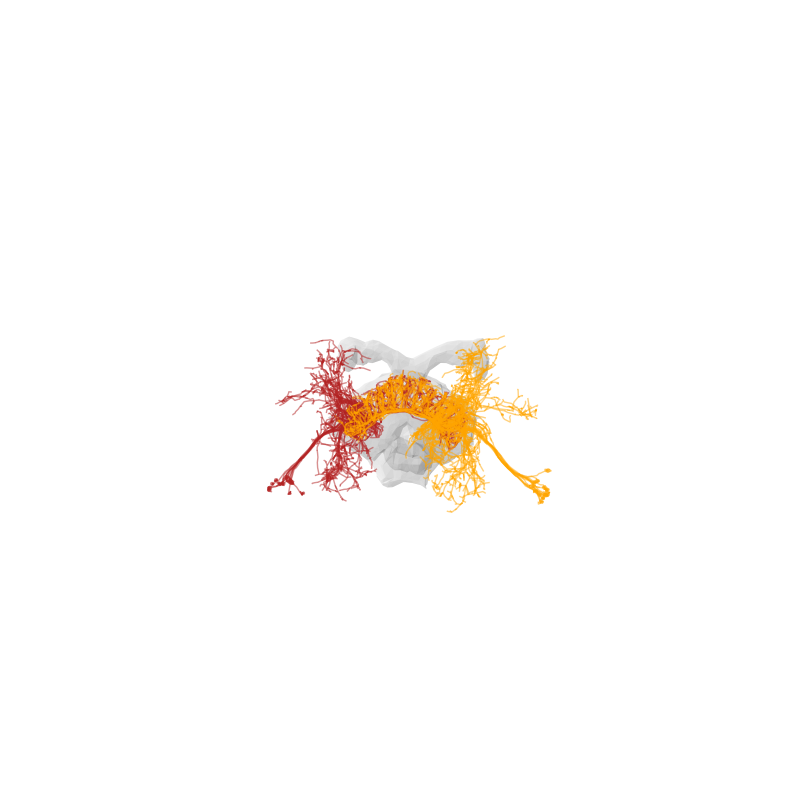

Layer 3 | FB7L | 0.11597186904409358


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

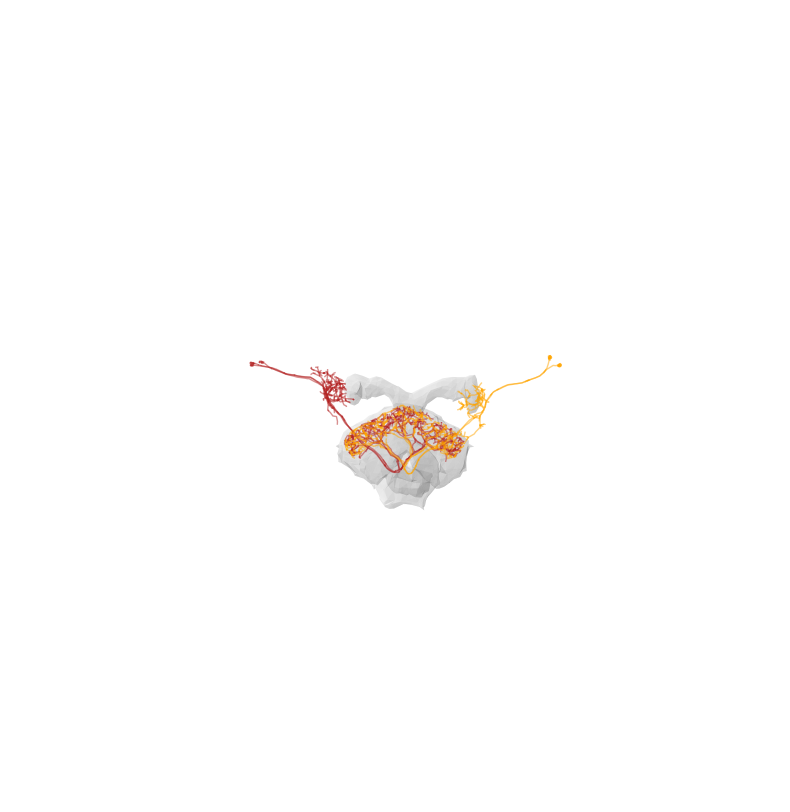

Layer 3 | CB.FB3/4L0 | 0.11433072148175921


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

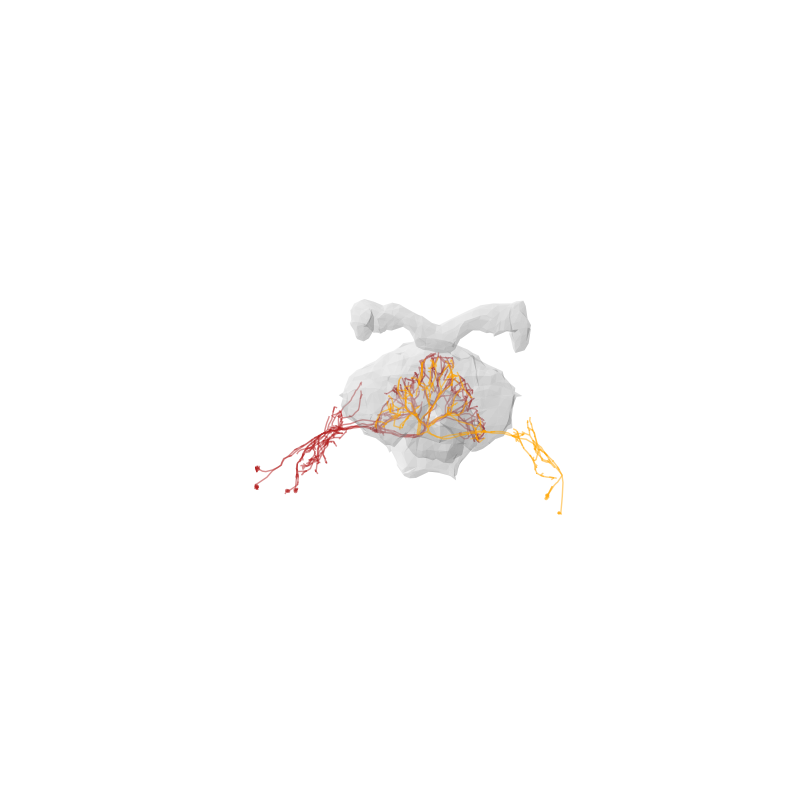

Layer 3 | CB.FB6E5 | 0.110902494068057


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

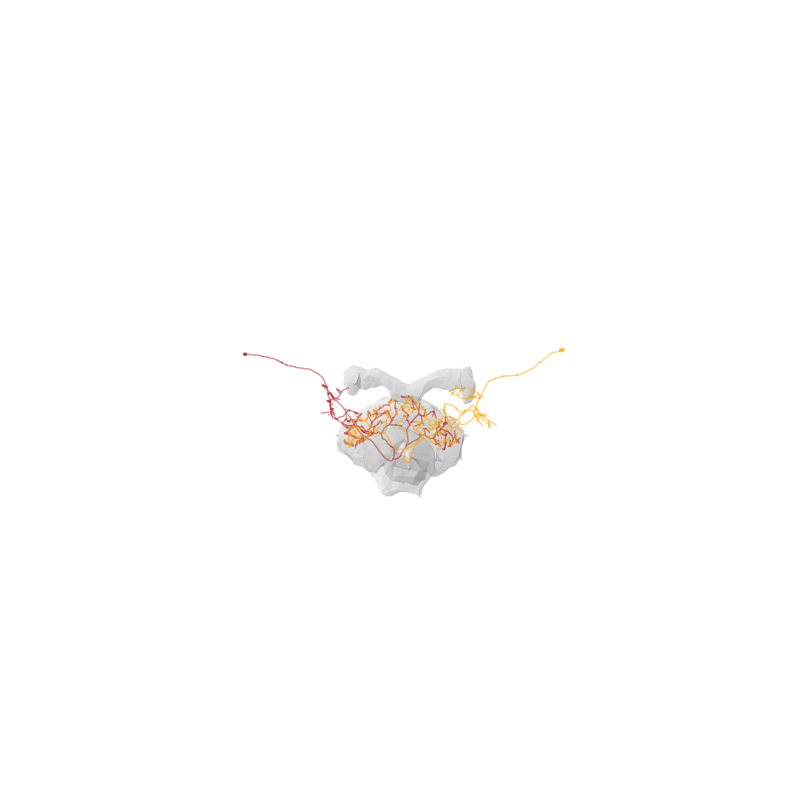

Layer 3 | CB.FB2E3 | 0.10654934779471337


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

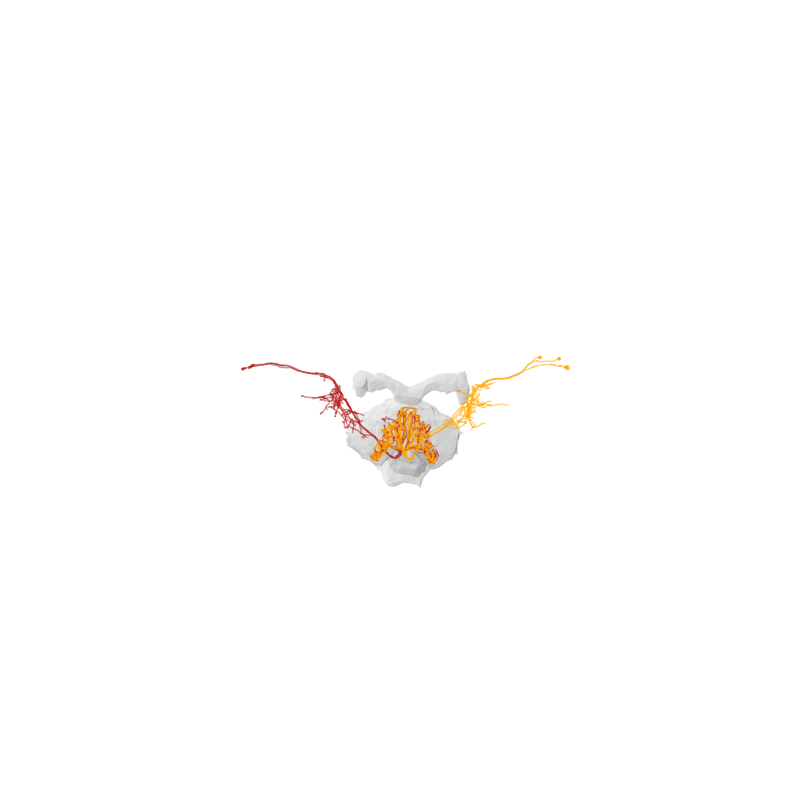

Layer 3 | CB.FB2E7 | 0.10978626730123033


Fetching L2 skeletons:   0%|          | 0/3 [00:00<?, ?it/s]

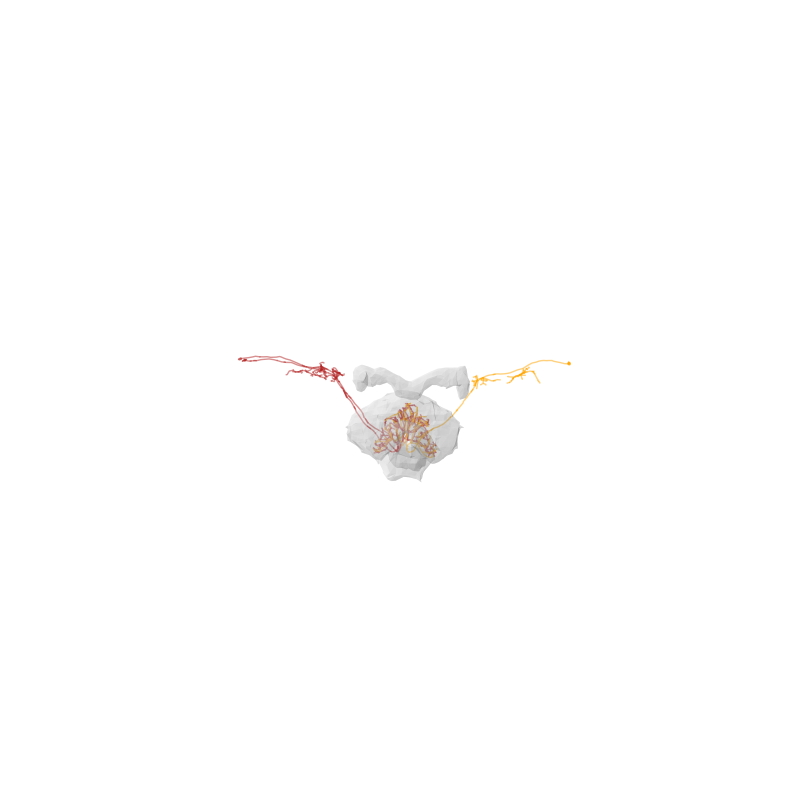

Layer 3 | FB2A | 0.10960561378500804


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

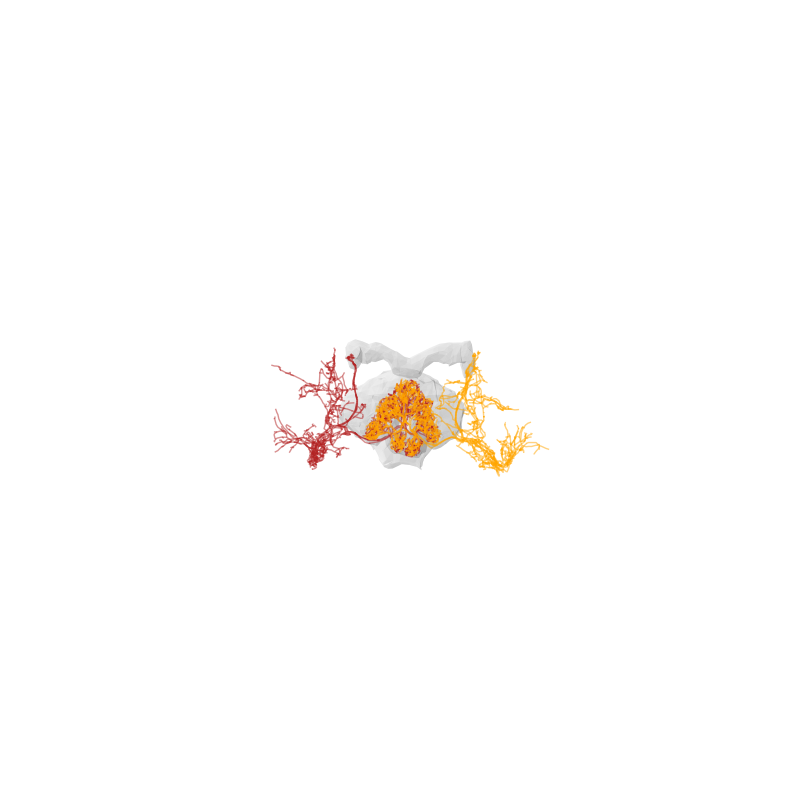

Layer 3 | FB5X | 0.1075461622295346


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

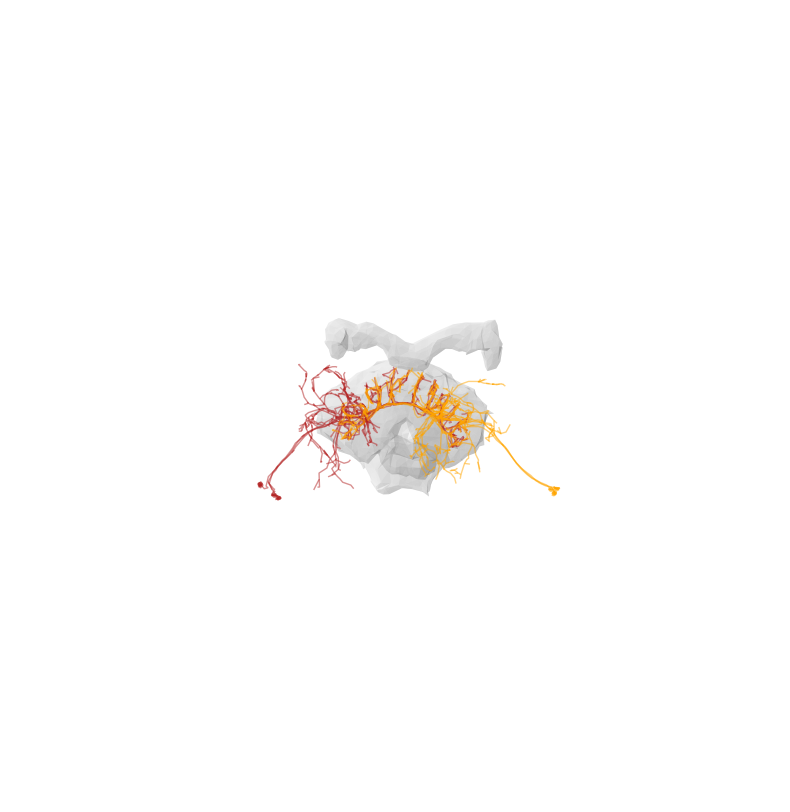

Layer 3 | FB4A/D/E/F/G/H/I/J | 0.10214083697741666


Fetching L2 skeletons:   0%|          | 0/36 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/36 [00:00<?, ?it/s]

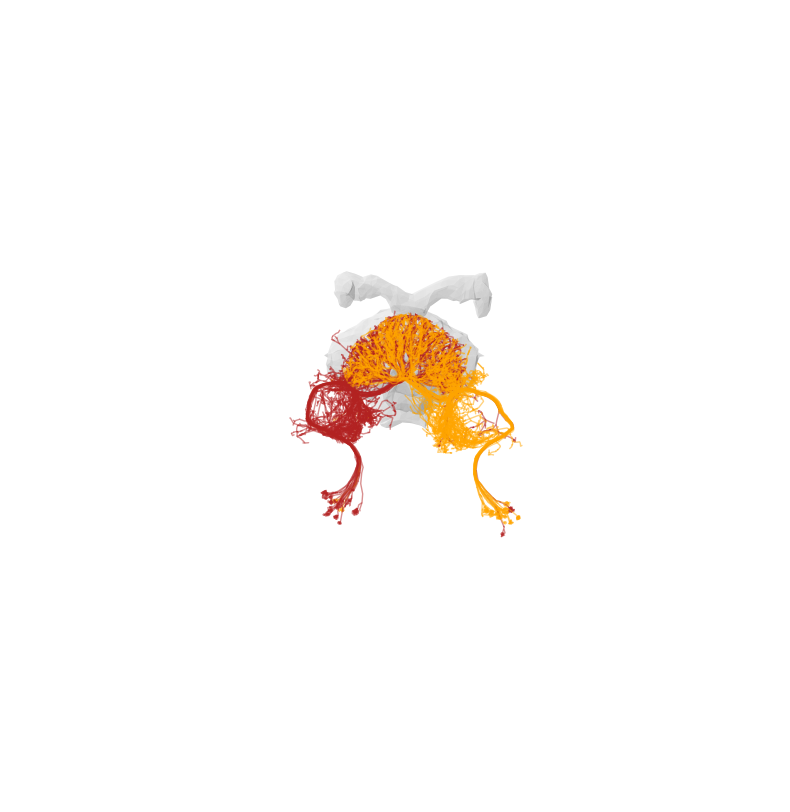

Layer 3 | FB5I | 0.10925124672697327


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

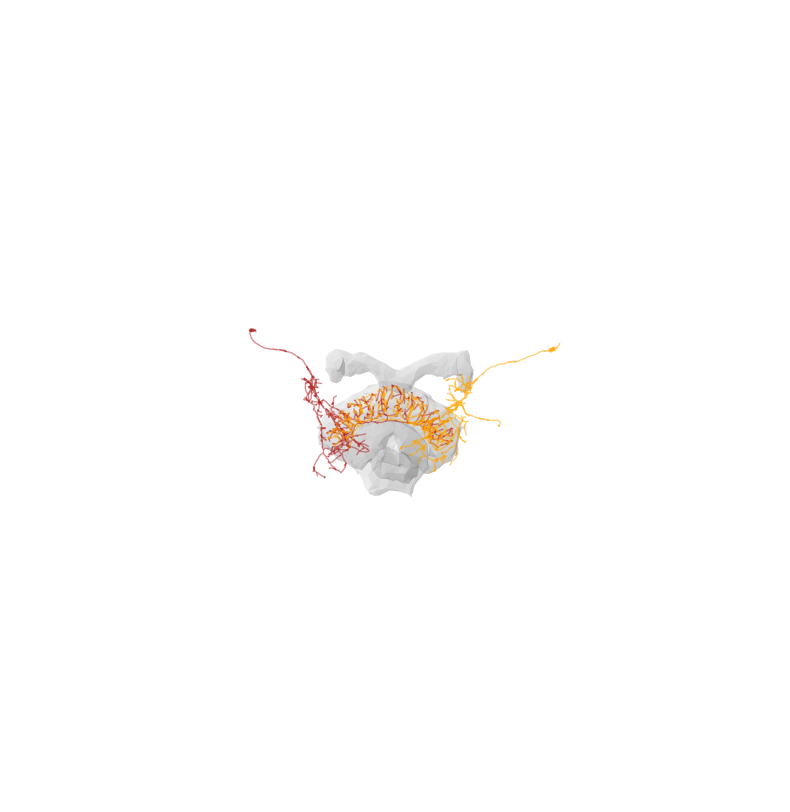

Layer 3 | FB1C | 0.10856707658820627


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

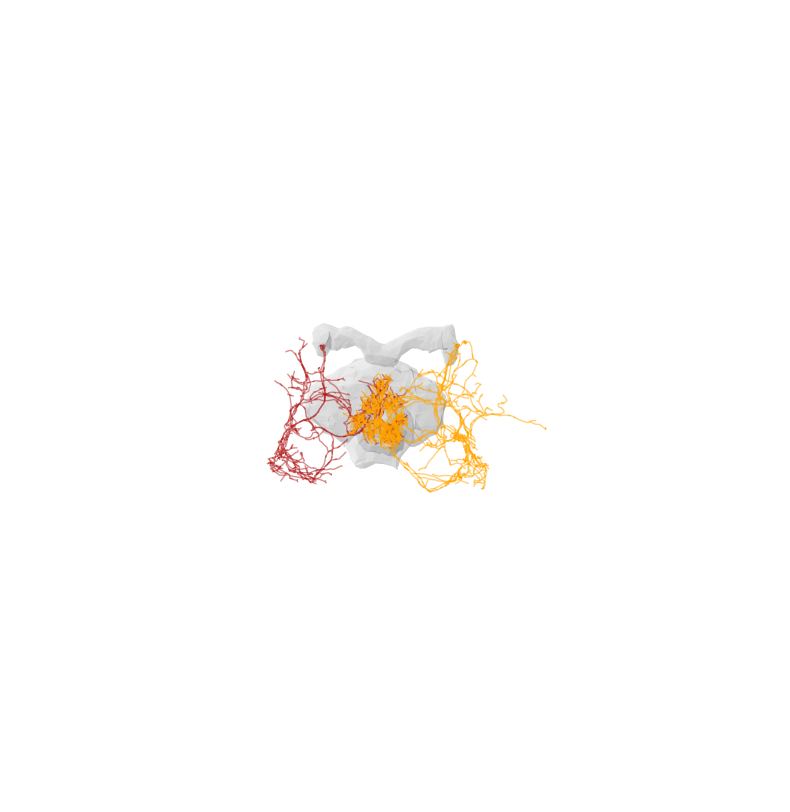

Layer 3 | FB8C | 0.10778576330488973


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

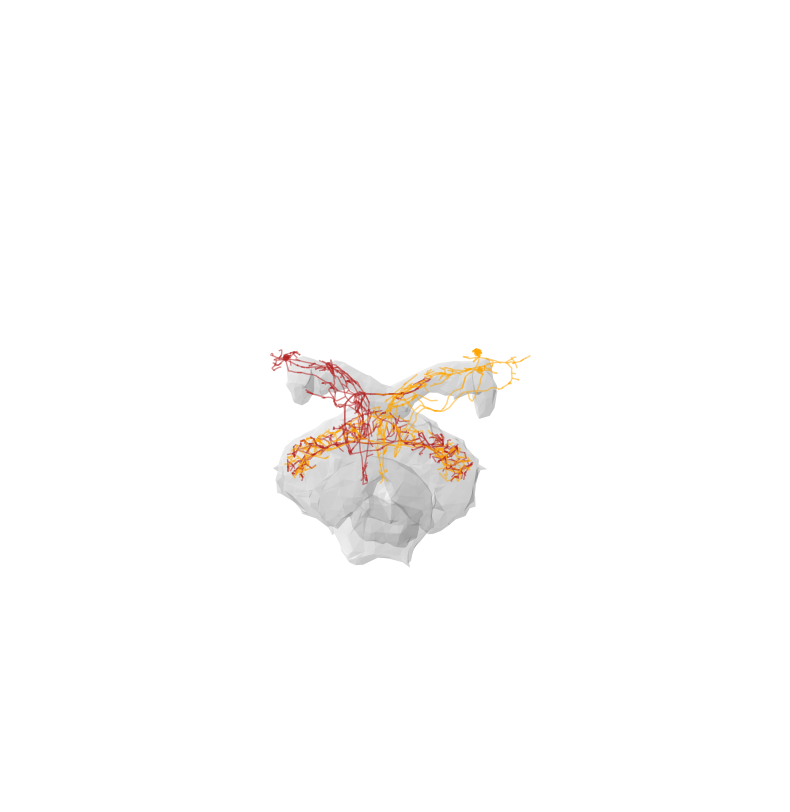

Layer 3 | CB.FB6D2 | 0.10720492951851825


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

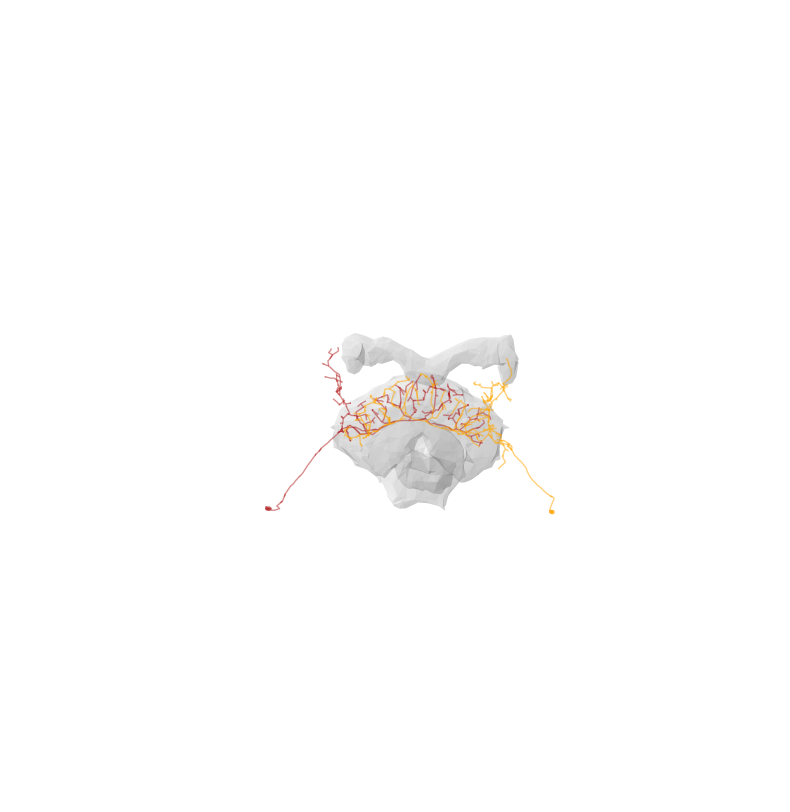

Layer 3 | CB.FB2I2 | 0.10085799245298517


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

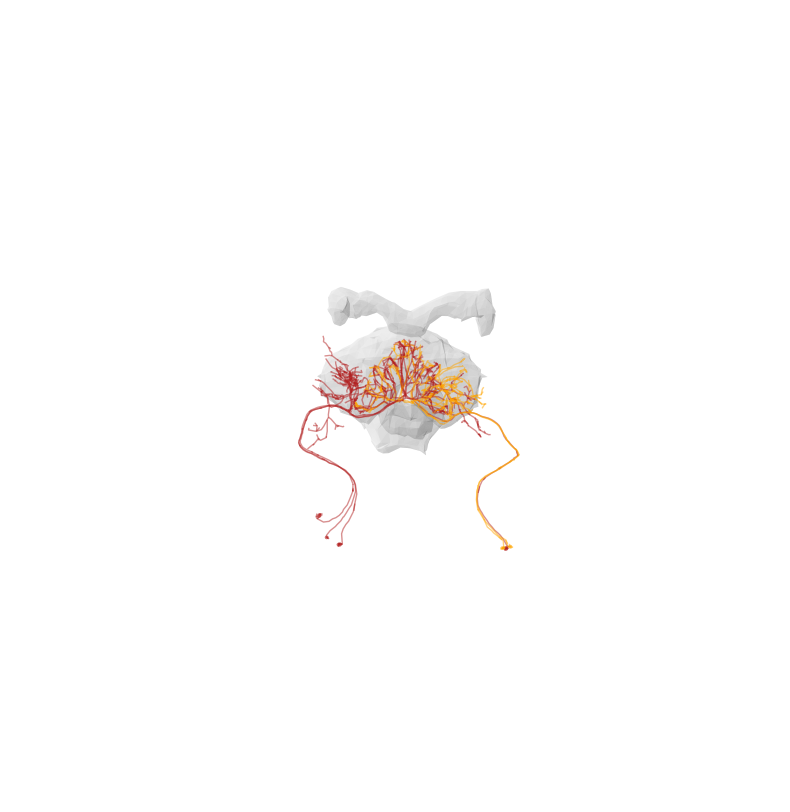

Layer 3 | CB.FB5I3 | 0.10435832424558125


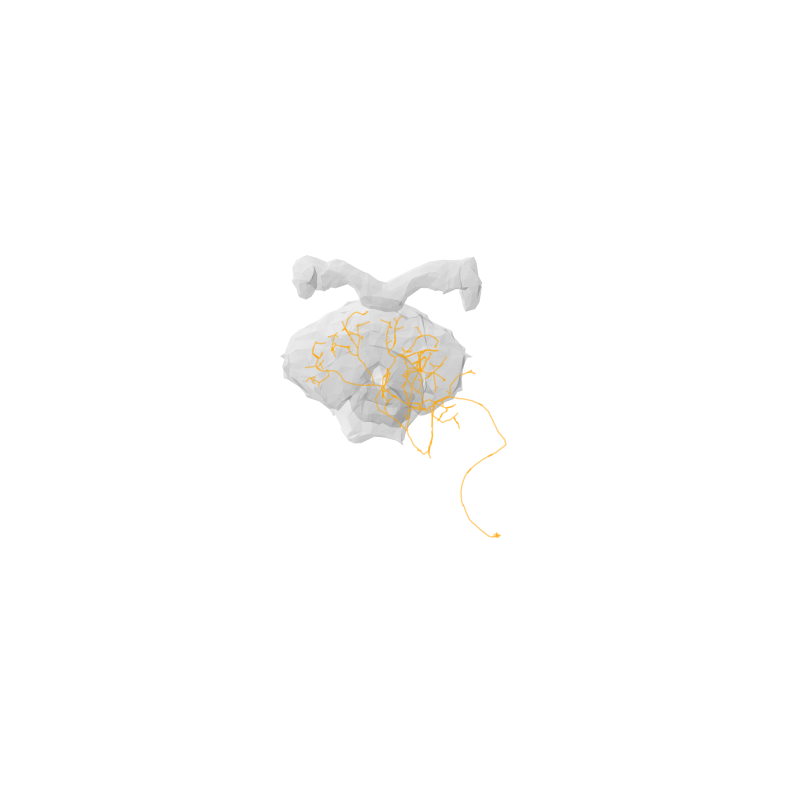

Layer 3 | FB5Z | 0.1037749347957918


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

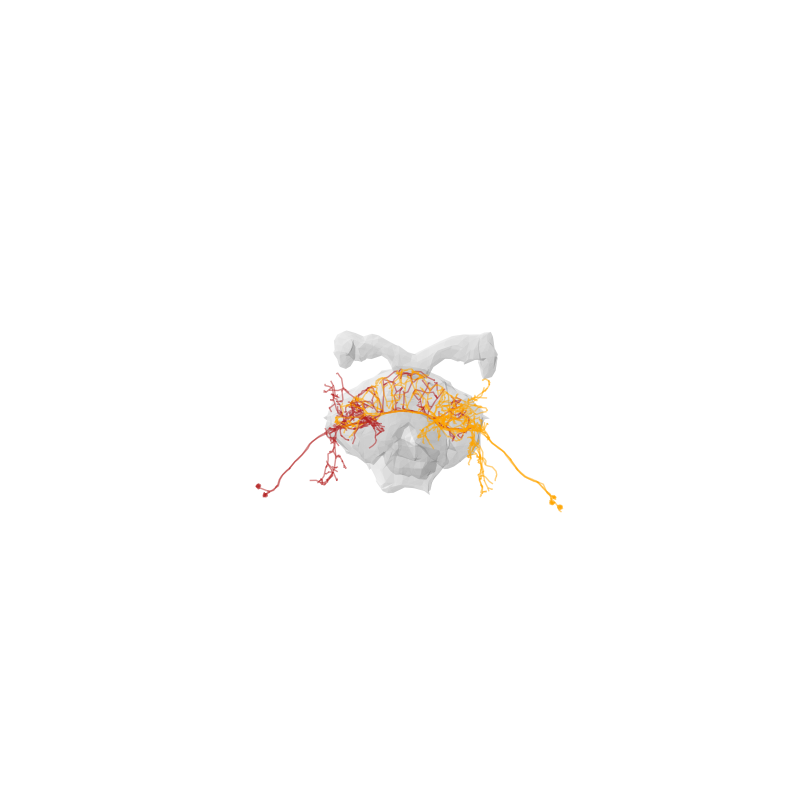

Layer 3 | FB4P_a | 0.10072840047220297


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

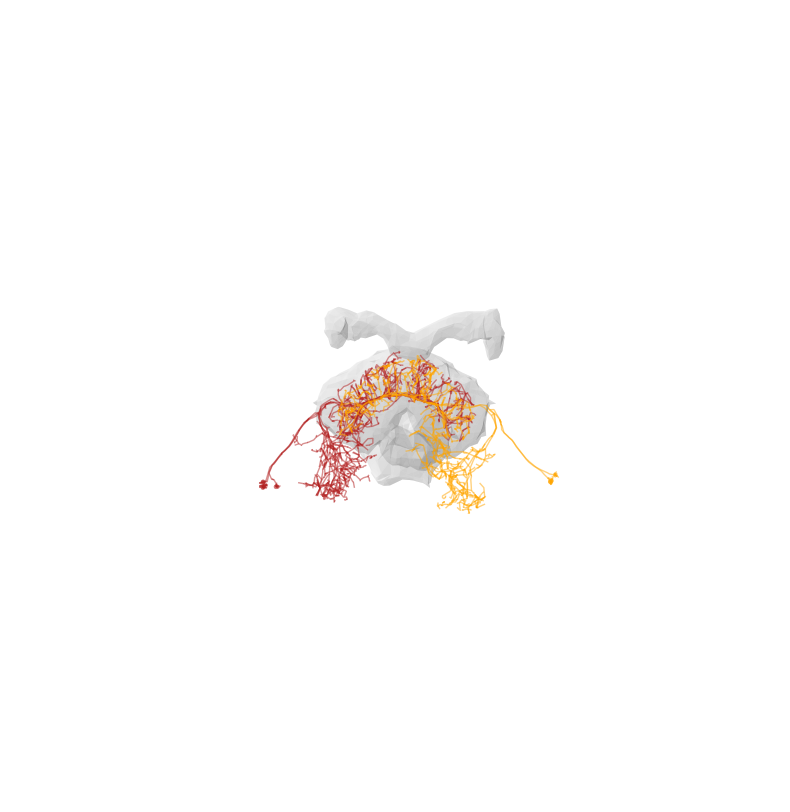

Layer 3 | ExR3 | 0.10229219734893936


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

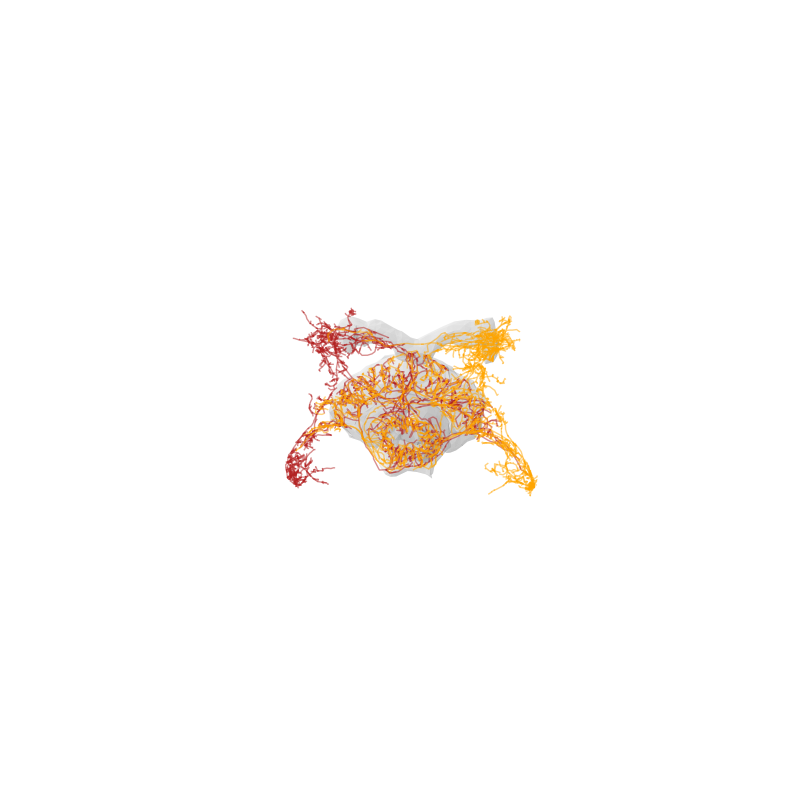

Layer 3 | FB5D/E | 0.10105976708986344


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

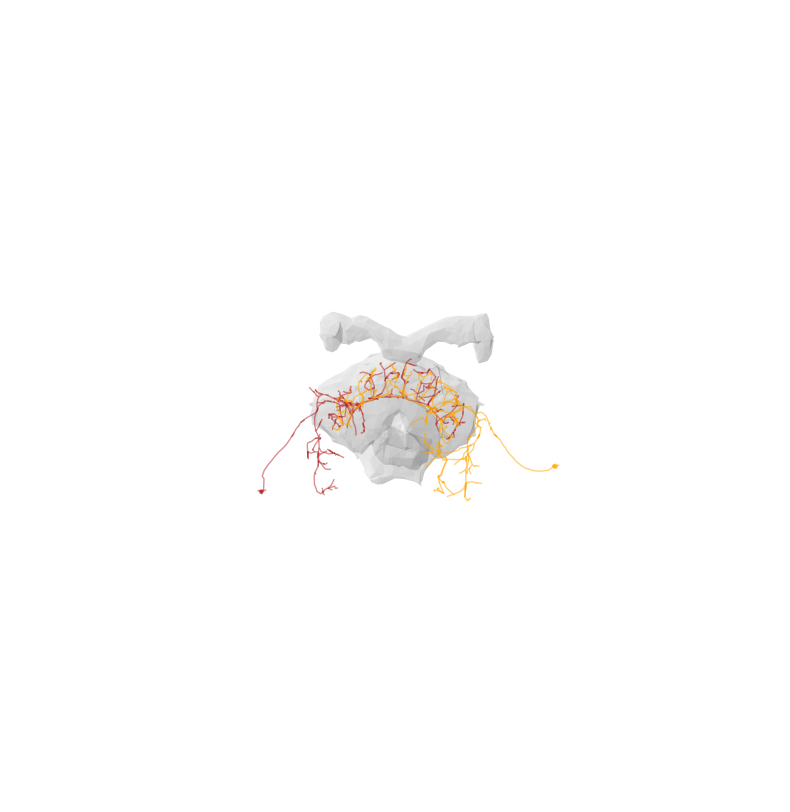

Layer 3 | CB.FB2I3 | 0.09955782034823164


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

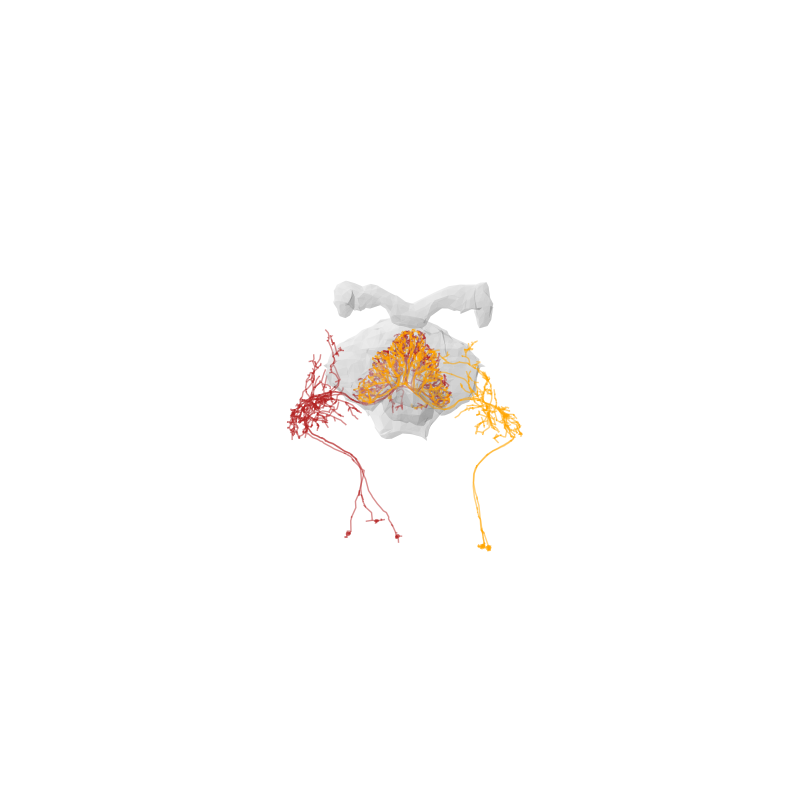

Layer 3 | CB.FBTI0 | 0.08634750196736087


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

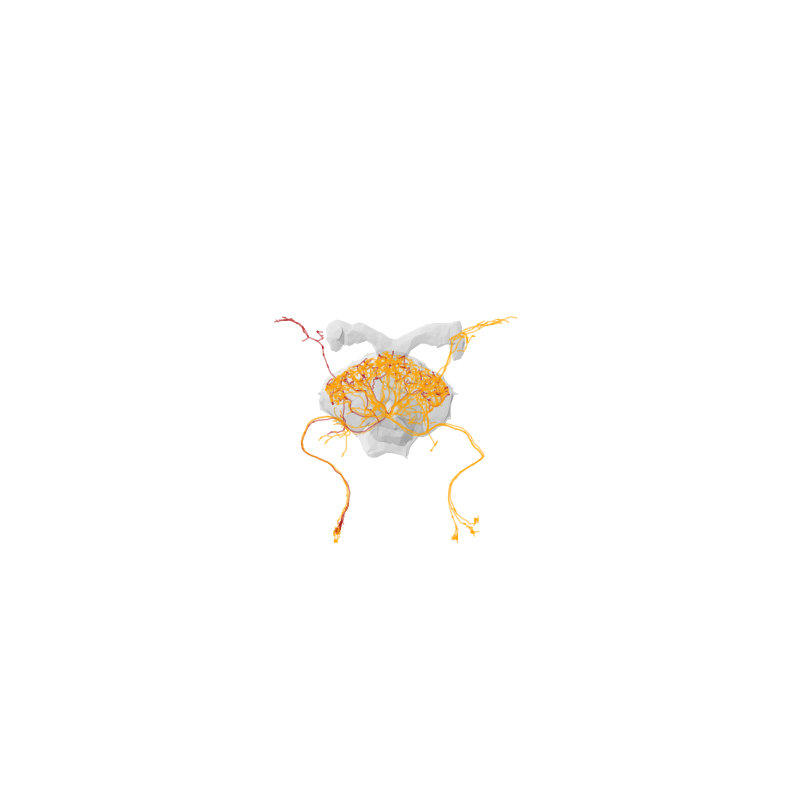

Layer 3 | FB4C | 0.09919303421906148


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

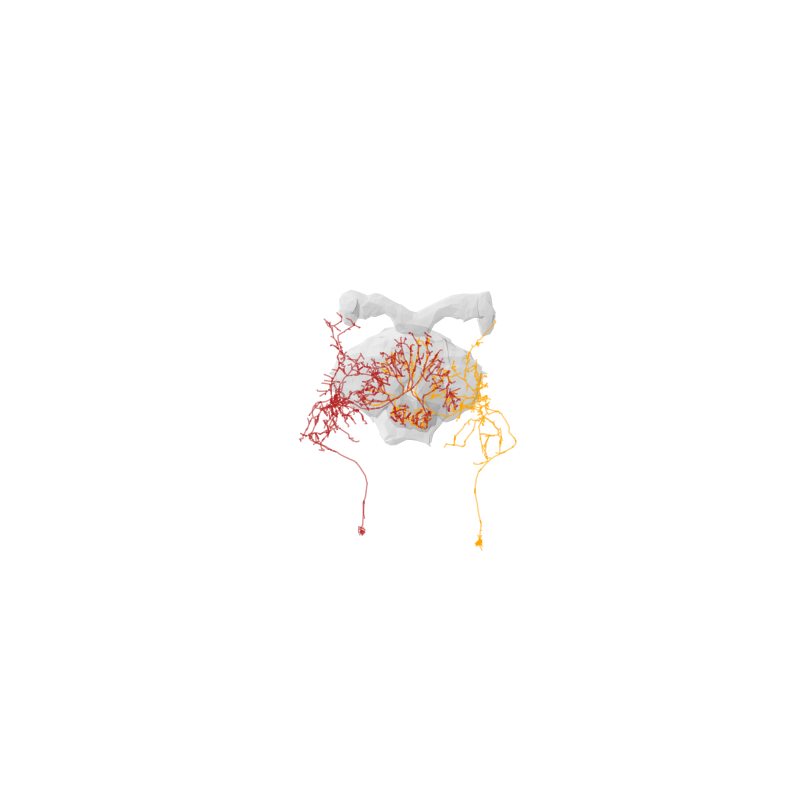

Layer 3 | ER3a | 0.07294699900092473


Fetching L2 skeletons:   0%|          | 0/37 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/37 [00:00<?, ?it/s]

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x105bba290>>
Traceback (most recent call last):
  File "/Users/neurorishika/Projects/Rockefeller/Ruta/fly-connectomics/.venv/lib/python3.10/site-packages/ipykernel/ipkernel.py", line 775, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(
KeyboardInterrupt: 


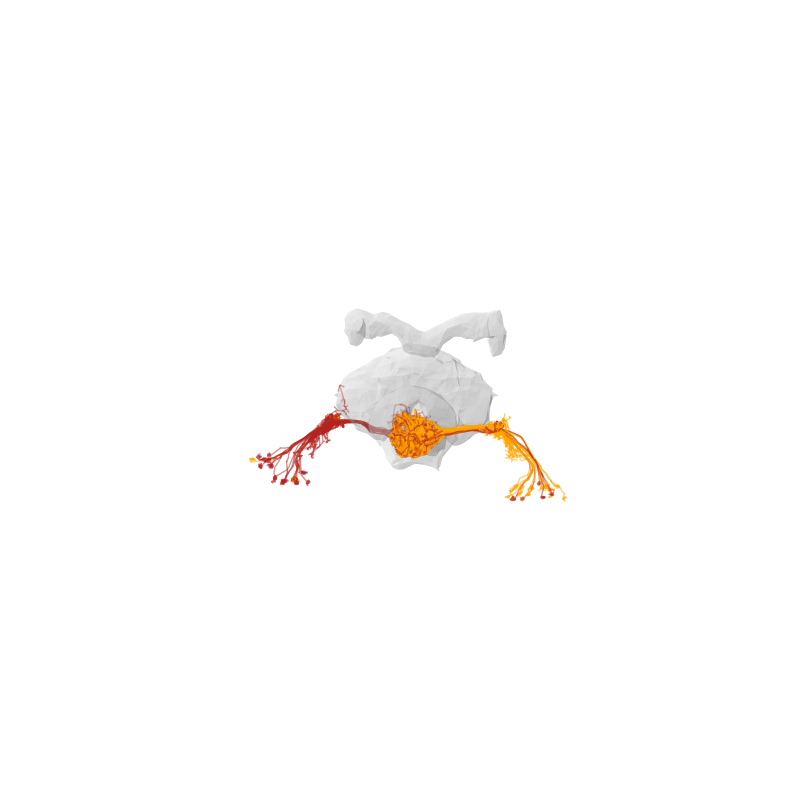

Layer 3 | CB.FB6D0 | 0.09825164954635827


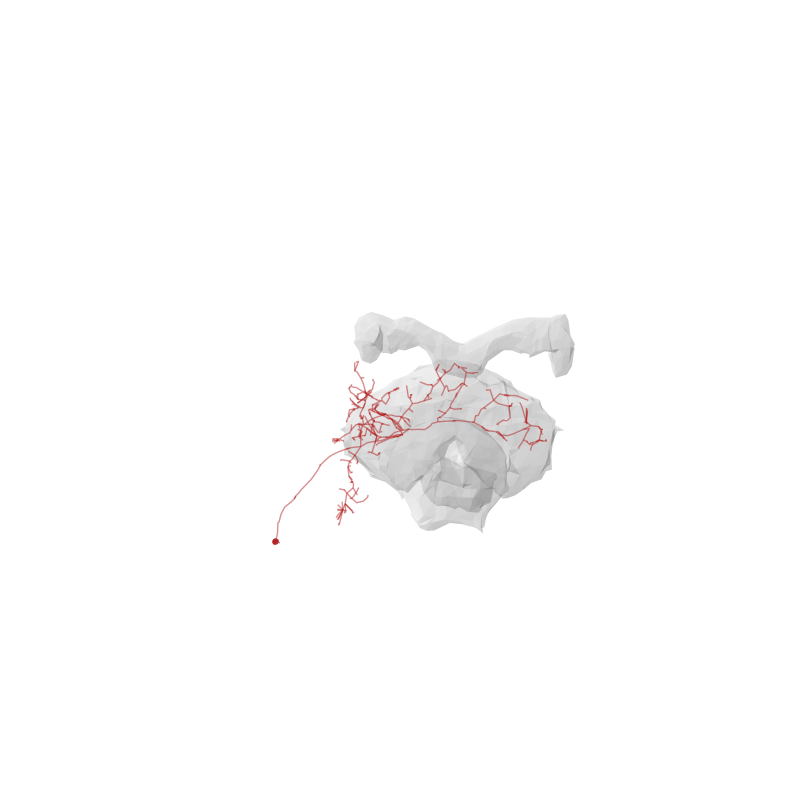

Layer 3 | FB4Q_b | 0.09746314670394919


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

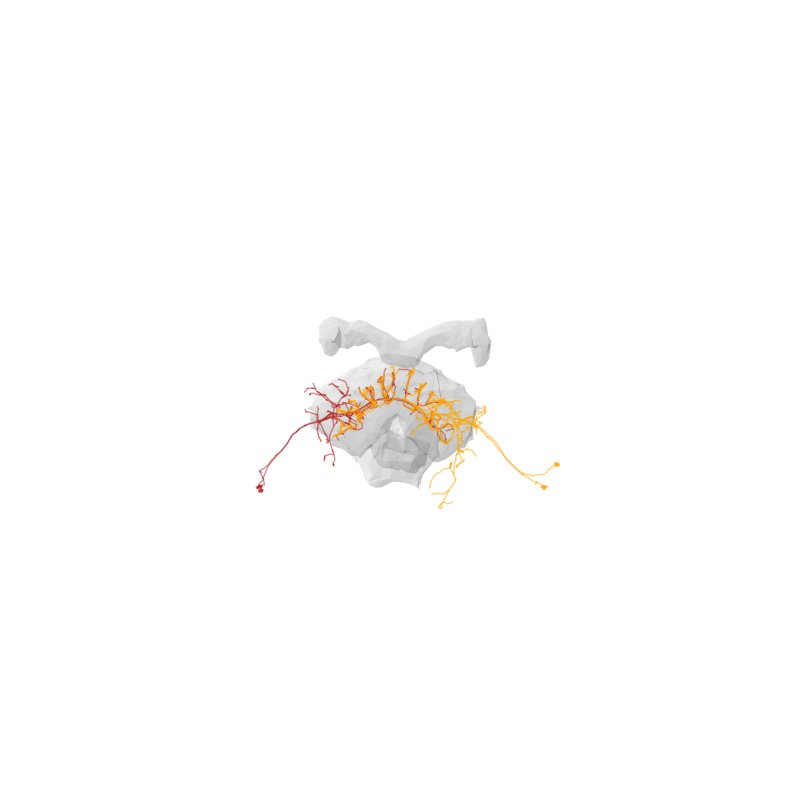

Layer 3 | ER1 | 0.08781622773569583


Fetching L2 skeletons:   0%|          | 0/29 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/29 [00:00<?, ?it/s]

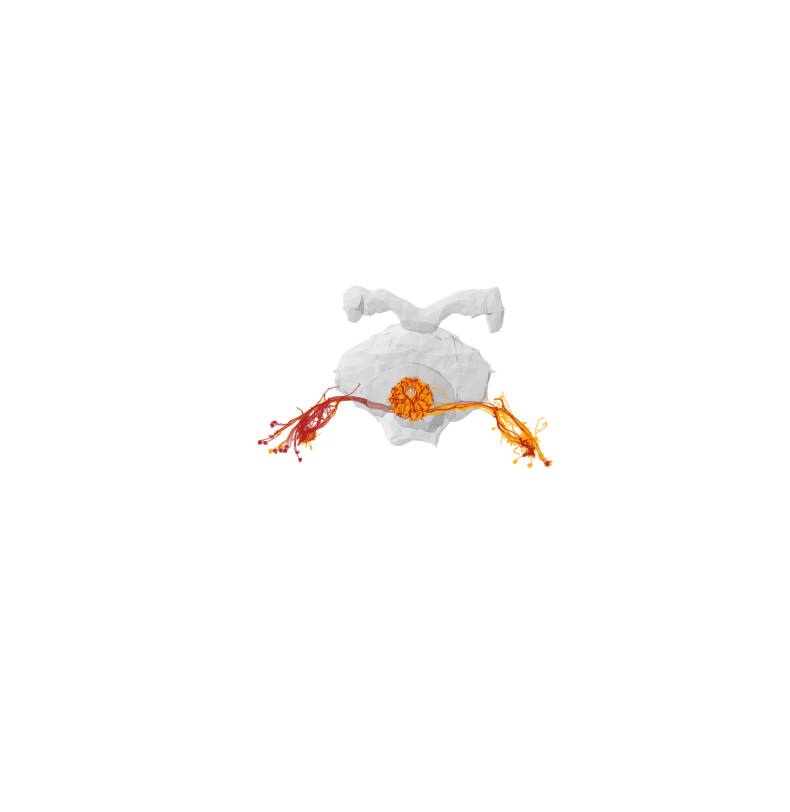

Layer 3 | FB5V | 0.09123332325183957


Fetching L2 skeletons:   0%|          | 0/18 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/18 [00:00<?, ?it/s]

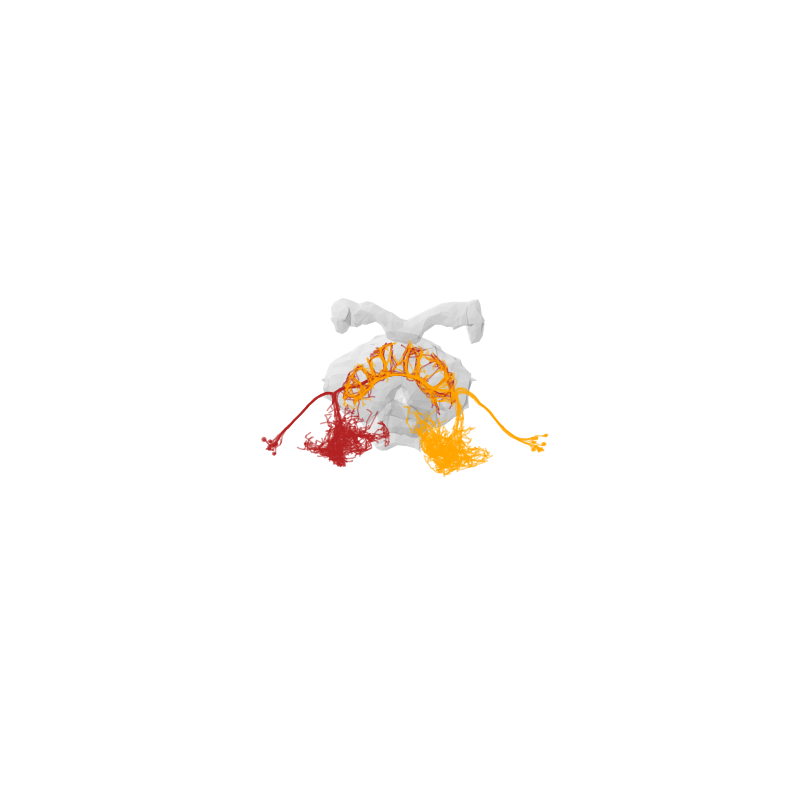

Layer 3 | FB6M | 0.09344996233536515


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

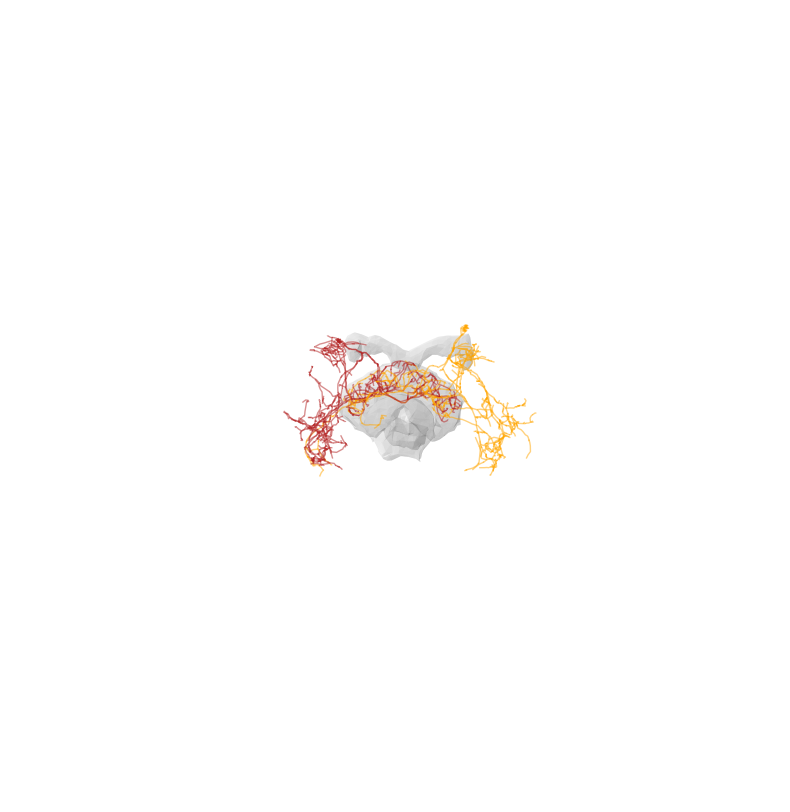

Layer 3 | FB4N | 0.09326233997904662


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

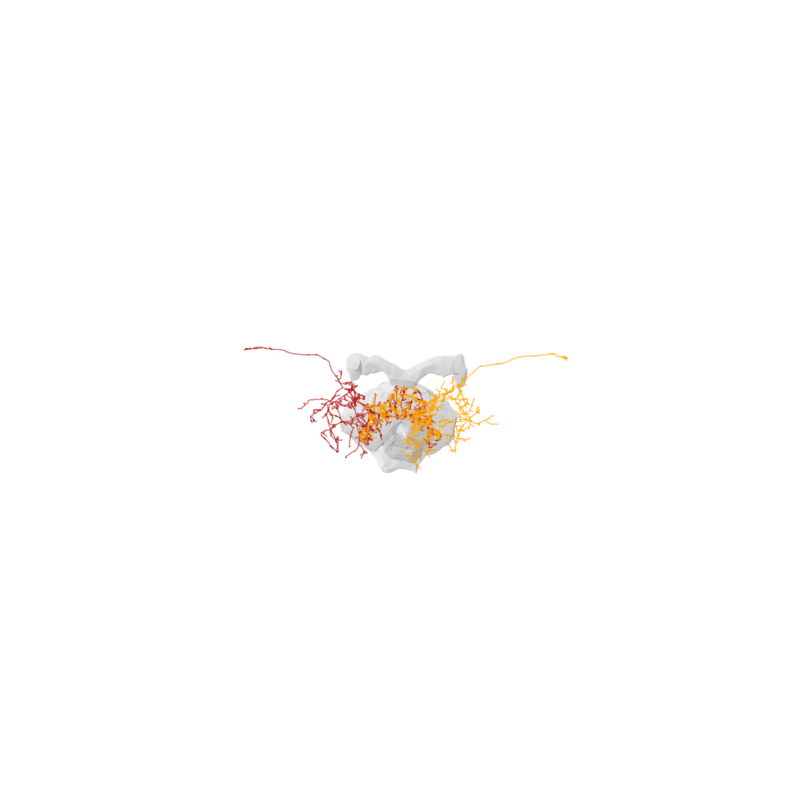

Layer 3 | FB4B | 0.09000143236881544


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

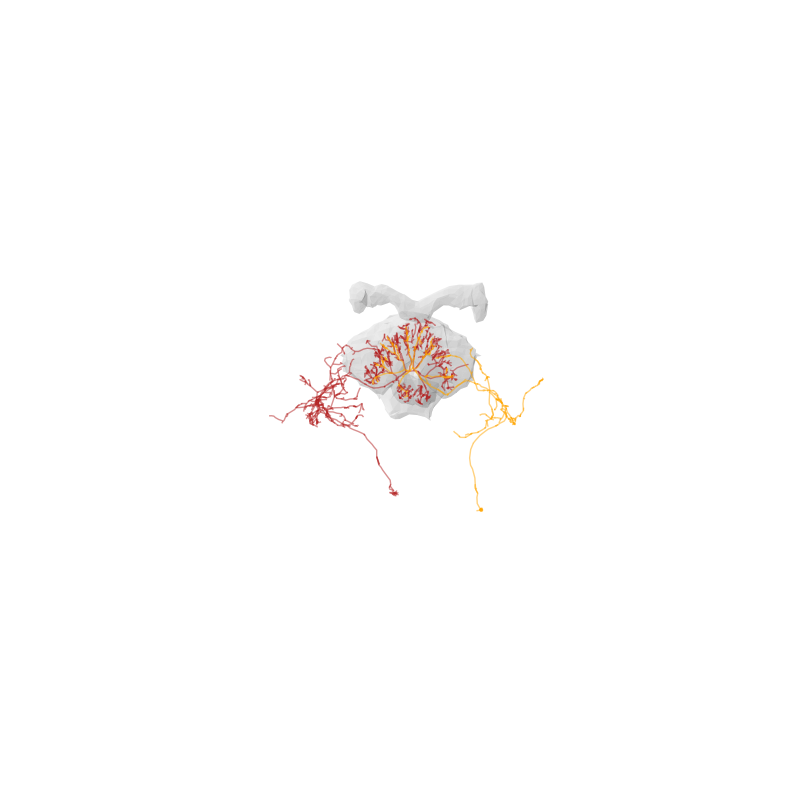

Layer 3 | CB.FB2E9 | 0.07764019547160265


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

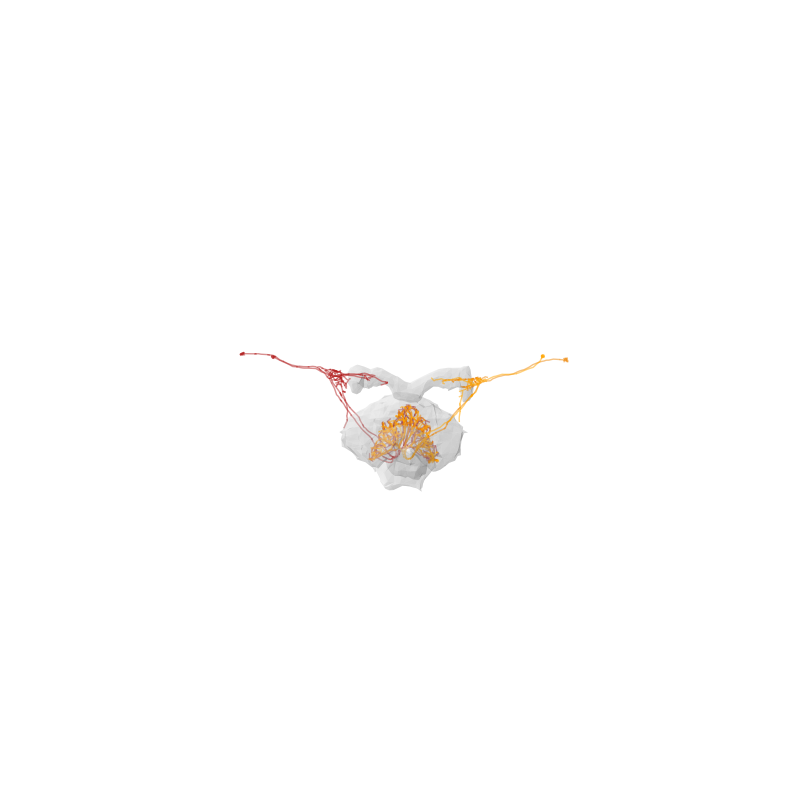

Layer 3 | CB.FB5I2 | 0.08441073312256551


Fetching L2 skeletons:   0%|          | 0/3 [00:00<?, ?it/s]

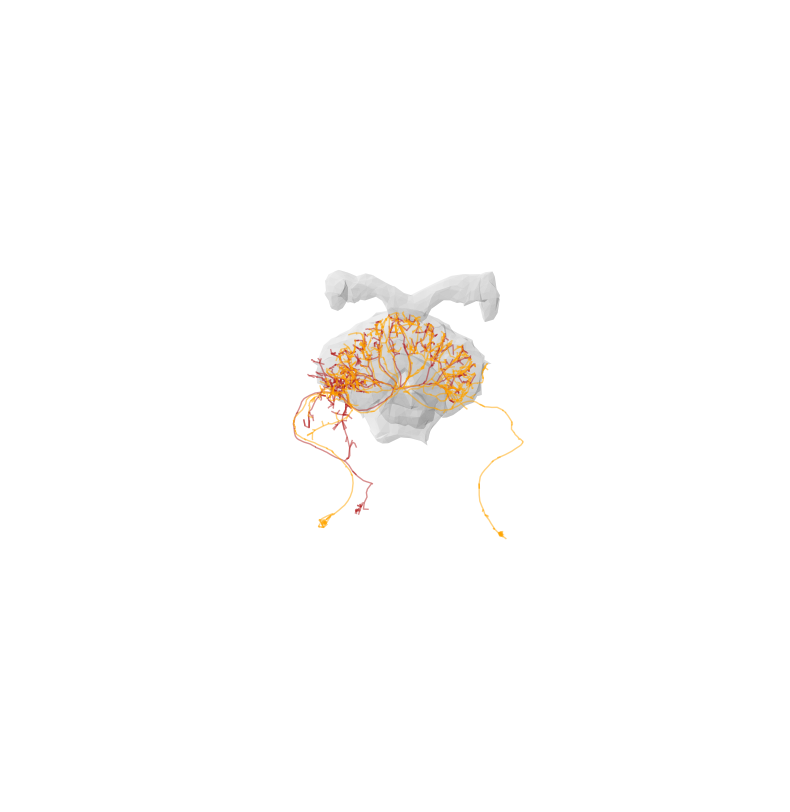

Layer 3 | FB6O | 0.08567861772227209


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

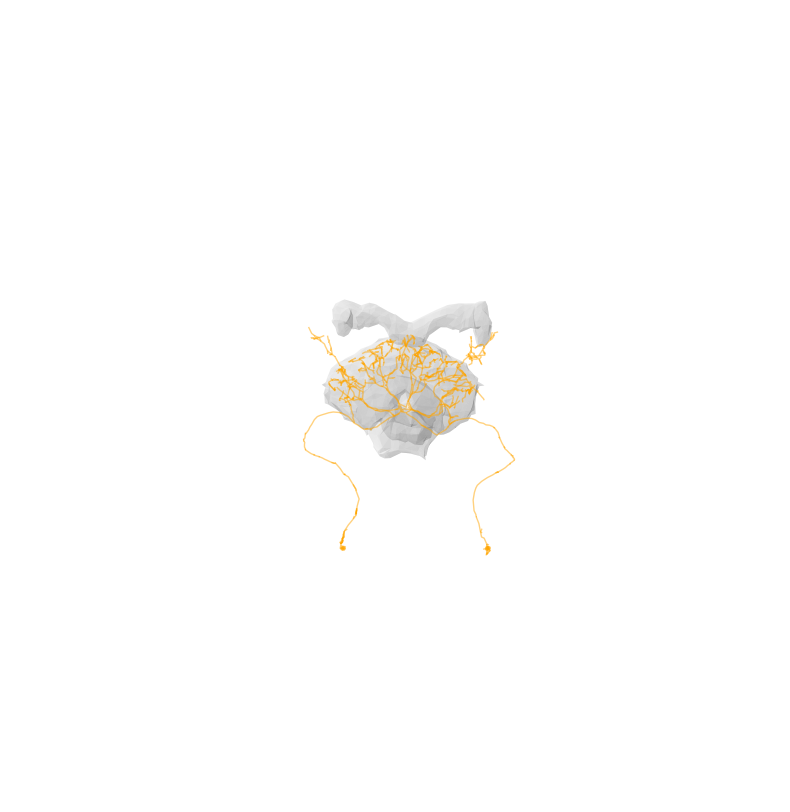

Layer 3 | CB.FB6I0 | 0.07891568643847442


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

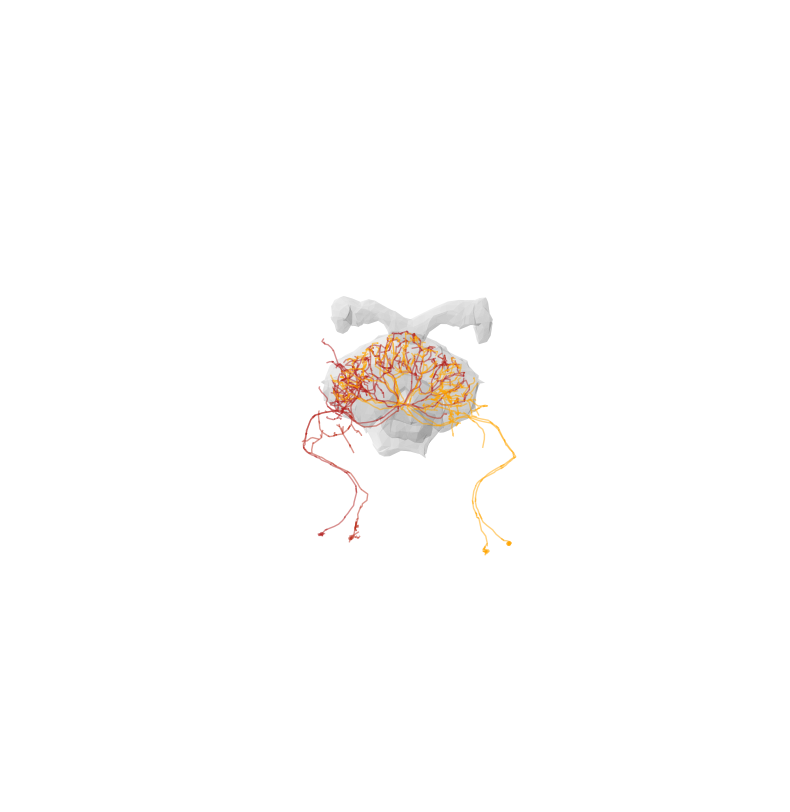

Layer 3 | LNO1 | 0.08638510872355415


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

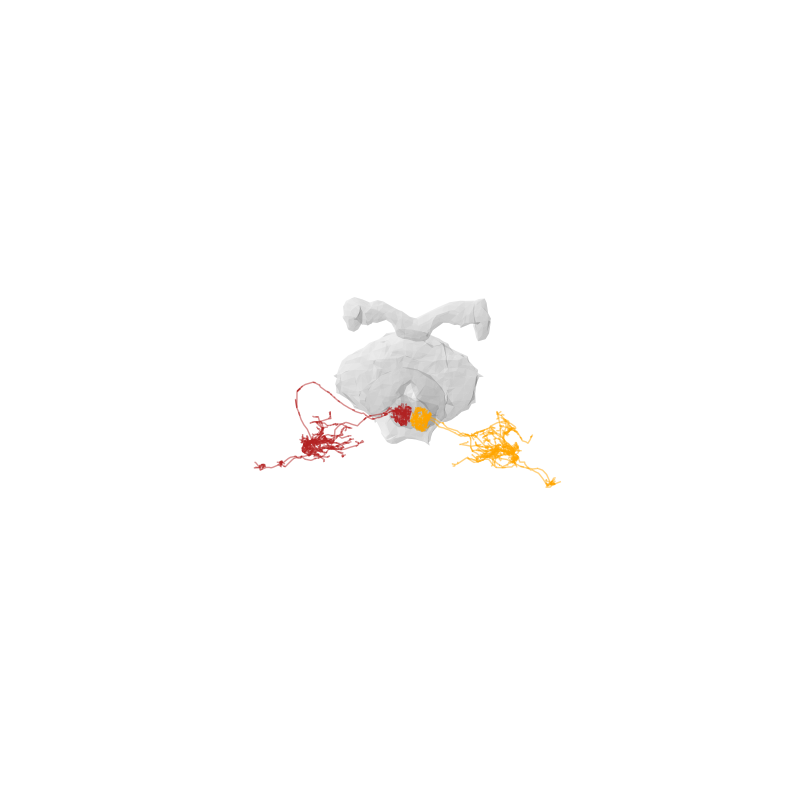

Layer 3 | FB5O | 0.08446144126688619


Fetching L2 skeletons:   0%|          | 0/3 [00:00<?, ?it/s]

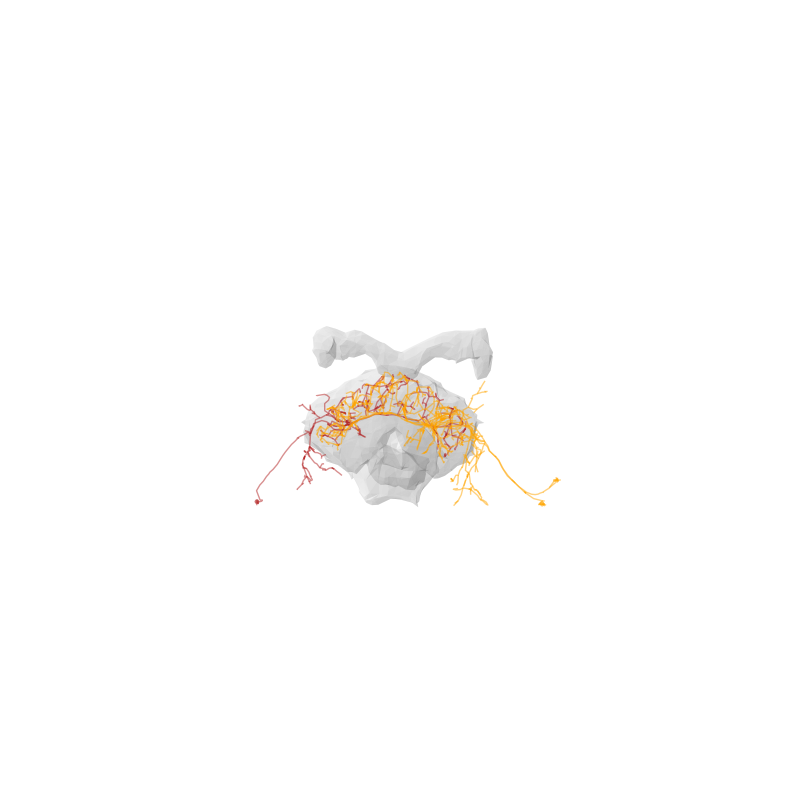

Layer 3 | FS3 | 0.07140332299456859


Fetching L2 skeletons:   0%|          | 0/68 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/68 [00:00<?, ?it/s]

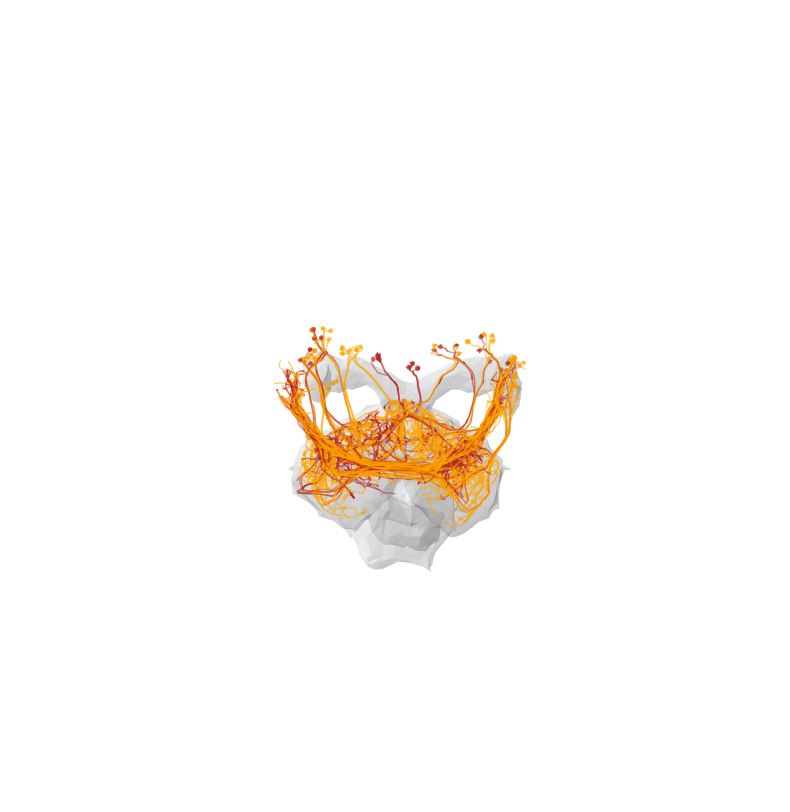

Layer 3 | CB.FB2E10 | 0.06986807936257802


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

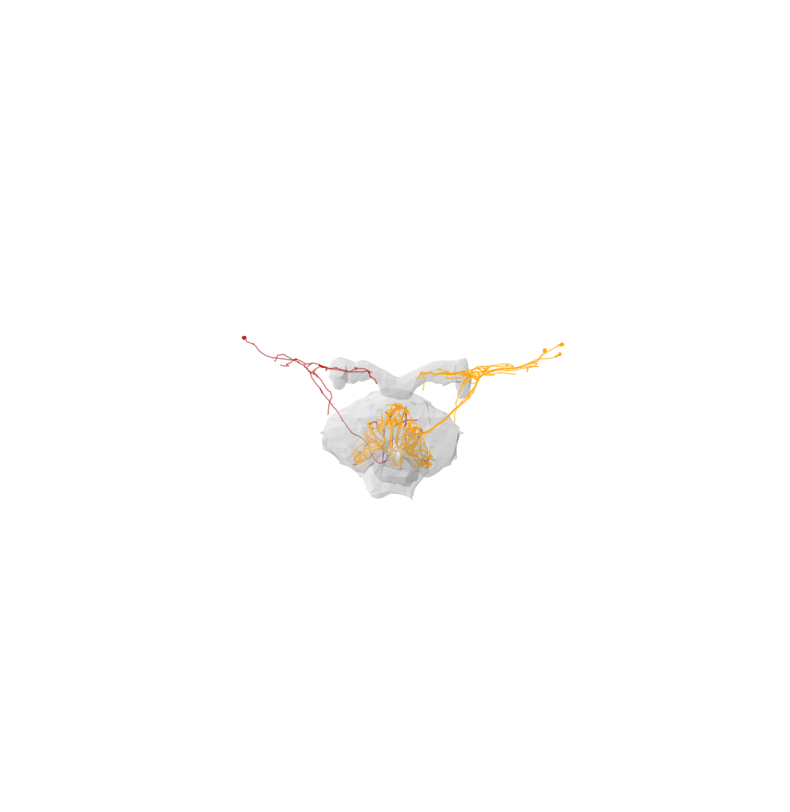

Layer 3 | LCNOp | 0.07974407201136446


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

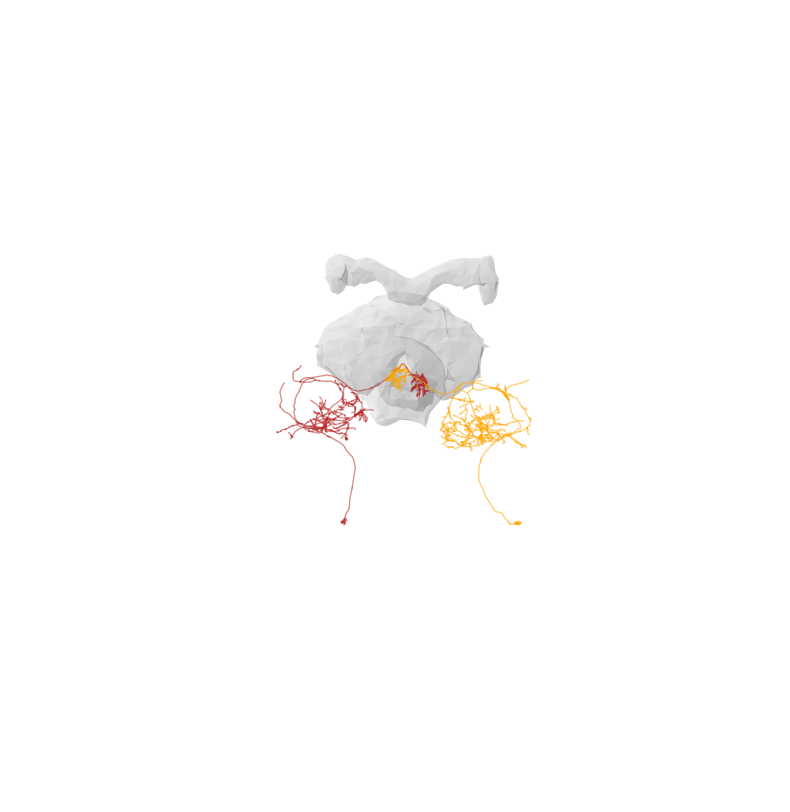

Layer 3 | FB4Y | 0.07686351801900325


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

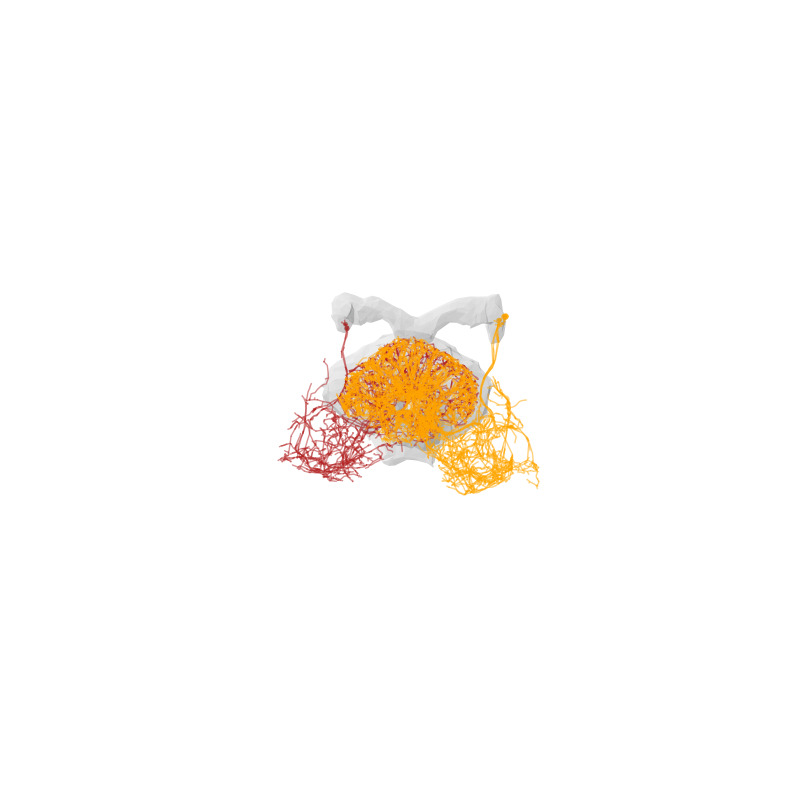

Layer 3 | vDeltaA/B/C/D/E/J/K/L/M | 0.07007626109089013


Fetching L2 skeletons:   0%|          | 0/315 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/315 [00:00<?, ?it/s]

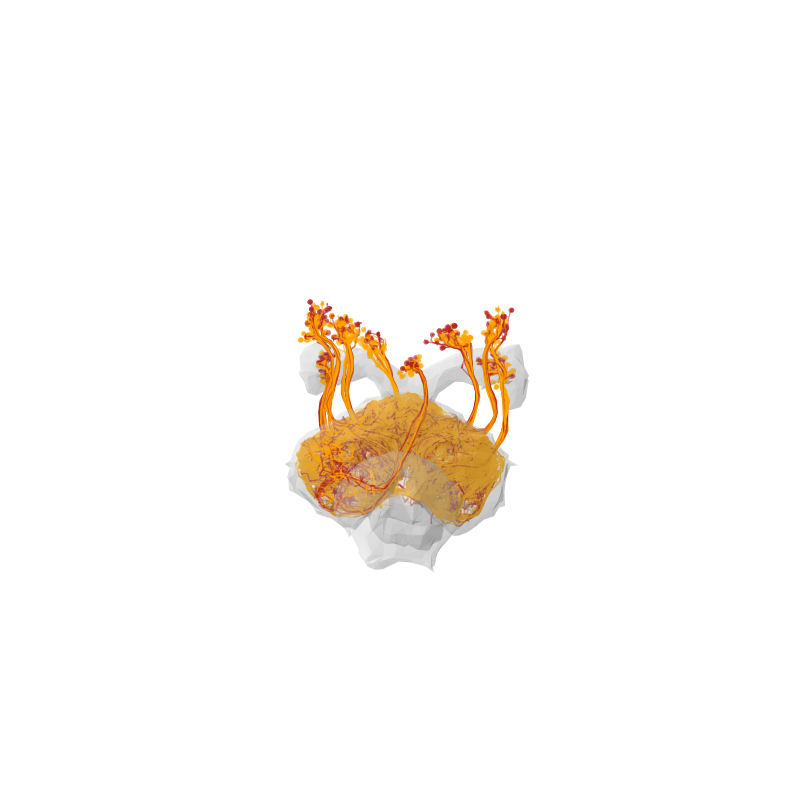

Layer 3 | LCNOpm | 0.07821451076191872


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

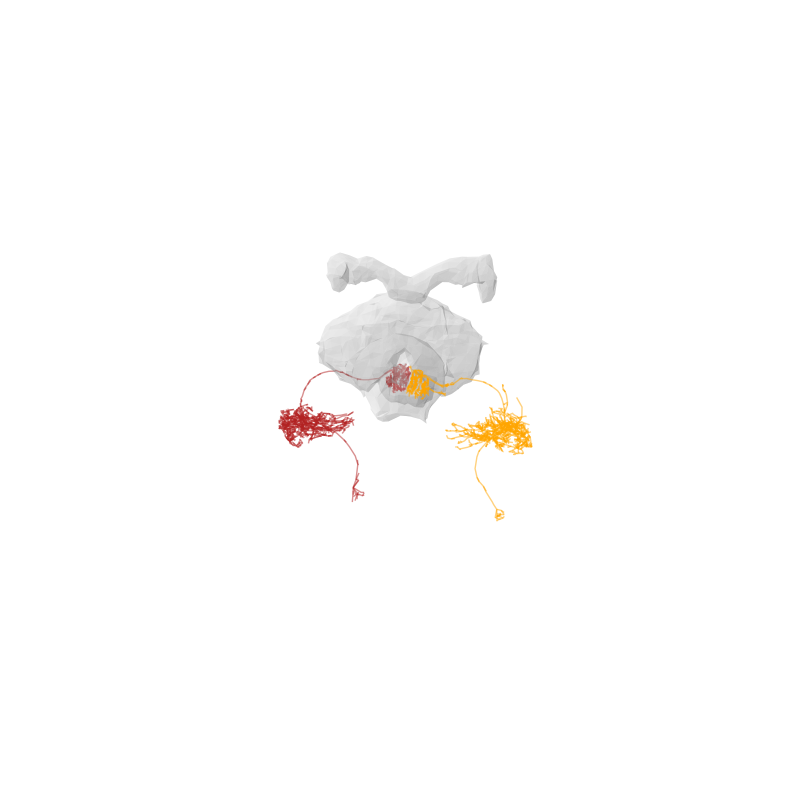

Layer 3 | ExR6 | 0.07564293757005056


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

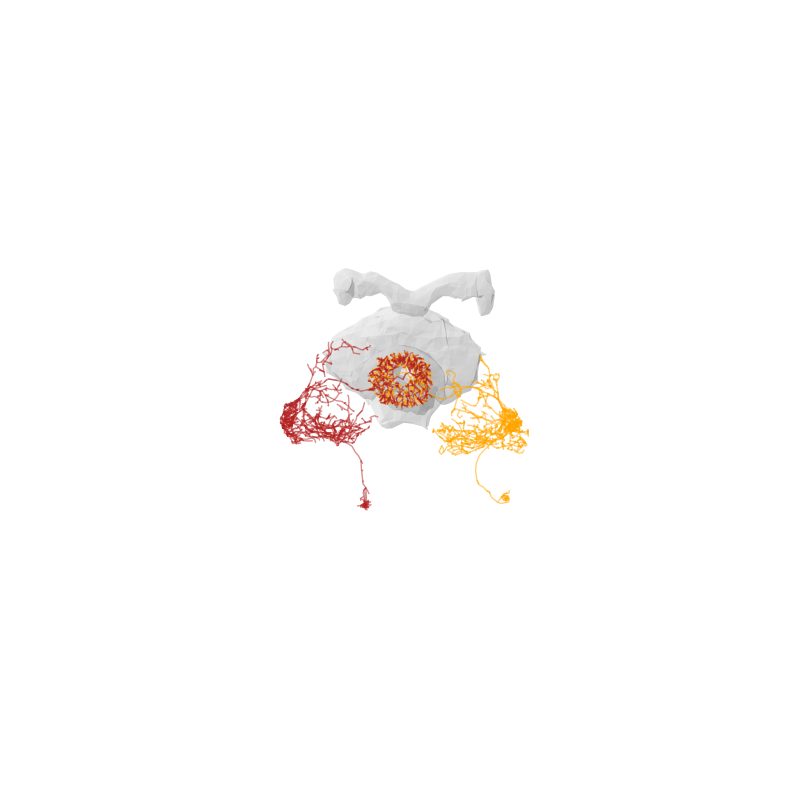

Layer 3 | FB4M | 0.07490482420676223


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

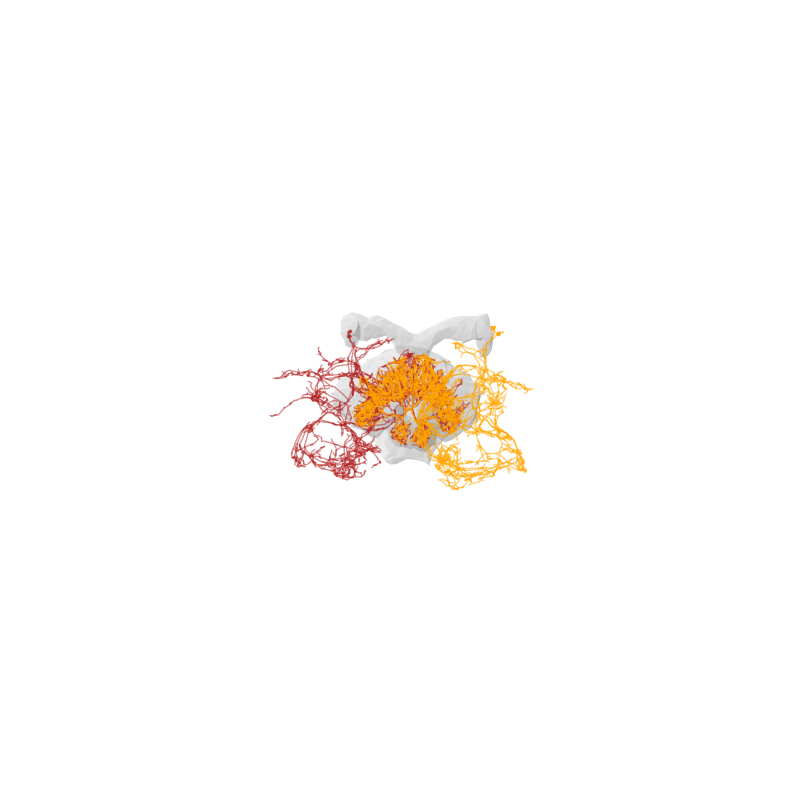

Layer 3 |  | 0.05802552103781084


Fetching L2 skeletons:   0%|          | 0/23 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/23 [00:00<?, ?it/s]

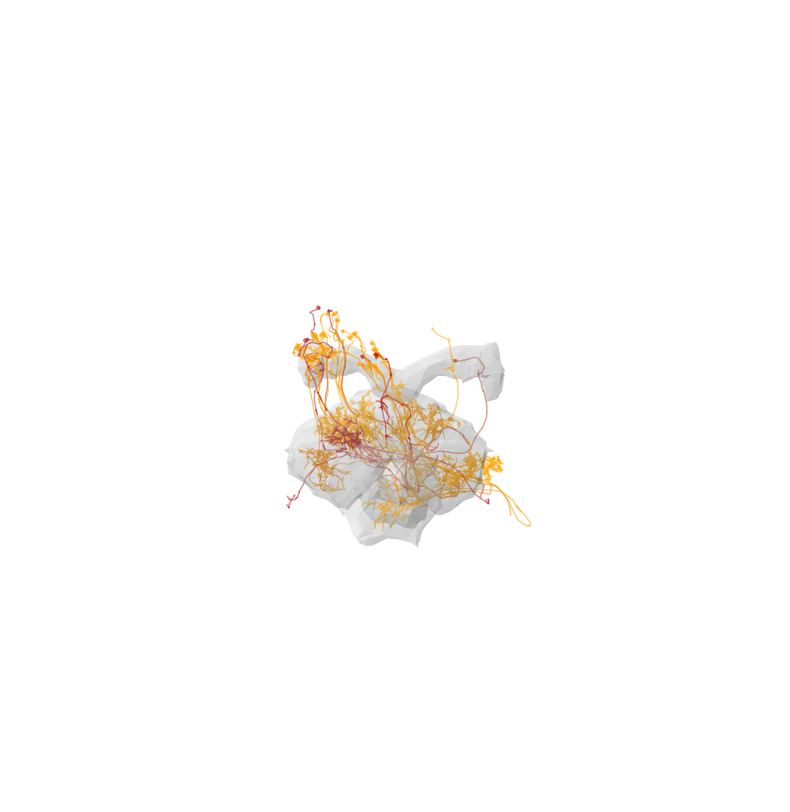

Layer 3 | CB.FB2I1 | 0.0682809950026904


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

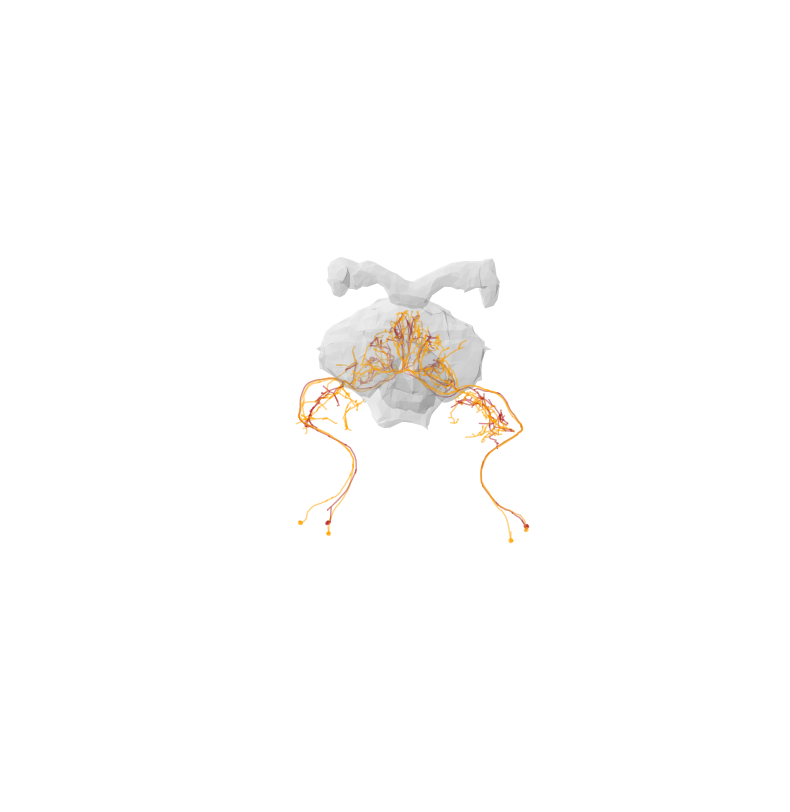

Layer 3 | FB2B | 0.07101876560325653


Fetching L2 skeletons:   0%|          | 0/7 [00:00<?, ?it/s]

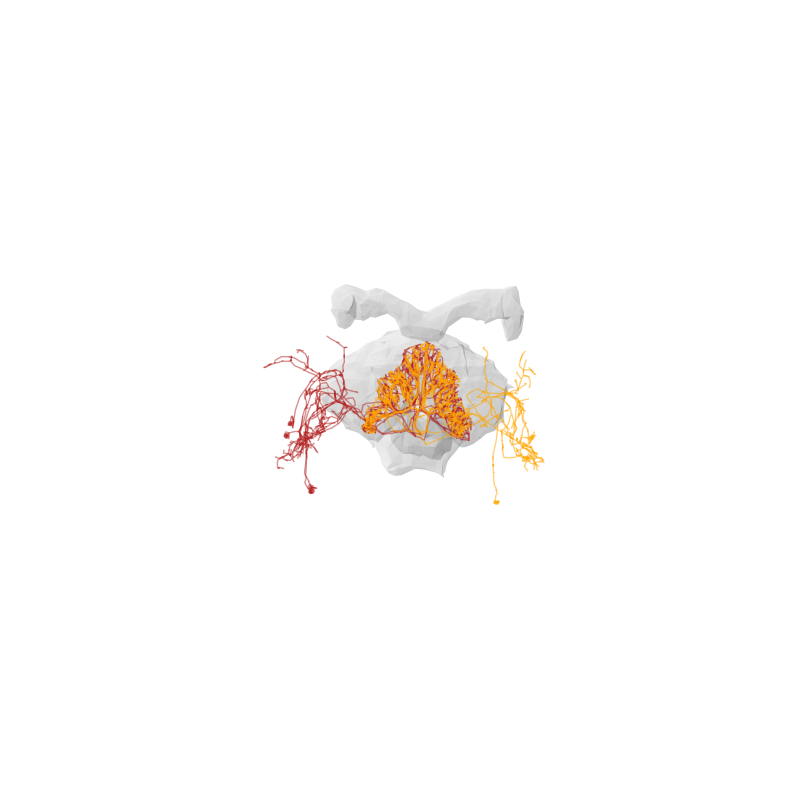

Layer 3 | CB.FB2E8 | 0.06210272062527081


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

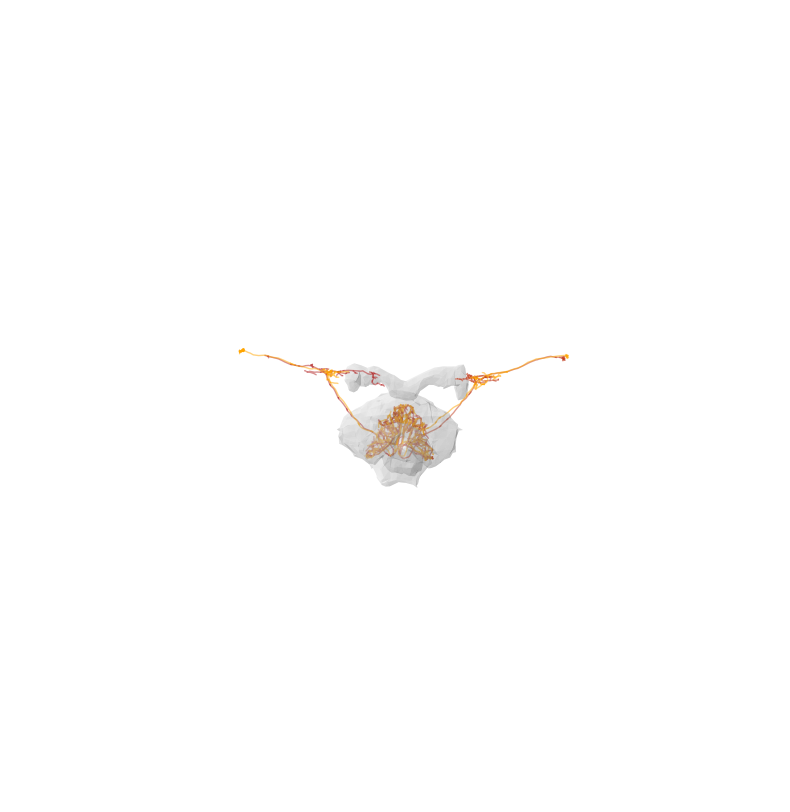

Layer 3 | hDeltaD | 0.06811049602386332


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

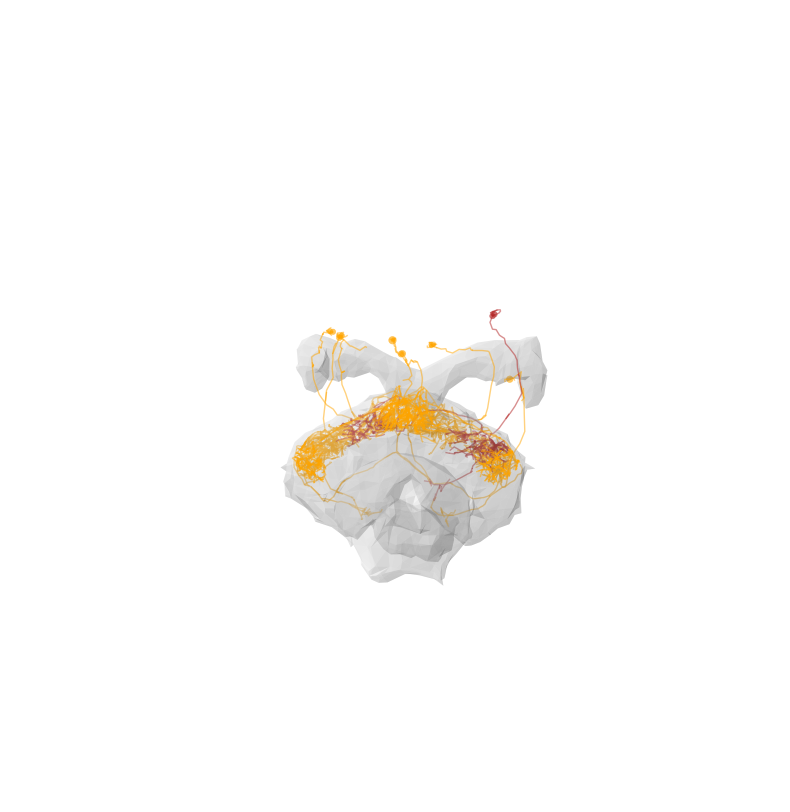

Layer 3 | FS1A/B | 0.05854314202590642


Fetching L2 skeletons:   0%|          | 0/64 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/64 [00:00<?, ?it/s]

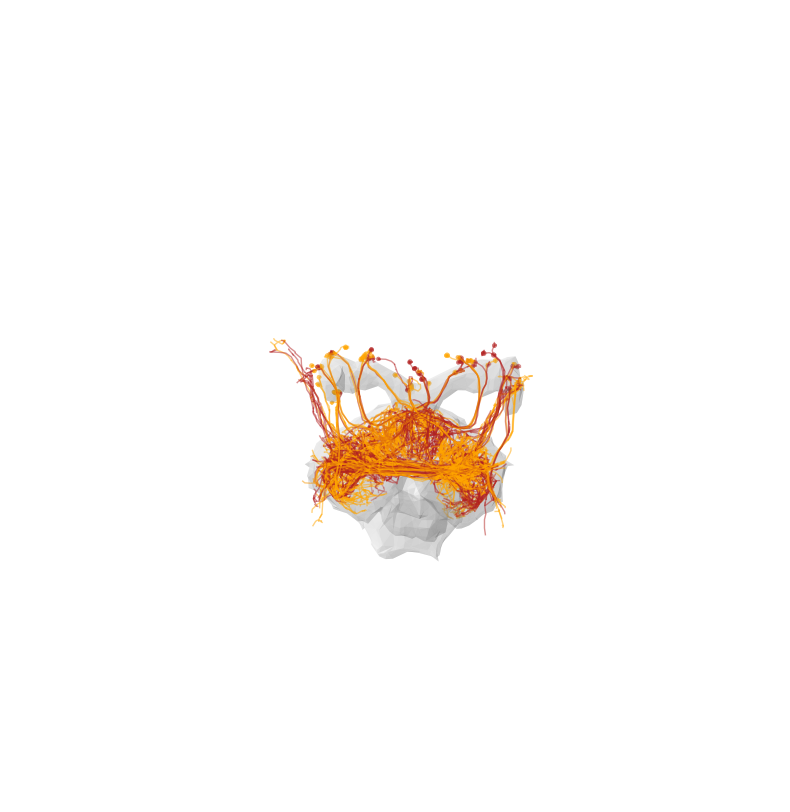

Layer 3 | FR2 | 0.062038538052212586


Fetching L2 skeletons:   0%|          | 0/17 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/17 [00:00<?, ?it/s]

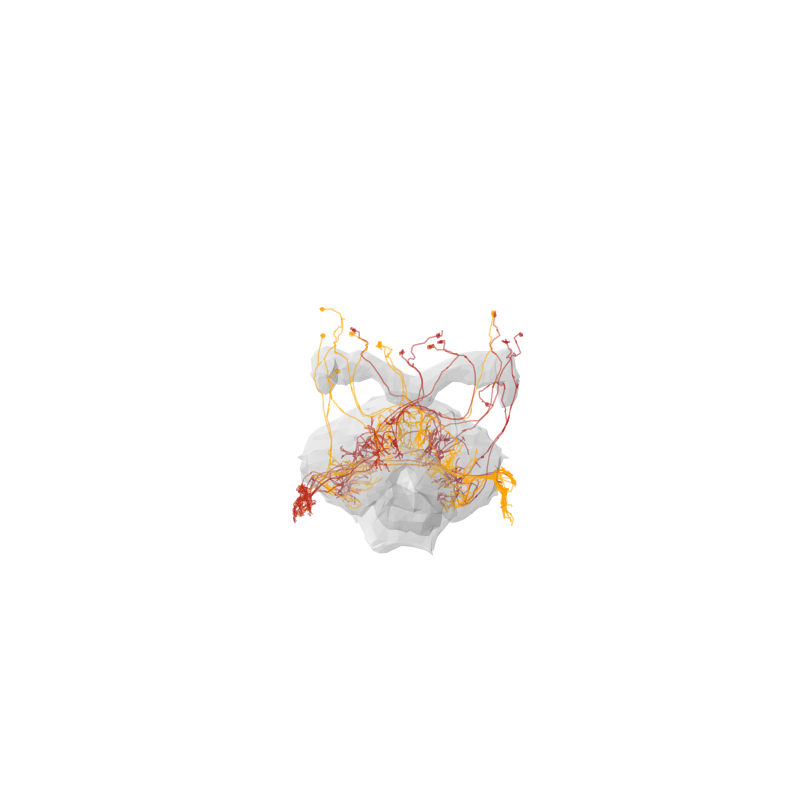

Layer 3 | hDeltaF | 0.06321853346481451


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

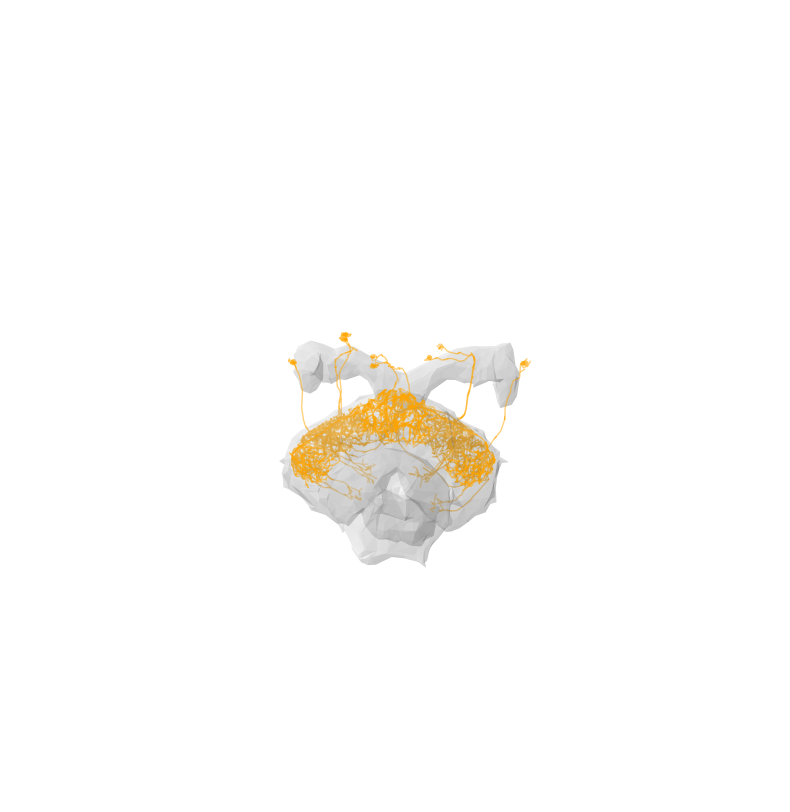

Layer 3 | FC2C | 0.05600001115587176


Fetching L2 skeletons:   0%|          | 0/40 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/40 [00:00<?, ?it/s]

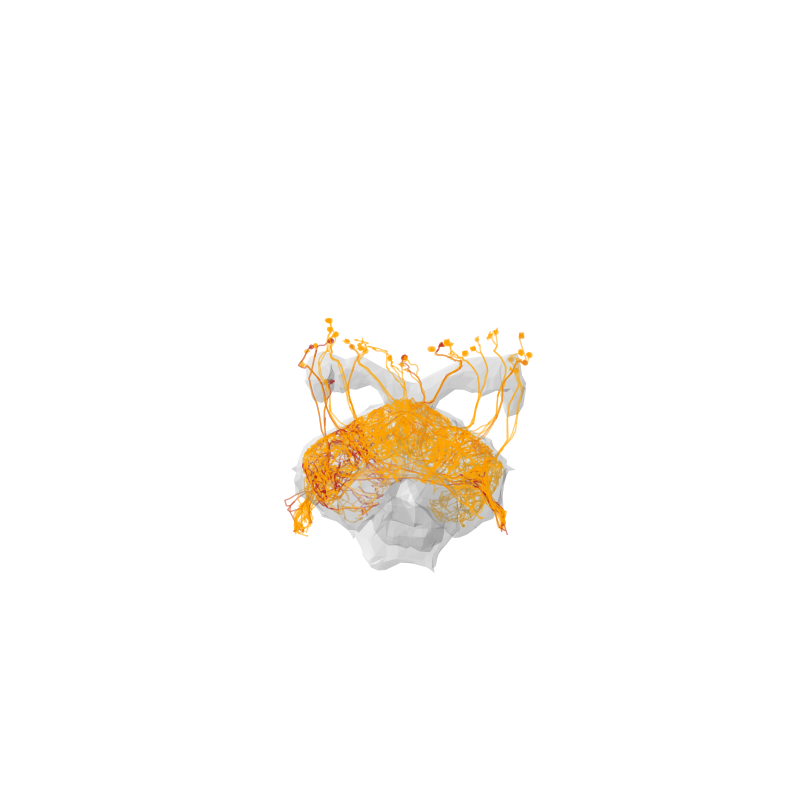

Layer 3 | FC1D/E | 0.06029450061281754


Fetching L2 skeletons:   0%|          | 0/38 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/38 [00:00<?, ?it/s]

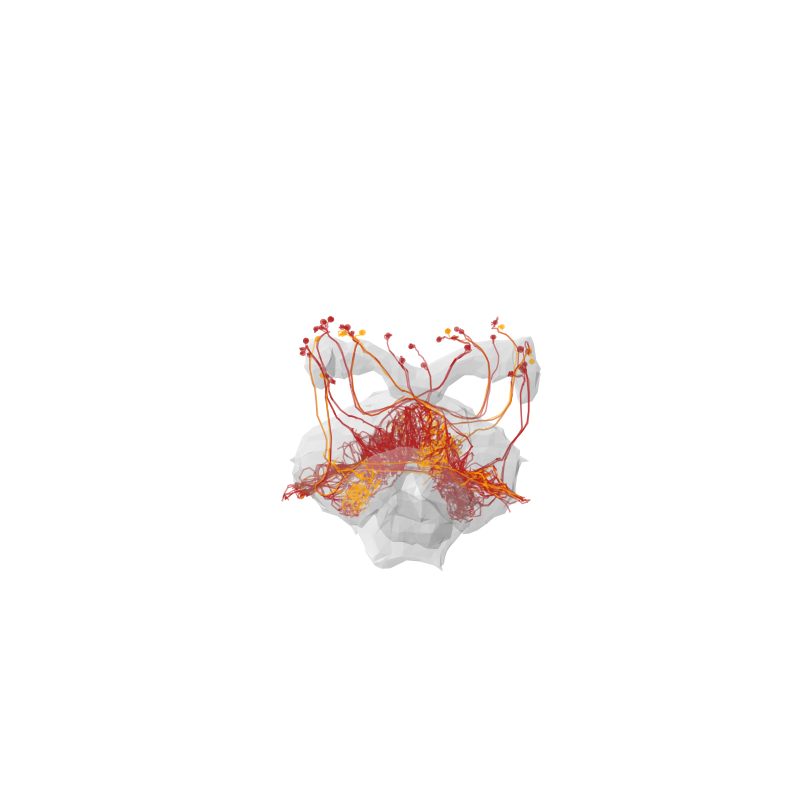

Layer 3 | LNO2 | 0.06295779956699446


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

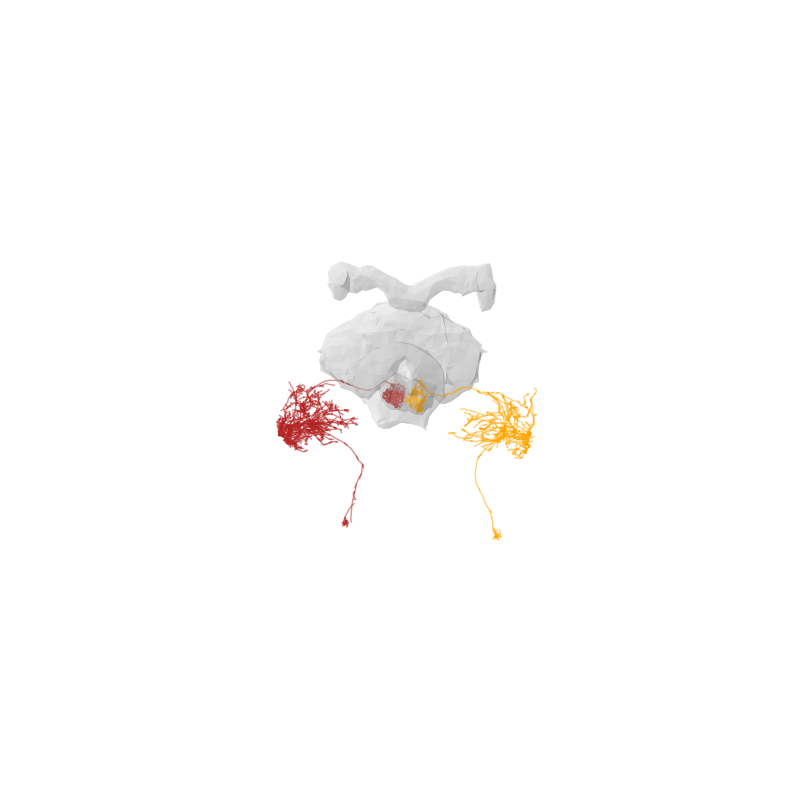

Layer 3 | LNOa | 0.06147357489380589


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

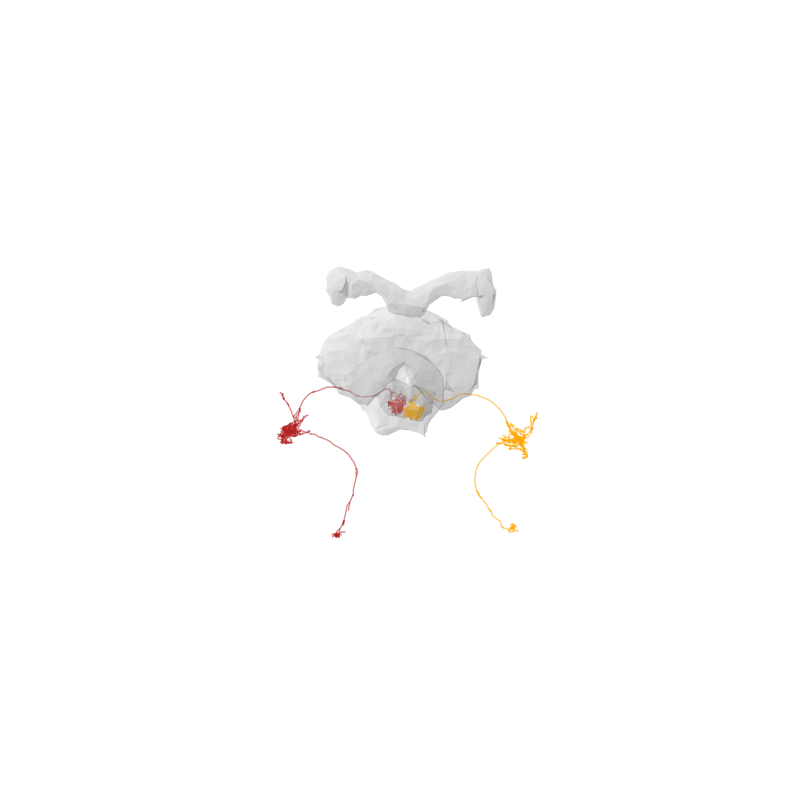

Layer 3 | hDeltaC | 0.05920017825443245


Fetching L2 skeletons:   0%|          | 0/21 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/21 [00:00<?, ?it/s]

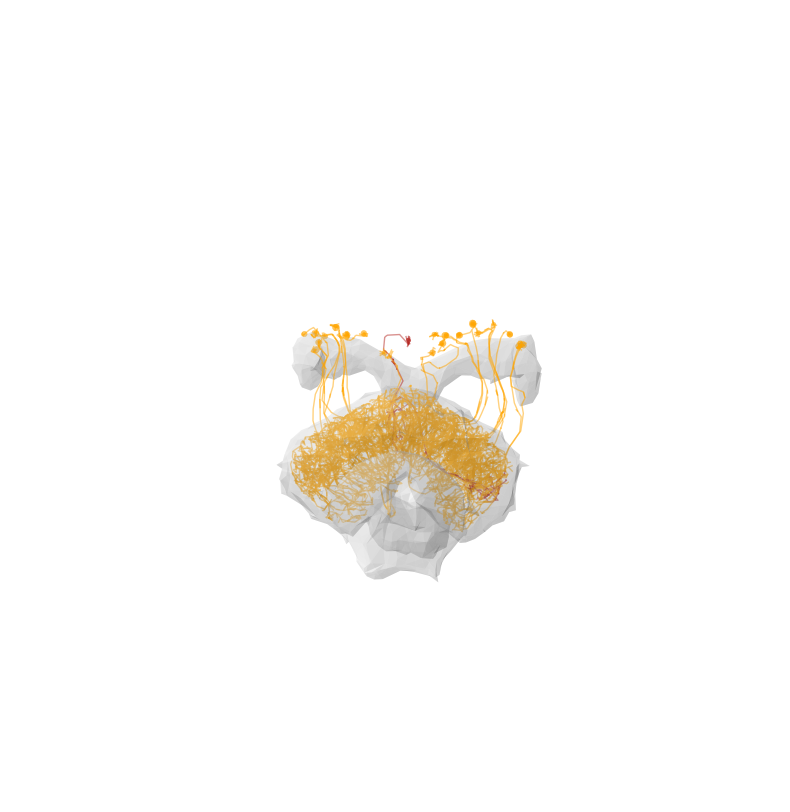

Layer 3 | ExR2 | 0.059007139485329235


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

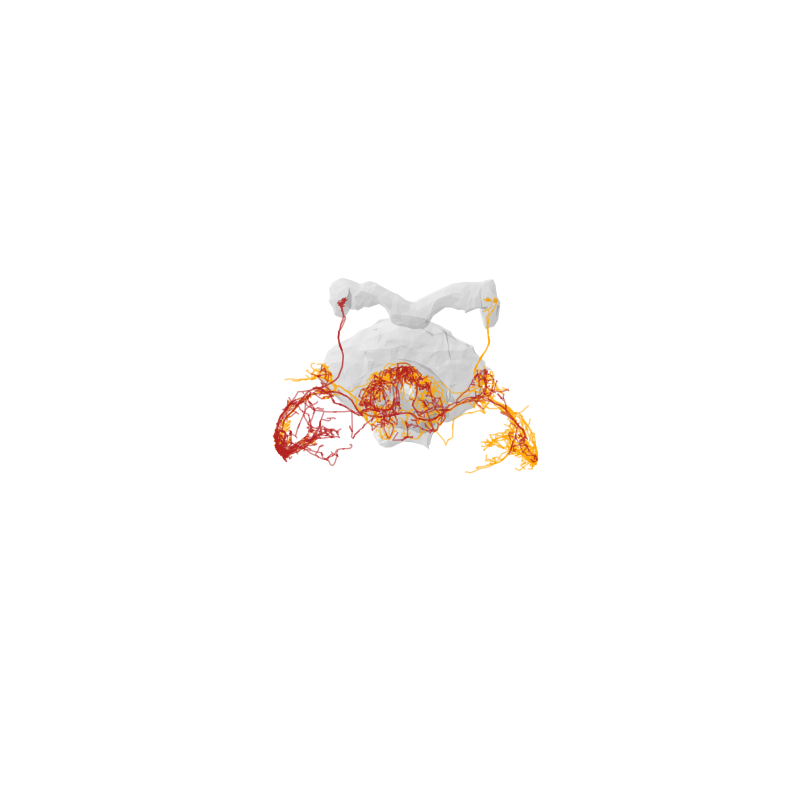

Layer 3 | ExR7 | 0.05750818863086907


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

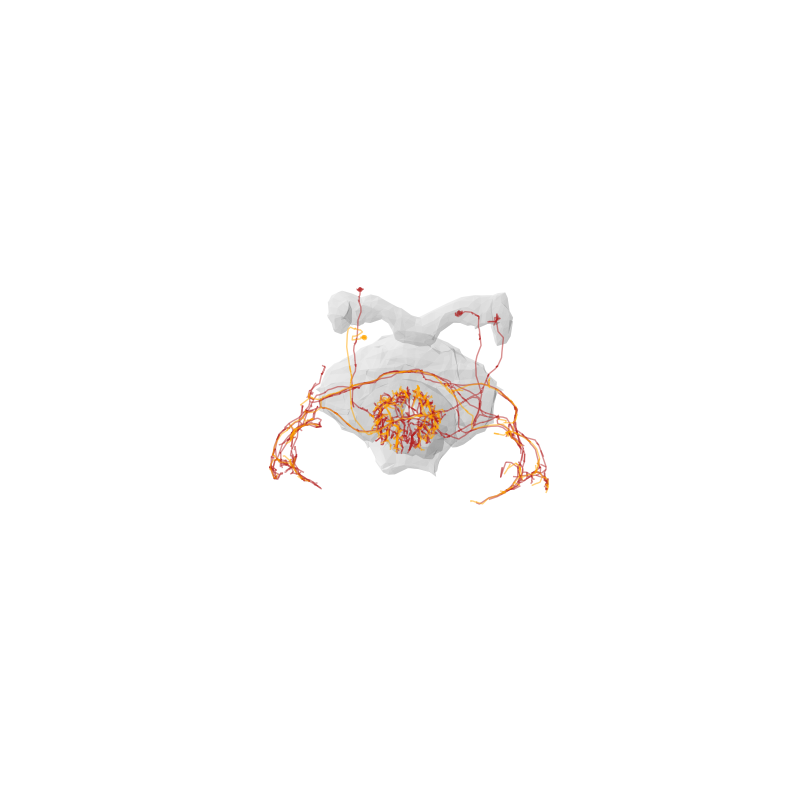

Layer 3 | hDeltaA | 0.05784151411028042


Fetching L2 skeletons:   0%|          | 0/10 [00:00<?, ?it/s]

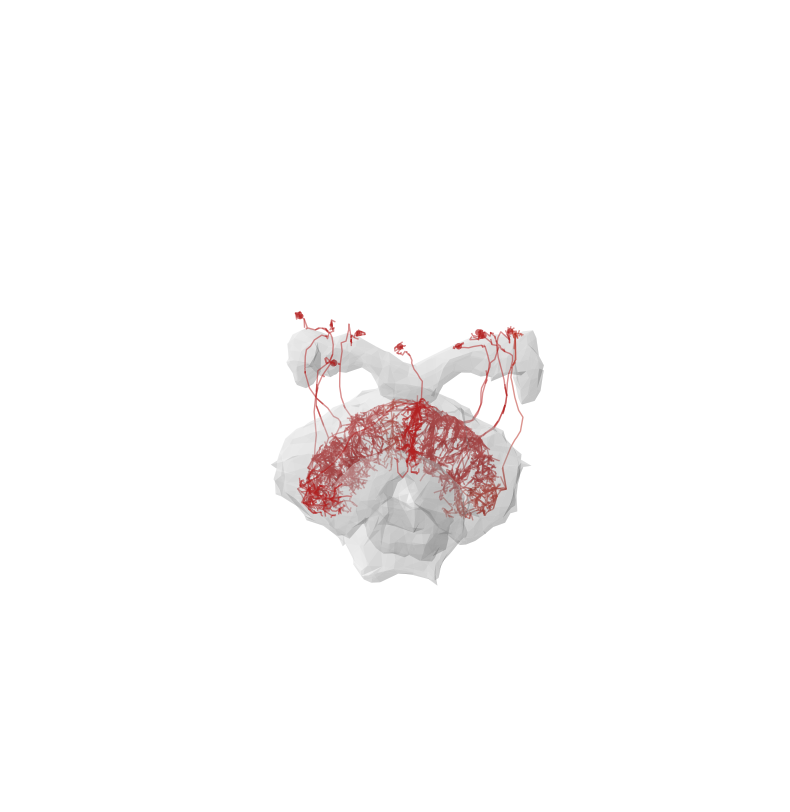

Layer 3 | FB5A | 0.05679493102017542


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

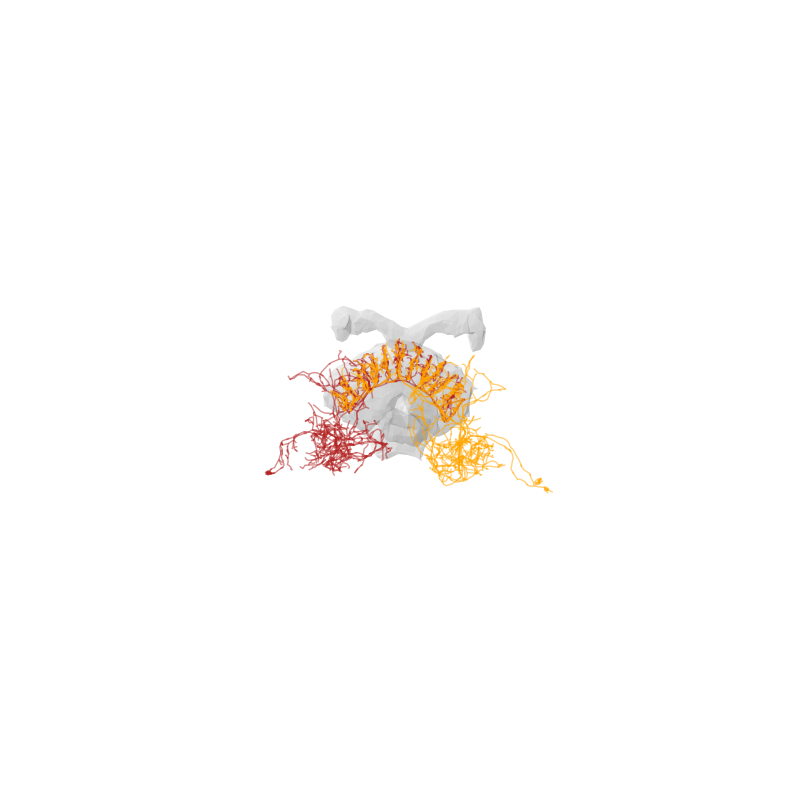

Layer 3 | FS2 | 0.051292675870640146


Fetching L2 skeletons:   0%|          | 0/38 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/38 [00:00<?, ?it/s]

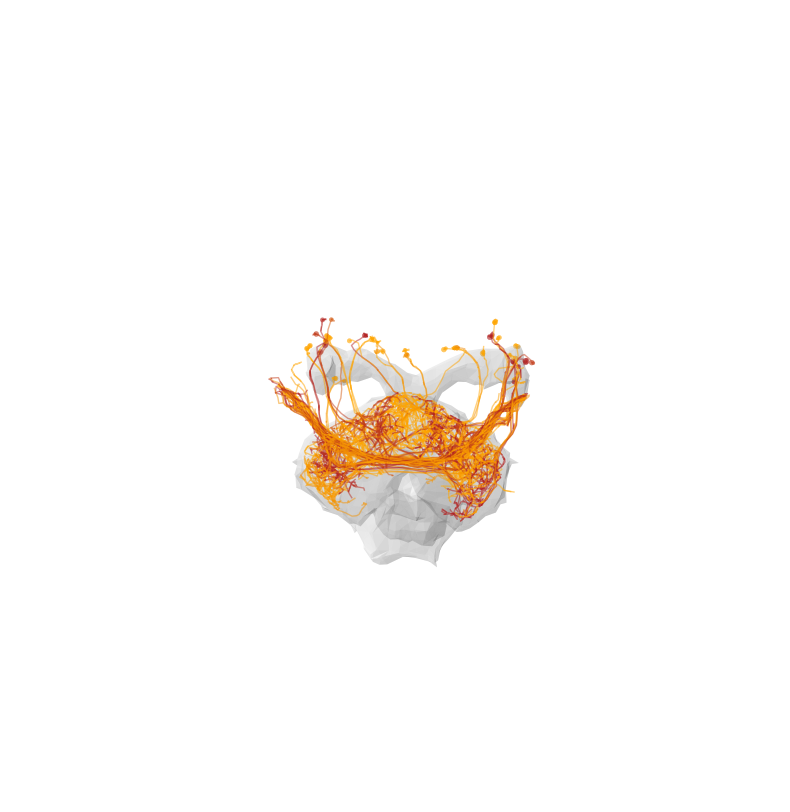

Layer 3 | FC3 | 0.05237718676095267


Fetching L2 skeletons:   0%|          | 0/40 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/40 [00:00<?, ?it/s]

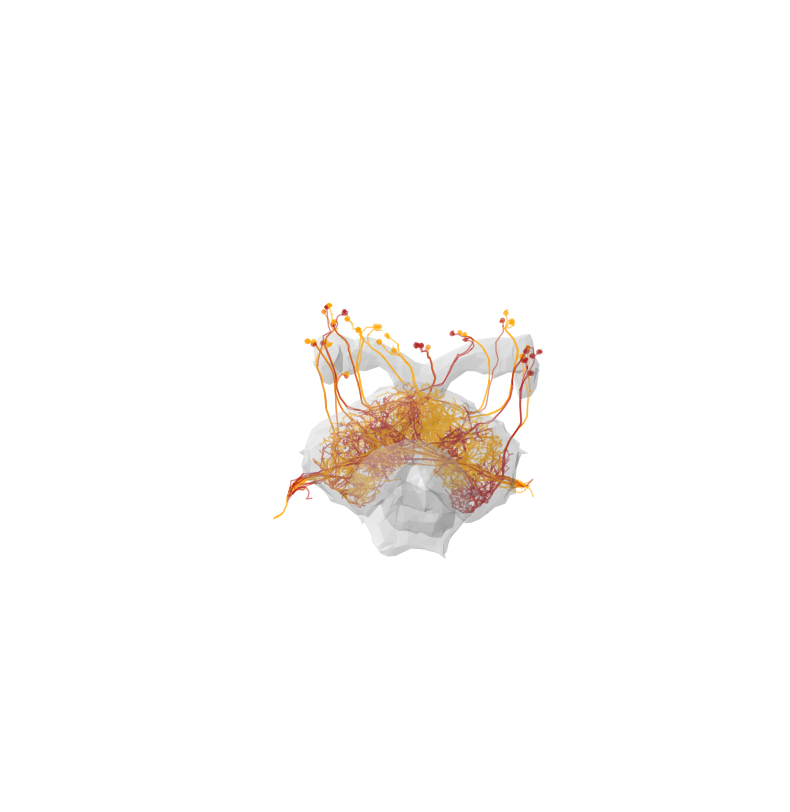

Layer 3 | vDeltaF/G/H/I | 0.053488514590145725


Fetching L2 skeletons:   0%|          | 0/74 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/74 [00:00<?, ?it/s]

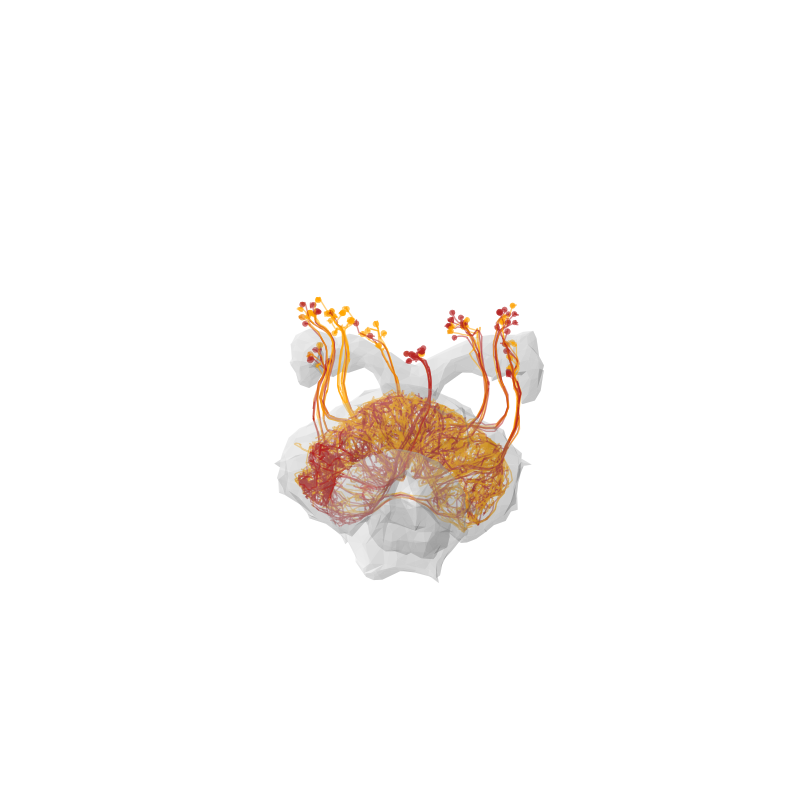

Layer 3 | PFNm/p | 0.048134224497195115


Fetching L2 skeletons:   0%|          | 0/321 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/321 [00:00<?, ?it/s]

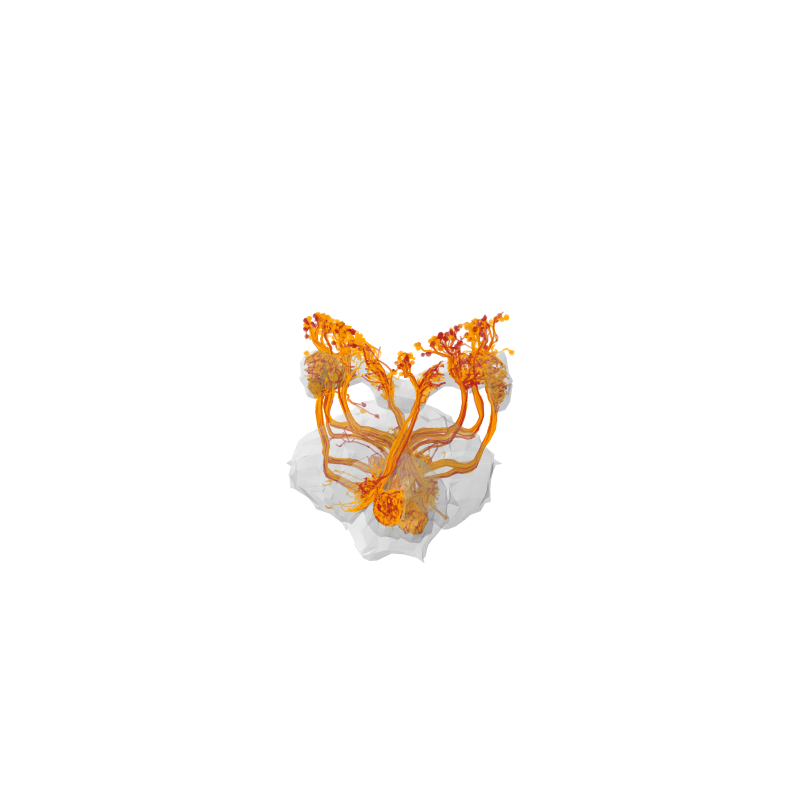

Layer 3 | hDeltaI | 0.0473268698397123


Fetching L2 skeletons:   0%|          | 0/20 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/20 [00:00<?, ?it/s]

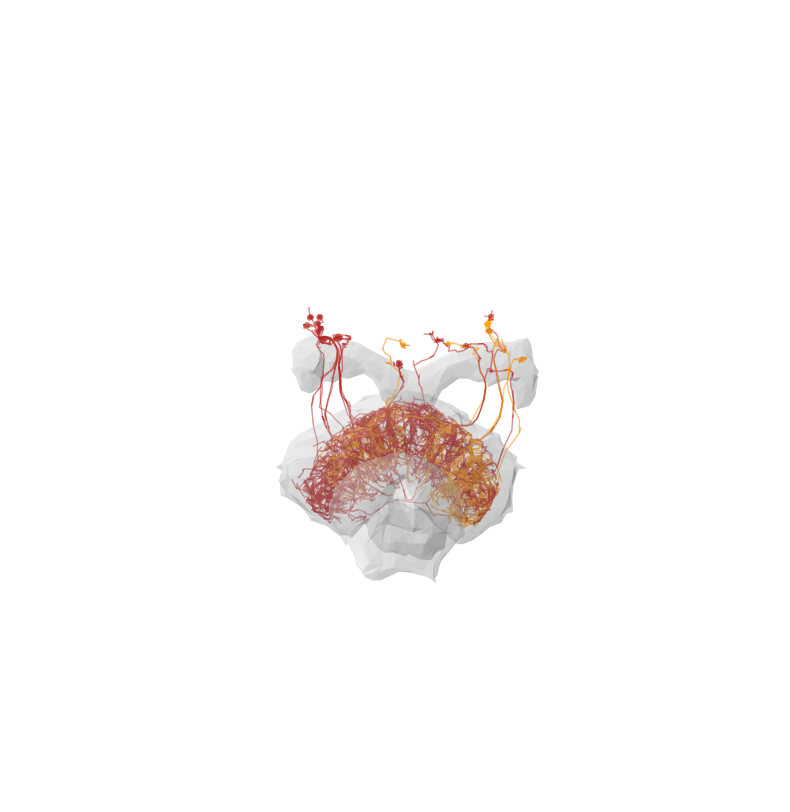

Layer 3 | FC1C | 0.04893390406593259


Fetching L2 skeletons:   0%|          | 0/27 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/27 [00:00<?, ?it/s]

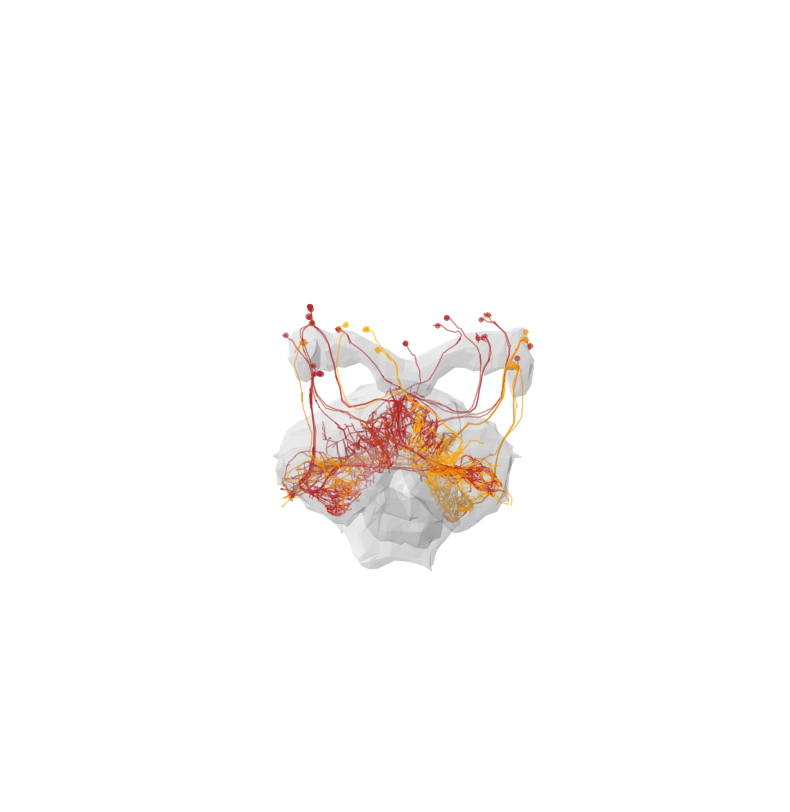

Layer 3 | ER4d | 0.03783859970495131


Fetching L2 skeletons:   0%|          | 0/26 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/26 [00:00<?, ?it/s]

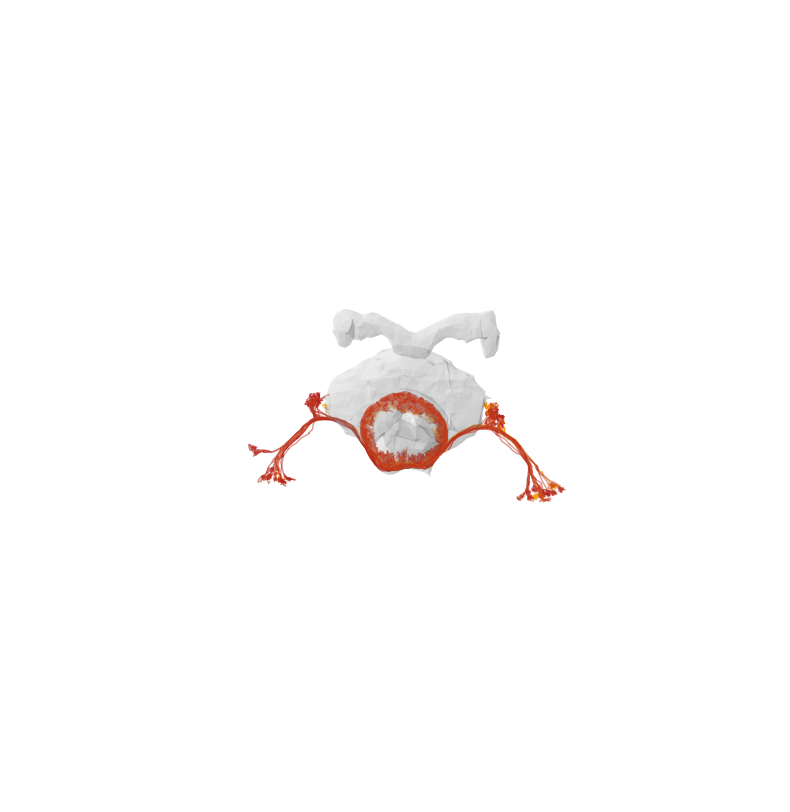

Layer 3 | hDeltaG | 0.05283258529137837


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

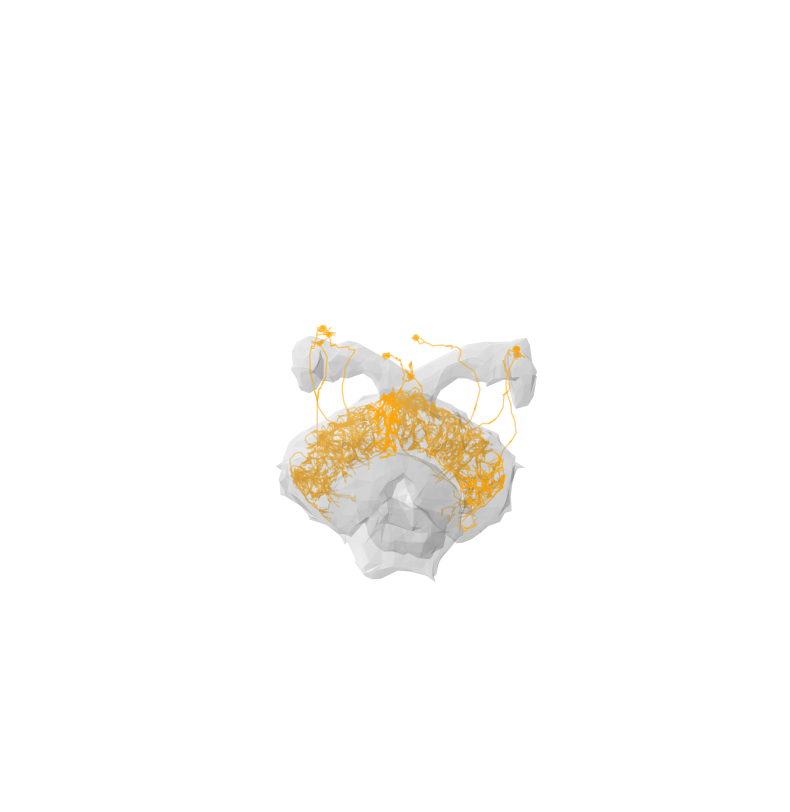

Layer 3 | FC2A | 0.0505702235571756


Fetching L2 skeletons:   0%|          | 0/16 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/16 [00:00<?, ?it/s]

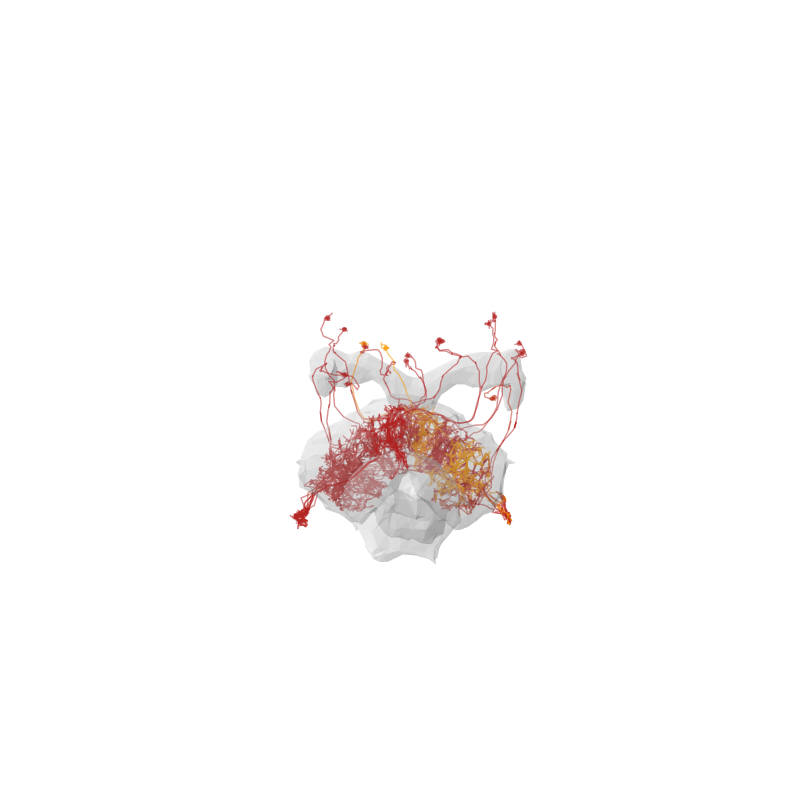

Layer 3 | ExR4 | 0.05100020923986426


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

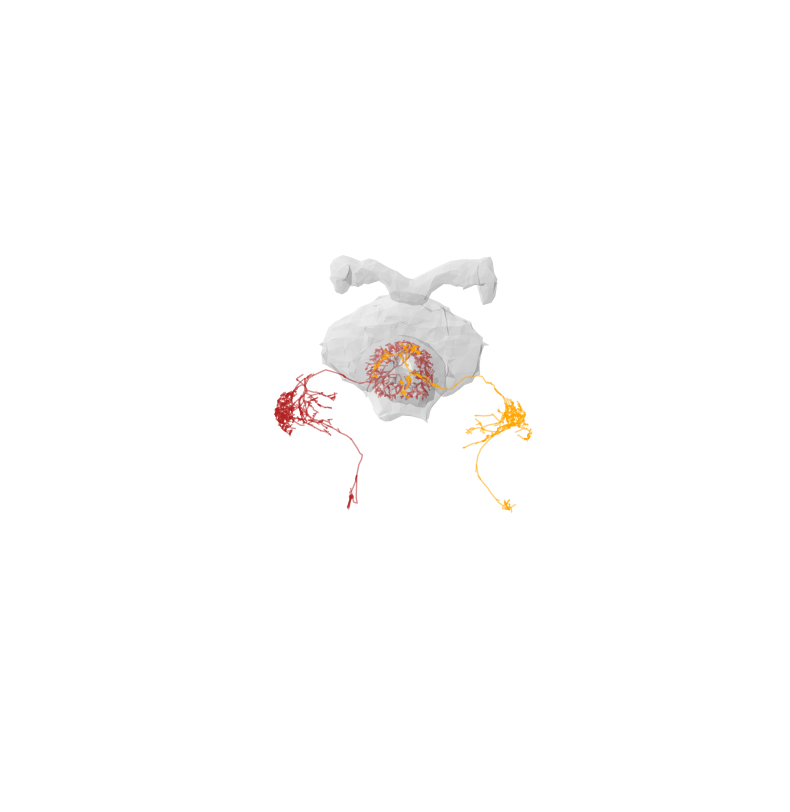

Layer 3 | PFNv | 0.0505187487401956


Fetching L2 skeletons:   0%|          | 0/21 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/21 [00:00<?, ?it/s]

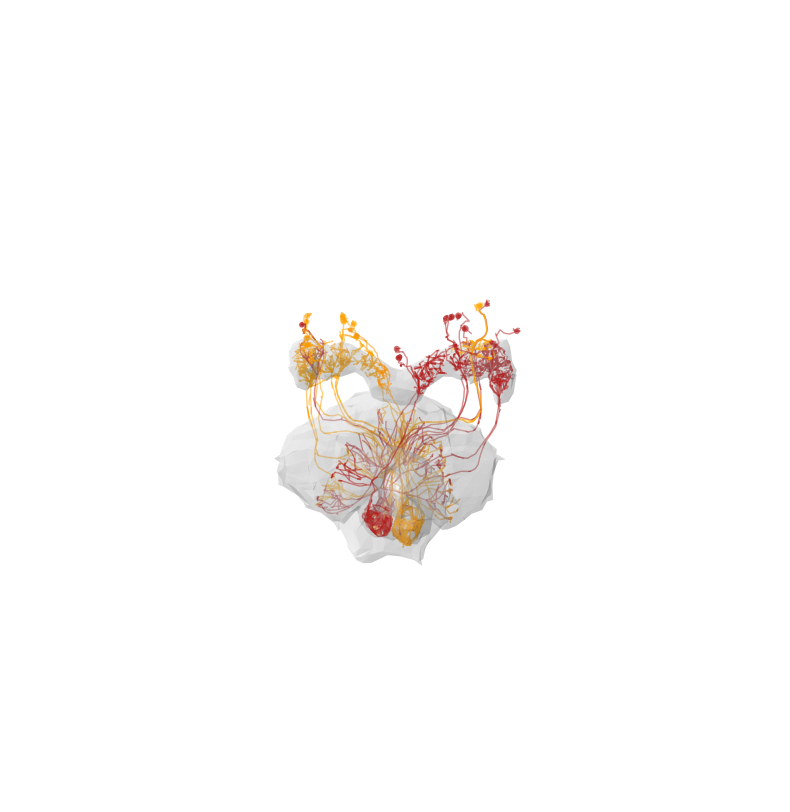

Layer 3 | FB4Z/5U/5R | 0.0516039273229841


Fetching L2 skeletons:   0%|          | 0/12 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/12 [00:00<?, ?it/s]

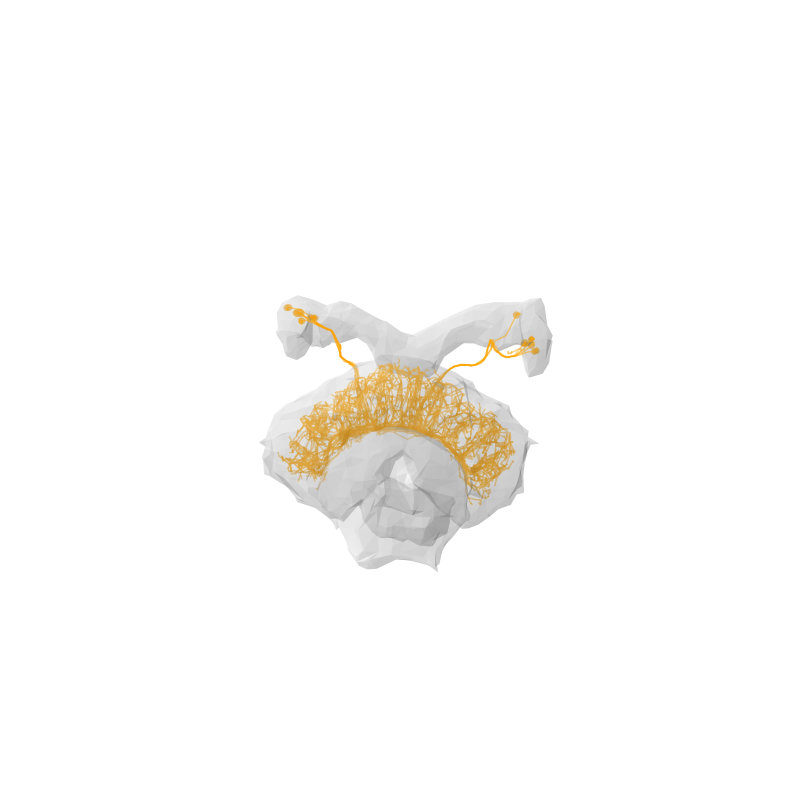

Layer 3 | hDeltaJ | 0.048614366437749634


Fetching L2 skeletons:   0%|          | 0/30 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/30 [00:00<?, ?it/s]

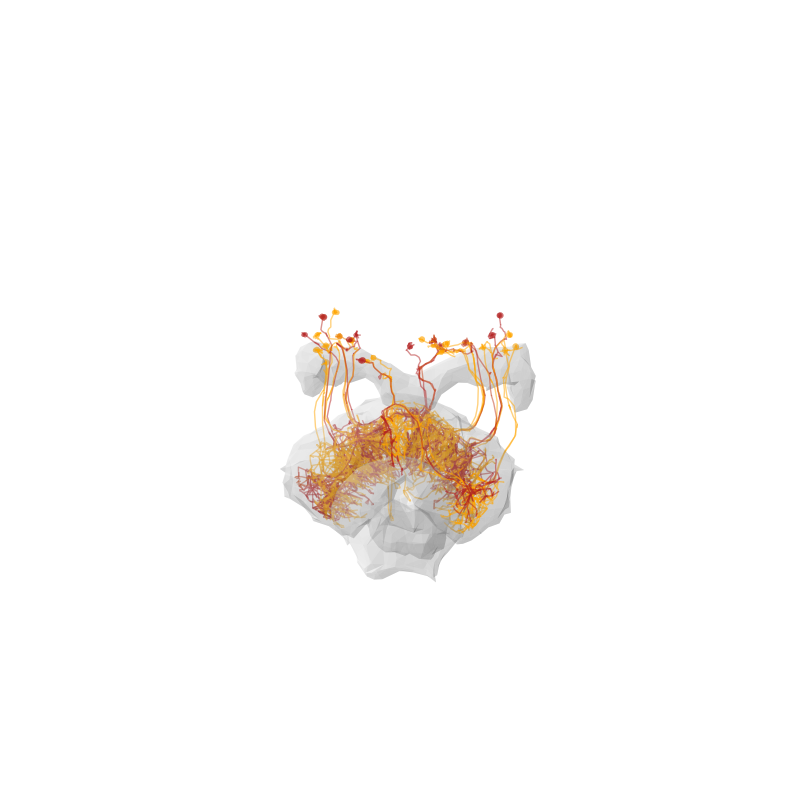

Layer 3 | FC1A/B/F | 0.04561570643920597


Fetching L2 skeletons:   0%|          | 0/43 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/43 [00:00<?, ?it/s]

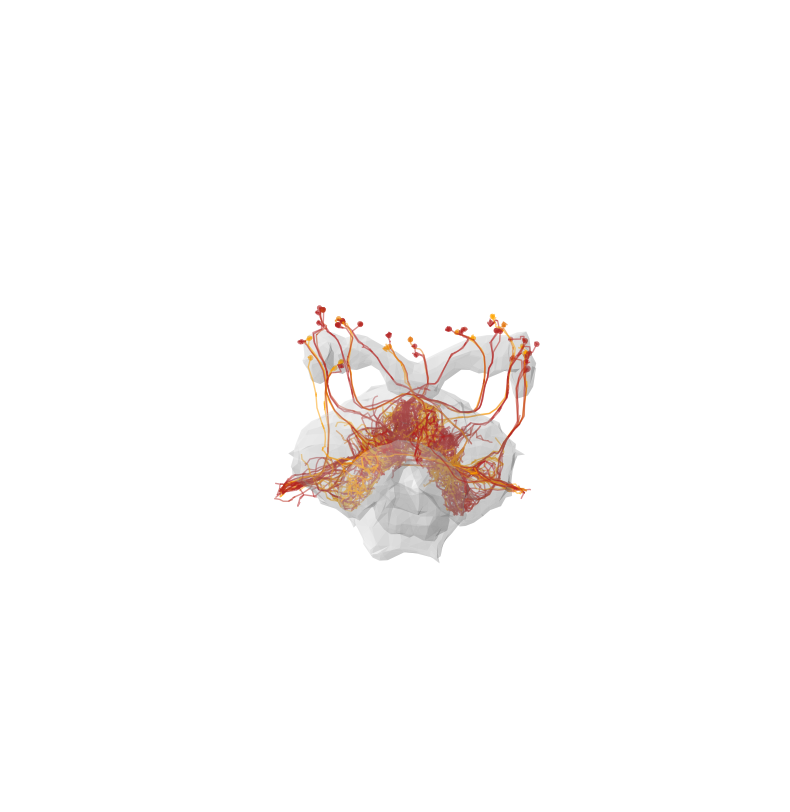

Layer 3 | FB5S/6L | 0.051507823954070775


Fetching L2 skeletons:   0%|          | 0/6 [00:00<?, ?it/s]

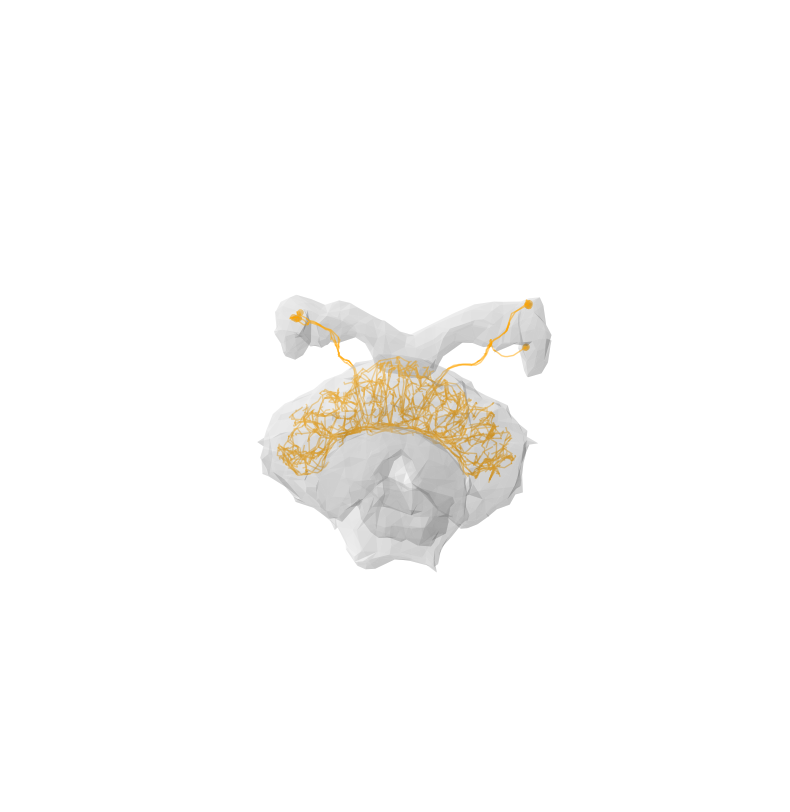

Layer 3 | P1-9 | 0.0511300074299227


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

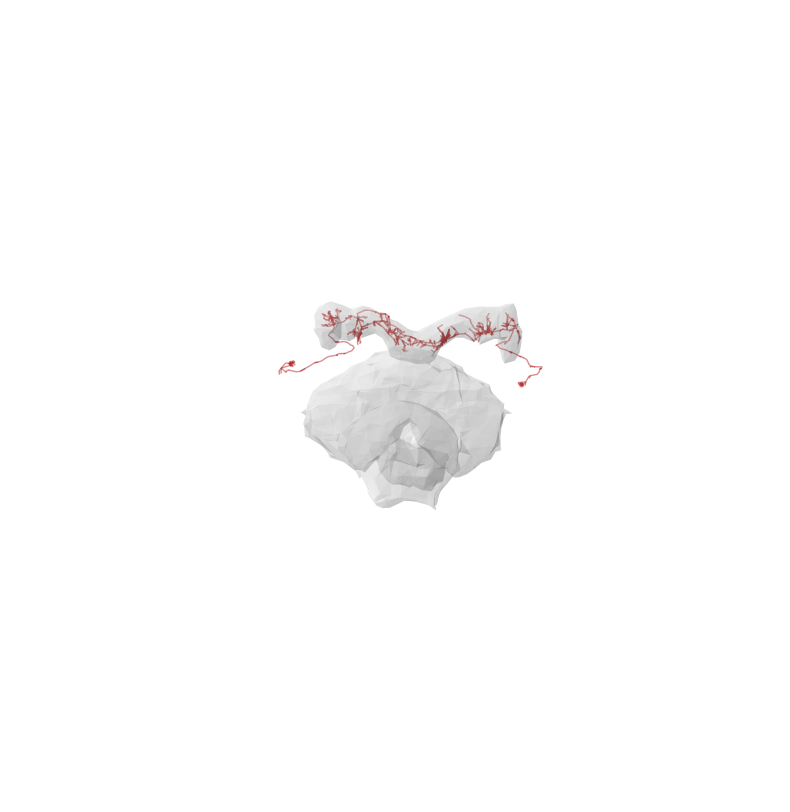

Layer 3 | PFL1 | 0.04895303912652945


Fetching L2 skeletons:   0%|          | 0/14 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/14 [00:00<?, ?it/s]

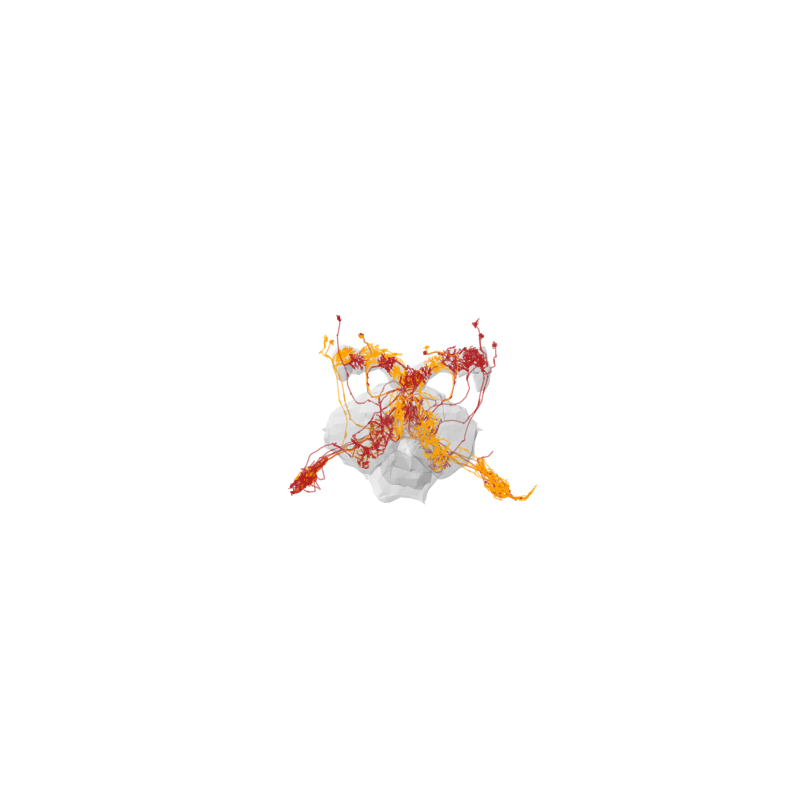

Layer 3 | hDeltaH | 0.04864837787120638


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

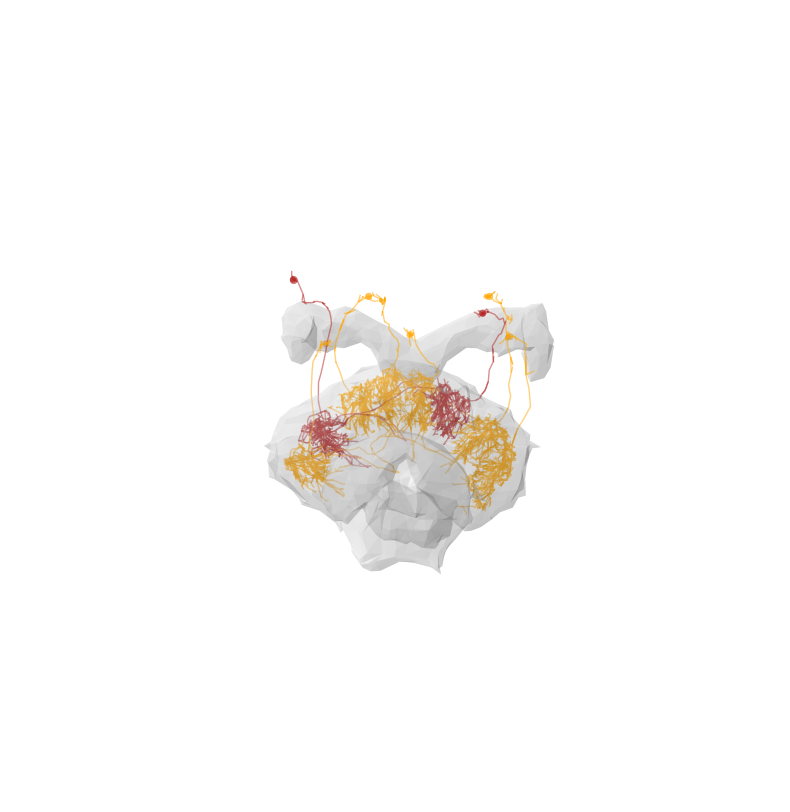

Layer 3 | FC2B | 0.04656941818277356


Fetching L2 skeletons:   0%|          | 0/28 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/28 [00:00<?, ?it/s]

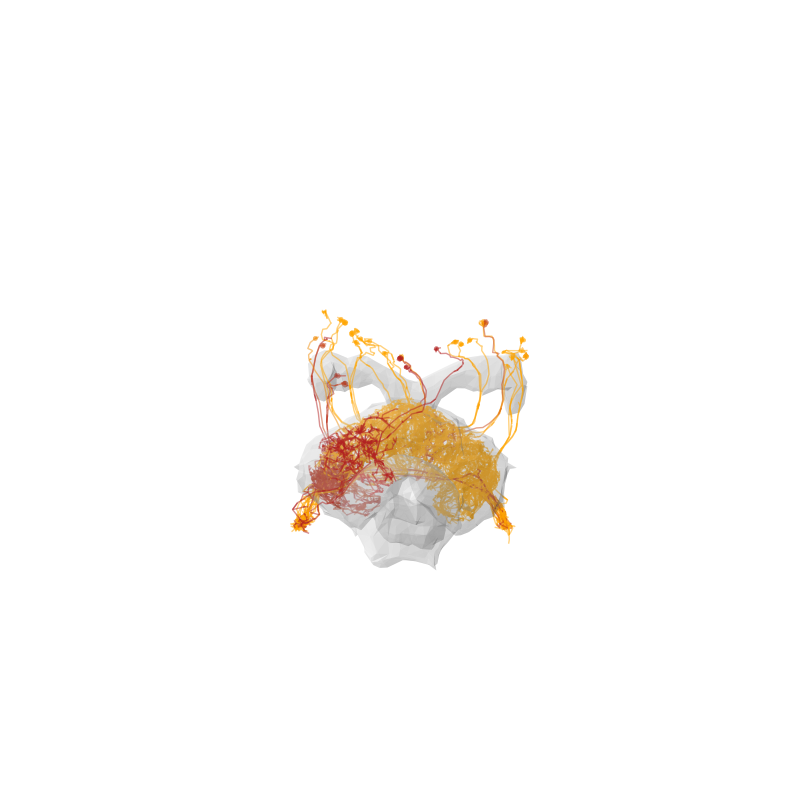

Layer 3 | ExR1 | 0.04914460758772374


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

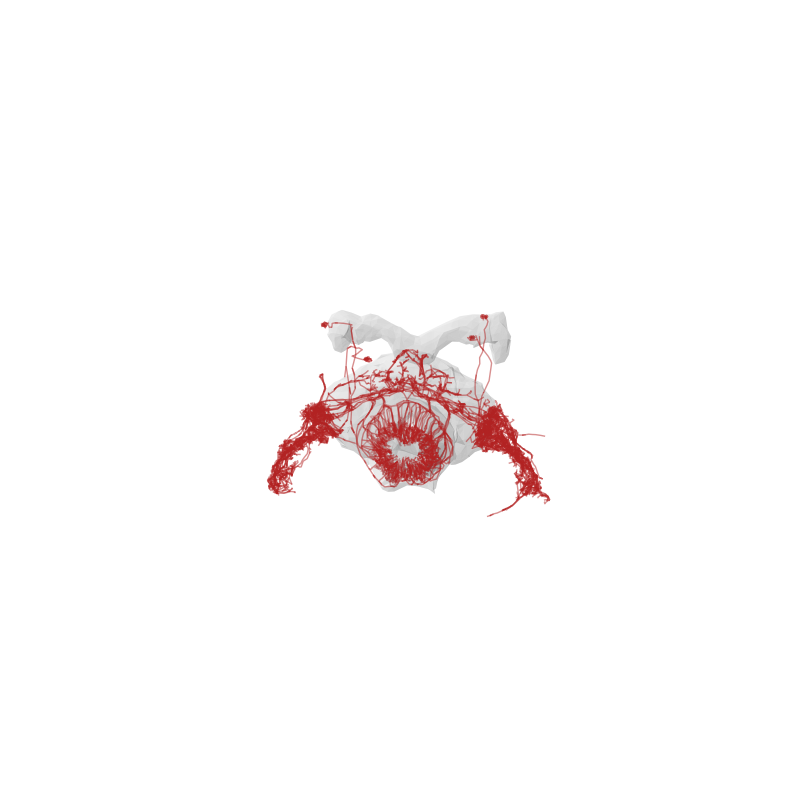

Layer 3 | Delta7 | 0.049300279336168595


Fetching L2 skeletons:   0%|          | 0/40 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/40 [00:00<?, ?it/s]

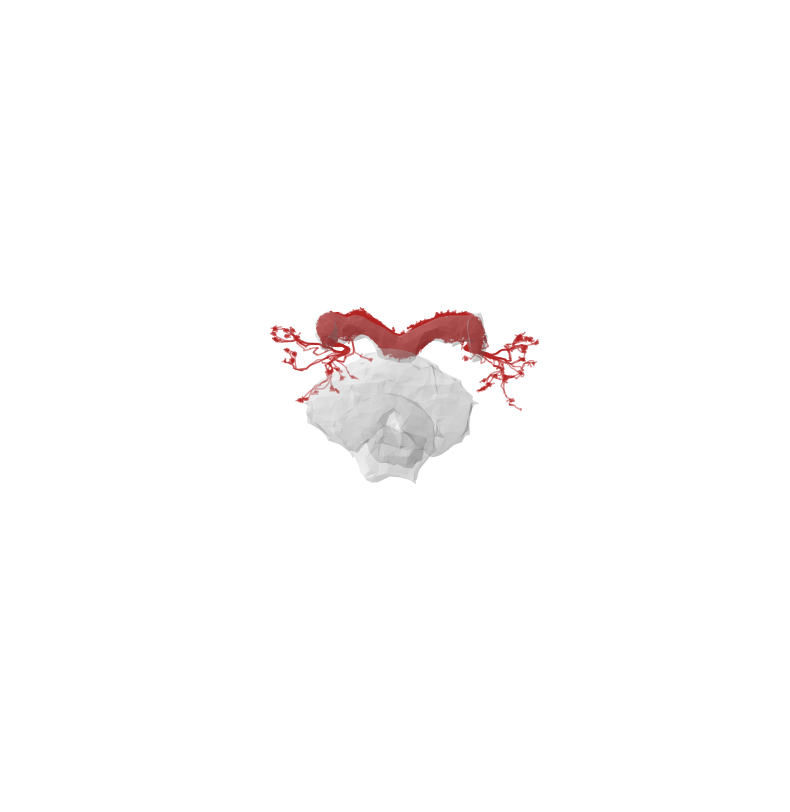

Layer 3 | hDeltaK | 0.04519891132152571


Fetching L2 skeletons:   0%|          | 0/31 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/31 [00:00<?, ?it/s]

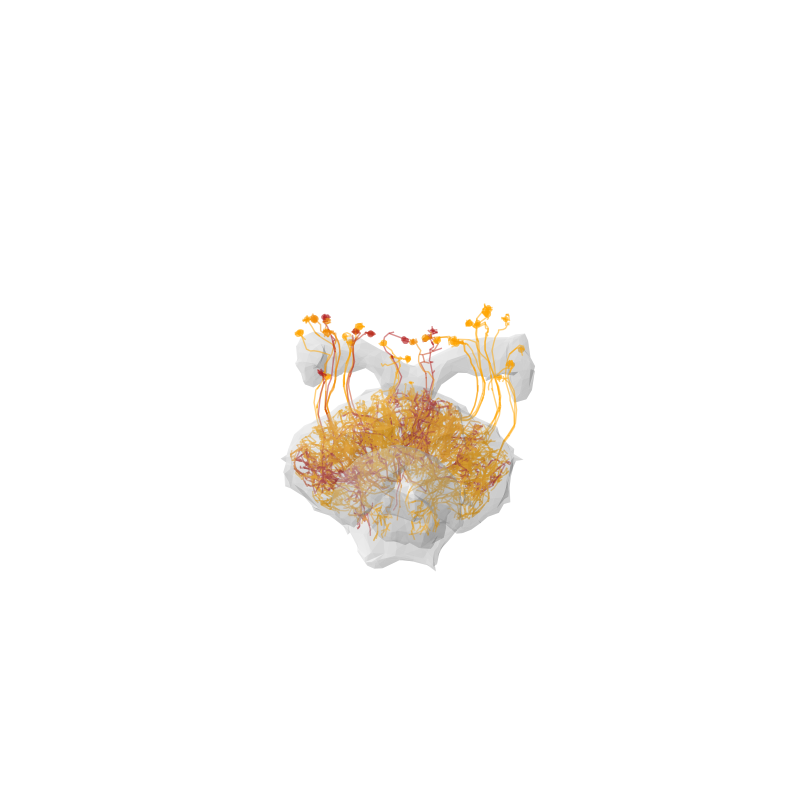

Layer 3 | ExR8 | 0.047123618632649564


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

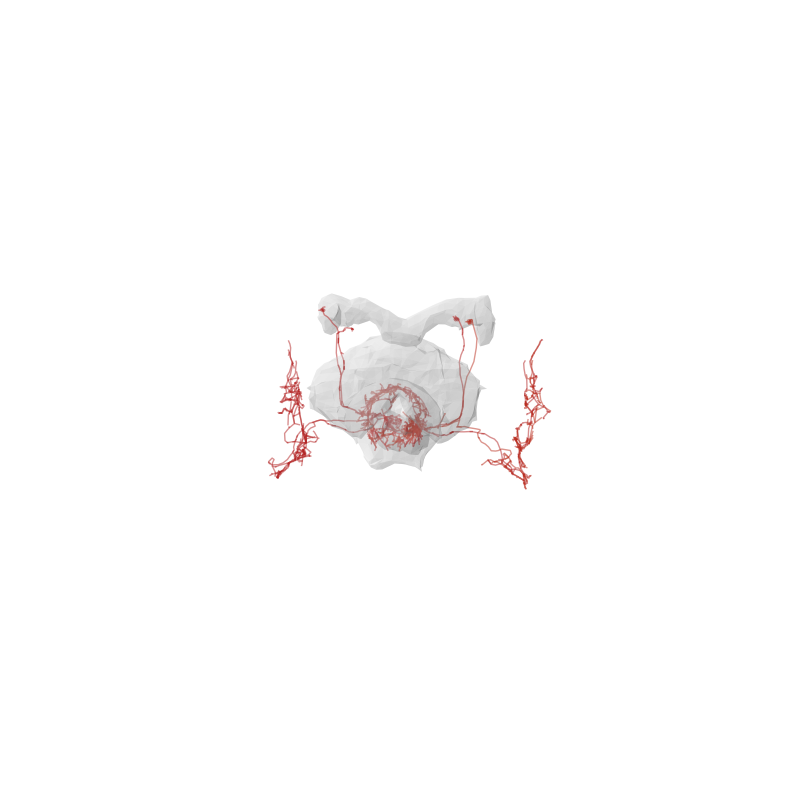

Layer 3 | hDeltaL | 0.046024866896516435


Fetching L2 skeletons:   0%|          | 0/12 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/12 [00:00<?, ?it/s]

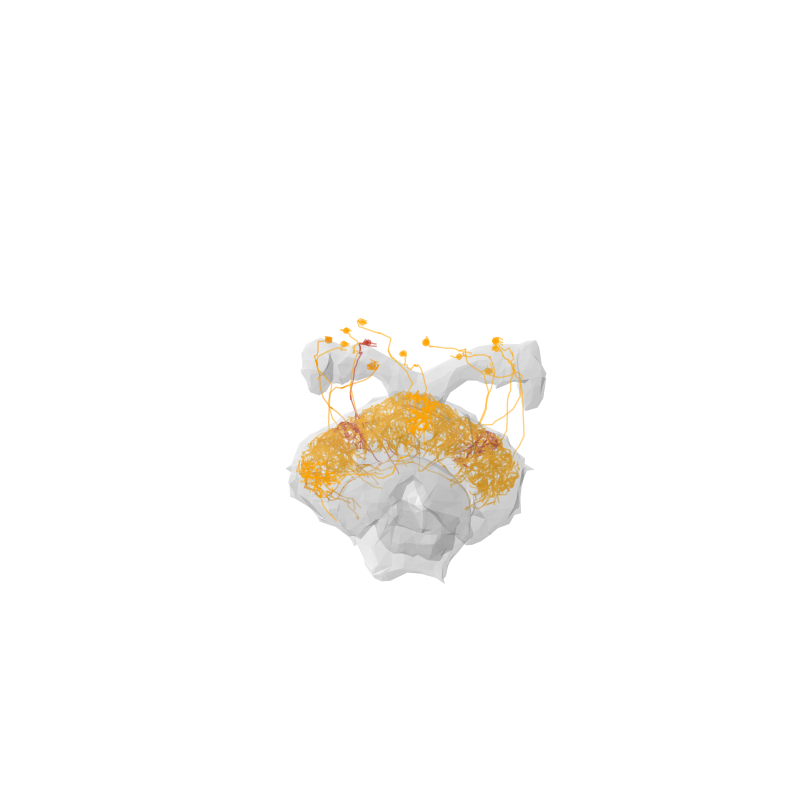

Layer 3 | ER4m | 0.04545251359717655


Fetching L2 skeletons:   0%|          | 0/11 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/11 [00:00<?, ?it/s]

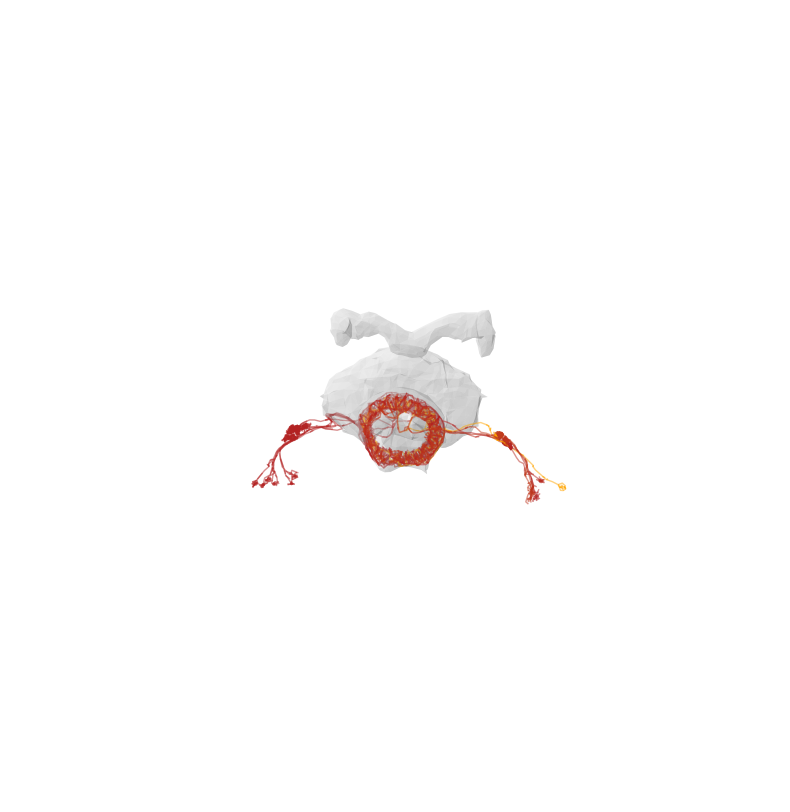

Layer 3 | ExR5 | 0.04725595202709743


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

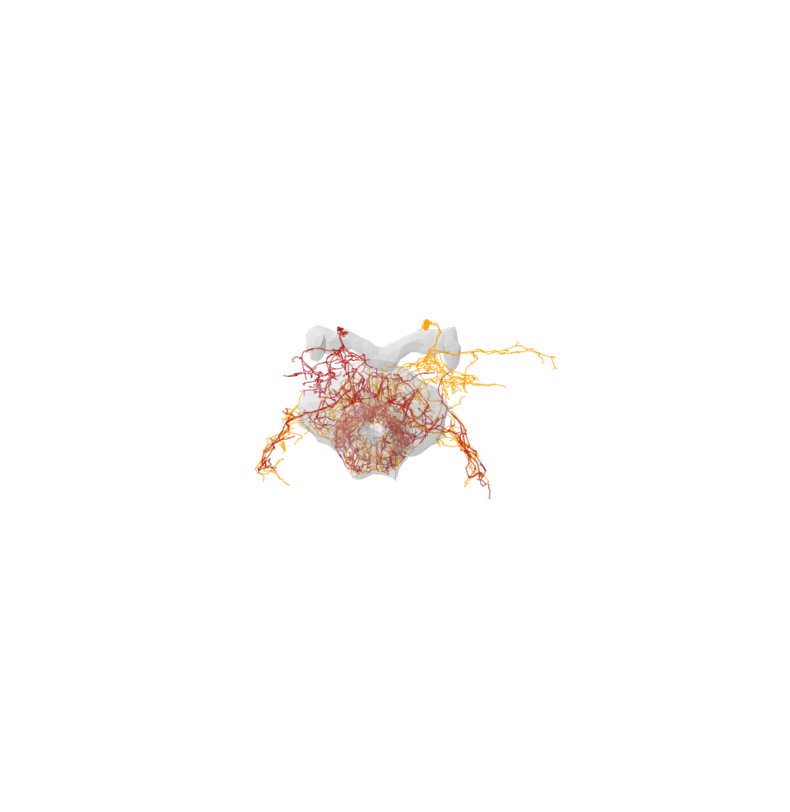

Layer 3 | P6-8P9 | 0.048065873516448476


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

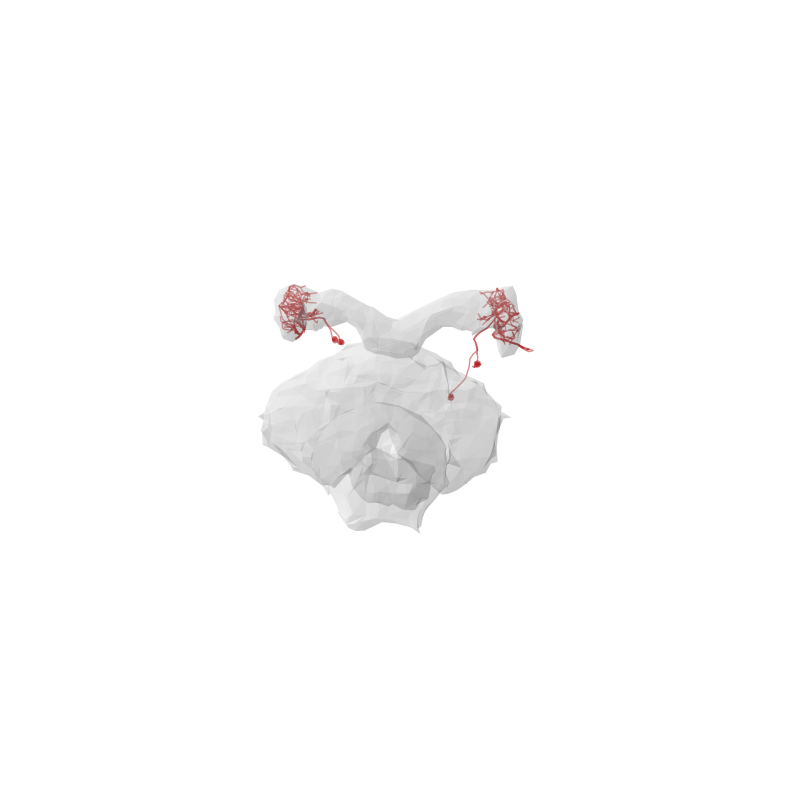

Layer 3 | hDeltaM | 0.045707523088693976


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

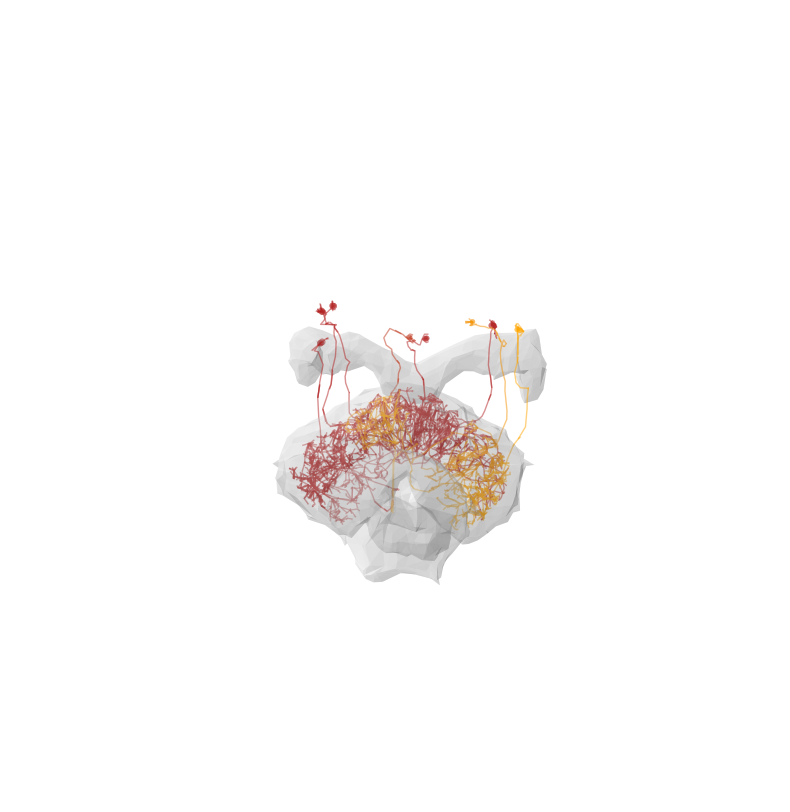

Layer 3 | EPG | 0.04526642392275239


Fetching L2 skeletons:   0%|          | 0/47 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/47 [00:00<?, ?it/s]

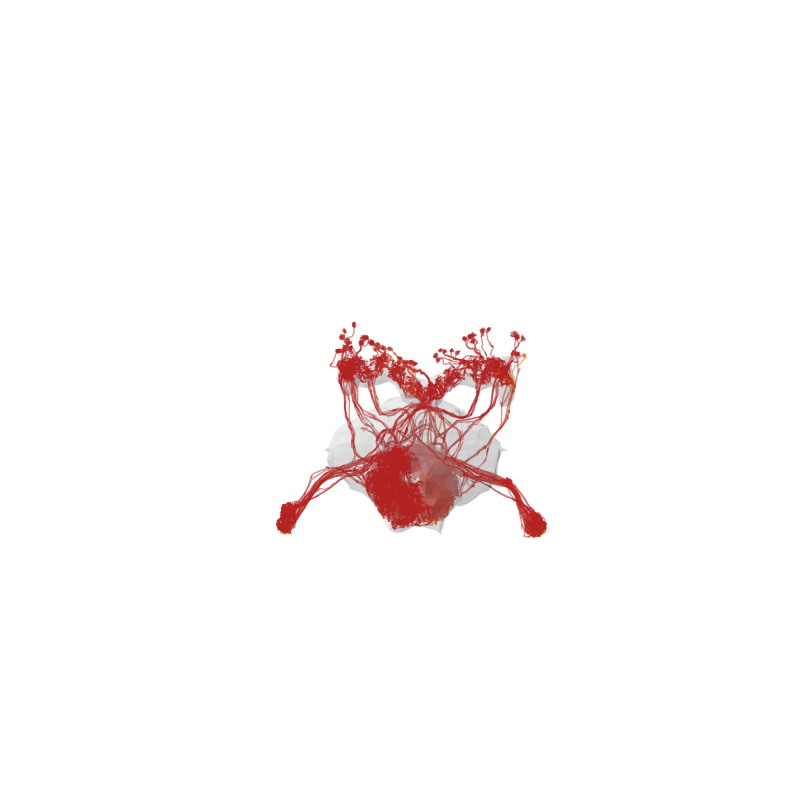

Layer 3 | PEN_a(PEN1) | 0.04698292034813103


Fetching L2 skeletons:   0%|          | 0/20 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/20 [00:00<?, ?it/s]

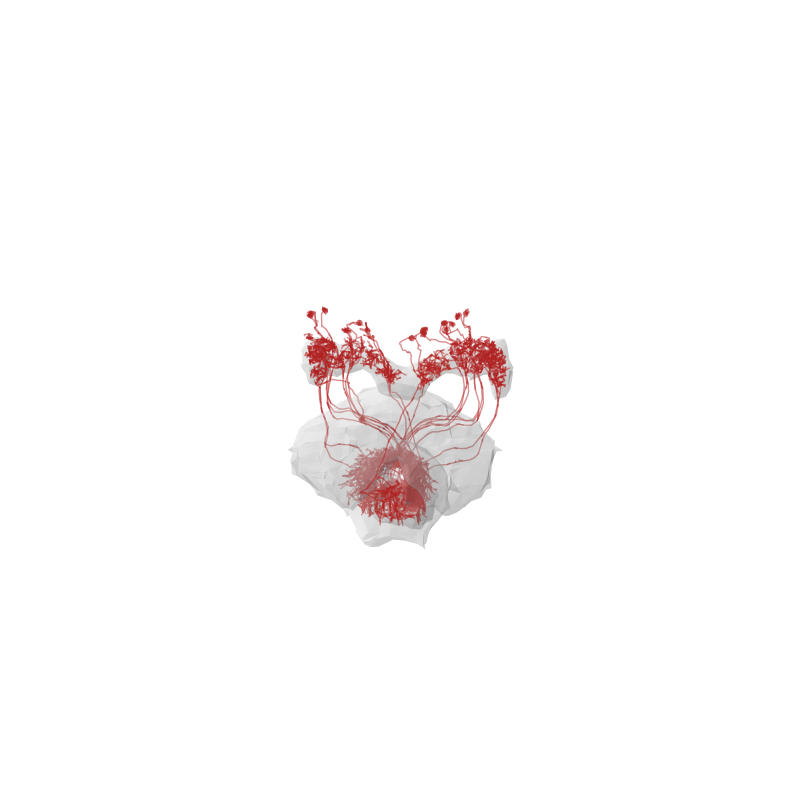

Layer 3 | FR1 | 0.04354181397970032


Fetching L2 skeletons:   0%|          | 0/18 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/18 [00:00<?, ?it/s]

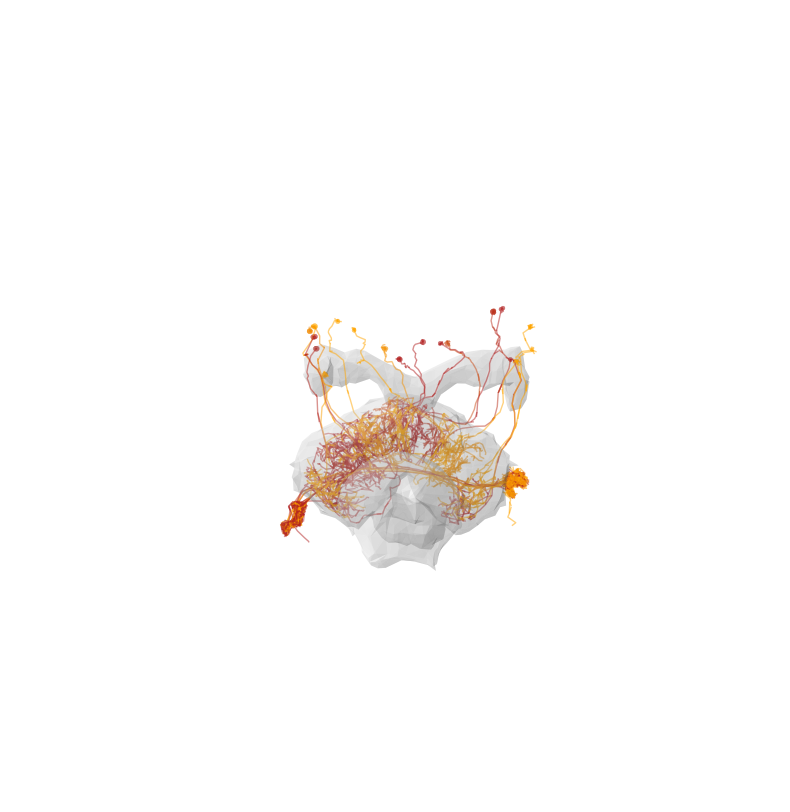

Layer 3 | PFGs | 0.04400892147550037


Fetching L2 skeletons:   0%|          | 0/24 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/24 [00:00<?, ?it/s]

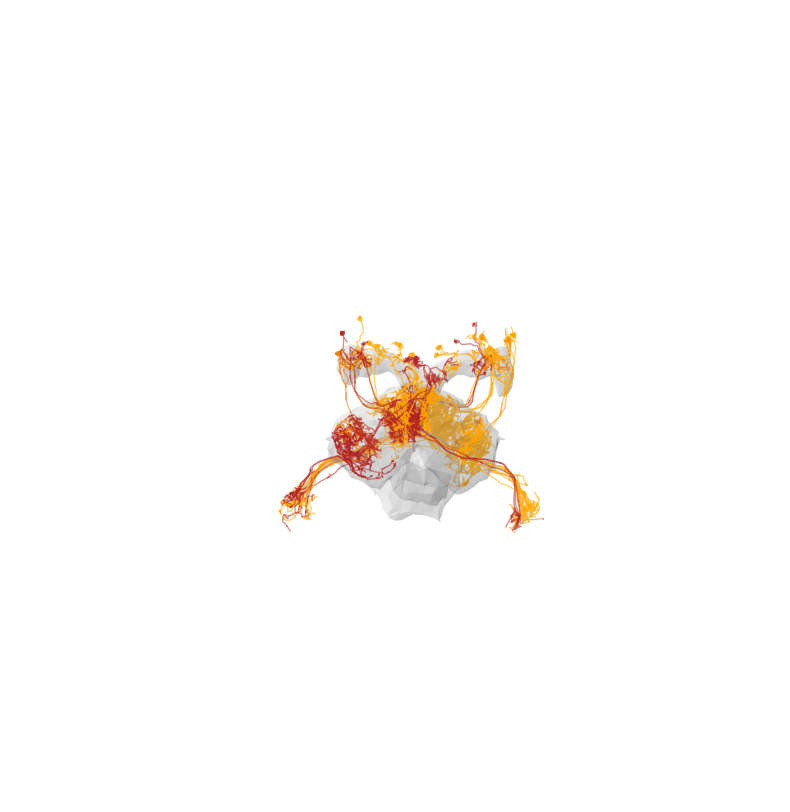

Layer 3 | PFNa | 0.042808202506904376


Fetching L2 skeletons:   0%|          | 0/55 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/55 [00:00<?, ?it/s]

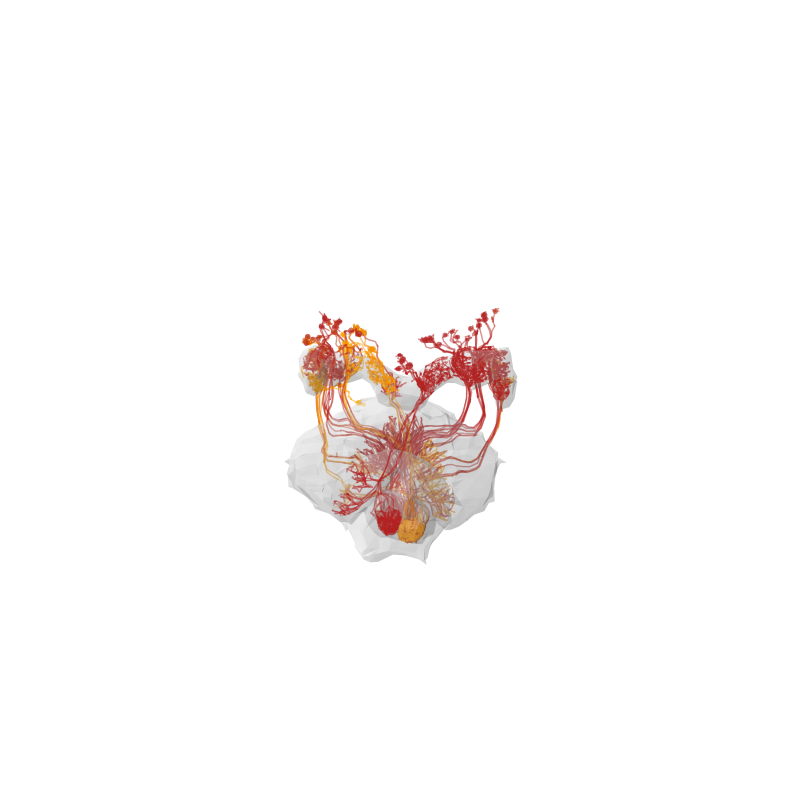

Layer 3 | IbSpsP | 0.04334130597467027


Fetching L2 skeletons:   0%|          | 0/30 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/30 [00:00<?, ?it/s]

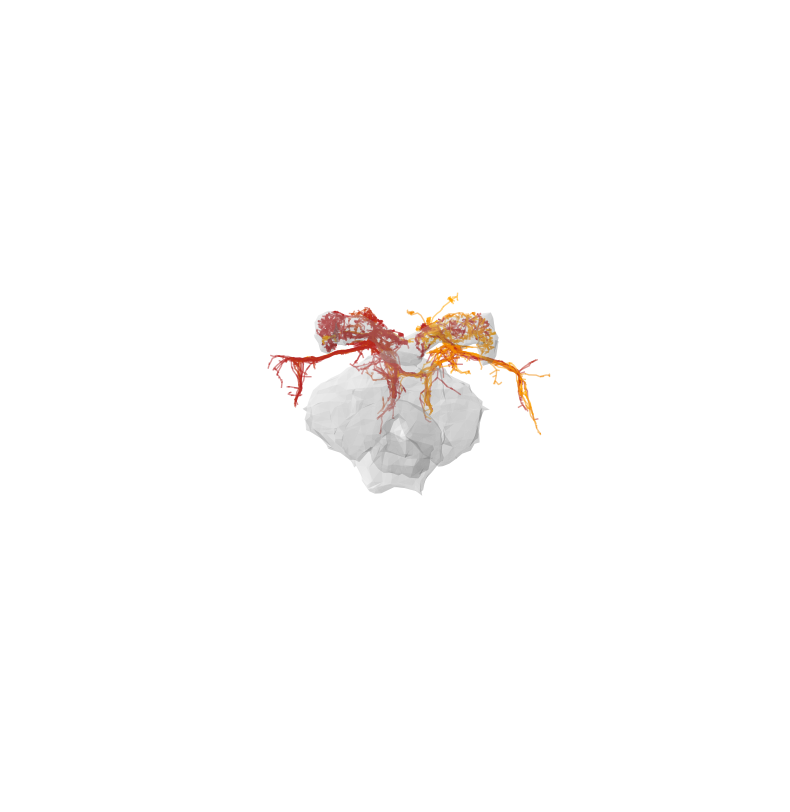

Layer 3 | PEG | 0.04379713303892086


Fetching L2 skeletons:   0%|          | 0/20 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/20 [00:00<?, ?it/s]

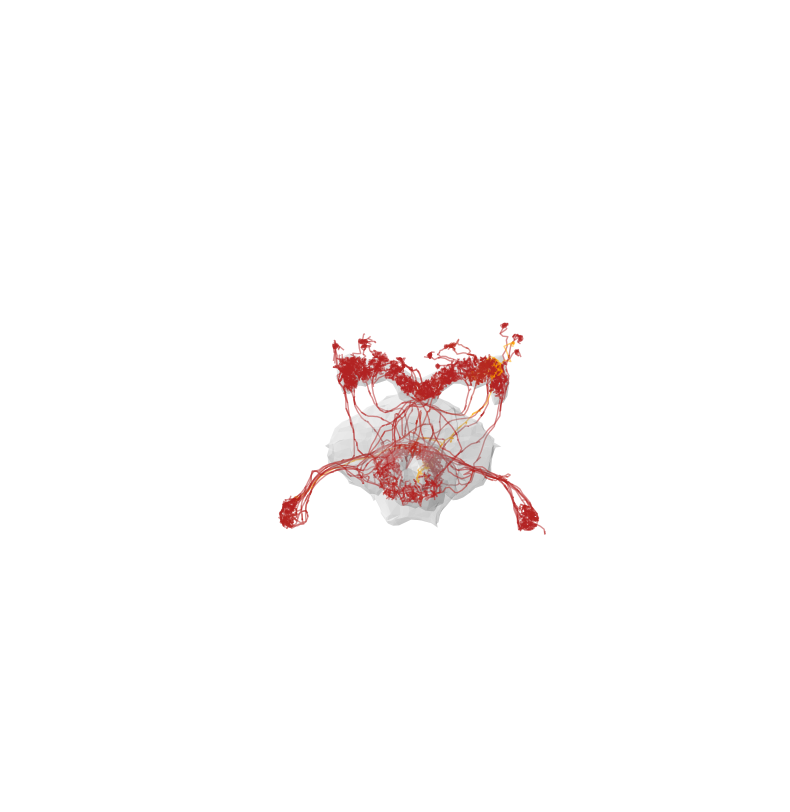

Layer 3 | GLNO | 0.04384347692538611


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

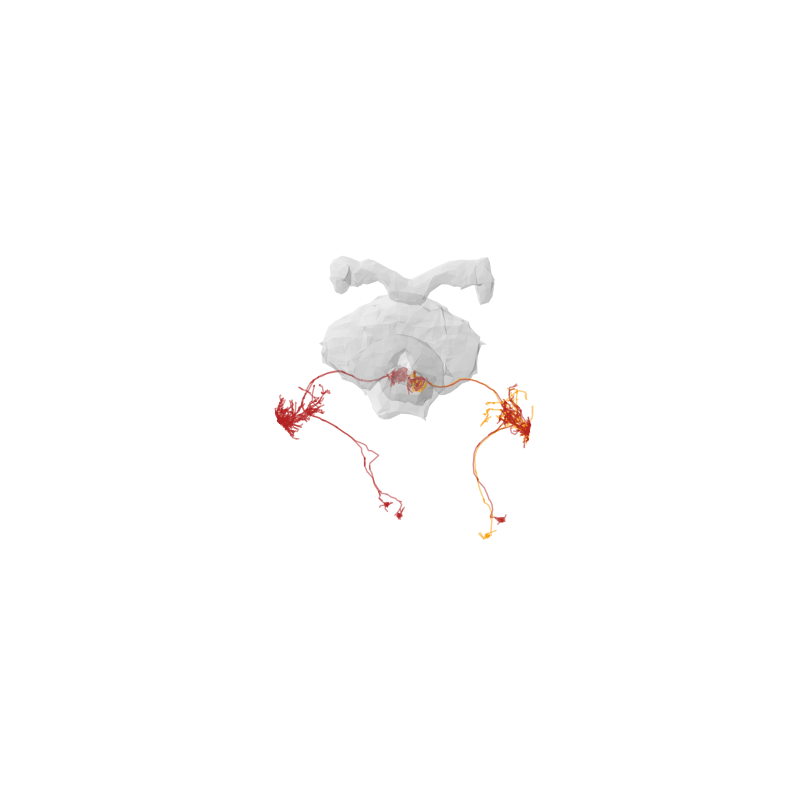

Layer 3 | hDeltaB | 0.043507193119706106


Fetching L2 skeletons:   0%|          | 0/18 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/18 [00:00<?, ?it/s]

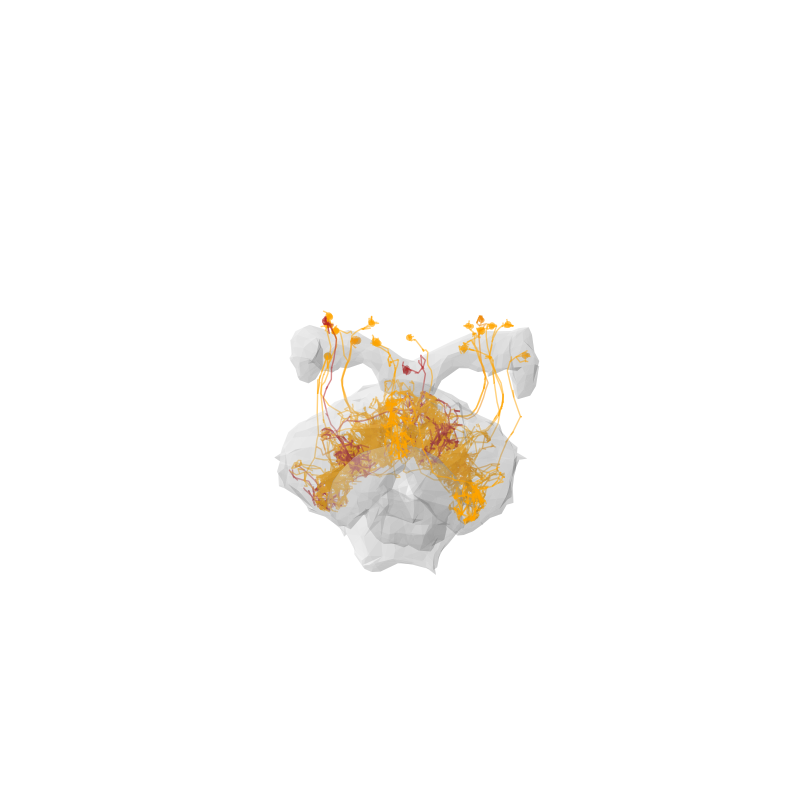

Layer 3 | PFNd | 0.041801832148049764


Fetching L2 skeletons:   0%|          | 0/40 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/40 [00:00<?, ?it/s]

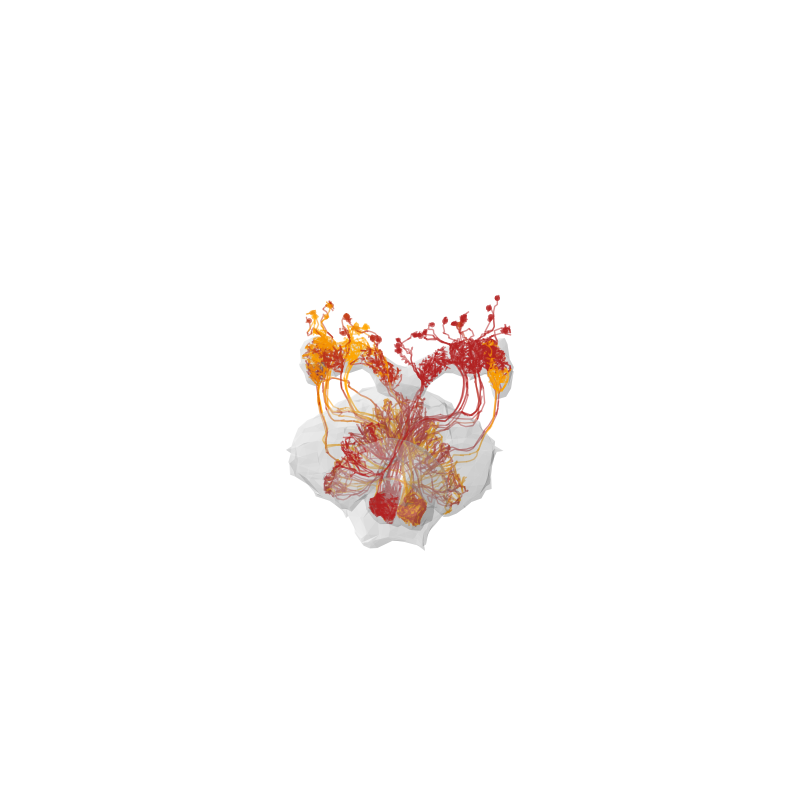

Layer 3 | PEN_b(PEN2) | 0.04357506995725928


Fetching L2 skeletons:   0%|          | 0/22 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/22 [00:00<?, ?it/s]

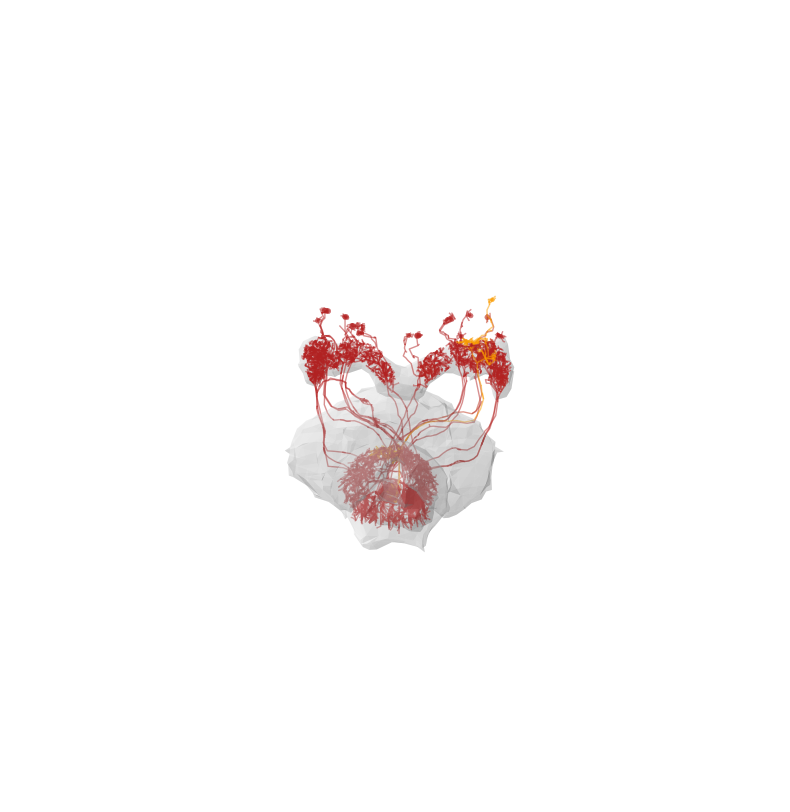

Layer 3 | CB.FB6B1 | 0.04161073878755956


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

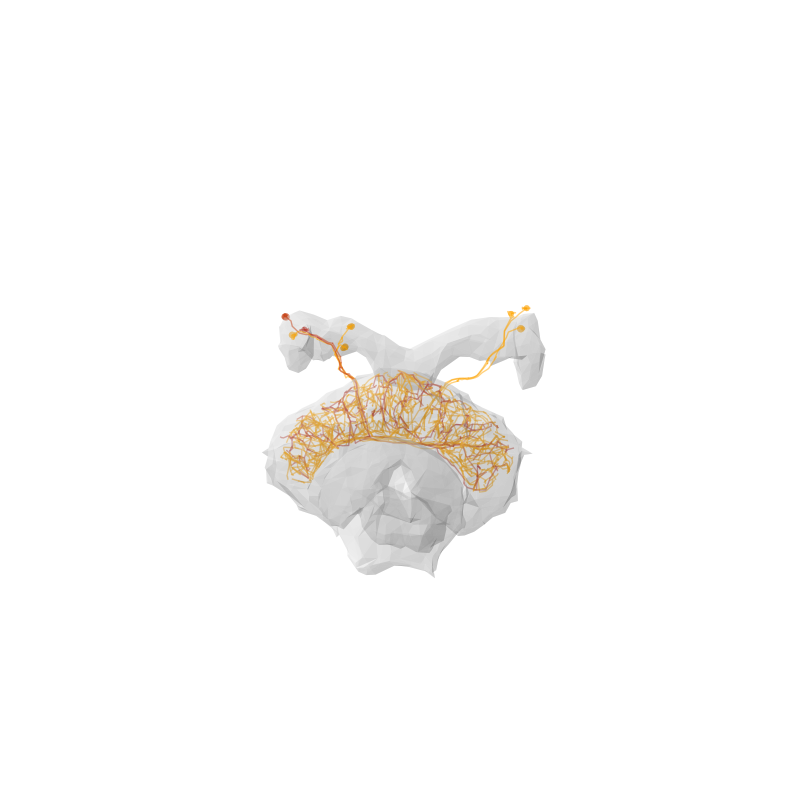

Layer 3 | EPGt | 0.043707963401990346


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

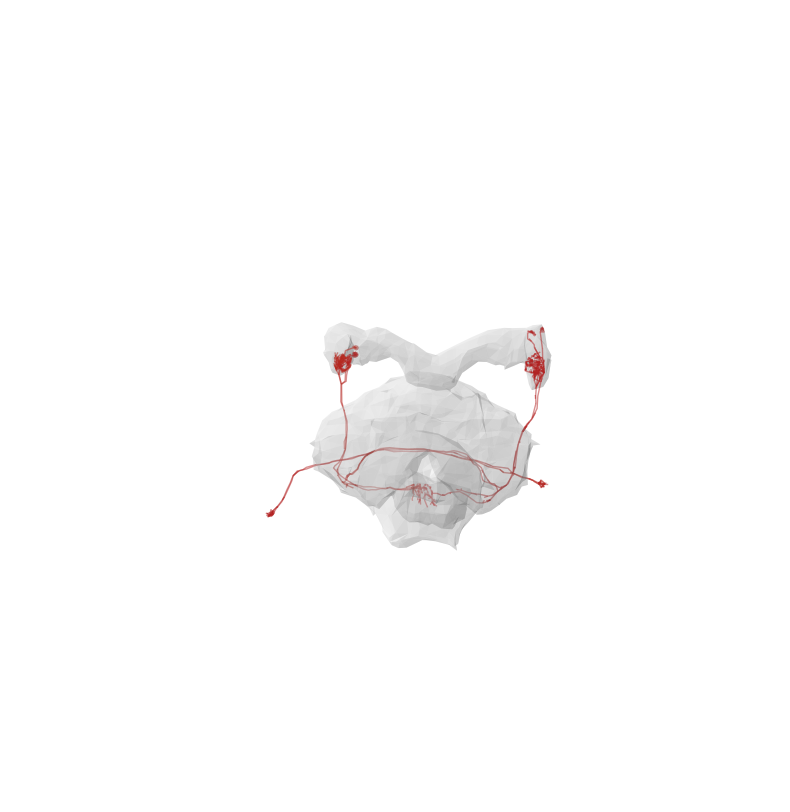

Layer 3 | PFR | 0.039420571024580936


Fetching L2 skeletons:   0%|          | 0/30 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/30 [00:00<?, ?it/s]

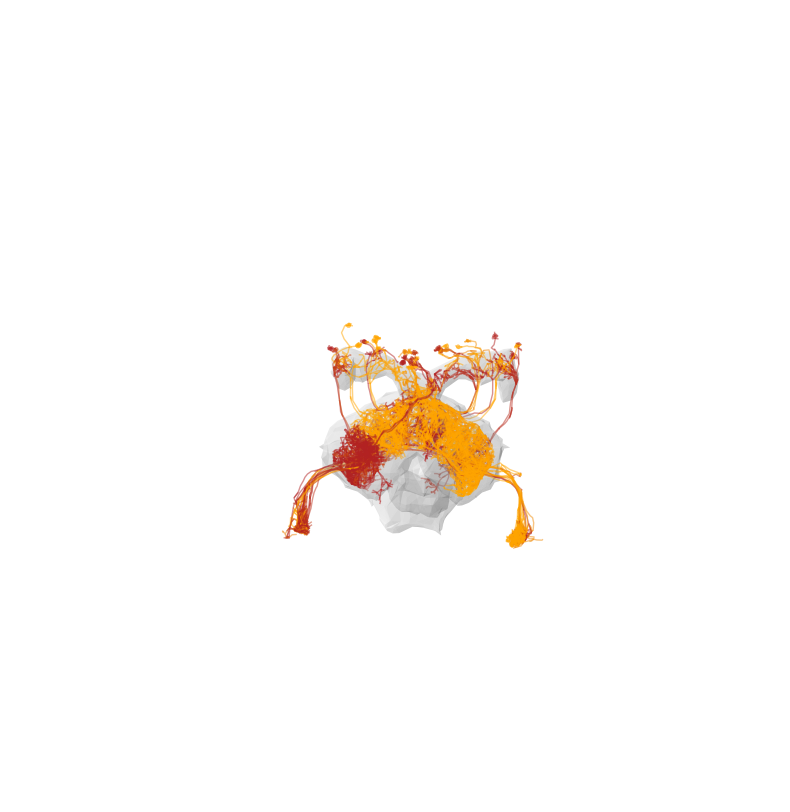

Layer 3 | FB7J | 0.03894599410111282


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

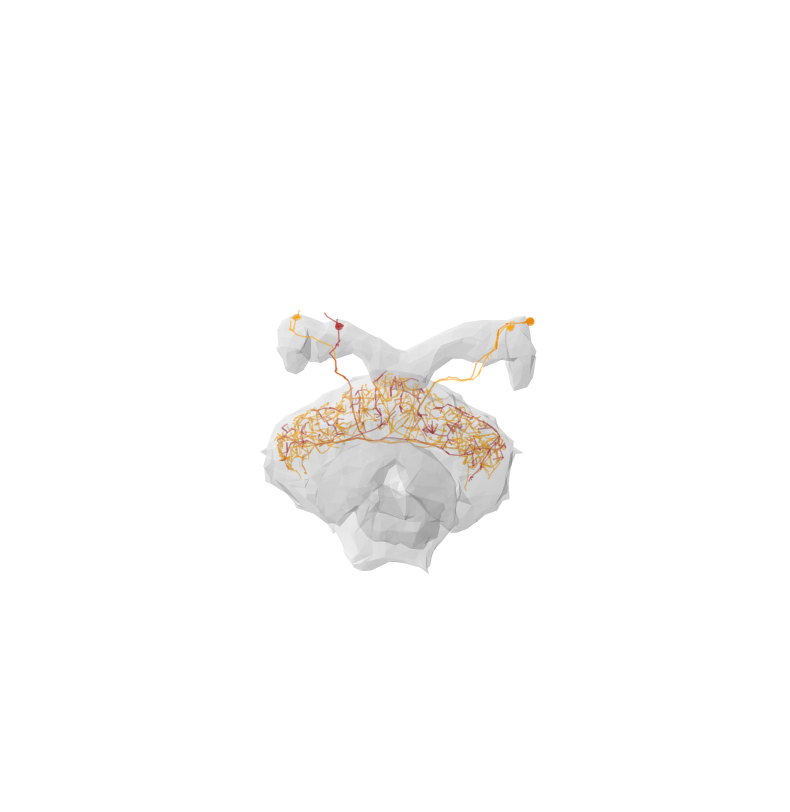

Layer 3 | LPsP | 0.04043730708401887


Fetching L2 skeletons:   0%|          | 0/2 [00:00<?, ?it/s]

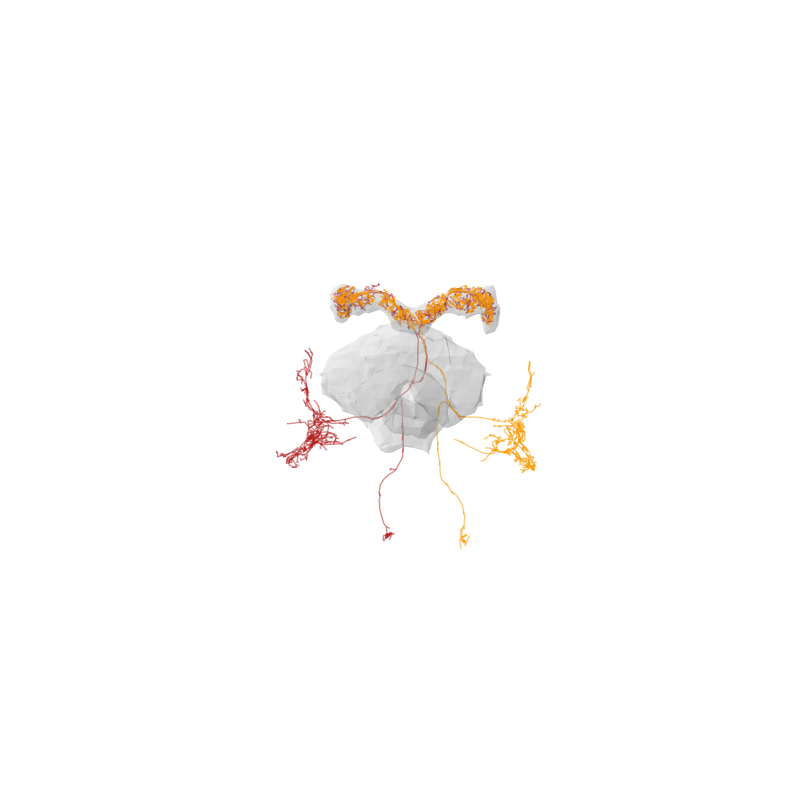

Layer 3 | hDeltaE | 0.03947094705861605


Fetching L2 skeletons:   0%|          | 0/8 [00:00<?, ?it/s]

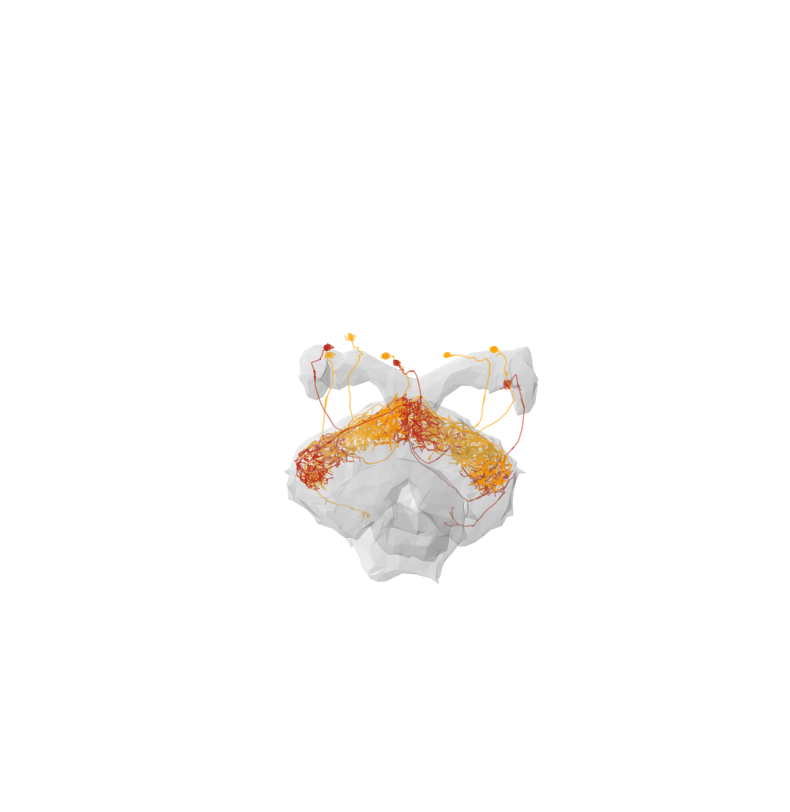

Layer 3 | ER6 | 0.037445815655144356


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

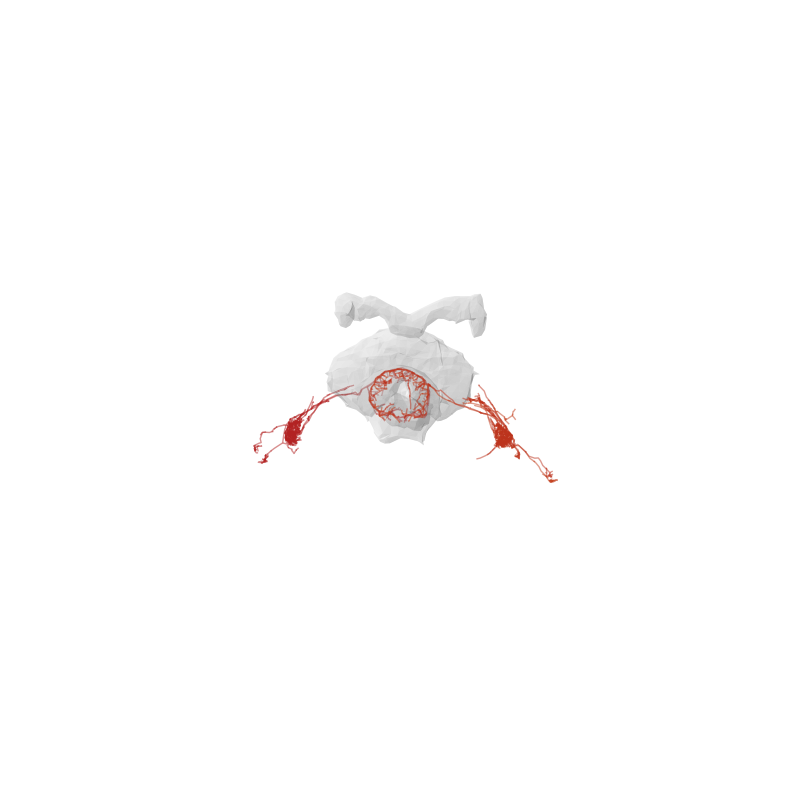

Layer 3 | PFL2 | 0.036277554411660744


Fetching L2 skeletons:   0%|          | 0/12 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/12 [00:00<?, ?it/s]

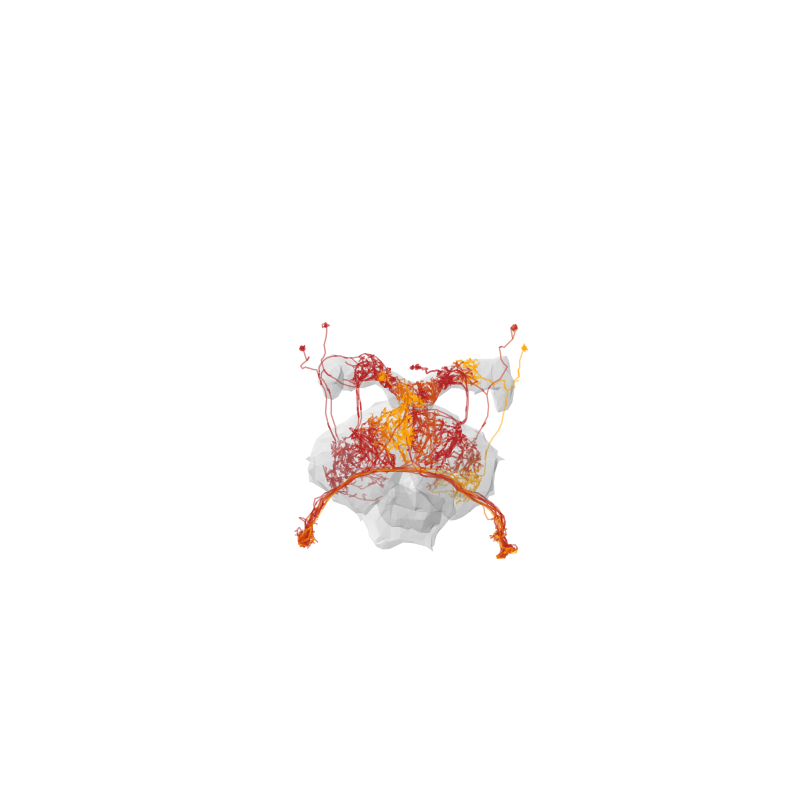

Layer 3 | PFL3 | 0.03639489877431074


Fetching L2 skeletons:   0%|          | 0/24 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/24 [00:00<?, ?it/s]

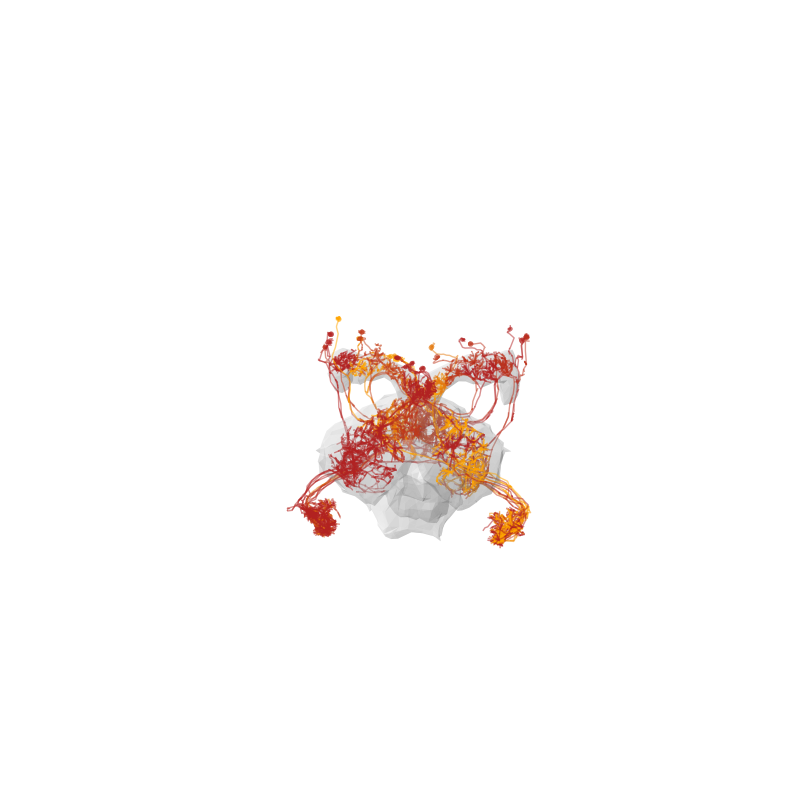

Layer 3 | ER2 | 0.03368695005236043


Fetching L2 skeletons:   0%|          | 0/41 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/41 [00:00<?, ?it/s]

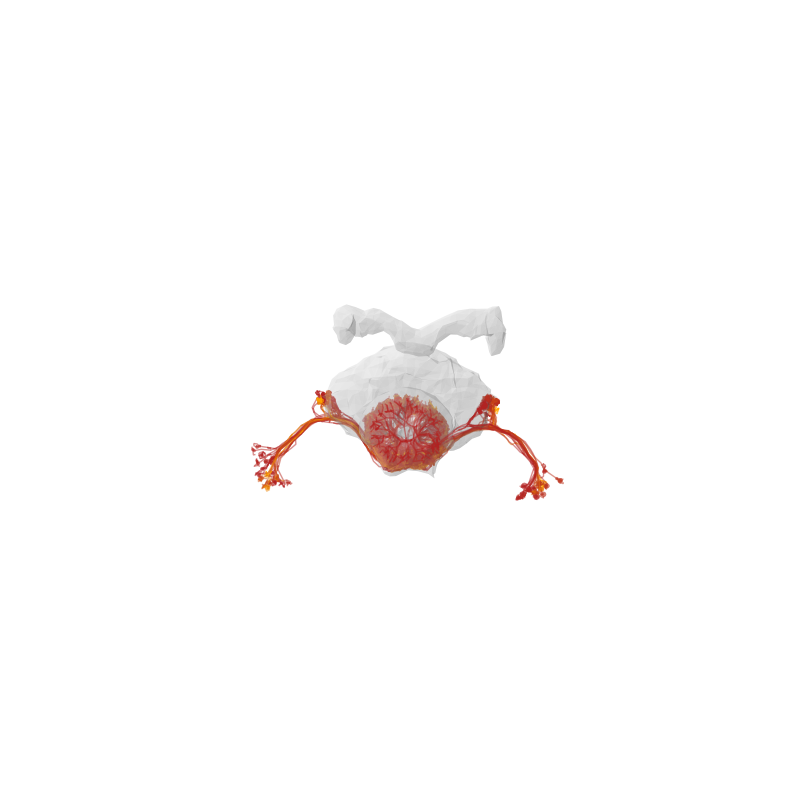

Layer 3 | EL | 0.03489391695973903


Fetching L2 skeletons:   0%|          | 0/17 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/17 [00:00<?, ?it/s]

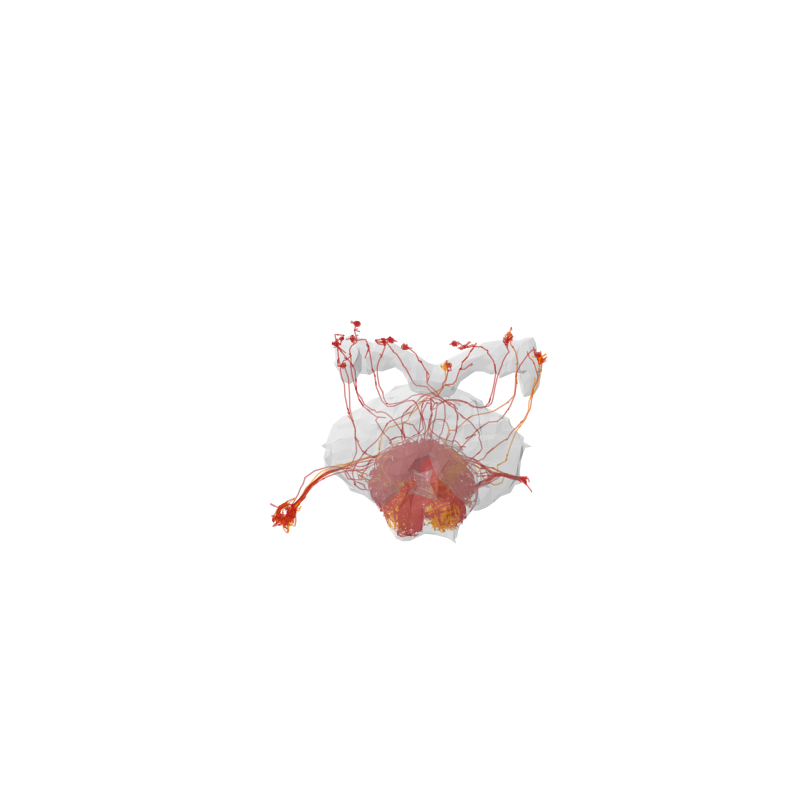

Layer 3 | FB3A | 0.033257043075210595


Fetching L2 skeletons:   0%|          | 0/4 [00:00<?, ?it/s]

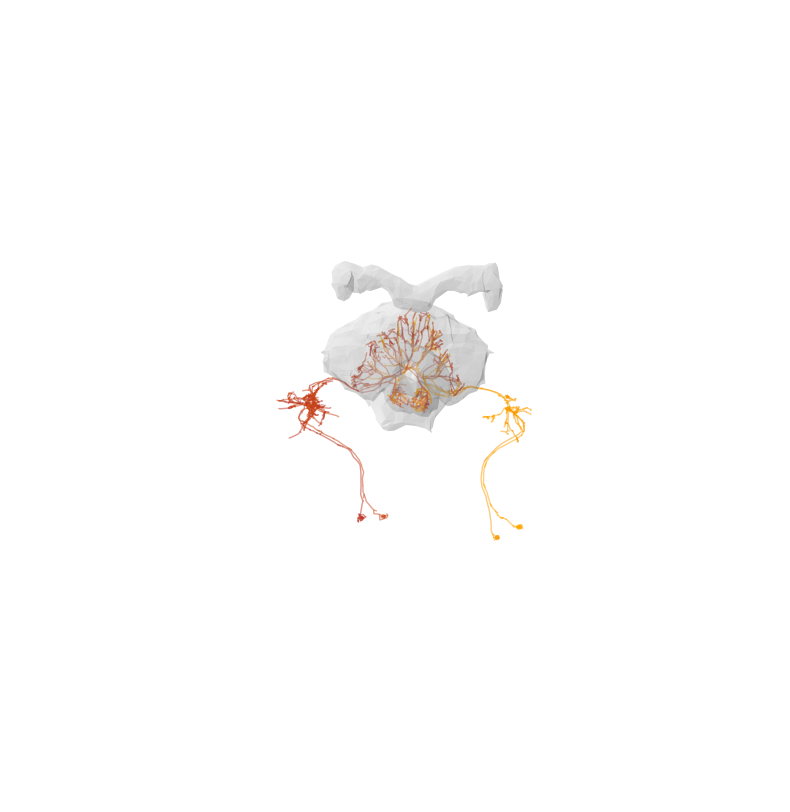

Layer 3 | FB4Z | 0.03433769182027336


Fetching L2 skeletons:   0%|          | 0/16 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/16 [00:00<?, ?it/s]

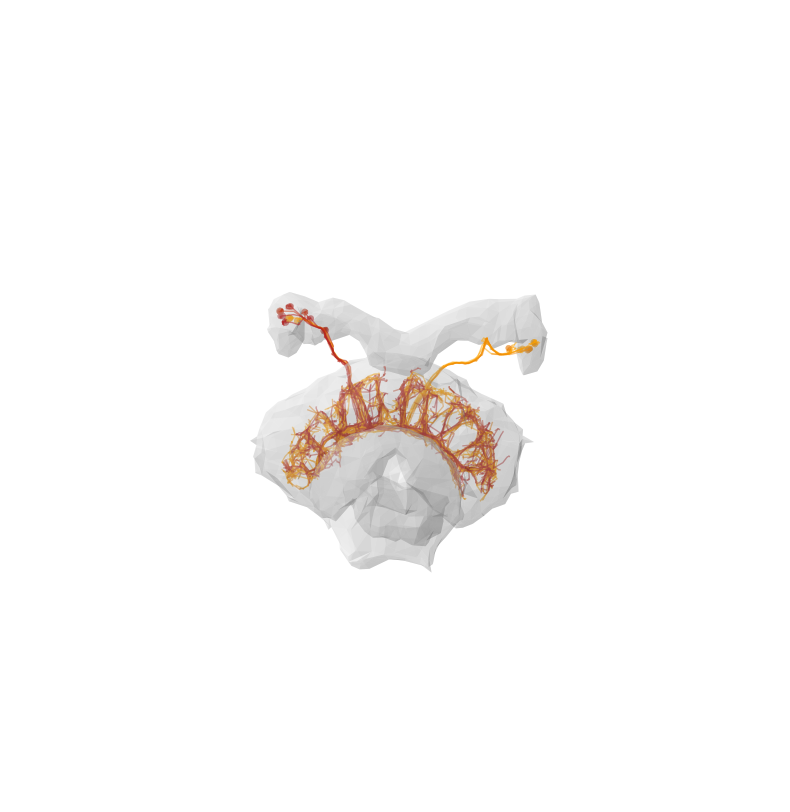

Layer 3 | ER3m | 0.03362861675815621


Fetching L2 skeletons:   0%|          | 0/16 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/16 [00:00<?, ?it/s]

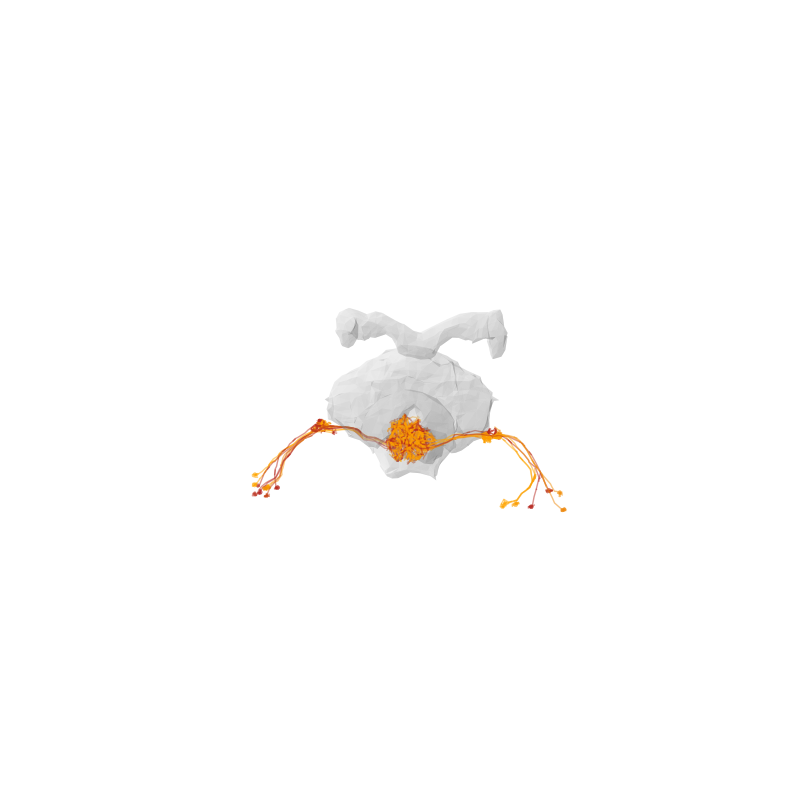

Layer 3 | ER3d | 0.03347584075920763


Fetching L2 skeletons:   0%|          | 0/51 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/51 [00:00<?, ?it/s]

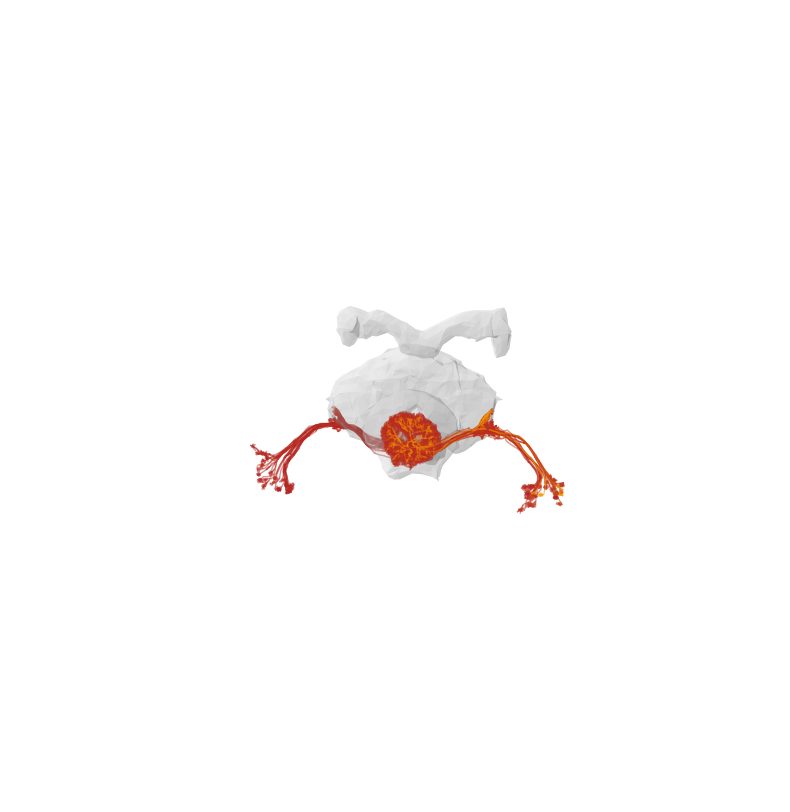

Layer 3 | ER3w | 0.03162822291024534


Fetching L2 skeletons:   0%|          | 0/25 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/25 [00:00<?, ?it/s]

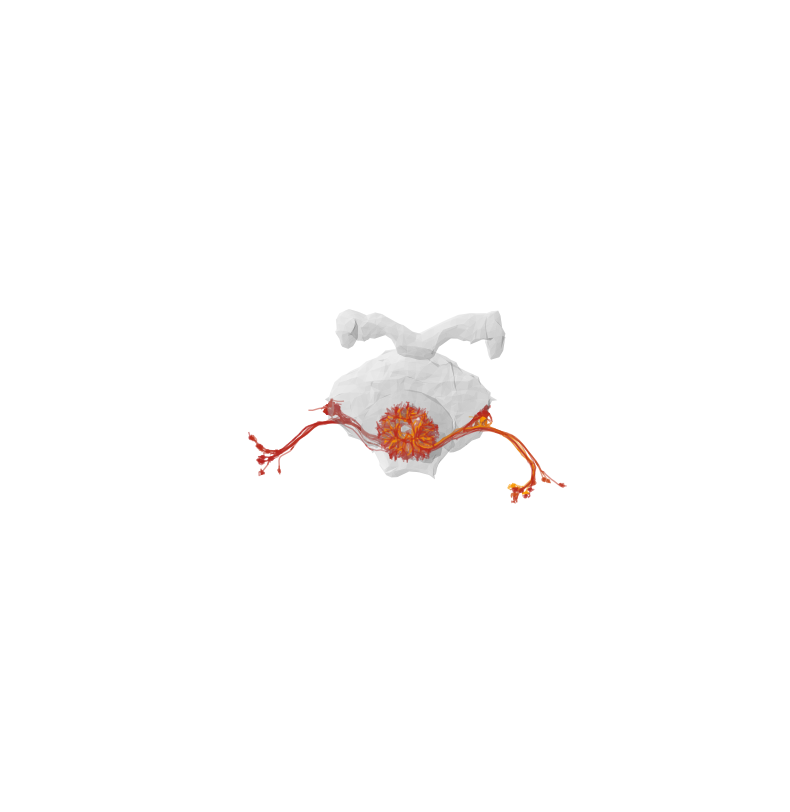

Layer 3 | ER5 | 0.032193555632724545


Fetching L2 skeletons:   0%|          | 0/21 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/21 [00:00<?, ?it/s]

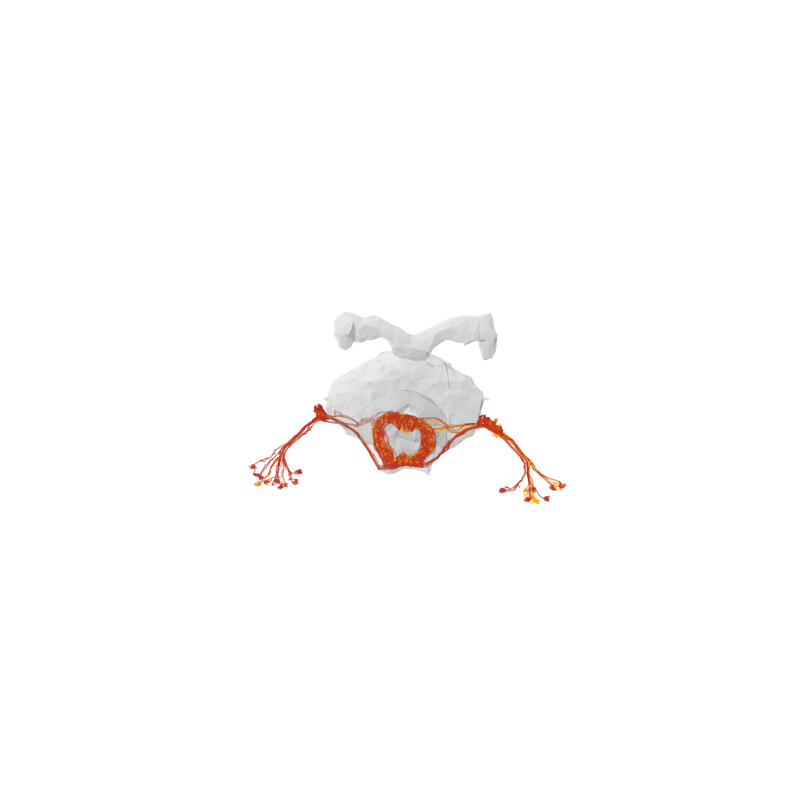

Layer 3 | CB.FB7B0 | 0.03170584728302282


Fetching L2 skeletons:   0%|          | 0/5 [00:00<?, ?it/s]

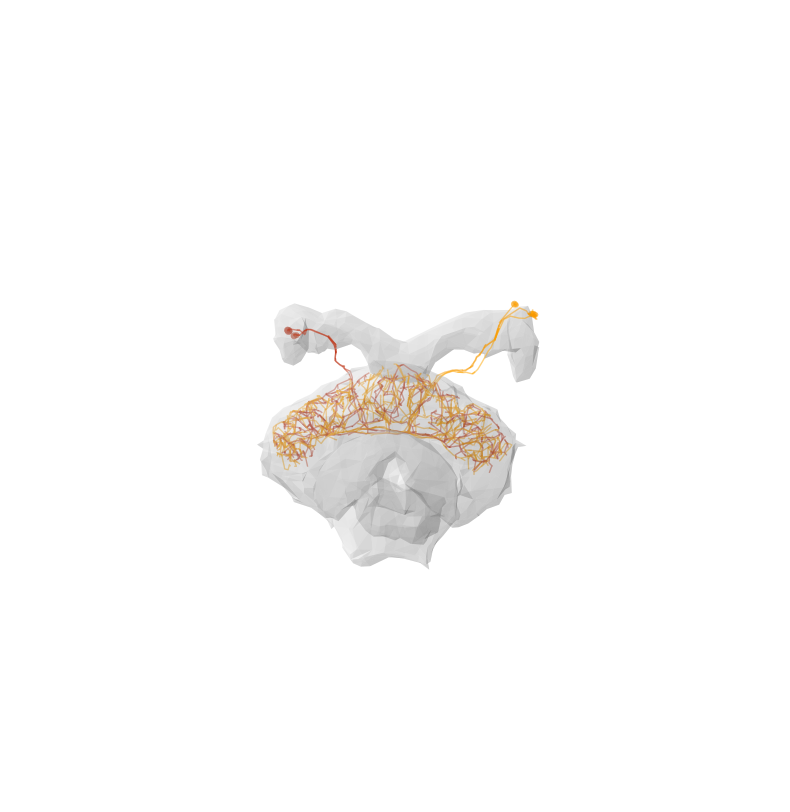

Layer 3 | ER3p | 0.030896976969697575


Fetching L2 skeletons:   0%|          | 0/17 [00:00<?, ?it/s]

Plot neurons:   0%|          | 0/17 [00:00<?, ?it/s]

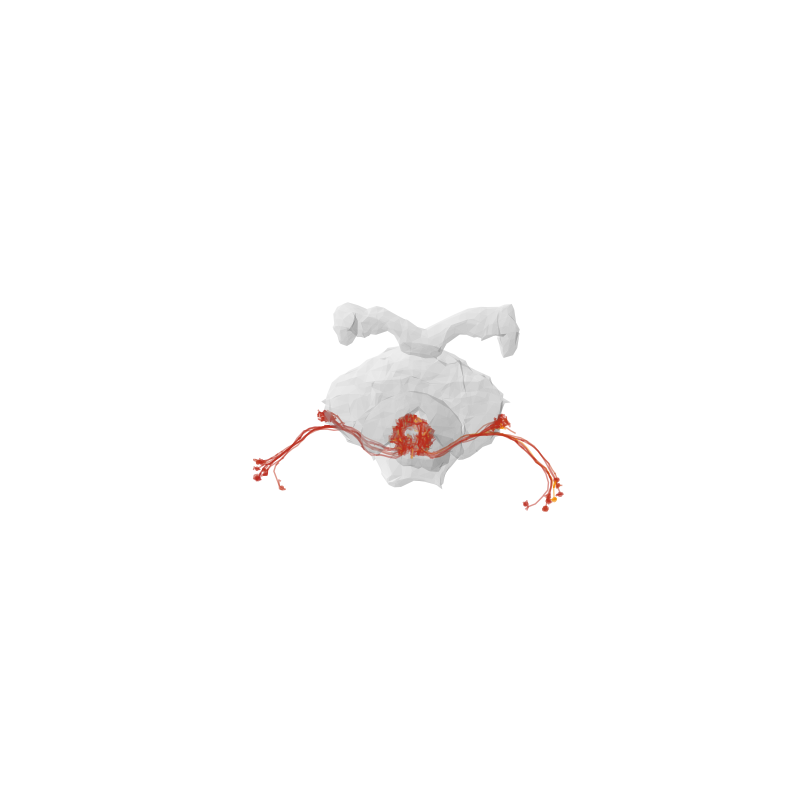

In [296]:
# investigate a single class in the form of cell types anatomically
top_n = np.inf
layer_no = 3
class_to_investigate = 'CX'

neurons = layers[layer_no]
values = lateralizations[layer_no]
classes = layer_classes[layer_no]

# filter out the neurons that are not of the class
class_mask = [c == class_to_investigate for c in classes]
class_mask = np.array(class_mask)

neurons = neurons[class_mask]
values = values[class_mask]
# get the cell types applying the neuron dictionary if available
cell_type = [get_cell_type(n) for n in neurons]
cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

# get the unique cell types
unique_cell_types = np.unique(cell_types)
n_cell_types = len(unique_cell_types)
cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}


cell_type_ids = [cell_type_to_index[c] for c in cell_types]
cell_type_ids = np.array(cell_type_ids)

# get average lateralization for each cell type
cell_type_values = np.zeros(n_cell_types)
for i in range(n_cell_types):
    cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else 0
# sort the cell types by average lateralization
sorted_indices = np.argsort(cell_type_values)[::-1]

# keep only the top N cell types
sorted_indices = sorted_indices[:int(np.min([top_n, len(sorted_indices)]))]

for i, idx in enumerate(sorted_indices):
    # get the values for the class
    cell_type_values = np.power(np.abs(values[cell_type_ids == idx]),1/layer_no)*np.sign(values[cell_type_ids == idx])
    print('Layer {} | {} | {}'.format(layer_no, index_to_cell_type[idx], np.mean(np.abs(cell_type_values))))
    # get the skeletons
    cell_type_neurons = neurons[cell_type_ids == idx]
    cell_type_skeletons = get_skeletons_by_root_id(cell_type_neurons)
    # plot the skeletons
    plot_skeletons_with_values(
        cell_type_skeletons, cell_type_values, cm_ofb, vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),
        azimuth=-85,
        elevation=-45,
        show_flywire=False,
        neuron_width=1,
        title='Layer {} | {}'.format(layer_no, index_to_cell_type[idx]),
        show_cx=True,
    )
    


In [ ]:
layer_classes = [[get_neuron_class(n) for n in tqdm(layer)] for layer in layers]

  0%|          | 0/685 [00:00<?, ?it/s]

  0%|          | 0/20060 [00:00<?, ?it/s]

  0%|          | 0/99016 [00:00<?, ?it/s]

  0%|          | 0/135199 [00:00<?, ?it/s]

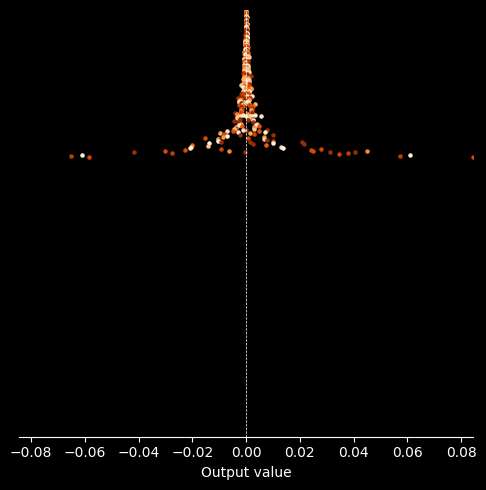

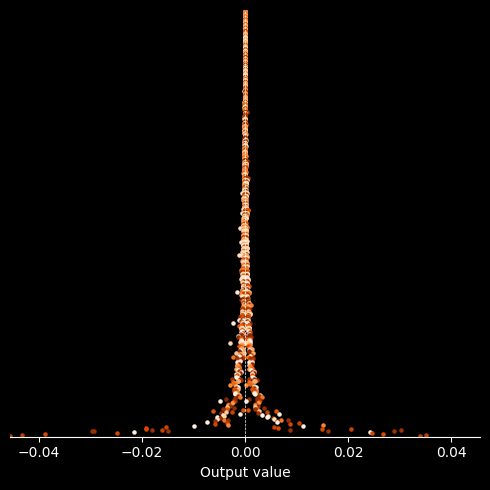

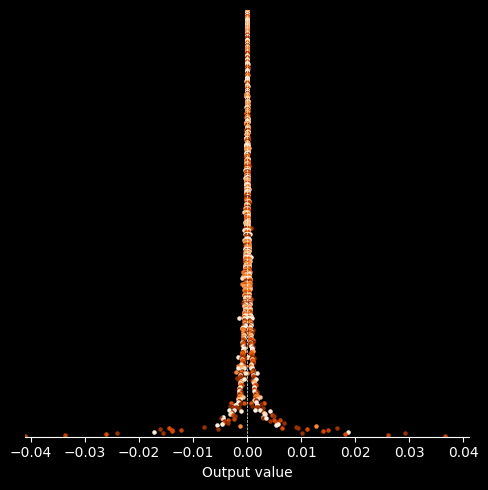

In [21]:
# investigate a single class in the form of cell types
for class_to_investigate in ['other descending']:
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}



    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else np.inf
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,5))
        for i, idx in enumerate(sorted_indices):
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            # plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.abs(values))
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

In [138]:
def subnetwork_effect_propagate(input_root_ids, input_values, exclude_downstream=None, min_synapse_count=1):
    # find all downstream connections
    downstream_connections = connections[connections['pre_root_id'].isin(input_root_ids)].copy().reset_index(drop=True)
    if exclude_downstream is not None:
        # remove excluded downstream neurons
        downstream_connections = downstream_connections[np.logical_not(downstream_connections['post_root_id'].isin(exclude_downstream))]
    # find all downstream neurons
    downstream_neurons = np.unique(downstream_connections['post_root_id'])
    # create a mapping from root id to index
    root_to_input = {r:i for i,r in enumerate(input_root_ids)}
    root_to_output = {r:i for i,r in enumerate(downstream_neurons)}
    # create a connectivity matrix
    connection_matrix = np.zeros((len(downstream_neurons), len(input_root_ids)))
    # fill the matrix
    for i in tqdm(downstream_connections.index):
        pre_id = downstream_connections.loc[i, 'pre_root_id']
        post_id = downstream_connections.loc[i, 'post_root_id']
        pre_index = root_to_input[pre_id]
        post_index = root_to_output[post_id]
        connection_matrix[post_index, pre_index] += downstream_connections.loc[i, 'syn_count'] if downstream_connections.loc[i, 'syn_count'] > min_synapse_count else 0
    # propagate the values
    output_values = np.dot(connection_matrix, input_values)
    # get the maximum value possible by summing all synapse counts
    max_value = np.sum(connection_matrix, axis=1)
    # normalize the output values
    output_values = output_values / max_value
    # mixing strength (variance of the inputs received by each neuron)
    mixing_strength = np.std(connection_matrix*input_values, axis=1)
    # if any output value is nan, remove those neurons
    nan_mask = np.isnan(output_values)
    downstream_neurons = downstream_neurons[np.logical_not(nan_mask)]
    output_values = output_values[np.logical_not(nan_mask)]
    mixing_strength = mixing_strength[np.logical_not(nan_mask)]
    return downstream_neurons, output_values, mixing_strength

In [186]:
recalculate = False

In [187]:
input_values = PNs['antennal_input_asymmetry'].values

N_steps = 3
exclude_visited = False

layers = []
lateralizations = []
mixing_strengths = []

visited_neurons = np.array([])

output_values = input_values
downstream_neurons = PNs['root_id'].values
mixing_strength = np.zeros(len(downstream_neurons))

for i in range(N_steps):
    layers.append(downstream_neurons)
    lateralizations.append(output_values)
    mixing_strengths.append(mixing_strength)

    if exclude_visited:
        # add the downstream neurons to the visited neurons
        visited_neurons = np.concatenate((visited_neurons, downstream_neurons))
        # make sure the visited neurons are unique
        visited_neurons = np.unique(visited_neurons)

    print('Step', i, end=': ')
    if os.path.exists(os.path.join(processed_data_folder, 'ALPN_connectivity/SEP_ALPN_downstream_neurons_step_{}.npy'.format(i))) and not recalculate:
        print('Data exists. Loading... ', end='')
        output_values = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/SEP_ALPN_output_values_step_{}.npy'.format(i)))
        downstream_neurons = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/SEP_ALPN_downstream_neurons_step_{}.npy'.format(i)))
        mixing_strength = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/SEP_ALPN_mixing_strength_step_{}.npy'.format(i)))
        print('N={}'.format(len(downstream_neurons)), end=' ')
        print('Done.')
    else:
        print('Propagating... ', end='')
        downstream_neurons, output_values, mixing_strength = subnetwork_effect_propagate(downstream_neurons, output_values, exclude_downstream=visited_neurons if exclude_visited else None, min_synapse_count=0)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/SEP_ALPN_output_values_step_{}.npy'.format(i)), output_values)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/SEP_ALPN_downstream_neurons_step_{}.npy'.format(i)), downstream_neurons)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/SEP_ALPN_mixing_strength_step_{}.npy'.format(i)), mixing_strength)
        print('N={}'.format(len(downstream_neurons)), end=' ')
        print('Done.')

# add the last step
layers.append(downstream_neurons)
lateralizations.append(output_values)
mixing_strengths.append(mixing_strength)


Step 0: Data exists. Loading... N=20060 Done.
Step 1: Data exists. Loading... N=99018 Done.
Step 2: Data exists. Loading... N=135231 Done.


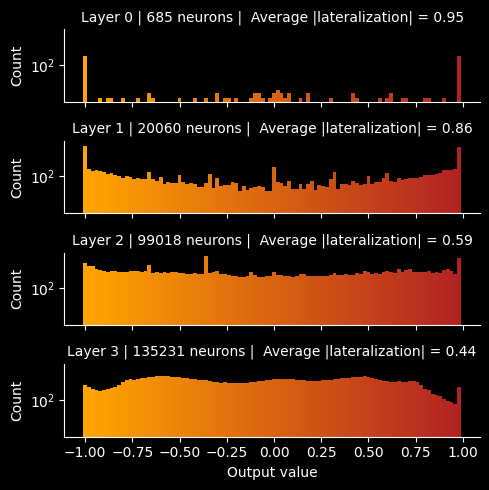

In [188]:
# plot the values (histogram) for each step
fig,ax = plt.subplots(N_steps+1,1,figsize=(5,5), sharex=True, sharey=True)
for i in range(N_steps+1):
    bins, edges = np.histogram(lateralizations[i], bins=100)
    max_lateralization = np.max(np.abs(lateralizations[i]))
    ax[i].bar(edges[:-1], bins, width=np.diff(edges), color=cm_ofb(np.linspace(0.5-max_lateralization/2, 0.5+max_lateralization/2, 100)))
    ax[i].set_title('Layer {} | {} neurons |  Average |lateralization| = {:.2f}'.format(i, len(layers[i]), np.mean(np.abs(lateralizations[i]))), fontsize=10)
    ax[i].set_ylabel('Count')
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].set_yscale('log')
ax[N_steps].set_xlabel('Output value')
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/SEP_ALPN_connectivity.pdf'), bbox_inches='tight', dpi=300)
plt.show()

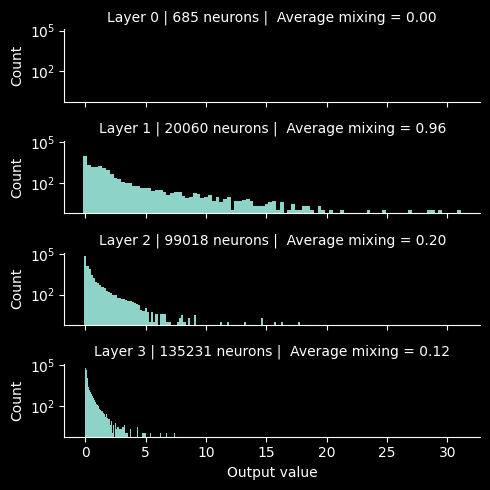

In [189]:
# plot the values (histogram) for each step
fig,ax = plt.subplots(N_steps+1,1,figsize=(5,5), sharex=True, sharey=True)
for i in range(N_steps+1):
    if np.all(mixing_strengths[i] == 0):
        bins, edges = np.histogram(mixing_strengths[i], bins=np.linspace(0, 0.01, 100))
    else:
        bins, edges = np.histogram(mixing_strengths[i], bins=100)
    max_lateralization = np.max(mixing_strengths[i])
    ax[i].bar(edges[:-1], bins, width=np.diff(edges))
    ax[i].set_title('Layer {} | {} neurons |  Average mixing = {:.2f}'.format(i, len(layers[i]), np.mean(mixing_strengths[i])), fontsize=10)
    ax[i].set_ylabel('Count')
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].set_yscale('log') 
ax[N_steps].set_xlabel('Output value')
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/SEP_ALPN_mixing.pdf'), bbox_inches='tight', dpi=300)
plt.show()

  0%|          | 0/20060 [00:00<?, ?it/s]

/var/folders/y6/xn2dyw2s14b79mrpmzrhykhc0000gn/T/ipykernel_16648/4157032492.py:34: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(class_values, -i + 0.2*np.random.randn(len(class_values)), c=cm_tab40(i), s=1)


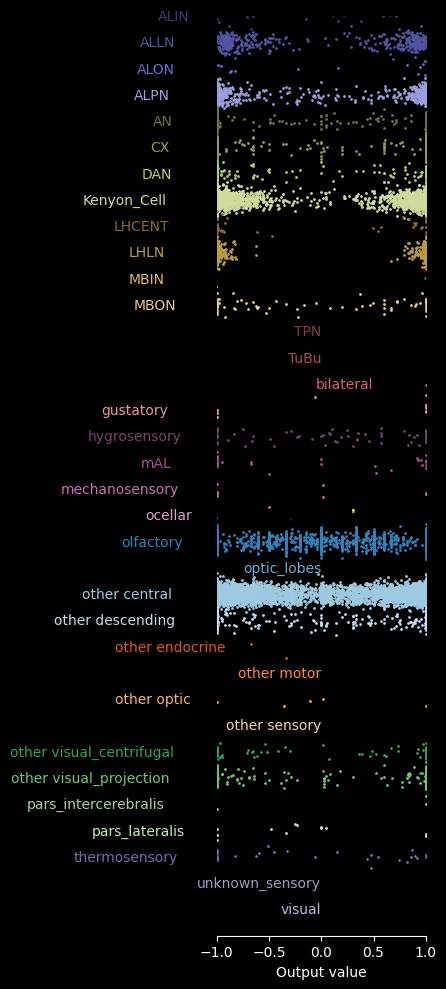

  0%|          | 0/99018 [00:00<?, ?it/s]

/var/folders/y6/xn2dyw2s14b79mrpmzrhykhc0000gn/T/ipykernel_16648/4157032492.py:34: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(class_values, -i + 0.2*np.random.randn(len(class_values)), c=cm_tab40(i), s=1)


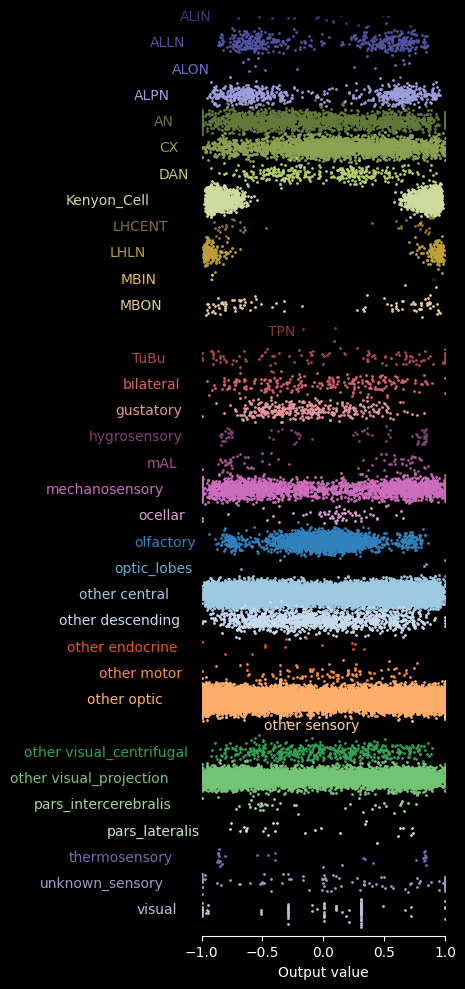

  0%|          | 0/135231 [00:00<?, ?it/s]

/var/folders/y6/xn2dyw2s14b79mrpmzrhykhc0000gn/T/ipykernel_16648/4157032492.py:34: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(class_values, -i + 0.2*np.random.randn(len(class_values)), c=cm_tab40(i), s=1)


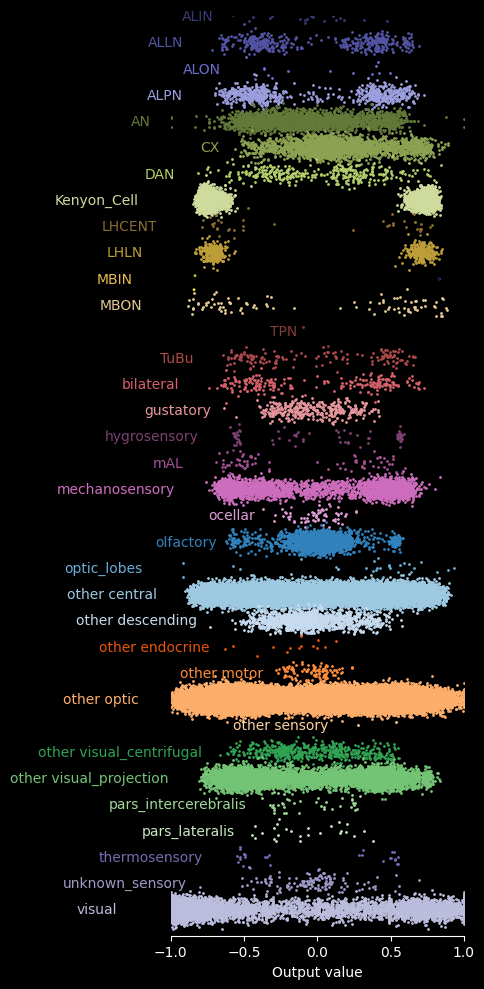

In [190]:
visited_neurons = layers[0]
dont_display_visited_neurons = False

for layer_no in range(1,N_steps+1):

    classes = np.unique(classification['class'].values)

    n_classes = len(classes)
    class_to_index = {c:i for i,c in enumerate(classes)}
    index_to_class = {i:c for i,c in enumerate(classes)}
    
    neurons = layers[layer_no]
    values = lateralizations[layer_no]

    if dont_display_visited_neurons:
        mask = np.logical_not(np.isin(neurons, visited_neurons))
        neurons = neurons[mask]
        values = values[mask]

        # add the visited neurons to the visited neurons
        visited_neurons = np.concatenate((visited_neurons, neurons))
        # make sure the visited neurons are unique
        visited_neurons = np.unique(visited_neurons)

    class_ids = [class_to_index[get_neuron_class(n)] for n in tqdm(neurons)]
    class_ids = np.array(class_ids)

    # scatter plot of the values
    plt.figure(figsize=(5,10))
    for i in range(n_classes):
        # get the values for the class
        class_values = values[class_ids == i]
        # plot the values
        plt.scatter(class_values, -i + 0.2*np.random.randn(len(class_values)), c=cm_tab40(i), s=1)
        # put the name of the class next to the points
        plt.text(np.nanmin(class_values)-0.5*np.mean(np.abs(class_values)) if len(class_values) > 0 else 0, -i, index_to_class[i], verticalalignment='center', horizontalalignment='right', fontsize=10, color=cm_tab40(i))
    max_value = np.max(np.abs(values))
    plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_classes, 0)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/SEP_ALPN_connectivity_class_layer_{}.pdf'.format(layer_no)), bbox_inches='tight', dpi=300)
    plt.show()

In [191]:
layer_classes = [[get_neuron_class(n) for n in tqdm(layer)] for layer in layers]

  0%|          | 0/685 [00:00<?, ?it/s]

  0%|          | 0/20060 [00:00<?, ?it/s]

  0%|          | 0/99018 [00:00<?, ?it/s]

  0%|          | 0/135231 [00:00<?, ?it/s]

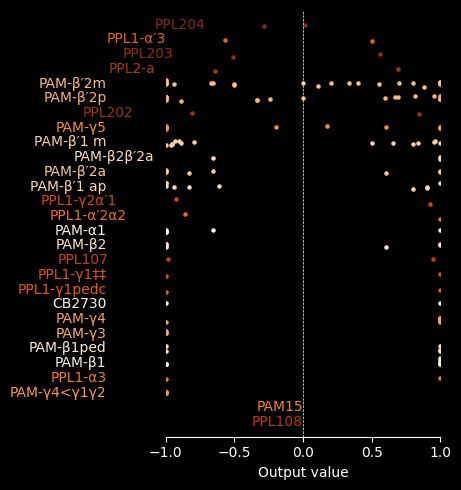

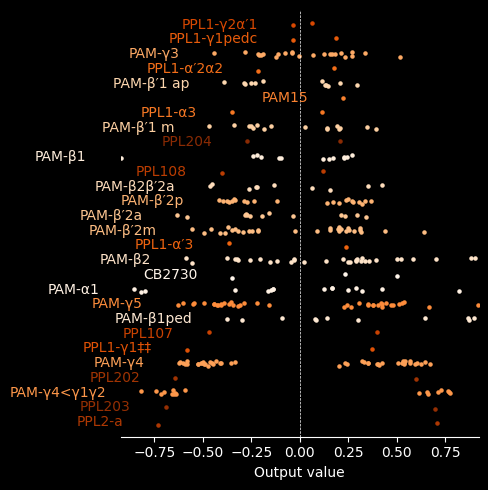

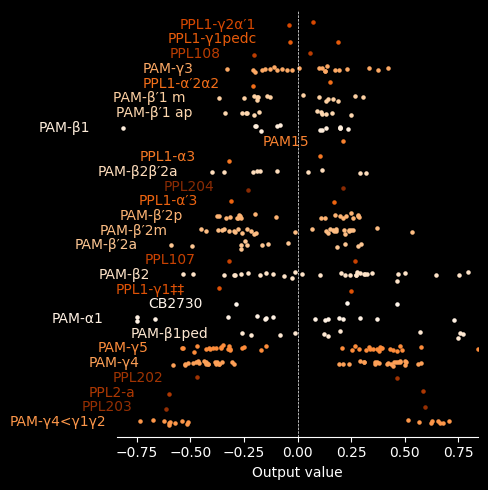

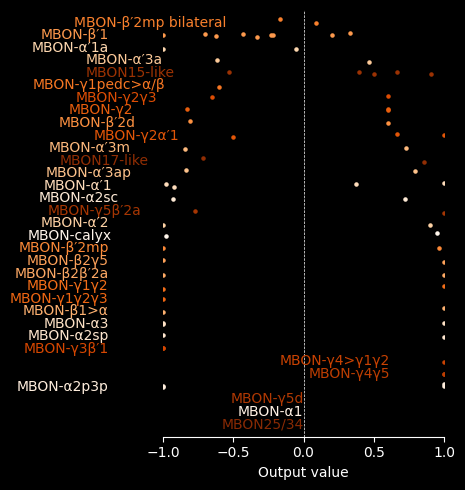

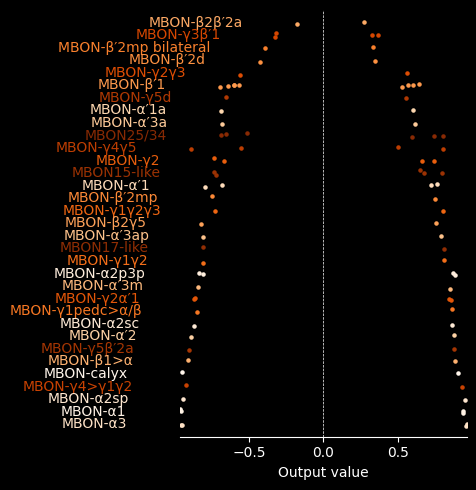

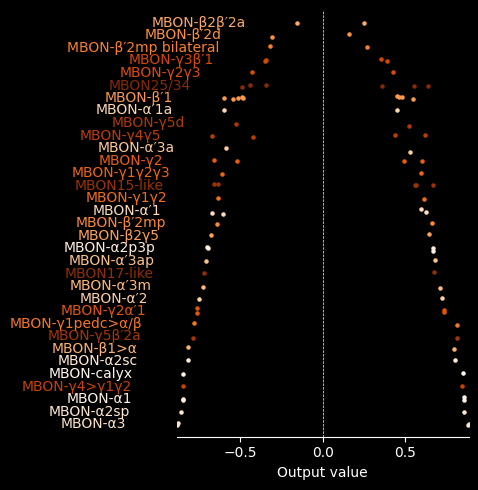

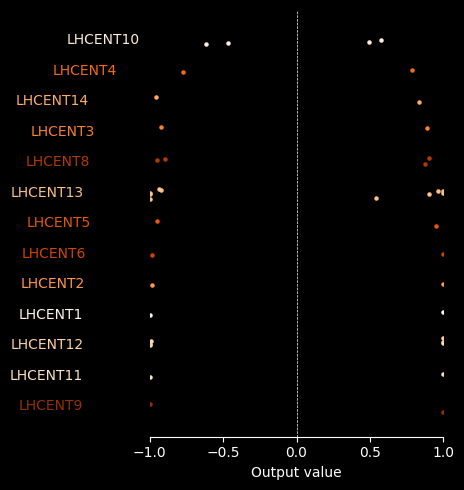

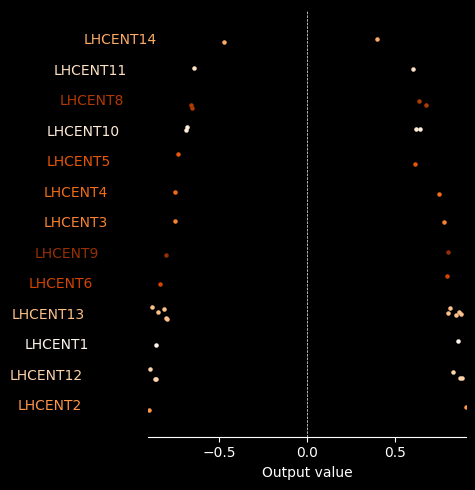

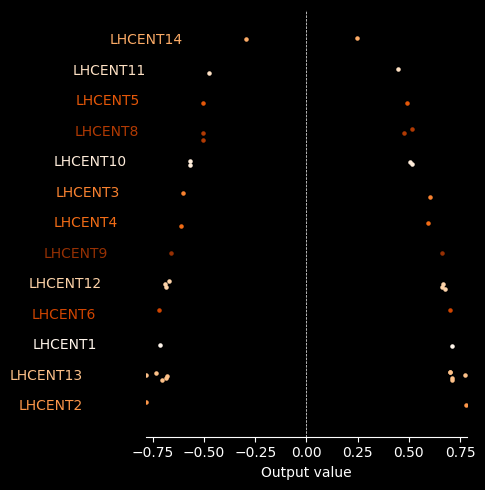

In [192]:
# investigate a single class in the form of cell types
for class_to_investigate in ['DAN', 'MBON', 'LHCENT']:
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}



    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else np.inf
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,5))
        for i, idx in enumerate(sorted_indices):
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.abs(values))
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/SEP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

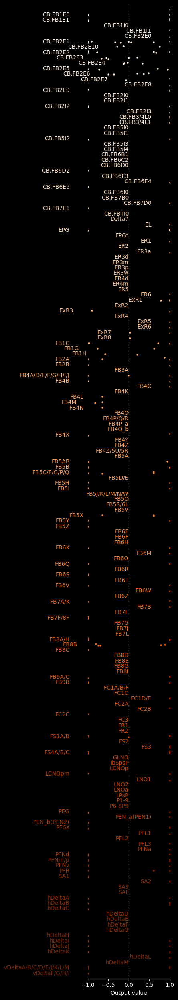

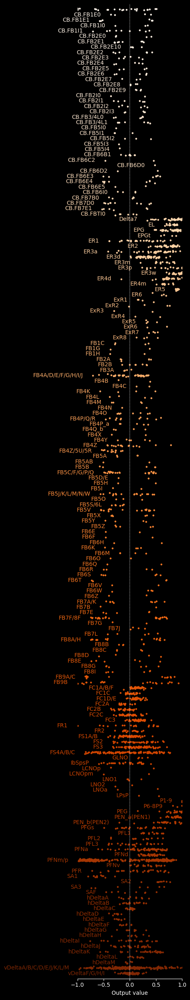

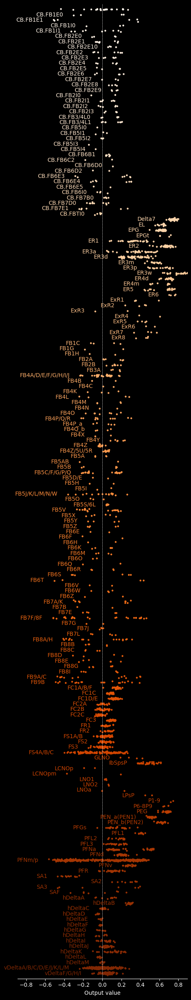

In [193]:
# investigate a single class in the form of cell types
for class_to_investigate in ['CX']:
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}



    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else np.inf
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,25))
        for i, idx in enumerate(range(n_cell_types)):
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.abs(values)) if np.sum(np.isfinite(values)) > 0 else 1
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/SEP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

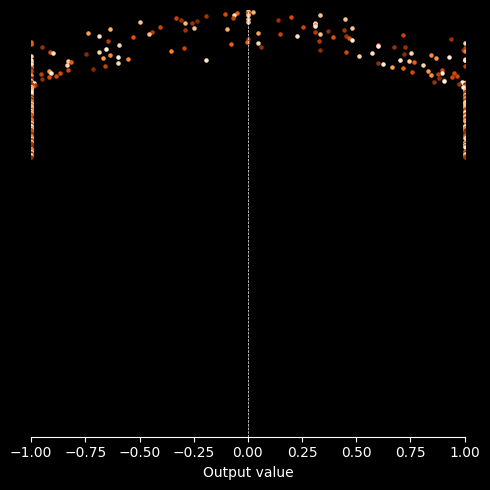

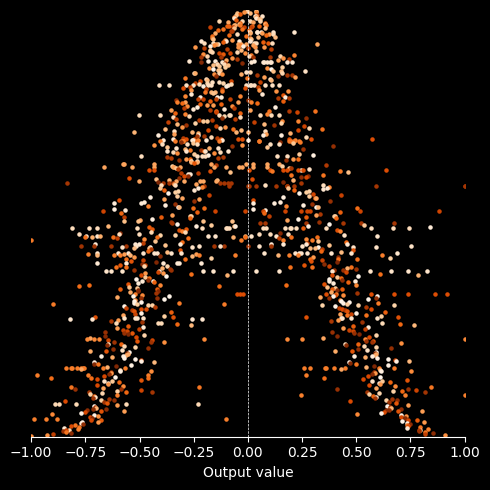

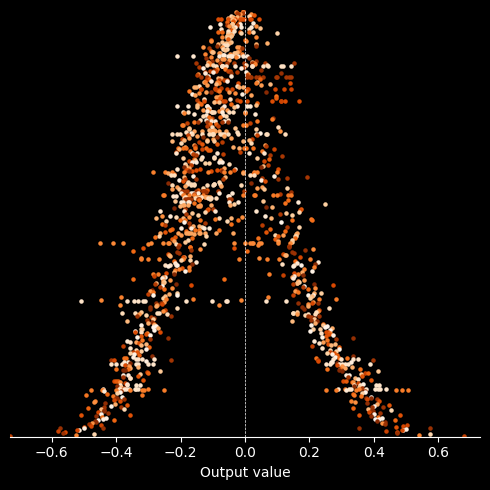

In [194]:
# investigate a single class in the form of cell types
for class_to_investigate in ['other descending']:
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}



    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else np.inf
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,5))
        for i, idx in enumerate(sorted_indices):
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            # plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.abs(values))
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/SEP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

In [195]:
# find connections from one set of roots to another
def find_connections(pre_root_ids, post_root_ids):
    connections_from_pre = connections[connections['pre_root_id'].isin(pre_root_ids)].copy().reset_index(drop=True)
    connections_from_pre = connections_from_pre[connections_from_pre['post_root_id'].isin(post_root_ids)]
    # merge connections from same pre and post neurons
    connections_from_pre = connections_from_pre.groupby(['pre_root_id', 'post_root_id']).agg({'syn_count': 'sum'}).reset_index()
    return connections_from_pre

def get_cell_side(root_id):
    return classification[classification['root_id'] == root_id]['side'].values[0]

# find the roots by cell type
def find_roots_by_cell_type(cell_type):
    classifieds = classification[classification['clean_cell_type'] == cell_type]
    return classifieds['root_id'].values

In [196]:
# find EPGs
EPG_roots = find_roots_by_cell_type('CB.FB6D2')
PN_roots = PNs['root_id'].values

# find connections from PNs to EPGs
PN_to_EPG = find_connections(PN_roots, EPG_roots)
PN_to_EPG['pre_cell_type'] = [get_cell_type(r) for r in PN_to_EPG['pre_root_id']]
PN_to_EPG['pre_cell_side'] = [get_cell_side(r) for r in PN_to_EPG['pre_root_id']]
PN_to_EPG['post_cell_type'] = [get_cell_type(r) for r in PN_to_EPG['post_root_id']]
PN_to_EPG['post_cell_side'] = [get_cell_side(r) for r in PN_to_EPG['post_root_id']]
PN_to_EPG

,pre_root_id,post_root_id,syn_count,pre_cell_type,pre_cell_side,post_cell_type,post_cell_side
0,720575940622192822,720575940643323592,3,M_lvPNm25,right,CB.FB6D2,right
1,720575940622793310,720575940643323592,1,M_lvPNm25,right,CB.FB6D2,right


In [112]:
input_values = PNs['antennal_input_asymmetry'].values

N_steps = 5
exclude_visited = True

layers = []
lateralizations = []
mixing_strengths = []

visited_neurons = np.array([])

output_values = input_values
downstream_neurons = PNs['root_id'].values
mixing_strength = np.zeros(len(downstream_neurons))

for i in range(N_steps):
    layers.append(downstream_neurons)
    lateralizations.append(output_values)
    mixing_strengths.append(mixing_strength)

    if exclude_visited:
        # add the downstream neurons to the visited neurons
        visited_neurons = np.concatenate((visited_neurons, downstream_neurons))
        # make sure the visited neurons are unique
        visited_neurons = np.unique(visited_neurons)

    print('Step', i, end=': ')
    if os.path.exists(os.path.join(processed_data_folder, 'ALPN_connectivity/NIPex_ALPN_downstream_neurons_step_{}.npy'.format(i))) and not recalculate:
        print('Data exists. Loading... ', end='')
        output_values = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/NIPex_ALPN_output_values_step_{}.npy'.format(i)))
        downstream_neurons = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/NIPex_ALPN_downstream_neurons_step_{}.npy'.format(i)))
        mixing_strength = np.load(os.path.join(processed_data_folder, 'ALPN_connectivity/NIPex_ALPN_mixing_strength_step_{}.npy'.format(i)))
        print('N={}'.format(len(downstream_neurons)), end=' ')
        print('Done.')
    else:
        print('Propagating... ', end='')
        downstream_neurons, output_values, mixing_strength = network_influence_propagate(downstream_neurons, output_values, exclude_downstream=visited_neurons if exclude_visited else None)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/NIPex_ALPN_output_values_step_{}.npy'.format(i)), output_values)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/NIPex_ALPN_downstream_neurons_step_{}.npy'.format(i)), downstream_neurons)
        np.save(os.path.join(processed_data_folder, 'ALPN_connectivity/NIPex_ALPN_mixing_strength_step_{}.npy'.format(i)), mixing_strength)
        print('N={}'.format(len(downstream_neurons)), end=' ')
        print('Done.')

# add the last step
layers.append(downstream_neurons)
lateralizations.append(output_values)
mixing_strengths.append(mixing_strength)


Step 0: Propagating... 

  0%|          | 0/235344 [00:00<?, ?it/s]

N=19332 Done.
Step 1: Propagating... 

  0%|          | 0/1730783 [00:00<?, ?it/s]

N=73535 Done.
Step 2: Propagating... 

  0%|          | 0/796330 [00:00<?, ?it/s]

N=25569 Done.
Step 3: Propagating... 

  0%|          | 0/4324 [00:00<?, ?it/s]

N=1480 Done.
Step 4: Propagating... 

  0%|          | 0/360 [00:00<?, ?it/s]

N=234 Done.


In [113]:
layer_classes = [[get_neuron_class(n) for n in tqdm(layer)] for layer in layers]

  0%|          | 0/685 [00:00<?, ?it/s]

  0%|          | 0/19332 [00:00<?, ?it/s]

  0%|          | 0/73535 [00:00<?, ?it/s]

  0%|          | 0/25569 [00:00<?, ?it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

  0%|          | 0/234 [00:00<?, ?it/s]

Layer 1



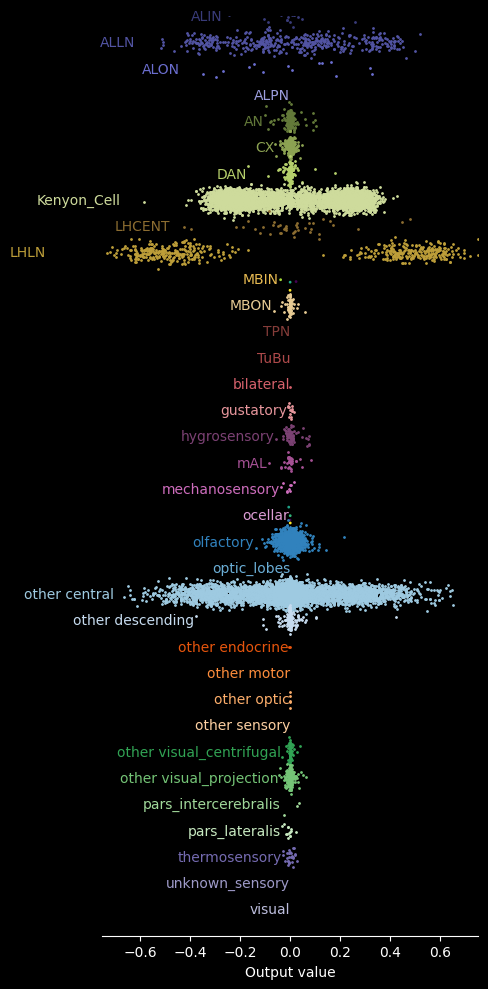

Layer 2



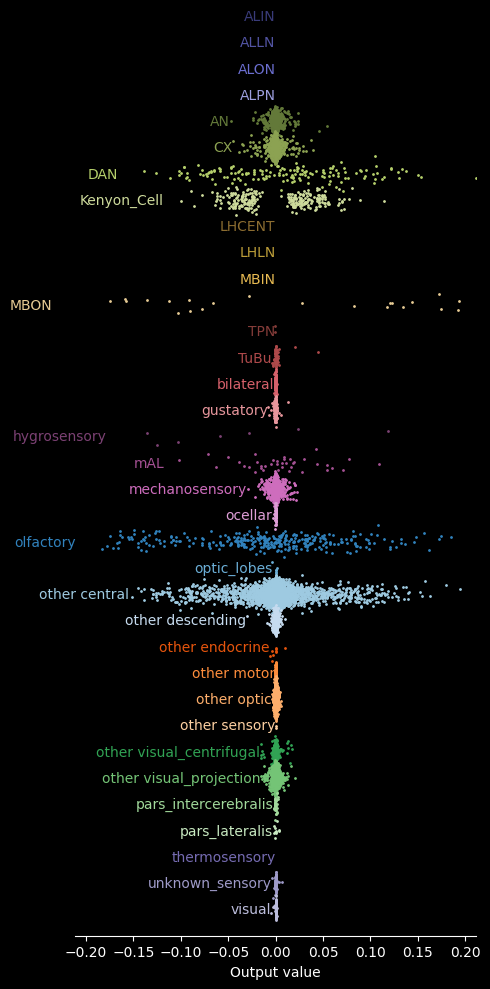

Layer 3



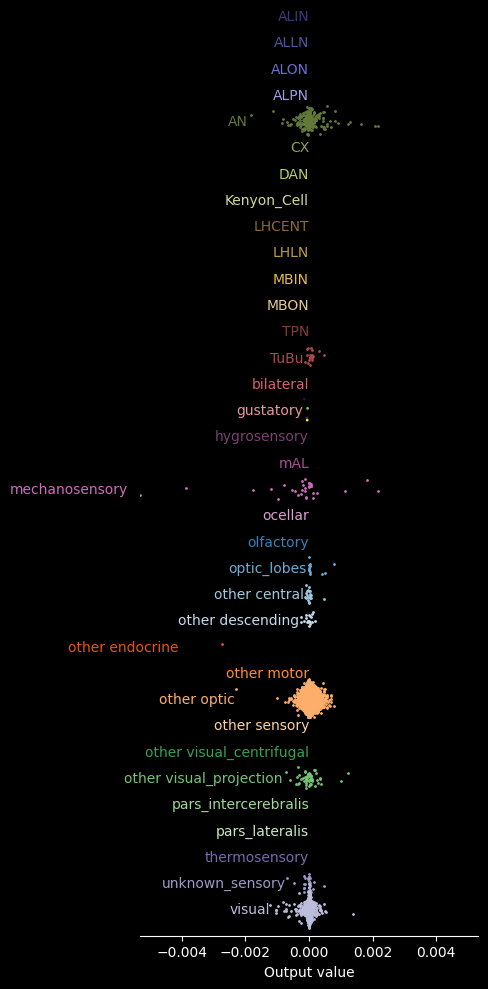

Layer 4



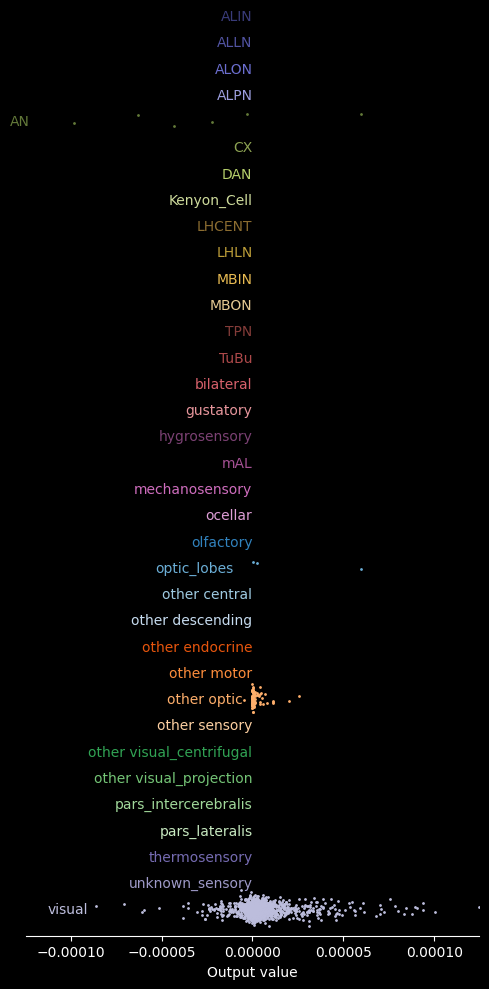

Layer 5



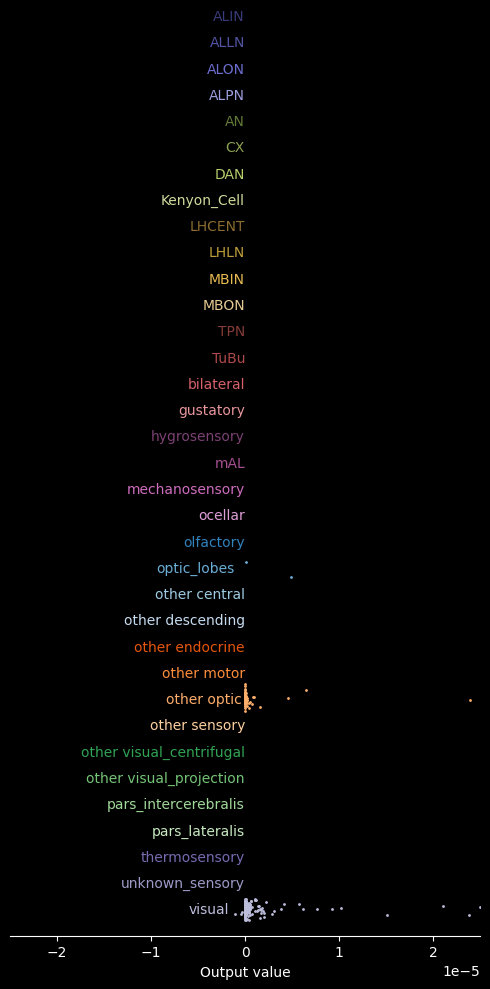

In [114]:
visited_neurons = layers[0]
dont_display_visited_neurons = False

for layer_no in range(1,N_steps+1):
    print('Layer', layer_no, end='\n\n')

    classes = np.unique(classification['class'].values)

    n_classes = len(classes)
    class_to_index = {c:i for i,c in enumerate(classes)}
    index_to_class = {i:c for i,c in enumerate(classes)}
    
    neurons = layers[layer_no]
    values = lateralizations[layer_no]
    classes = layer_classes[layer_no]

    if dont_display_visited_neurons:
        mask = np.logical_not(np.isin(neurons, visited_neurons))
        neurons = neurons[mask]
        values = values[mask]

        # add the visited neurons to the visited neurons
        visited_neurons = np.concatenate((visited_neurons, neurons))
        # make sure the visited neurons are unique
        visited_neurons = np.unique(visited_neurons)

    class_ids = [class_to_index[c] for c in classes]
    class_ids = np.array(class_ids)

    # scatter plot of the values
    plt.figure(figsize=(5,10))
    for i in range(n_classes):
        # get the values for the class
        class_values = values[class_ids == i]
        # plot the values
        plt.scatter(class_values, -i + 0.2*np.random.randn(len(class_values)), c=cm_tab40(i), s=1)
        # put the name of the class next to the points
        plt.text(np.nanmin(class_values)-0.5*np.mean(np.abs(class_values)) if len(class_values) > 0 else 0, -i, index_to_class[i], verticalalignment='center', horizontalalignment='right', fontsize=10, color=cm_tab40(i))
    max_value = np.max(np.abs(values))
    plt.xlim(-max_value, max_value)
    plt.xlabel('Output value')
    plt.gca().set_yticks([])
    plt.ylim(-n_classes, 0)
    plt.gca().spines['left'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_class_layer_{}.pdf'.format(layer_no)), bbox_inches='tight', dpi=300)
    plt.show()



Investigating class Kenyon_Cell 



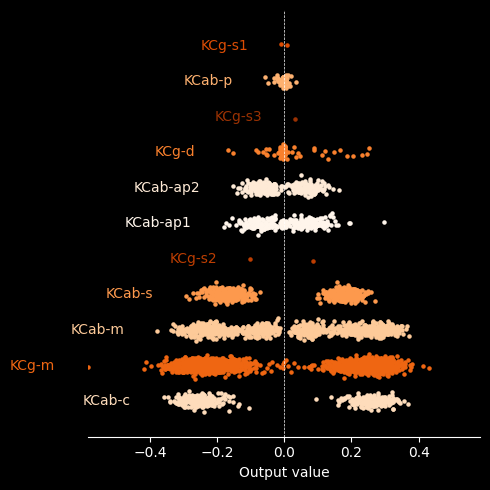

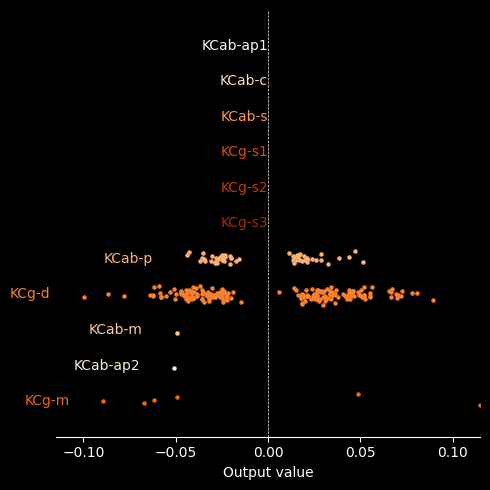

ValueError: zero-size array to reduction operation maximum which has no identity

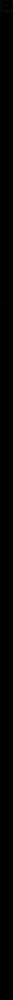

In [115]:
# investigate a single class in the form of cell types
for class_to_investigate in ['Kenyon_Cell']:
    print('\n\nInvestigating class', class_to_investigate, '\n')
    # get the cell types across all layers
    class_neurons = []
    class_cell_types = []
    class_values = []
    for layer_no in range(N_steps+1):
        neurons = layers[layer_no]
        values = lateralizations[layer_no]
        classes = layer_classes[layer_no]

        # filter out the neurons that are not of the class
        class_mask = [c == class_to_investigate for c in classes]
        class_mask = np.array(class_mask)
        neurons = neurons[class_mask]
        values = values[class_mask]
        # get the cell types applying the neuron dictionary if available
        cell_type = [get_cell_type(n) for n in neurons]
        cell_type = [neuron_dictionary[c] if c in neuron_dictionary else c for c in cell_type]

        class_neurons.append(neurons)
        class_cell_types.append(cell_type)
        class_values.append(values)

    # get the unique cell types
    unique_cell_types = np.unique(np.concatenate(class_cell_types))
    n_cell_types = len(unique_cell_types)
    cell_type_to_index = {c:i for i,c in enumerate(unique_cell_types)}
    index_to_cell_type = {i:c for i,c in enumerate(unique_cell_types)}

    all_cell_type_values = []


    for layer_no in range(1,N_steps+1):

        neurons = class_neurons[layer_no]
        values = class_values[layer_no]
        cell_types = class_cell_types[layer_no]

        cell_type_ids = [cell_type_to_index[c] for c in cell_types]
        cell_type_ids = np.array(cell_type_ids)

        # get average lateralization for each cell type
        cell_type_values = np.zeros(n_cell_types)
        for i in range(n_cell_types):
            cell_type_values[i] = np.mean(np.abs(values[cell_type_ids == i])) if np.sum(cell_type_ids == i) > 0 else 0
        all_cell_type_values.append(np.power(cell_type_values, 1/layer_no))
        # sort the cell types by average lateralization
        sorted_indices = np.argsort(cell_type_values)

        # scatter plot of the values
        plt.figure(figsize=(5,5))
        for i, idx in enumerate(sorted_indices):
            # get the values for the class
            cell_type_values = values[cell_type_ids == idx]
            # plot the values
            plt.scatter(cell_type_values, -i + 0.1*np.random.randn(len(cell_type_values)), color=plt.cm.Oranges(idx/n_cell_types), s=5)
            # put the name of the class next to the points
            plt.text(np.nanmin(cell_type_values)-0.5*np.mean(np.abs(values)) if len(cell_type_values) > 0 else 0, -i, index_to_cell_type[idx], verticalalignment='center', horizontalalignment='right', fontsize=10, color=plt.cm.Oranges(idx/n_cell_types))
        # draw the zero line
        plt.axvline(0, color='white', linestyle='--', linewidth=0.5)
        max_value = np.max(np.abs(values))
        plt.xlim(-max_value, max_value)
        plt.xlabel('Output value')
        plt.gca().set_yticks([])
        plt.ylim(-n_cell_types, 1)
        plt.gca().spines['left'].set_visible(False) 
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_layer_{}.pdf'.format(class_to_investigate, layer_no)), bbox_inches='tight', dpi=300)
        plt.show()

    # get the average lateralization for each cell type and plot as a bar plot
    all_cell_type_values = np.array(all_cell_type_values)
    # replace inf values with nan
    all_cell_type_values[all_cell_type_values == np.inf] = np.nan
    average_cell_type_values = np.nanmean(np.array(all_cell_type_values), axis=0)
    # sort the cell types by average lateralization
    sorted_indices = np.argsort(average_cell_type_values)
    # keep only keep the top 20 cell types
    sorted_indices = sorted_indices[-20:]
    # get top 20 cell types
    top20_cell_types = [index_to_cell_type[i] for i in sorted_indices]
    # plot the sorted cell types
    plt.figure(figsize=(3,5))
    plt.barh(np.arange(len(sorted_indices)), average_cell_type_values[sorted_indices], color=plt.cm.Oranges(np.linspace(0, 1, len(sorted_indices))))
    plt.yticks(np.arange(len(sorted_indices)), [index_to_cell_type[i] for i in sorted_indices])
    plt.xlabel('Average output value')
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, 'ALPN_connectivity/NIP_ALPN_connectivity_{}_top_20.pdf'.format(class_to_investigate)), bbox_inches='tight', dpi=300)
    plt.show()

